In [1]:
import os
import csv
import optuna
import numpy as np
import pandas as pd
from tensorflow import keras
from tensorflow.keras.optimizers import Adam, RMSprop, SGD
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Input, LSTM, Dense, Activation, Dropout
from pandas import DataFrame
from pandas import Series
from pandas import concat
from pandas import read_csv
from datetime import datetime
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from math import sqrt
from matplotlib import pyplot as plt
from matplotlib.patches import Patch
from numpy import array
import keras.backend as K
import itertools
#!pip install pydot

# date-time parsing function for loading the dataset
def parser(x):
    return datetime.strptime('190'+x, '%Y-%m')
    
def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))
    
def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
    
# convert time series into a supervised learning problem
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
# convert time series into a supervised learning problem
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):

    n_vars = 1 if type(data) is list else data.shape[1]
    cols, names = list(), list()
    df = DataFrame(data)
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -1):
    	cols.append(df.shift(i))
    	names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df[0].shift(-i)) # df[0] for temperatures
        if i == 0:
            names += [('var%d(t)' % (1))] # % (1) for temperatures
        else:            
            names += [('var%d(t+%d)' % (1, i))] # % (1) for temperatures
    
    # put it all together
    agg = concat(cols, axis=1)

    if dropnan:
        #Drop rows containing NaN
        agg.dropna(inplace=True)

    agg.columns = names

    return agg
     
# create a differenced series
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def difference(dataset, interval=1):
    diff = list()
    for i in range(interval, len(dataset)):
        value = dataset[i] - dataset[i - interval]
        diff.append(value)
    return Series(diff)
     
# transform series into training sets for supervised learning
def prepare_training_data(data, n_lag, n_seq, n_time_steps):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)


    diff_values = []
    
    for ws in range(84):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)
    
    # rescale values to 0, 1
    scaler_all_features =  MinMaxScaler(feature_range=(0, 1))
    scaler =  MinMaxScaler(feature_range=(0, 1))
    train_scaled_values = scaler_all_features.fit_transform(diff_values)
    response_train_values = []
    for i in range(len(diff_values)):
        response_train_values.append(diff_values[i][0]) # Uses first column (temperatures) as response variable
    response_train_values = np.array(response_train_values)
    response_train_values = response_train_values.reshape(len(response_train_values), 1)

    # Fit the scaler for just the response variable for use later when forecasting
    response_scaled_values = scaler.fit_transform(response_train_values) 
    scaled_values = scaler_all_features.transform(diff_values)

    train = []

    # Transform each weather station as a separate "batch"
    for ws in range(84):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        train.append([supervised_values])
    
    return scaler, scaler_all_features, train

# transform series into testing and validation sets for supervised learning
def prepare_testing_and_validation_data(data, n_lag, n_seq, n_time_steps, scaler_all_features):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)


    diff_values = []
    
    for ws in range(21):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    # rescale values to 0, 1
    scaled_values = scaler_all_features.transform(diff_values)

    validation = []
    test = []

    # Transform each weather station as a separate "batch"
    for ws in range(21):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        # training/test/validation split is 80%/10%/10%
        if ws < 11:
            test.append([supervised_values])
        else:
            validation.append([supervised_values])
    
    return validation, test
    
def plot_kfold(cv, X, y, ax, n_splits, xlim_max=105):
    
    #Plots the indices for a cross-validation object.
    #Taken from https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
    #Parameters:
    #cv: Cross-validation object
    #X: Feature set
    #y: Target variable
    #ax: Matplotlib axis object
    #n_splits: Number of folds in the cross-validation
    #xlim_max: Maximum limit for the x-axis
        
    # Set color map for the plot
    cmap_cv = plt.cm.coolwarm
    cv_split = cv.split(X=X, y=y)
        
    for i_split, (train_idx, test_idx) in enumerate(cv_split):
        # Create an array of NaNs and fill in training/testing indices
        indices = np.full(len(X), np.nan)
        indices[test_idx], indices[train_idx] = 1, 0
            
        # Plot the training and testing indices
        ax_x = range(len(indices))
        ax_y = [i_split + 0.5] * len(indices)
        ax.scatter(ax_x, ax_y, c=indices, marker="_", 
                   lw=10, cmap=cmap_cv, vmin=-0.2, vmax=1.2)
    
        # Set y-ticks and labels
        y_ticks = np.arange(n_splits) + 0.5
        ax.set(yticks=y_ticks, yticklabels=range(n_splits),
               xlabel="Weather Station index (file_id)", ylabel="Fold",
               ylim=[n_splits, -0.2], xlim=[0, xlim_max])
    
        # Set plot title and create legend
        ax.set_title("KFold", fontsize=14)
        legend_patches = [Patch(color=cmap_cv(0.8), label="Testing set"), 
                          Patch(color=cmap_cv(0.02), label="Training set")]
        ax.legend(handles=legend_patches, loc=(1.03, 0.8))
    
#Main

#Configure
n_seq = 60
if n_seq > 46:
    n_lag = 179 - n_seq + 46
else:
    n_lag = 179
n_time_steps = 227
n_test = 1

print("Model Parameters:")
print("n_lag (number of input time steps): "+str(n_lag))
print("n_seq (number of output/future prediction time steps): "+str(n_seq))

# Create 2D array with file_ids to use for sample creation
array = np.array([
    6501, 6541, 6640, 6668, 6678, 
    6687, 6697, 6714, 6744, 6772, 
    6783, 6840, 6844, 6854, 6870, 
    6891, 6895, 6899, 6901, 6909, 
    6929, 6950, 6963, 6969, 6994, 
    7032, 7057, 7094, 7095, 7100, 
    7108, 7116, 7119, 7131, 7139, 
    7152, 7155, 7156, 7182, 7193, 
    7202, 7239, 7280, 7286, 7287, 
    7311, 7321, 7329, 7347, 7350, 
    7354, 7357, 7361, 7414, 7423, 
    7424, 7432, 7463, 7482, 7489, 
    7528, 7531, 7534, 7538, 7549, 
    7553, 7555, 7562, 7571, 7573, 
    7574, 7575, 7585, 7599, 7603, 
    7606, 7622, 7652, 7671, 7704, 
    7786, 7805, 7816, 7838, 7861, 
    7862, 7863, 7870, 7892, 7907, 
    7938, 7962, 7979, 7987, 7999, 
    8000, 8034, 8083, 8120, 8133, 
    8184, 8186, 8247, 8248, 9858])
    
#Create arrays holding the 5-fold cross-validation indices gathered for consistency across models
train_array = []
test_array = []
    
train_array.append([1, 2, 3, 5, 6, 7, 8, 9, 11, 13, 14, 15, 16, 17, 19, 20, 21, 22, 
                        23, 24, 25, 27, 28, 29, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 
                        43, 44, 46, 48, 49, 50, 51, 52, 54, 55, 56, 57, 58, 59, 60, 61, 
                        62, 63, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79, 81, 
                        82, 83, 84, 85, 86, 87, 88, 90, 91, 92, 93, 95, 97, 98, 100, 101, 102, 103])
test_array.append([0, 4, 10, 12, 18, 26, 30, 31, 33, 45, 47, 53, 64, 65, 77, 80, 89, 94, 96, 99, 104])
    
train_array.append([0, 1, 2, 3, 4, 6, 7, 8, 10, 12, 13, 14, 17, 18, 19, 20, 21, 23, 
                        24, 25, 26, 27, 29, 30, 31, 32, 33, 34, 36, 37, 38, 41, 43, 45, 
                        46, 47, 48, 49, 50, 51, 52, 53, 54, 57, 58, 59, 60, 61, 63, 64, 
                        65, 66, 67, 68, 69, 70, 71, 73, 74, 75, 77, 80, 81, 82, 83, 84, 
                        86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 104])
test_array.append([5, 9, 11, 15, 16, 22, 28, 35, 39, 40, 42, 44, 55, 56, 62, 72, 76, 78, 79, 85, 103])
    
train_array.append([0, 1, 2, 4, 5, 9, 10, 11, 12, 14, 15, 16, 18, 20, 21, 22, 23, 26, 
                    28, 29, 30, 31, 32, 33, 35, 36, 37, 39, 40, 41, 42, 44, 45, 46, 47, 
                    48, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 
                    70, 71, 72, 74, 75, 76, 77, 78, 79, 80, 82, 83, 85, 86, 87, 88, 89, 
                    90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104])
test_array.append([3, 6, 7, 8, 13, 17, 19, 24, 25, 27, 34, 38, 43, 49, 66, 67, 68, 69, 73, 81, 84])
    
train_array.append([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 
                        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33, 34, 
                        35, 37, 38, 39, 40, 42, 43, 44, 45, 47, 49, 51, 52, 53, 55, 56, 
                        60, 62, 64, 65, 66, 67, 68, 69, 71, 72, 73, 74, 76, 77, 78, 79, 
                        80, 81, 82, 84, 85, 86, 87, 88, 89, 92, 93, 94, 95, 96, 99, 102, 103, 104])
test_array.append([32, 36, 41, 46, 48, 50, 54, 57, 58, 59, 61, 63, 70, 75, 83, 90, 91, 97, 98, 100, 101])
    
train_array.append([0, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 22,
                        24, 25, 26, 27, 28, 30, 31, 32, 33, 34, 35, 36, 38, 39, 40, 41, 
                        42, 43, 44, 45, 46, 47, 48, 49, 50, 53, 54, 55, 56, 57, 58, 59, 
                        61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 72, 73, 75, 76, 77, 78, 
                        79, 80, 81, 83, 84, 85, 89, 90, 91, 94, 96, 97, 98, 99, 100, 101, 103, 104])
test_array.append([1, 2, 14, 20, 21, 23, 29, 37, 51, 52, 60, 71, 74, 82, 86, 87, 88, 92, 93, 95, 102])
    
# Equations for three Principal Components from PCA using response variables combined with other predictors
#PC1=-0.0002714X1+0.02612X2+0.03858X3-0.007658X4+0.001592X5-0.02087X6+0.8564X7-0.1468X8+0.01192X9-0.0001049X10+0.01913X11+0.02076X12
#PC2=0.0003944X1+0.002204X2+0.01052X3+0.3248X4-0.0009976X5-0.04421X6+2.3406X7+0.06103X8+0.08841X9+0.00009018X10+0.05678X11-0.002022X12
#PC3=-0.00007998X1-0.0006124X2-0.001063X3-0.01855X4+0.00001956X5+0.01170X6+0.6076X7+0.4664X8-0.002995X9+0.008185X10+0.8815X11-0.0004730X12
    
# Equations for three Principal Components from PCA omitting both response variables,
#PC-1=-0.0004514X1+0.03194X2-0.04343X3+0.002243X4-0.02252X5+0.9877X6-0.2265X7+0.006144X8-0.0001488X9+0.02943X10
#PC-2=0.0001702X1+0.005484X2+0.2057X3-0.0003188X4-0.02584X5+1.6963X6-0.05890X7+0.05809X8+1.9748X9+0.03686X10
#PC-3=-0.00006323X1-0.001180X2-0.02384X3-0.00002833X4+0.01170X5+0.5204X6+0.4791X7-0.004318X8+0.008271X9+0.8765X10
    
# Get the current working directory 
current_directory = os.getcwd() 
    
# Print the current working directory 
print(current_directory)
    
# Define the directory containing the files 
path = current_directory+"\\Modeling\\"
print(path)
    
filename = path + 'Final_Monthly_Dataset.csv'
    
# load dataset
df = read_csv(filename, header=0, parse_dates=[0], index_col=0, date_format='%Y-%m')

print(df)
    
df = df.rename(columns={'Unnamed: 0' : 'indices'})
    
#Remove unused columns
df = df.drop(['Day', 'vapor_pressure'], axis=1)
    
# Round numbers in columns to reasonable precision,
df['temperatures'] = np.round(df['temperatures'], 2)
df['slp'] = np.round(df['slp'], 2)
df['wet_bulb_temperature'] = np.round(df['wet_bulb_temperature'], 2)
df['specific_humidity'] = np.round(df['specific_humidity'], 2)
df['GHI'] = np.round(df['GHI'], 2)
df['PRCP'] = np.round(df['PRCP'], 2)
df['SNDP'] = np.round(df['SNDP'], 2)
df['solar_activity'] = np.round(df['solar_activity'], 2)
df['ONI'] = np.round(df['ONI'], 2)
df['water'] = np.round(df['water'], 0)
df['region'] = np.round(df['region'], 0)
    
df_trimmed = df[df['file_id'] != 7533] # Remove file_id 7533 so there are 105 weather stations for 5-fold CV
df_trimmed = df_trimmed.drop(['Year', 'Month', 'date', 'latitude', 'longitude', 'elevation'], axis=1)

#Test model and accuracy when solar activity is removed as a predictor
df_trimmed = df_trimmed.drop(['solar_activity'], axis=1)

n_vars = df_trimmed.shape[1]-1
    
X = []
y = []
    
for i in array:
    add_to_X = [] # create list to store each column to add to X
    new_df = df_trimmed[df_trimmed['file_id'] == i].drop(['file_id'], axis=1)
    #new_df = new_df.iloc[:180, :]
    add_to_y = []
    for j in range(new_df.shape[0]):
        add_to_y.append(new_df['temperatures'].iloc[j])
    y.append(add_to_y)
    #new_df = new_df.drop(['temperatures'], axis=1)
    columns_list = new_df.columns.tolist()
    for j in range(new_df.shape[0]):
        l=0
        new_row = []
        for m in columns_list:
            new_row.append(new_df.iloc[j, l])
            l += 1
        add_to_X.append(new_row)
    X.append(add_to_X)
    
#Perform k-fold cross-validation
#Taken from: https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
#k = 5  # Number of folds
#kf = KFold(n_splits=k, shuffle=True, random_state=42)
    
#for i, (train_index, test_index) in enumerate(kf.split(X)):
#    print(f"Fold {i}:")
#    print(f"  Training dataset index: {train_index}")
#    print(f"  Test dataset index: {test_index}")
    
#for train_indices, test_indices in kf.split(X):
#    print('Train: %s | test: %s' % (train_indices, test_indices))
    
# Create figure and axis
#fig, ax = plt.subplots(figsize=(6, 3))
#plot_kfold(kf, X, y, ax, k)
#plt.tight_layout()
#fig.subplots_adjust(right=0.6)
    
#Create train and test sets for each cross-validation split
train_X = []
train_y = []
val_X = []
val_y = []
for i in range(5):
    print(f"Fold {i+1}")
    #Add each corresponding sample for each entry of train index 
    train_X_rows = [] # Stores all the samples for one fold of train_X
    train_y_rows = [] # Stores all the samples for one fold of train_y
    for j in train_array[i]:
        train_X_rows.append(X[j])
        train_y_rows.append(y[j])
    # Stores one fold of train dataset
    train_X.append(train_X_rows)
    train_y.append(train_y_rows)
    #Add each corresponding sample for each entry of the validation index 
    val_X_rows = [] # Stores all the samples for one fold of val_X
    val_y_rows = [] # Stores all the samples for one fold of val_y
    for j in test_array[i]: 
            val_X_rows.append(X[j])
            val_y_rows.append(y[j])
    # Stores one fold of validation dataset
    val_X.append(val_X_rows)
    val_y.append(val_y_rows) 
    
#Convert 3D arrays to DataFrames
df_X = []
df_y = []
val_df_X = []
val_df_y = []
dataset = []
dataset_test = []
scaler = []
scaler_all_features = []
train = []
test = []
validation = []

for i in range(5):
    dataset_scaling = [] # Holds all 84 weather station rows to train the scaling function
    dataset_testing = [] # Holds remaining 21 weather station rows for testing and validation
    print("Fold "+str(i+1)+":")
    #Transform train_X to the correct format
    df1 = []
    dataset_df = [] # captures each weather station's dataset as values for training scaler mapping
    df_X.append(pd.DataFrame(train_X[i]))
    X_t = df_X[i].transpose()
    for k in range(84):
        X = np.array(X_t.iloc[:, k])
        df = pd.DataFrame()
        for j in range(n_time_steps):
            new_row = pd.DataFrame(X[j]).transpose()
            new_row.columns = new_df.columns
            # Add the new row
            df = pd.concat([df, new_row], ignore_index=True)
        df.columns = new_df.columns
        df1.append(df)
        dataset_df.append(df.values)
        dataset_scaling.append(df.values)
    df_X[i] = df1
    dataset.append(dataset_df)

    #print(len(dataset))
    #print(len(dataset[0]))
    #print(len(dataset_scaling))
    #print(len(dataset_scaling[:][0]))
    #print("Stop")
    
    #Transform train_y to the correct format
    df2 = []
    df_y.append(pd.DataFrame(train_y[i]))
    y_t = df_y[i].transpose()
    
    for j in range(84):
        y = np.array(y_t.iloc[:, j])
        y = pd.DataFrame(y)
        y.columns = ['temperatures']
        df2.append(y)
    df_y[i] = df2

    #Transform val_X to the correct format
    df3 = []
    dataset_vl_df = [] # captures each weather station's dataset as values for training scaler mapping
    val_df_X.append(pd.DataFrame(val_X[i]))
    val_X_t = val_df_X[i].transpose()
    for k in range(21):
        vl_X = np.array(val_X_t.iloc[:, k])
        vl_df = pd.DataFrame()
        for j in range(n_time_steps):
            new1_row = pd.DataFrame(vl_X[j]).transpose()
            new1_row.columns = new_df.columns
            # Add the new row
            vl_df = pd.concat([vl_df, new1_row], ignore_index=True)
        vl_df.columns = new_df.columns
        df3.append(vl_df)
        dataset_vl_df.append(vl_df.values)
        dataset_testing.append(vl_df.values)
    val_df_X[i] = df3
    dataset_test.append(dataset_vl_df)

    #Transform val_y to the correct format
    df4 = []
    val_df_y.append(pd.DataFrame(train_y[i]))
    val_y_t = val_df_y[i].transpose()
    
    for j in range(21):
        v_y = np.array(val_y_t.iloc[:, j])
        v_y = pd.DataFrame(v_y)
        v_y.columns = ['temperatures']
        df4.append(v_y)
    val_df_y[i] = df4
    
    scaler.append(MinMaxScaler(feature_range=(0, 1)))
    scaler_all_features.append(MinMaxScaler(feature_range=(0, 1)))
    train.append([1])
    test.append([1])
    validation.append([1])
    
    # prepare data
    scaler[i], scaler_all_features[i], train[i] = prepare_training_data(dataset_scaling, n_lag, n_seq, n_time_steps)

    validation[i], test[i] = prepare_testing_and_validation_data(dataset_testing, n_lag, n_seq, n_time_steps, scaler_all_features[i])

    #Reshape dimensionality
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]
    print(np.array(train1).shape)
    print(np.array(test1).shape)
    print(np.array(validation1).shape)
    train2 = []
    test2 = []
    validation2 = []

    for k in range(84):
        train2.append(train1[k][0])
        
    for k in range(11):
        test2.append(test1[k][0])

    for k in range(10):
        validation2.append(validation1[k][0])

    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2

    #Reshape dimensionality (again)
    dim_size = n_seq + n_vars*n_lag
    train1 = np.array(train[i]).reshape(84, dim_size)
    test1 = np.array(test[i]).reshape(11, dim_size)
    validation1 = np.array(validation[i]).reshape(10, dim_size)
    train2 = pd.DataFrame(train1).values
    test2 = pd.DataFrame(test1).values
    validation2 = pd.DataFrame(validation1).values
    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    print(train2)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2
    
    #X_train = train1[:][:-n_seq]
    #y_train = train1[:][-n_seq:]
    #X_test = test1[:][:-n_seq]
    #y_test = test1[:][-n_seq:]

print("Finished")

Model Parameters:
n_lag (number of input time steps): 165
n_seq (number of output/future prediction time steps): 60
C:\Users\User
C:\Users\User\Modeling\
             date  file_id  temperatures          slp  vapor_pressure  \
0      2006-01-31     6501     12.209677  1018.534543        8.674922   
1      2006-02-28     6501      8.174541  1021.230347        6.942276   
2      2006-03-31     6501     15.676613  1018.968548       10.468176   
3      2006-04-30     6501     22.464167  1014.686944       16.358802   
4      2006-05-31     6501     23.657258  1014.236828       18.798749   
...           ...      ...           ...          ...             ...   
24057  2024-07-31     9858     28.604704  1013.969355       23.769169   
24058  2024-08-31     9858     29.114919  1015.112097       23.699154   
24059  2024-09-30     9858     24.570278  1014.393750       16.790240   
24060  2024-10-31     9858     21.159140  1018.230376       10.994776   
24061  2024-11-30     9858     12.112917  1

In [2]:
print(n_seq)
print(n_lag)
print(np.array(train[1]).shape)
print(np.array(test[1]).shape)

60
165
(84, 1875)
(11, 1875)


[I 2025-05-20 23:58:41,241] A new study created in memory with name: no-name-21fa0c99-a319-4ccd-ad00-40393e67b7d1
[I 2025-05-21 00:03:29,879] Trial 0 finished with value: 0.07387404590845108 and parameters: {'lr': 0.015524332975535508, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.1616532554304882}. Best is trial 0 with value: 0.07387404590845108.


Cross Validation Accuracies:
[0.06769827753305435, 0.06608016788959503, 0.07001561671495438, 0.07967282086610794, 0.0859033465385437]
Mean Cross Validation Accuracy:
0.07387404590845108
Standard Deviation of Cross Validation Accuracy:
0.0076433237547454515


[I 2025-05-21 00:11:21,621] Trial 1 finished with value: 0.07908440828323364 and parameters: {'lr': 0.003325783779003345, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.4538224002742036}. Best is trial 0 with value: 0.07387404590845108.


Cross Validation Accuracies:
[0.06521386653184891, 0.08703489601612091, 0.08700674027204514, 0.10403597354888916, 0.0521305650472641]
Mean Cross Validation Accuracy:
0.07908440828323364
Standard Deviation of Cross Validation Accuracy:
0.018261740345345685


[I 2025-05-21 00:16:12,034] Trial 2 finished with value: 0.5613399565219879 and parameters: {'lr': 0.0013126794553306273, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.4517965034799992}. Best is trial 0 with value: 0.07387404590845108.


Cross Validation Accuracies:
[0.4873981773853302, 0.5718271732330322, 0.5493814945220947, 0.5852969884872437, 0.6127959489822388]
Mean Cross Validation Accuracy:
0.5613399565219879
Standard Deviation of Cross Validation Accuracy:
0.042289553722628104


[I 2025-05-21 00:20:25,352] Trial 3 finished with value: 0.053718775510787964 and parameters: {'lr': 0.029344103994693088, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.10596237524123678}. Best is trial 3 with value: 0.053718775510787964.


Cross Validation Accuracies:
[0.04536982625722885, 0.045690953731536865, 0.06268606334924698, 0.06392054259777069, 0.05092649161815643]
Mean Cross Validation Accuracy:
0.053718775510787964
Standard Deviation of Cross Validation Accuracy:
0.00808004985590797


[I 2025-05-21 00:25:00,923] Trial 4 finished with value: 0.05221516340970993 and parameters: {'lr': 0.6803308834070195, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.14175258524411977}. Best is trial 4 with value: 0.05221516340970993.


Cross Validation Accuracies:
[0.0446542389690876, 0.047669652849435806, 0.05587378889322281, 0.06205186992883682, 0.050826266407966614]
Mean Cross Validation Accuracy:
0.05221516340970993
Standard Deviation of Cross Validation Accuracy:
0.006162866461377507


[I 2025-05-21 00:33:05,187] Trial 5 finished with value: 0.05097220689058304 and parameters: {'lr': 0.010726536523698699, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.19674752066258916}. Best is trial 5 with value: 0.05097220689058304.


Cross Validation Accuracies:
[0.041854068636894226, 0.04566595330834389, 0.05632556974887848, 0.06266410648822784, 0.048351336270570755]
Mean Cross Validation Accuracy:
0.05097220689058304
Standard Deviation of Cross Validation Accuracy:
0.007530268855668256


[I 2025-05-21 00:38:58,112] Trial 6 finished with value: 0.05533843860030174 and parameters: {'lr': 0.4288648973580419, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.30745475641998055}. Best is trial 5 with value: 0.05097220689058304.


Cross Validation Accuracies:
[0.05343715846538544, 0.04791872575879097, 0.05531175434589386, 0.06478908658027649, 0.05523546785116196]
Mean Cross Validation Accuracy:
0.05533843860030174
Standard Deviation of Cross Validation Accuracy:
0.005440460772175822


[I 2025-05-21 00:44:23,176] Trial 7 finished with value: 0.1665387272834778 and parameters: {'lr': 0.003806746084890382, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.4820756013096701}. Best is trial 5 with value: 0.05097220689058304.


Cross Validation Accuracies:
[0.18102459609508514, 0.17135611176490784, 0.14513100683689117, 0.18904009461402893, 0.14614182710647583]
Mean Cross Validation Accuracy:
0.1665387272834778
Standard Deviation of Cross Validation Accuracy:
0.01796487212180037


[I 2025-05-21 00:48:42,541] Trial 8 finished with value: 0.05360446348786354 and parameters: {'lr': 0.566274085312406, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.44983095173739496}. Best is trial 5 with value: 0.05097220689058304.


Cross Validation Accuracies:
[0.044544391334056854, 0.05156449228525162, 0.0545550137758255, 0.06373224407434464, 0.053626175969839096]
Mean Cross Validation Accuracy:
0.05360446348786354
Standard Deviation of Cross Validation Accuracy:
0.006159908227066223


[I 2025-05-21 00:53:38,348] Trial 9 finished with value: 0.05203729271888733 and parameters: {'lr': 0.008862349098603494, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.32378264436947835}. Best is trial 5 with value: 0.05097220689058304.


Cross Validation Accuracies:
[0.044947754591703415, 0.04638190567493439, 0.05644574016332626, 0.06382768601179123, 0.04858337715268135]
Mean Cross Validation Accuracy:
0.05203729271888733
Standard Deviation of Cross Validation Accuracy:
0.0071080555580822335


[I 2025-05-21 00:59:03,493] Trial 10 finished with value: 0.1865100681781769 and parameters: {'lr': 0.10742478359617455, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.2193179670401441}. Best is trial 5 with value: 0.05097220689058304.


Cross Validation Accuracies:
[0.20622287690639496, 0.16123712062835693, 0.19221912324428558, 0.18002577126026154, 0.1928454488515854]
Mean Cross Validation Accuracy:
0.1865100681781769
Standard Deviation of Cross Validation Accuracy:
0.015113524872482968


[I 2025-05-21 01:04:36,240] Trial 11 finished with value: 0.05107788145542145 and parameters: {'lr': 0.009809579758169413, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.3138307382279395}. Best is trial 5 with value: 0.05097220689058304.


Cross Validation Accuracies:
[0.043878473341464996, 0.04375145956873894, 0.05617889016866684, 0.06259516626596451, 0.04898541793227196]
Mean Cross Validation Accuracy:
0.05107788145542145
Standard Deviation of Cross Validation Accuracy:
0.007328771762695916


[I 2025-05-21 01:10:18,913] Trial 12 finished with value: 0.12709570527076722 and parameters: {'lr': 0.0776091947847699, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.24785008802921454}. Best is trial 5 with value: 0.05097220689058304.


Cross Validation Accuracies:
[0.1449107974767685, 0.10324318706989288, 0.12303885817527771, 0.12626107037067413, 0.13802461326122284]
Mean Cross Validation Accuracy:
0.12709570527076722
Standard Deviation of Cross Validation Accuracy:
0.01430325689112692


[I 2025-05-21 01:13:47,510] Trial 13 finished with value: 0.05221505537629127 and parameters: {'lr': 0.007101902381075397, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.3413669329079371}. Best is trial 5 with value: 0.05097220689058304.


Cross Validation Accuracies:
[0.04403107985854149, 0.04332626238465309, 0.0558757521212101, 0.06323636323213577, 0.054605819284915924]
Mean Cross Validation Accuracy:
0.05221505537629127
Standard Deviation of Cross Validation Accuracy:
0.007570650905987741


[I 2025-05-21 01:17:40,305] Trial 14 finished with value: 0.07921741455793381 and parameters: {'lr': 0.04173608594218993, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.37913571686415665}. Best is trial 5 with value: 0.05097220689058304.


Cross Validation Accuracies:
[0.06558915227651596, 0.06695466488599777, 0.1004486009478569, 0.07817734777927399, 0.08491730690002441]
Mean Cross Validation Accuracy:
0.07921741455793381
Standard Deviation of Cross Validation Accuracy:
0.012809670951799147


[I 2025-05-21 01:21:15,512] Trial 15 finished with value: 0.06271235495805741 and parameters: {'lr': 0.0013898927460065371, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.24225968039637602}. Best is trial 5 with value: 0.05097220689058304.


Cross Validation Accuracies:
[0.04785239323973656, 0.06012542545795441, 0.058833979070186615, 0.09472832083702087, 0.052021656185388565]
Mean Cross Validation Accuracy:
0.06271235495805741
Standard Deviation of Cross Validation Accuracy:
0.016624473389836913


[I 2025-05-21 01:26:03,330] Trial 16 finished with value: 0.050674207508563995 and parameters: {'lr': 0.019888902295408864, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.19824197325259713}. Best is trial 16 with value: 0.050674207508563995.


Cross Validation Accuracies:
[0.041707754135131836, 0.04333742707967758, 0.05747353658080101, 0.06355324387550354, 0.04729907587170601]
Mean Cross Validation Accuracy:
0.050674207508563995
Standard Deviation of Cross Validation Accuracy:
0.008458340266261013


[I 2025-05-21 01:32:38,117] Trial 17 finished with value: 0.10893734097480774 and parameters: {'lr': 0.023198789662977042, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.19162922040371844}. Best is trial 16 with value: 0.050674207508563995.


Cross Validation Accuracies:
[0.10991870611906052, 0.12571465969085693, 0.08642857521772385, 0.10438673943281174, 0.11823802441358566]
Mean Cross Validation Accuracy:
0.10893734097480774
Standard Deviation of Cross Validation Accuracy:
0.013388776819231065


[I 2025-05-21 01:37:33,553] Trial 18 finished with value: 0.05255071073770523 and parameters: {'lr': 0.18577902978439112, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.26701619567690266}. Best is trial 16 with value: 0.050674207508563995.


Cross Validation Accuracies:
[0.043213456869125366, 0.04445834085345268, 0.05977211892604828, 0.06402755528688431, 0.05128208175301552]
Mean Cross Validation Accuracy:
0.05255071073770523
Standard Deviation of Cross Validation Accuracy:
0.0082237081256493


[I 2025-05-21 01:42:31,422] Trial 19 finished with value: 0.050671391934156415 and parameters: {'lr': 0.003786634333593054, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.19620543896566228}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.043001655489206314, 0.04448606073856354, 0.054981574416160583, 0.06251869350671768, 0.04836897552013397]
Mean Cross Validation Accuracy:
0.050671391934156415
Standard Deviation of Cross Validation Accuracy:
0.007229391787102405


[I 2025-05-21 01:48:10,484] Trial 20 finished with value: 0.05307486802339554 and parameters: {'lr': 0.0032310456277363175, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.1231629610420311}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04586413875222206, 0.04785628616809845, 0.058151040226221085, 0.0637156143784523, 0.049787260591983795]
Mean Cross Validation Accuracy:
0.05307486802339554
Standard Deviation of Cross Validation Accuracy:
0.006768006841767526


[I 2025-05-21 01:52:00,716] Trial 21 finished with value: 0.05192755535244942 and parameters: {'lr': 0.005058627914826297, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.18501516959302794}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.043922729790210724, 0.04604225978255272, 0.05628199875354767, 0.06454144418239594, 0.04884934425354004]
Mean Cross Validation Accuracy:
0.05192755535244942
Standard Deviation of Cross Validation Accuracy:
0.007566514237665614


[I 2025-05-21 01:56:06,390] Trial 22 finished with value: 0.10838790982961655 and parameters: {'lr': 0.017978863057151722, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.20197619769987543}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.06963451206684113, 0.1137394830584526, 0.10091357678174973, 0.142534077167511, 0.11511790007352829]
Mean Cross Validation Accuracy:
0.10838790982961655
Standard Deviation of Cross Validation Accuracy:
0.023654108908367492


[I 2025-05-21 02:00:26,190] Trial 23 finished with value: 0.29966929852962493 and parameters: {'lr': 0.049486224296511734, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.16522917153322395}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.3320649564266205, 0.2045888751745224, 0.353663831949234, 0.30979931354522705, 0.29822951555252075]
Mean Cross Validation Accuracy:
0.29966929852962493
Standard Deviation of Cross Validation Accuracy:
0.05120520554475582


[I 2025-05-21 02:05:31,509] Trial 24 finished with value: 0.05129842609167099 and parameters: {'lr': 0.0022650470510449765, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.27630102388783306}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04447760805487633, 0.04471172019839287, 0.05583149567246437, 0.06202320754528046, 0.04944809898734093]
Mean Cross Validation Accuracy:
0.05129842609167099
Standard Deviation of Cross Validation Accuracy:
0.0067661158822566216


[I 2025-05-21 02:12:03,319] Trial 25 finished with value: 0.8921590447425842 and parameters: {'lr': 0.013177522709896658, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.22253671709288997}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.8624765872955322, 0.8383123874664307, 0.7916740775108337, 0.8869822025299072, 1.0813499689102173]
Mean Cross Validation Accuracy:
0.8921590447425842
Standard Deviation of Cross Validation Accuracy:
0.09969728672554294


[I 2025-05-21 02:18:35,558] Trial 26 finished with value: 0.05263207778334618 and parameters: {'lr': 0.006174305087016394, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.15620292058346807}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.043911080807447433, 0.04556821286678314, 0.05856680870056152, 0.06372914463281631, 0.05138514190912247]
Mean Cross Validation Accuracy:
0.05263207778334618
Standard Deviation of Cross Validation Accuracy:
0.00756141188679564


[I 2025-05-21 02:24:40,707] Trial 27 finished with value: 0.05299435555934906 and parameters: {'lr': 0.0020650931830235556, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.37608538136614555}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04452531784772873, 0.04752706363797188, 0.06011021137237549, 0.06234264746308327, 0.05046653747558594]
Mean Cross Validation Accuracy:
0.05299435555934906
Standard Deviation of Cross Validation Accuracy:
0.007014723236852725


[I 2025-05-21 02:30:22,799] Trial 28 finished with value: 0.053193415701389316 and parameters: {'lr': 0.011893729235290355, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.28144627362183017}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04546767473220825, 0.04463589936494827, 0.05819536745548248, 0.06321270018815994, 0.054455436766147614]
Mean Cross Validation Accuracy:
0.053193415701389316
Standard Deviation of Cross Validation Accuracy:
0.007209943682392395


[I 2025-05-21 02:35:26,890] Trial 29 finished with value: 0.9853140592575074 and parameters: {'lr': 0.014974768704046331, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.1342465578964518}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.9309341311454773, 1.0351715087890625, 1.0232640504837036, 1.0134927034378052, 0.923707902431488]
Mean Cross Validation Accuracy:
0.9853140592575074
Standard Deviation of Cross Validation Accuracy:
0.047900935765476264


[I 2025-05-21 02:41:39,171] Trial 30 finished with value: 0.0979040578007698 and parameters: {'lr': 0.05663401817198308, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1743239120140128}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.09757046401500702, 0.10640155524015427, 0.08927646279335022, 0.11371548473834991, 0.08255632221698761]
Mean Cross Validation Accuracy:
0.0979040578007698
Standard Deviation of Cross Validation Accuracy:
0.01124551779608591


[I 2025-05-21 02:45:07,930] Trial 31 finished with value: 0.05226919129490852 and parameters: {'lr': 0.009501088160489977, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.3490904485386371}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.043285202234983444, 0.04639621824026108, 0.05663338676095009, 0.06384310871362686, 0.051188040524721146]
Mean Cross Validation Accuracy:
0.05226919129490852
Standard Deviation of Cross Validation Accuracy:
0.007339952661951911


[I 2025-05-21 02:48:29,539] Trial 32 finished with value: 0.052954038977622984 and parameters: {'lr': 0.024080493341959466, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.23315852545722124}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.0484103225171566, 0.04566075652837753, 0.05877893790602684, 0.06246387958526611, 0.04945629835128784]
Mean Cross Validation Accuracy:
0.052954038977622984
Standard Deviation of Cross Validation Accuracy:
0.006487496181973426


[I 2025-05-21 02:52:04,597] Trial 33 finished with value: 0.06207257881760597 and parameters: {'lr': 0.004666822428957471, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.2113798942500311}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.05683763325214386, 0.0592268668115139, 0.05982150137424469, 0.0661821961402893, 0.0682946965098381]
Mean Cross Validation Accuracy:
0.06207257881760597
Standard Deviation of Cross Validation Accuracy:
0.004385744740995878


[I 2025-05-21 02:56:20,647] Trial 34 finished with value: 0.05179336965084076 and parameters: {'lr': 0.0024410806320678755, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.2583631918211632}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04565289244055748, 0.045477744191884995, 0.05502438172698021, 0.062494102865457535, 0.05031772702932358]
Mean Cross Validation Accuracy:
0.05179336965084076
Standard Deviation of Cross Validation Accuracy:
0.0063986754382578


[I 2025-05-21 03:01:10,106] Trial 35 finished with value: 0.051098570227622986 and parameters: {'lr': 0.034518863309777374, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.2887494306906915}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.043297380208969116, 0.04515424370765686, 0.05579446256160736, 0.06262483447790146, 0.04862193018198013]
Mean Cross Validation Accuracy:
0.051098570227622986
Standard Deviation of Cross Validation Accuracy:
0.007172635523688903


[I 2025-05-21 03:06:55,485] Trial 36 finished with value: 0.05274360477924347 and parameters: {'lr': 0.019346046358263362, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4084463150881136}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.044273022562265396, 0.047240570187568665, 0.05760999023914337, 0.06548389792442322, 0.049110542982816696]
Mean Cross Validation Accuracy:
0.05274360477924347
Standard Deviation of Cross Validation Accuracy:
0.007761830553392024


[I 2025-05-21 03:10:30,025] Trial 37 finished with value: 0.05109274387359619 and parameters: {'lr': 0.008548008765055922, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.10962887327848561}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.042564816772937775, 0.045111119747161865, 0.05645136535167694, 0.062289778143167496, 0.04904663935303688]
Mean Cross Validation Accuracy:
0.05109274387359619
Standard Deviation of Cross Validation Accuracy:
0.007304523421996006


[I 2025-05-21 03:15:21,613] Trial 38 finished with value: 0.06986216530203819 and parameters: {'lr': 0.0032886074800059627, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.3205100940737995}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.06784044206142426, 0.055281683802604675, 0.0931474044919014, 0.07110154628753662, 0.061939749866724014]
Mean Cross Validation Accuracy:
0.06986216530203819
Standard Deviation of Cross Validation Accuracy:
0.01283106309939299


[I 2025-05-21 03:21:33,675] Trial 39 finished with value: 0.051115934550762174 and parameters: {'lr': 0.01138068854398832, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.15536627353140384}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04212162643671036, 0.04547997564077377, 0.056647028774023056, 0.06269394606351852, 0.04863709583878517]
Mean Cross Validation Accuracy:
0.051115934550762174
Standard Deviation of Cross Validation Accuracy:
0.007529270967918213


[I 2025-05-21 03:26:26,557] Trial 40 finished with value: 0.05242310613393784 and parameters: {'lr': 0.005134929323902792, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.31100904927194567}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04231565073132515, 0.04865733161568642, 0.060177747160196304, 0.06298550963401794, 0.047979291528463364]
Mean Cross Validation Accuracy:
0.05242310613393784
Standard Deviation of Cross Validation Accuracy:
0.007845865482285302


[I 2025-05-21 03:30:24,966] Trial 41 finished with value: 0.05114869102835655 and parameters: {'lr': 0.007793471458092996, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.10027922946710649}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.0426861010491848, 0.045239873230457306, 0.05641091242432594, 0.06273174285888672, 0.048674825578927994]
Mean Cross Validation Accuracy:
0.05114869102835655
Standard Deviation of Cross Validation Accuracy:
0.007409556409329397


[I 2025-05-21 03:34:13,998] Trial 42 finished with value: 0.05145261138677597 and parameters: {'lr': 0.028943382553566585, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.11608376614142316}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.043721746653318405, 0.045783981680870056, 0.056793924421072006, 0.06261290609836578, 0.0483504980802536]
Mean Cross Validation Accuracy:
0.05145261138677597
Standard Deviation of Cross Validation Accuracy:
0.00713588876337181


[I 2025-05-21 03:37:17,517] Trial 43 finished with value: 0.6398820877075195 and parameters: {'lr': 0.0011667967669798968, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.141784278465414}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.6389440894126892, 0.609154224395752, 0.6656836271286011, 0.6462313532829285, 0.639397144317627]
Mean Cross Validation Accuracy:
0.6398820877075195
Standard Deviation of Cross Validation Accuracy:
0.018173327732938043


[I 2025-05-21 03:41:11,658] Trial 44 finished with value: 0.051081998646259306 and parameters: {'lr': 0.007955810679971783, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.19443344510352775}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.042516350746154785, 0.045391906052827835, 0.05651072412729263, 0.062454141676425934, 0.04853687062859535]
Mean Cross Validation Accuracy:
0.051081998646259306
Standard Deviation of Cross Validation Accuracy:
0.007362361737155743


[I 2025-05-21 03:45:56,533] Trial 45 finished with value: 0.05127199217677116 and parameters: {'lr': 0.01642403963170496, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.1879158044078066}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.043027013540267944, 0.045263901352882385, 0.05636725574731827, 0.06305944919586182, 0.048642341047525406]
Mean Cross Validation Accuracy:
0.05127199217677116
Standard Deviation of Cross Validation Accuracy:
0.00742829384120322


[I 2025-05-21 03:50:50,416] Trial 46 finished with value: 0.05111916735768318 and parameters: {'lr': 0.0062389199443043915, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.2263376445086637}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04256874695420265, 0.04544118791818619, 0.05643117055296898, 0.0626596212387085, 0.048495110124349594]
Mean Cross Validation Accuracy:
0.05111916735768318
Standard Deviation of Cross Validation Accuracy:
0.007397760062102797


[I 2025-05-21 03:57:37,661] Trial 47 finished with value: 0.053034707903862 and parameters: {'lr': 0.003711572931888908, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.2046020240713431}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04527507349848747, 0.04677236080169678, 0.057058654725551605, 0.06603438407182693, 0.05003306642174721]
Mean Cross Validation Accuracy:
0.053034707903862
Standard Deviation of Cross Validation Accuracy:
0.007663191207531793


[I 2025-05-21 04:01:49,427] Trial 48 finished with value: 0.05280239805579186 and parameters: {'lr': 0.009880918571755985, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.2497289173455265}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04249958693981171, 0.050197962671518326, 0.058122482150793076, 0.06273504346609116, 0.05045691505074501]
Mean Cross Validation Accuracy:
0.05280239805579186
Standard Deviation of Cross Validation Accuracy:
0.007005612474495123


[I 2025-05-21 04:05:18,463] Trial 49 finished with value: 0.4888059735298157 and parameters: {'lr': 0.0017099447769669894, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.17353695256563045}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.49011480808258057, 0.48879051208496094, 0.4903451204299927, 0.47787049412727356, 0.49690893292427063]
Mean Cross Validation Accuracy:
0.4888059735298157
Standard Deviation of Cross Validation Accuracy:
0.006153453027930276


[I 2025-05-21 04:08:18,165] Trial 50 finished with value: 0.05218746587634086 and parameters: {'lr': 0.024804677213068737, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.2956173357130293}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.044346701353788376, 0.04495859891176224, 0.05667627975344658, 0.06303610652685165, 0.051919642835855484]
Mean Cross Validation Accuracy:
0.05218746587634086
Standard Deviation of Cross Validation Accuracy:
0.0070943398432542085


[I 2025-05-21 04:12:01,271] Trial 51 finished with value: 0.05123885795474052 and parameters: {'lr': 0.007830299257543692, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.143769695786021}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04276903346180916, 0.04553778097033501, 0.0565369687974453, 0.0626954585313797, 0.04865504801273346]
Mean Cross Validation Accuracy:
0.05123885795474052
Standard Deviation of Cross Validation Accuracy:
0.00735173387458806


[I 2025-05-21 04:16:00,363] Trial 52 finished with value: 0.05122939646244049 and parameters: {'lr': 0.013478854553690295, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.33721579427156906}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04277685657143593, 0.04531242325901985, 0.05659262835979462, 0.06264877319335938, 0.04881630092859268]
Mean Cross Validation Accuracy:
0.05122939646244049
Standard Deviation of Cross Validation Accuracy:
0.007368113108007313


[I 2025-05-21 04:21:01,387] Trial 53 finished with value: 0.0521443635225296 and parameters: {'lr': 0.004610024765419823, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.11858140549185478}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04286988824605942, 0.045715633779764175, 0.05612802878022194, 0.06655174493789673, 0.04945652186870575]
Mean Cross Validation Accuracy:
0.0521443635225296
Standard Deviation of Cross Validation Accuracy:
0.008461810428609414


[I 2025-05-21 04:25:46,410] Trial 54 finished with value: 0.051056123524904254 and parameters: {'lr': 0.009365455663626954, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.19139390712290272}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04226866364479065, 0.04520560801029205, 0.05669233947992325, 0.0625327080488205, 0.04858129844069481]
Mean Cross Validation Accuracy:
0.051056123524904254
Standard Deviation of Cross Validation Accuracy:
0.007497355063686941


[I 2025-05-21 04:29:55,593] Trial 55 finished with value: 0.057318984717130664 and parameters: {'lr': 0.2661554839888501, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.20007094893136557}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04681336507201195, 0.05685824155807495, 0.06327438354492188, 0.06766953319311142, 0.05197940021753311]
Mean Cross Validation Accuracy:
0.057318984717130664
Standard Deviation of Cross Validation Accuracy:
0.00750589261802416


[I 2025-05-21 04:33:59,770] Trial 56 finished with value: 0.052896414697170255 and parameters: {'lr': 0.019492465790707507, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.2416576559870302}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.042691200971603394, 0.04767657816410065, 0.058652784675359726, 0.06444296985864639, 0.05101853981614113]
Mean Cross Validation Accuracy:
0.052896414697170255
Standard Deviation of Cross Validation Accuracy:
0.007763739126324105


[I 2025-05-21 04:38:07,786] Trial 57 finished with value: 1.7390945911407472 and parameters: {'lr': 0.8962379891696303, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.1744479095313076}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[1.8614718914031982, 0.9307683706283569, 2.446193218231201, 1.6561694145202637, 1.8008700609207153]
Mean Cross Validation Accuracy:
1.7390945911407472
Standard Deviation of Cross Validation Accuracy:
0.48560245971466215


[I 2025-05-21 04:45:02,253] Trial 58 finished with value: 0.39339337944984437 and parameters: {'lr': 0.006053150089756487, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.2676351990645747}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.2539961636066437, 0.4044705629348755, 0.41551682353019714, 0.5580567121505737, 0.33492663502693176]
Mean Cross Validation Accuracy:
0.39339337944984437
Standard Deviation of Cross Validation Accuracy:
0.10057445788697914


[I 2025-05-21 04:49:46,100] Trial 59 finished with value: 0.05067396312952042 and parameters: {'lr': 0.010808013534690636, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.21074593516662452}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04294862598180771, 0.044675812125205994, 0.05518430471420288, 0.060580525547266006, 0.04998054727911949]
Mean Cross Validation Accuracy:
0.05067396312952042
Standard Deviation of Cross Validation Accuracy:
0.00655168123774624


[I 2025-05-21 04:54:27,755] Trial 60 finished with value: 0.05222513750195503 and parameters: {'lr': 0.0028470073951580117, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.21733680221615498}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.0426219142973423, 0.04628616198897362, 0.057364895939826965, 0.06531836837530136, 0.04953434690833092]
Mean Cross Validation Accuracy:
0.05222513750195503
Standard Deviation of Cross Validation Accuracy:
0.008155776990361697


[I 2025-05-21 04:58:48,767] Trial 61 finished with value: 0.05231343656778335 and parameters: {'lr': 0.010173238112616247, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.19503335500848237}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04509994760155678, 0.04439626634120941, 0.05807929113507271, 0.06479907035827637, 0.049192607402801514]
Mean Cross Validation Accuracy:
0.05231343656778335
Standard Deviation of Cross Validation Accuracy:
0.007919491299077928


[I 2025-05-21 05:03:01,902] Trial 62 finished with value: 0.05221983268857002 and parameters: {'lr': 0.012461480165159917, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.1823238823247958}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04333619028329849, 0.04521537199616432, 0.05540817603468895, 0.06405295431613922, 0.05308647081255913]
Mean Cross Validation Accuracy:
0.05221983268857002
Standard Deviation of Cross Validation Accuracy:
0.007468881232952272


[I 2025-05-21 05:07:15,096] Trial 63 finished with value: 0.06784534454345703 and parameters: {'lr': 0.037550731876902055, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.23119863171785943}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04315154254436493, 0.08359787613153458, 0.060837507247924805, 0.080072320997715, 0.07156747579574585]
Mean Cross Validation Accuracy:
0.06784534454345703
Standard Deviation of Cross Validation Accuracy:
0.01463139847339715


[I 2025-05-21 05:11:26,874] Trial 64 finished with value: 0.05210520401597023 and parameters: {'lr': 0.006848685204490321, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.16244639108123685}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.042589038610458374, 0.04524160921573639, 0.059672415256500244, 0.06410402059555054, 0.048918936401605606]
Mean Cross Validation Accuracy:
0.05210520401597023
Standard Deviation of Cross Validation Accuracy:
0.008355272876291014


[I 2025-05-21 05:16:12,692] Trial 65 finished with value: 0.05303057283163071 and parameters: {'lr': 0.01555914064011992, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.2107435510997795}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04180166870355606, 0.04791552200913429, 0.05971194803714752, 0.06417792290449142, 0.051545802503824234]
Mean Cross Validation Accuracy:
0.05303057283163071
Standard Deviation of Cross Validation Accuracy:
0.008041899825841532


[I 2025-05-21 05:20:40,853] Trial 66 finished with value: 0.0518891915678978 and parameters: {'lr': 0.004205789129573437, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.19161619882875774}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.044007573276758194, 0.045726992189884186, 0.05893568694591522, 0.06261395663022995, 0.04816174879670143]
Mean Cross Validation Accuracy:
0.0518891915678978
Standard Deviation of Cross Validation Accuracy:
0.007465388408231725


[I 2025-05-21 05:24:57,145] Trial 67 finished with value: 0.051464059948921205 and parameters: {'lr': 0.022034657264011583, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3606339742342332}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04227763041853905, 0.0459294430911541, 0.05678734555840492, 0.0627346932888031, 0.04959118738770485]
Mean Cross Validation Accuracy:
0.051464059948921205
Standard Deviation of Cross Validation Accuracy:
0.0074012791931085545


[I 2025-05-21 05:29:33,591] Trial 68 finished with value: 0.05114353522658348 and parameters: {'lr': 0.005777016756702183, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.24050872436164264}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.0425758883357048, 0.0452645868062973, 0.05670608580112457, 0.06264428794384003, 0.0485268272459507]
Mean Cross Validation Accuracy:
0.05114353522658348
Standard Deviation of Cross Validation Accuracy:
0.0074568498763068446


[I 2025-05-21 05:34:09,390] Trial 69 finished with value: 0.08496112674474716 and parameters: {'lr': 0.009688557688376863, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.1509936488919463}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.08812704682350159, 0.08114631474018097, 0.096891850233078, 0.07422825694084167, 0.08441216498613358]
Mean Cross Validation Accuracy:
0.08496112674474716
Standard Deviation of Cross Validation Accuracy:
0.007515502069326551


[I 2025-05-21 05:40:29,146] Trial 70 finished with value: 0.3057011216878891 and parameters: {'lr': 0.05259514181126559, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.21696835653558008}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.23957762122154236, 0.41799432039260864, 0.38497212529182434, 0.2223994880914688, 0.26356205344200134]
Mean Cross Validation Accuracy:
0.3057011216878891
Standard Deviation of Cross Validation Accuracy:
0.07997604020467573


[I 2025-05-21 05:44:31,179] Trial 71 finished with value: 0.051163019984960555 and parameters: {'lr': 0.008268070044453135, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.16962675273105232}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.042406000196933746, 0.04532299190759659, 0.056491706520318985, 0.06282997876405716, 0.0487644225358963]
Mean Cross Validation Accuracy:
0.051163019984960555
Standard Deviation of Cross Validation Accuracy:
0.007497431834704464


[I 2025-05-21 05:48:33,979] Trial 72 finished with value: 0.051120925694704056 and parameters: {'lr': 0.012312273552337664, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.25482760613144123}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04228052496910095, 0.04553113877773285, 0.05657128989696503, 0.06282667070627213, 0.048395004123449326]
Mean Cross Validation Accuracy:
0.051120925694704056
Standard Deviation of Cross Validation Accuracy:
0.007530736848305839


[I 2025-05-21 05:52:25,626] Trial 73 finished with value: 0.05101354271173477 and parameters: {'lr': 0.007197457498589799, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.12824849038332733}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04230708256363869, 0.04529150575399399, 0.056457821279764175, 0.06246861442923546, 0.04854268953204155]
Mean Cross Validation Accuracy:
0.05101354271173477
Standard Deviation of Cross Validation Accuracy:
0.007423046650414171


[I 2025-05-21 05:56:11,241] Trial 74 finished with value: 0.051103779673576356 and parameters: {'lr': 0.007219397819545133, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.1282521286722716}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.042590901255607605, 0.04539846256375313, 0.05664300546050072, 0.062426842749118805, 0.04845968633890152]
Mean Cross Validation Accuracy:
0.051103779673576356
Standard Deviation of Cross Validation Accuracy:
0.007360784626335325


[I 2025-05-21 05:59:54,828] Trial 75 finished with value: 0.050766167044639585 and parameters: {'lr': 0.02874513973691634, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.20060103860926917}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04249891638755798, 0.04439564421772957, 0.05581478029489517, 0.062354400753974915, 0.0487670935690403]
Mean Cross Validation Accuracy:
0.050766167044639585
Standard Deviation of Cross Validation Accuracy:
0.0073851600595907785


[I 2025-05-21 06:04:47,611] Trial 76 finished with value: 0.131893128156662 and parameters: {'lr': 0.07324571199921642, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.49885116154668285}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.12778018414974213, 0.1327480971813202, 0.10938027501106262, 0.15865661203861237, 0.13090047240257263]
Mean Cross Validation Accuracy:
0.131893128156662
Standard Deviation of Cross Validation Accuracy:
0.015759094340336


[I 2025-05-21 06:09:39,420] Trial 77 finished with value: 0.05183955430984497 and parameters: {'lr': 0.030663242588586756, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.180362881799506}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04319358244538307, 0.0463288277387619, 0.058204904198646545, 0.06265921145677567, 0.04881124570965767]
Mean Cross Validation Accuracy:
0.05183955430984497
Standard Deviation of Cross Validation Accuracy:
0.007373930427991177


[I 2025-05-21 06:14:40,027] Trial 78 finished with value: 0.05268464908003807 and parameters: {'lr': 0.01737336151993094, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.4200640685910999}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04449401795864105, 0.04499217867851257, 0.05904250219464302, 0.06364922970533371, 0.05124531686306]
Mean Cross Validation Accuracy:
0.05268464908003807
Standard Deviation of Cross Validation Accuracy:
0.007602322550266789


[I 2025-05-21 06:18:50,632] Trial 79 finished with value: 0.05124735087156296 and parameters: {'lr': 0.02540111322850021, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.30748676637822064}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04190654680132866, 0.04625461995601654, 0.05704112350940704, 0.06256900727748871, 0.04846545681357384]
Mean Cross Validation Accuracy:
0.05124735087156296
Standard Deviation of Cross Validation Accuracy:
0.007505526262378997


[I 2025-05-21 06:23:15,984] Trial 80 finished with value: 0.05324907973408699 and parameters: {'lr': 0.01423288647663265, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.20618707271835476}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04828152433037758, 0.047643695026636124, 0.05807075649499893, 0.06282111257314682, 0.0494283102452755]
Mean Cross Validation Accuracy:
0.05324907973408699
Standard Deviation of Cross Validation Accuracy:
0.006092086725463411


[I 2025-05-21 06:26:48,455] Trial 81 finished with value: 0.05132632404565811 and parameters: {'lr': 0.010345391577811822, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.16254346020953475}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.042536064982414246, 0.04558948054909706, 0.05713936313986778, 0.06258855015039444, 0.04877816140651703]
Mean Cross Validation Accuracy:
0.05132632404565811
Standard Deviation of Cross Validation Accuracy:
0.007447178269432048


[I 2025-05-21 06:30:20,869] Trial 82 finished with value: 0.051301445066928866 and parameters: {'lr': 0.02056439068612767, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.1973627577626896}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.042905330657958984, 0.045099008828401566, 0.05729204788804054, 0.06258288025856018, 0.048627957701683044]
Mean Cross Validation Accuracy:
0.051301445066928866
Standard Deviation of Cross Validation Accuracy:
0.0074735612568162715


[I 2025-05-21 06:33:56,536] Trial 83 finished with value: 0.05106395781040192 and parameters: {'lr': 0.005675927849509636, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.2255116667664154}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04245680943131447, 0.04517800360918045, 0.05656364932656288, 0.062454596161842346, 0.048666730523109436]
Mean Cross Validation Accuracy:
0.05106395781040192
Standard Deviation of Cross Validation Accuracy:
0.007409013531796016


[I 2025-05-21 06:37:33,313] Trial 84 finished with value: 0.0946330964565277 and parameters: {'lr': 0.0037725304508546176, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.22304498042051965}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.07953399419784546, 0.12619638442993164, 0.12833930552005768, 0.06644273549318314, 0.07265306264162064]
Mean Cross Validation Accuracy:
0.0946330964565277
Standard Deviation of Cross Validation Accuracy:
0.02697462104976705


[I 2025-05-21 06:41:26,687] Trial 85 finished with value: 0.05383219867944718 and parameters: {'lr': 0.005102306491675698, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.23330051663361534}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.042356085032224655, 0.045310478657484055, 0.056666914373636246, 0.06245546042919159, 0.062372054904699326]
Mean Cross Validation Accuracy:
0.05383219867944718
Standard Deviation of Cross Validation Accuracy:
0.008481111922338472


[I 2025-05-21 06:46:51,280] Trial 86 finished with value: 0.059154698997735976 and parameters: {'lr': 0.0030104937544528218, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.26384219691250127}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.05678686127066612, 0.05050002411007881, 0.06086030974984169, 0.06709486246109009, 0.060531437397003174]
Mean Cross Validation Accuracy:
0.059154698997735976
Standard Deviation of Cross Validation Accuracy:
0.005447215167317661


[I 2025-05-21 06:52:31,849] Trial 87 finished with value: 0.05114425048232078 and parameters: {'lr': 0.0055570904814673736, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.27809813576533243}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.042555782943964005, 0.045380886644124985, 0.05663175508379936, 0.06251572072505951, 0.04863710701465607]
Mean Cross Validation Accuracy:
0.05114425048232078
Standard Deviation of Cross Validation Accuracy:
0.007384943439039


[I 2025-05-21 06:58:33,798] Trial 88 finished with value: 0.05233125612139702 and parameters: {'lr': 0.011117549705580152, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.18247554242503614}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04125552996993065, 0.04741800203919411, 0.05577804893255234, 0.06522248685359955, 0.05198221281170845]
Mean Cross Validation Accuracy:
0.05233125612139702
Standard Deviation of Cross Validation Accuracy:
0.00806223067351106


[I 2025-05-21 07:02:41,005] Trial 89 finished with value: 0.07089330330491066 and parameters: {'lr': 0.045064062807841206, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.3263621746840987}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04480963200330734, 0.07552135735750198, 0.09504293650388718, 0.08808794617652893, 0.051004644483327866]
Mean Cross Validation Accuracy:
0.07089330330491066
Standard Deviation of Cross Validation Accuracy:
0.019880624083427143


[I 2025-05-21 07:06:41,773] Trial 90 finished with value: 0.2899917662143707 and parameters: {'lr': 0.004247238081627003, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.2105127726913175}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.3043126165866852, 0.3336889147758484, 0.25111839175224304, 0.25151342153549194, 0.3093254864215851]
Mean Cross Validation Accuracy:
0.2899917662143707
Standard Deviation of Cross Validation Accuracy:
0.033106019199355026


[I 2025-05-21 07:10:47,187] Trial 91 finished with value: 0.05129086598753929 and parameters: {'lr': 0.006875531894283323, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.1498843450575688}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04275815561413765, 0.04553941264748573, 0.05676780641078949, 0.06257884204387665, 0.04881011322140694]
Mean Cross Validation Accuracy:
0.05129086598753929
Standard Deviation of Cross Validation Accuracy:
0.007341059541702684


[I 2025-05-21 07:14:48,553] Trial 92 finished with value: 0.05106589198112488 and parameters: {'lr': 0.008762822577779314, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.1901755269674051}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04237811639904976, 0.045348115265369415, 0.05642509087920189, 0.06262335926294327, 0.04855477809906006]
Mean Cross Validation Accuracy:
0.05106589198112488
Standard Deviation of Cross Validation Accuracy:
0.007440056059787279


[I 2025-05-21 07:18:38,028] Trial 93 finished with value: 0.05106682777404785 and parameters: {'lr': 0.008817034685930359, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.18683896153771518}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04267627000808716, 0.04498543590307236, 0.056341830641031265, 0.0625835731625557, 0.04874702915549278]
Mean Cross Validation Accuracy:
0.05106682777404785
Standard Deviation of Cross Validation Accuracy:
0.007392257191593647


[I 2025-05-21 07:22:43,428] Trial 94 finished with value: 0.05104079470038414 and parameters: {'lr': 0.01458943178300617, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.17707535847001313}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04258827865123749, 0.04497753083705902, 0.056287601590156555, 0.06249142065644264, 0.048859141767024994]
Mean Cross Validation Accuracy:
0.05104079470038414
Standard Deviation of Cross Validation Accuracy:
0.007370395146573141


[I 2025-05-21 07:26:45,848] Trial 95 finished with value: 0.05126149877905846 and parameters: {'lr': 0.014810035958760936, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.13353686365218687}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.043110426515340805, 0.04522302746772766, 0.05683703348040581, 0.0625641942024231, 0.04857281222939491]
Mean Cross Validation Accuracy:
0.05126149877905846
Standard Deviation of Cross Validation Accuracy:
0.007334434691613667


[I 2025-05-21 07:31:39,766] Trial 96 finished with value: 0.05121463835239411 and parameters: {'lr': 0.01726509837099257, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.20140373442654796}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04237036034464836, 0.04615294560790062, 0.056359365582466125, 0.0624273382127285, 0.04876318201422691]
Mean Cross Validation Accuracy:
0.05121463835239411
Standard Deviation of Cross Validation Accuracy:
0.0072393988911467035


[I 2025-05-21 07:36:47,619] Trial 97 finished with value: 0.051184392720460894 and parameters: {'lr': 0.01240602506093688, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.17470629985841543}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04254767671227455, 0.045321423560380936, 0.056841667741537094, 0.06258177012205124, 0.04862942546606064]
Mean Cross Validation Accuracy:
0.051184392720460894
Standard Deviation of Cross Validation Accuracy:
0.007448491132404516


[I 2025-05-21 07:41:07,819] Trial 98 finished with value: 0.05175010338425636 and parameters: {'lr': 0.026978781100931392, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.21547731245718568}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.04259475693106651, 0.046335794031620026, 0.057243071496486664, 0.06310513615608215, 0.04947175830602646]
Mean Cross Validation Accuracy:
0.05175010338425636
Standard Deviation of Cross Validation Accuracy:
0.007448965547922642


[I 2025-05-21 07:46:42,347] Trial 99 finished with value: 0.47673025727272034 and parameters: {'lr': 0.002592284559183651, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.1649184069958379}. Best is trial 19 with value: 0.050671391934156415.


Cross Validation Accuracies:
[0.48520800471305847, 0.4774390161037445, 0.47744056582450867, 0.46600601077079773, 0.4775576889514923]
Mean Cross Validation Accuracy:
0.47673025727272034
Standard Deviation of Cross Validation Accuracy:
0.006141224392553863
Number of finished trials: 100
Best trial: {'lr': 0.003786634333593054, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.19620543896566228}
Best hyperparameters:  {'lr': 0.003786634333593054, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.19620543896566228}
Fold 1:
Epoch 1/100
84/84 [==============================] - 25s 166ms/step - loss: 0.1525 - val_loss: 0.2126
Epoch 2/100
84/84 [==============================] - 11s 128ms/step - loss: 0.0735 - val_loss: 0.2624
Epoch 3/100
84/84 [==============================] - 11s 133ms/step - loss: 0.0639 - val_loss: 0.2557
Epoch 4/100
84/84 [==============================] - 11s 130ms/step - loss: 0.0610 - val_lo

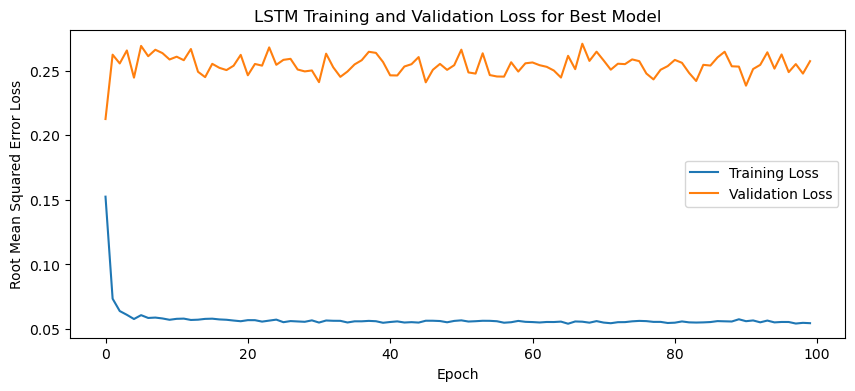

1/1 - 3s - loss: 0.0429 - 3s/epoch - 3s/step
Test Loss: 0.04292501509189606
1/1 [==============================] - 0s 63ms/step


IndexError: index 10 is out of bounds for axis 0 with size 10

In [3]:
n_batch = 1
nb_epoch = 100

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
 
# fit an LSTM network to training data
#Adapted from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch):

    cv_accuracies = []
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters to be tuned by Optuna (taken from Javier Leon's dissertation 'Fruit Prices')
    lr = trial.suggest_float('lr', 1e-3, 1, log=True)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD'])
    if optimizer_name == 'Adam':
        optimizer = Adam(learning_rate=lr)
    elif optimizer_name == 'RMSprop':
        optimizer = RMSprop(learning_rate=lr)
    else:
        optimizer = SGD(learning_rate=lr)
    
    #Optuna will try either Rectified Linear Unit (ReLU) = max(0, x), tanh, or sigmoid functions
    activation_function = trial.suggest_categorical('activation_function', ['relu', 'tanh', 'sigmoid'])
    
    lstm_units = trial.suggest_categorical('lstm_units', [256, 512, 1024])
    dropout_rate = trial.suggest_float('dropout_rate', 0.1, 0.5)

    # design network
    model = Sequential()
    model.add(LSTM(lstm_units, return_sequences=True, batch_input_shape=(n_batch, X.shape[1], X.shape[2]), stateful=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer)
        
    return model

# make forecast with the CNN-LSTM best model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # invert first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # propagate difference forecast using inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create array from forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test):
    # plot the entire dataset in blue
    plt.plot(series.values)
    # plot the forecasts in red
    for i in range(len(forecasts)):
        off_s = len(series) - n_test + i - 1
        off_e = off_s + len(forecasts[i]) + 1
        xaxis = [x for x in range(off_s, off_e)]
        yaxis = [series.values[off_s]] + forecasts[i]
        plt.plot(xaxis, yaxis, color='red')
    # show the plot
    plt.show()
    
def objective(trial):
    
    cv_accuracies = []
        
    for i in range(5):
        train1 = train[i]
        test1 = test[i]
        validation1 = validation[i]

        X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
        X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
        X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
        X = X.reshape(X.shape[0], 1, X.shape[1])
        X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
        X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])
    
        model = create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch)

        history = model.fit(X, y, validation_data=(X_val, y_val), epochs=nb_epoch, verbose=0)

        cv_accuracy = model.evaluate(X_test, y_test, verbose=0)
    
        loss = history.history['val_loss'][-1]
    
        # Plotting the training and validation loss
        #plt.figure(figsize=(10, 4))
        #plt.plot(history.history['loss'], label='Training Loss')
        #plt.plot(history.history['val_loss'], label='Validation Loss')
        #title1 = "LSTM Training and Validation Loss for Fold " + str(i+1)
        #plt.title(title1)
        #plt.xlabel('Epoch')
        #plt.ylabel('Root Mean Squared Error Loss')
        #plt.legend()
        #plt.show()
            
        cv_accuracies.append(cv_accuracy)
    
    print("Cross Validation Accuracies:")
    print(cv_accuracies)
    print("Mean Cross Validation Accuracy:")
    print(np.mean(cv_accuracies))
    print("Standard Deviation of Cross Validation Accuracy:")
    print(np.std(cv_accuracies))
        
    return np.mean(cv_accuracies)

n_batch = 1
nb_epoch = 100

# optimize and fit model
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100)
print('Number of finished trials:', len(study.trials))

print('Best trial:', study.best_trial.params)
best_params = study.best_params
print("Best hyperparameters: ", best_params)

for i in range(5):
    print("Fold "+str(i+1)+":")
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
    X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
    X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq]

    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    series = pd.Series(dataset[:, 0]) # Using first column (temperatures)
    
    X = X.reshape(X.shape[0], 1, X.shape[1])
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_model(optuna.trial.FixedTrial(best_params), X, y, n_lag, n_seq, n_batch, nb_epoch)
    history=best_model.fit(X, y, epochs=nb_epoch, batch_size=n_batch, validation_data=(X_val, y_val))

    # Plotting the training and validation loss
    plt.figure(figsize=(10, 4))
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title1 = "LSTM Training and Validation Loss for Best Model"
    plt.title(title1)
    plt.xlabel('Epoch')
    plt.ylabel('Root Mean Squared Error Loss')
    plt.legend()
    plt.show()

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction
    
    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    for j in range(len(X_test)):
        print("Weather Station "+str(j+1)+":")
        dataset_df = pd.DataFrame(y_test[j].flatten())
        dataset = dataset_df.values
        dataset = dataset[:, 0]
        dataset = np.array(dataset).reshape(-1, 1)
        dataset = dataset.flatten()
        dataset = pd.DataFrame(dataset)
        series = scaler[i].inverse_transform(dataset)
        series = pd.Series(series.flatten())

    # plot forecasts
    plot_forecasts(series, forecasts, 1)
    
    best_model.summary()

    # Print out table of actual and predicted values for each weather station
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual Temp\tPredicted Temp\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")

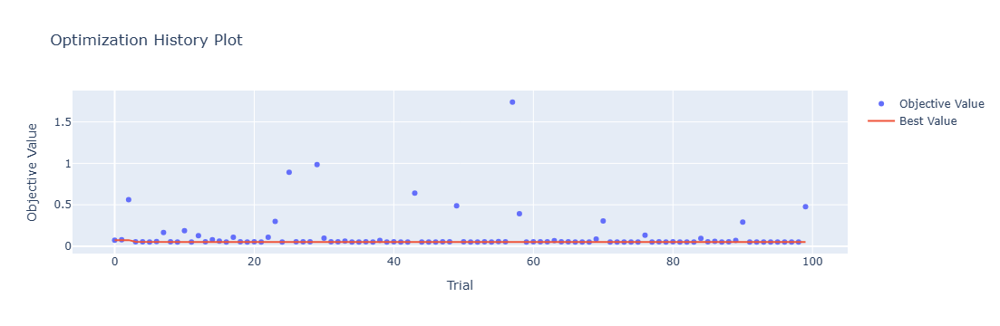

In [4]:
optuna.visualization.plot_optimization_history(study)

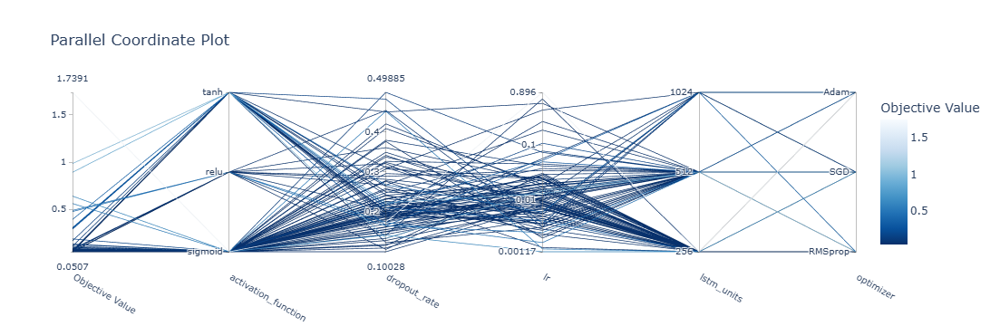

In [5]:
optuna.visualization.plot_parallel_coordinate(study)

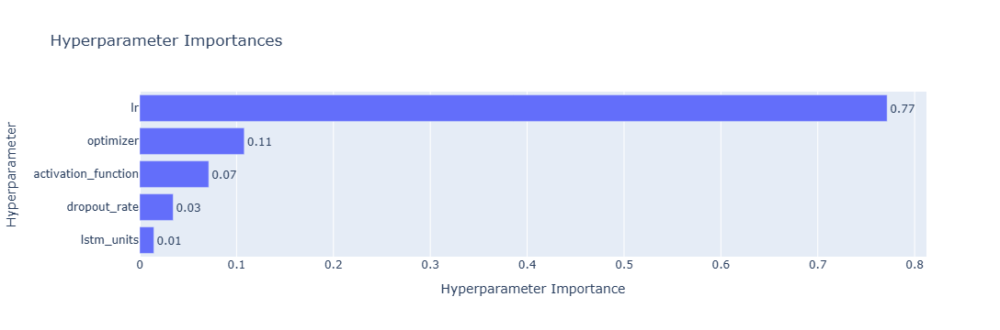

In [6]:
optuna.visualization.plot_param_importances(study)

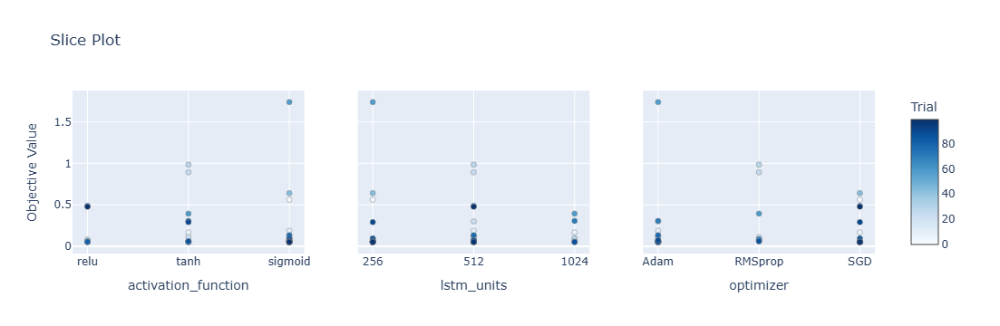

In [7]:
optuna.visualization.plot_slice(study, params=['optimizer', 'activation_function', 'lstm_units'])

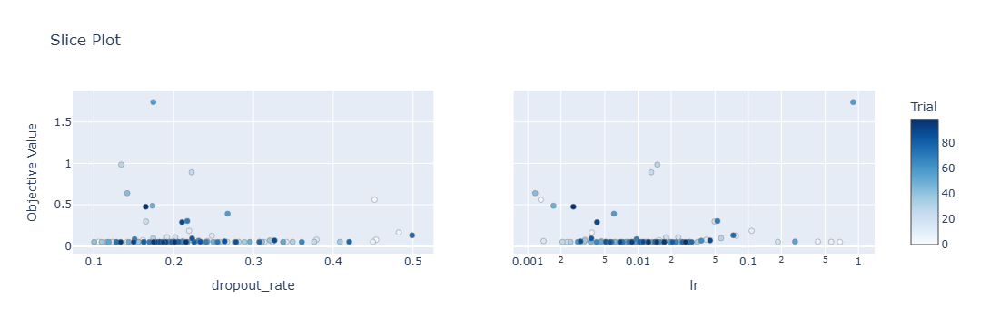

In [8]:
optuna.visualization.plot_slice(study, params=['lr', 'dropout_rate'])

[[12.21  8.17 15.68 ... 23.86 20.59 15.82]
 [14.52 12.85 16.77 ... 26.49 23.17 21.15]
 [ 8.91  6.23 11.39 ... 22.62 16.72 14.05]
 ...
 [ 7.87  5.76 10.62 ... 21.07 15.24 12.04]
 [ 6.49  2.73  9.77 ... 21.93 16.5  11.44]
 [ 5.29  1.27  5.84 ... 22.11 15.37  9.87]]
Epoch 1/100
84/84 [==============================] - 40s 239ms/step - loss: 0.1415 - accuracy: 0.1786 - mae: 0.1155 - rmse: 0.1415 - mape: inf - pearson: 0.5988 - val_loss: 0.0926 - val_accuracy: 0.4000 - val_mae: 0.0734 - val_rmse: 0.0926 - val_mape: 16.7492 - val_pearson: 0.7272
Epoch 2/100
84/84 [==============================] - 15s 181ms/step - loss: 0.0788 - accuracy: 0.4286 - mae: 0.0636 - rmse: 0.0788 - mape: inf - pearson: 0.7929 - val_loss: 0.0659 - val_accuracy: 0.4000 - val_mae: 0.0528 - val_rmse: 0.0659 - val_mape: 11.2729 - val_pearson: 0.8278
Epoch 3/100
84/84 [==============================] - 15s 175ms/step - loss: 0.0615 - accuracy: 0.5357 - mae: 0.0490 - rmse: 0.0615 - mape: inf - pearson: 0.8371 - val_loss:

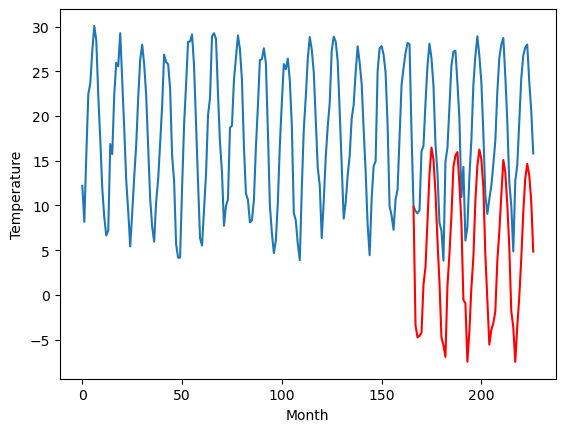

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.39		3.53		0.14
2.49		2.18		-0.31
2.11		2.33		0.22
2.86		2.72		-0.14
8.69		8.09		-0.60
9.18		10.03		0.85
11.95		15.16		3.21
15.70		20.45		4.75
16.18		23.39		7.21
16.81		22.09		5.28
13.83		18.38		4.55
11.20		13.00		1.80
7.78		8.34		0.56
0.57		2.16		1.59
1.23		1.29		0.06
1.14		-0.01		-1.15
6.20		7.90		1.70
7.60		11.49		3.89
11.62		15.79		4.17
15.10		21.23		6.13
16.32		22.50		6.18
16.66		22.90		6.24
14.53		19.30		4.77
11.90		15.06		3.16
6.39		6.35		-0.04
6.15		6.01		-0.14
-0.53		-0.56		-0.03
2.24		2.89		0.65
6.10		7.72		1.62
9.07		11.13		2.06
13.38		17.42		4.04
17.07		21.37		4.30
17.21		23.18		5.97
16.66		22.08		5.42
15.64		18.99		3.35
10.04		11.43		1.39
7.35		6.41		-0.94
3.50		1.36		-2.14
4.29		3.00		-1.29
5.39		3.77		-1.62
6.98		5.07		-1.91
9.13		10.73		1.60
12.31		13.99		1.68
15.39		18.04		2.65
17.22		22.01		4.79
18.81		20.63		1.82
15.43		17.07		1.64
10.32		12.25		1.93
5.08		5.08		-0.00
2.38

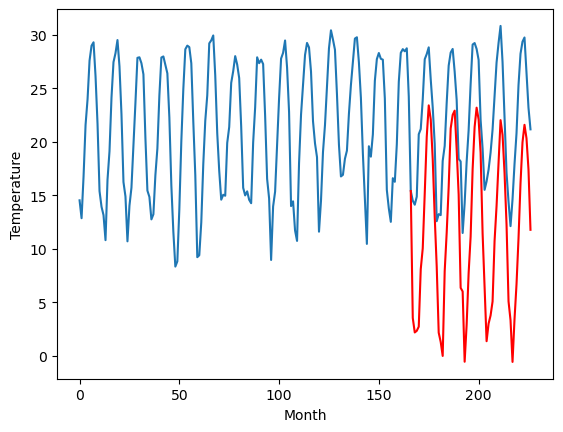

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.93		5.84		0.91
4.82		4.49		-0.33
4.20		4.64		0.44
4.82		5.03		0.21
11.07		10.40		-0.67
10.83		12.34		1.51
14.52		17.47		2.95
18.24		22.76		4.52
20.61		25.70		5.09
19.85		24.40		4.55
16.46		20.69		4.23
12.74		15.31		2.57
7.81		10.65		2.84
0.81		4.47		3.66
1.63		3.60		1.97
2.49		2.30		-0.19
8.47		10.21		1.74
10.11		13.80		3.69
14.09		18.10		4.01
18.23		23.54		5.31
19.99		24.81		4.82
20.27		25.21		4.94
16.70		21.61		4.91
12.82		17.37		4.55
4.46		8.66		4.20
6.64		8.32		1.68
0.63		1.75		1.12
4.58		5.20		0.62
8.08		10.03		1.95
10.82		13.44		2.62
16.58		19.73		3.15
20.36		23.68		3.32
21.28		25.49		4.21
20.05		24.39		4.34
16.93		21.30		4.37
9.79		13.74		3.95
7.31		8.72		1.41
2.79		3.67		0.88
4.74		5.31		0.57
7.52		6.08		-1.44
7.50		7.38		-0.12
10.57		13.04		2.47
13.98		16.30		2.32
17.30		20.35		3.05
20.40		24.32		3.92
20.01		22.94		2.93
16.56		19.38		2.82
10.58		14.56		3.98
5.49		7.39		1.90
2.46		5

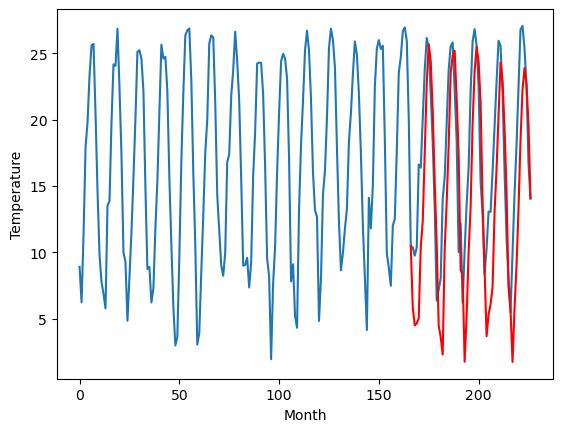

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.13		0.23		-0.90
1.11		-1.12		-2.23
1.15		-0.97		-2.12
1.15		-0.58		-1.73
8.07		4.79		-3.28
8.15		6.73		-1.42
11.04		11.86		0.82
13.95		17.15		3.20
14.92		20.09		5.17
15.26		18.79		3.53
12.93		15.08		2.15
8.87		9.70		0.83
6.03		5.04		-0.99
-1.43		-1.14		0.29
-1.34		-2.01		-0.67
-2.91		-3.31		-0.40
5.00		4.60		-0.40
6.79		8.19		1.40
10.76		12.49		1.73
14.04		17.93		3.89
14.67		19.20		4.53
14.72		19.60		4.88
12.21		16.00		3.79
9.90		11.76		1.86
1.81		3.05		1.24
4.58		2.71		-1.87
-2.77		-3.86		-1.09
-0.33		-0.41		-0.08
3.46		4.42		0.96
8.25		7.83		-0.42
12.77		14.12		1.35
15.20		18.07		2.87
15.18		19.88		4.70
13.99		18.78		4.79
12.75		15.69		2.94
7.13		8.13		1.00
3.02		3.11		0.09
0.84		-1.94		-2.78
2.28		-0.30		-2.58
2.69		0.47		-2.22
6.21		1.77		-4.44
7.63		7.43		-0.20
12.06		10.69		-1.37
15.81		14.74		-1.07
16.93		18.71		1.78
18.46		17.33		-1.13
15.02		13.77		-1.25
8.77		8.95		0.18
2.91		1.78

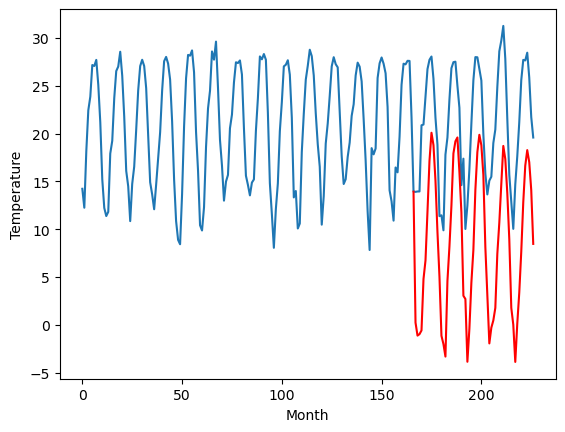

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
7.34		5.55		-1.79
5.29		4.20		-1.09
6.03		4.35		-1.68
5.36		4.74		-0.62
13.11		10.11		-3.00
13.36		12.05		-1.31
18.34		17.18		-1.16
22.54		22.47		-0.07
24.15		25.41		1.26
24.64		24.11		-0.53
18.93		20.40		1.47
14.05		15.02		0.97
11.53		10.36		-1.17
5.06		4.18		-0.88
4.18		3.31		-0.87
1.09		2.01		0.92
10.99		9.92		-1.07
12.92		13.51		0.59
16.78		17.81		1.03
21.98		23.25		1.27
22.41		24.52		2.11
23.17		24.92		1.75
21.16		21.32		0.16
16.81		17.08		0.27
9.24		8.37		-0.87
11.57		8.03		-3.54
3.12		1.46		-1.66
2.89		4.91		2.02
9.38		9.74		0.36
15.42		13.15		-2.27
20.13		19.44		-0.69
24.47		23.39		-1.08
26.83		25.20		-1.63
24.47		24.10		-0.37
21.52		21.01		-0.51
15.60		13.45		-2.15
8.67		8.43		-0.24
5.94		3.38		-2.56
6.91		5.02		-1.89
7.04		5.79		-1.25
11.76		7.09		-4.67
13.26		12.75		-0.51
18.79		16.01		-2.78
23.34		20.06		-3.28
26.33		24.03		-2.30
28.07		22.65		-5.42
23.59		19.09		-4.50
15.93		14.2

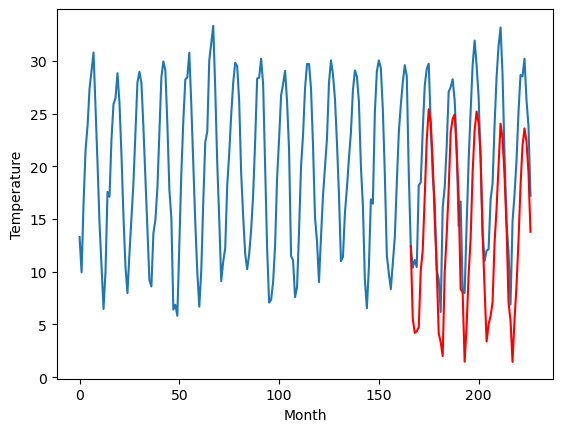

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.63		4.62		-0.01
4.06		3.27		-0.79
3.53		3.42		-0.11
3.22		3.81		0.59
6.81		9.18		2.37
8.78		11.12		2.34
12.47		16.25		3.78
16.82		21.54		4.72
20.56		24.48		3.92
19.71		23.18		3.47
16.68		19.47		2.79
12.59		14.09		1.50
8.47		9.43		0.96
1.72		3.25		1.53
-0.06		2.38		2.44
0.59		1.08		0.49
5.49		8.99		3.50
8.86		12.58		3.72
12.37		16.88		4.51
16.94		22.32		5.38
18.93		23.59		4.66
19.41		23.99		4.58
16.40		20.39		3.99
12.80		16.15		3.35
4.63		7.44		2.81
5.68		7.10		1.42
-0.70		0.53		1.23
2.91		3.98		1.07
6.83		8.81		1.98
9.70		12.22		2.52
14.33		18.51		4.18
17.90		22.46		4.56
20.04		24.27		4.23
19.19		23.17		3.98
16.54		20.08		3.54
9.98		12.52		2.54
8.29		7.50		-0.79
1.77		2.45		0.68
3.46		4.09		0.63
4.95		4.86		-0.09
5.86		6.16		0.30
10.54		11.82		1.28
12.06		15.08		3.02
15.88		19.13		3.25
19.71		23.10		3.39
19.23		21.72		2.49
15.71		18.16		2.45
11.36		13.34		1.98
5.92		6.17		0.25
3.78		4.41		0

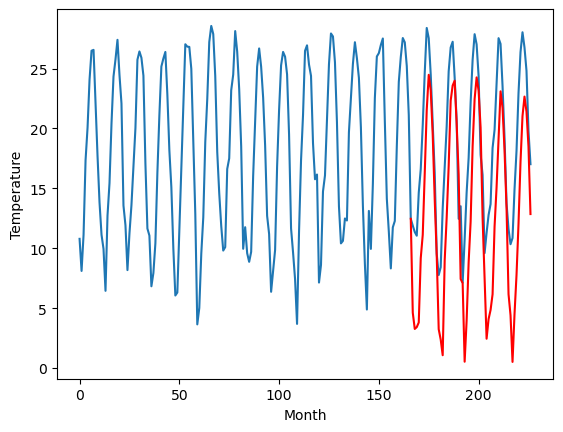

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.68		2.11		1.43
0.32		0.76		0.44
-0.15		0.91		1.06
0.96		1.30		0.34
6.38		6.67		0.29
7.62		8.61		0.99
9.96		13.74		3.78
15.21		19.03		3.82
18.28		21.97		3.69
17.25		20.67		3.42
13.36		16.96		3.60
9.36		11.58		2.22
5.18		6.92		1.74
-1.75		0.74		2.49
-2.33		-0.13		2.20
-1.69		-1.43		0.26
5.29		6.48		1.19
6.32		10.07		3.75
10.03		14.37		4.34
14.36		19.81		5.45
15.98		21.08		5.10
15.92		21.48		5.56
11.87		17.88		6.01
8.64		13.64		5.00
-0.01		4.93		4.94
1.93		4.59		2.66
-4.72		-1.98		2.74
-0.74		1.47		2.21
3.60		6.30		2.70
6.52		9.71		3.19
11.59		16.00		4.41
15.50		19.95		4.45
16.60		21.76		5.16
15.31		20.66		5.35
12.25		17.57		5.32
5.31		10.01		4.70
3.08		4.99		1.91
-3.43		-0.06		3.37
-0.24		1.58		1.82
2.76		2.35		-0.41
3.24		3.65		0.41
6.80		9.31		2.51
9.49		12.57		3.08
12.84		16.62		3.78
16.55		20.59		4.04
15.86		19.21		3.35
12.35		15.65		3.30
7.14		10.83		3.69
1.27		3.66		2.39
-1.02		1.90		2.

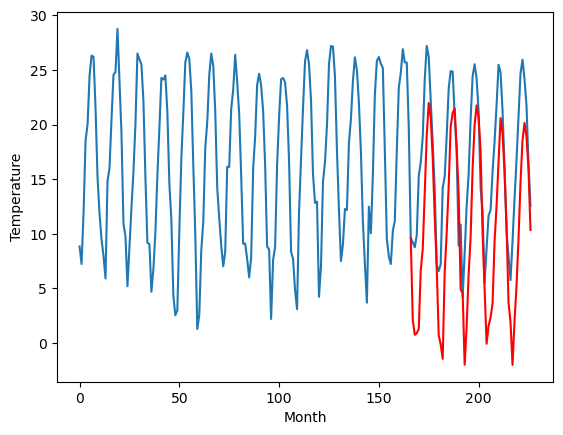

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.37		0.17		1.54
-1.74		-1.18		0.56
-1.86		-1.03		0.83
-0.82		-0.64		0.18
4.76		4.73		-0.03
5.66		6.67		1.01
8.78		11.80		3.02
14.30		17.09		2.79
17.56		20.03		2.47
16.19		18.73		2.54
11.32		15.02		3.70
7.48		9.64		2.16
3.25		4.98		1.73
-3.68		-1.20		2.48
-4.62		-2.07		2.55
-4.00		-3.37		0.63
2.52		4.54		2.02
6.15		8.13		1.98
9.17		12.43		3.26
13.96		17.87		3.91
16.08		19.14		3.06
16.03		19.54		3.51
11.52		15.94		4.42
7.67		11.70		4.03
-1.83		2.99		4.82
0.23		2.65		2.42
-6.95		-3.92		3.03
-2.71		-0.47		2.24
2.13		4.36		2.23
5.45		7.77		2.32
10.43		14.06		3.63
14.43		18.01		3.58
16.30		19.82		3.52
14.62		18.72		4.10
10.92		15.63		4.71
3.73		8.07		4.34
1.53		3.05		1.52
-5.64		-2.00		3.64
-2.47		-0.36		2.11
0.50		0.41		-0.09
1.18		1.71		0.53
5.80		7.37		1.57
8.09		10.63		2.54
11.84		14.68		2.84
15.98		18.65		2.67
14.84		17.27		2.43
11.08		13.71		2.63
5.69		8.89		3.20
-0.76		1.72		2.48
-2.35		-0

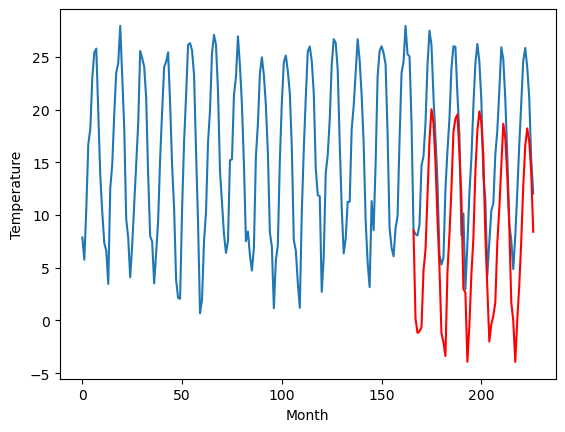

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.95		-0.81		0.14
-1.11		-2.16		-1.05
-2.30		-2.01		0.29
-1.80		-1.62		0.18
4.77		3.75		-1.02
7.05		5.69		-1.36
11.93		10.82		-1.11
17.86		16.11		-1.75
20.60		19.05		-1.55
17.59		17.75		0.16
14.03		14.04		0.01
6.77		8.66		1.89
3.91		4.00		0.09
-2.80		-2.18		0.62
-3.59		-3.05		0.54
-7.86		-4.35		3.51
4.61		3.56		-1.05
7.21		7.15		-0.06
11.90		11.45		-0.45
18.09		16.89		-1.20
18.66		18.16		-0.50
18.60		18.56		-0.04
14.86		14.96		0.10
10.90		10.72		-0.18
0.86		2.01		1.15
2.66		1.67		-0.99
-5.85		-4.90		0.95
-3.81		-1.45		2.36
3.41		3.38		-0.03
7.36		6.79		-0.57
14.20		13.08		-1.12
18.72		17.03		-1.69
21.05		18.84		-2.21
18.17		17.74		-0.43
14.53		14.65		0.12
7.97		7.09		-0.88
2.00		2.07		0.07
-3.29		-2.98		0.31
-0.73		-1.34		-0.61
0.88		-0.57		-1.45
2.70		0.73		-1.97
8.48		6.39		-2.09
14.07		9.65		-4.42
17.94		13.70		-4.24
19.43		17.67		-1.76
18.17		16.29		-1.88
15.00		12.73		-2.27
9.40		7.91		

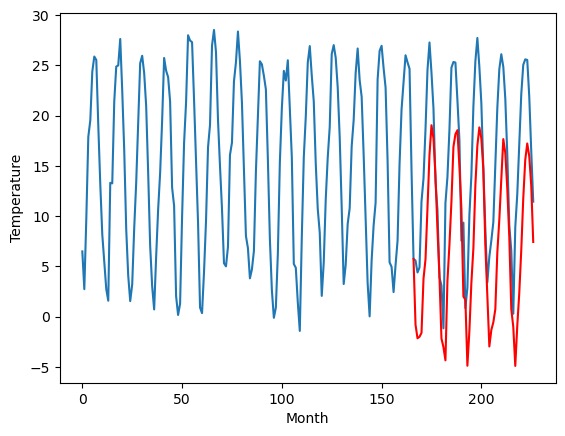

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-4.56		-2.19		2.37
-4.38		-3.54		0.84
-5.66		-3.39		2.27
-6.53		-3.00		3.53
0.66		2.37		1.71
2.32		4.31		1.99
7.41		9.44		2.03
14.39		14.73		0.34
17.02		17.67		0.65
14.64		16.37		1.73
10.97		12.66		1.69
4.58		7.28		2.70
0.90		2.62		1.72
-6.61		-3.56		3.05
-8.20		-4.43		3.77
-10.37		-5.73		4.64
0.38		2.18		1.80
3.44		5.77		2.33
7.91		10.07		2.16
14.39		15.51		1.12
15.40		16.78		1.38
16.00		17.18		1.18
12.14		13.58		1.44
7.67		9.34		1.67
-2.99		0.63		3.62
-1.76		0.29		2.05
-10.73		-6.28		4.45
-7.15		-2.83		4.32
-0.17		2.00		2.17
2.56		5.41		2.85
10.73		11.70		0.97
14.63		15.65		1.02
16.66		17.46		0.80
14.75		16.36		1.61
11.02		13.27		2.25
3.98		5.71		1.73
-1.04		0.69		1.73
-6.75		-4.36		2.39
-4.86		-2.72		2.14
-2.82		-1.95		0.87
-2.48		-0.65		1.83
3.80		5.01		1.21
8.76		8.27		-0.49
12.60		12.32		-0.28
15.43		16.29		0.86
14.63		14.91		0.28
12.02		11.35		-0.67
5.44		6.53		1.09
-1.06		-0.64		0.42

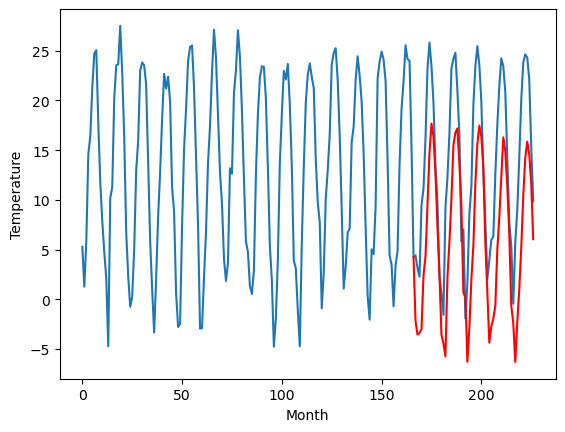

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-5.06		-3.39		1.67
-5.73		-4.74		0.99
-6.76		-4.59		2.17
-8.22		-4.20		4.02
-2.08		1.17		3.25
0.57		3.11		2.54
7.00		8.24		1.24
14.96		13.53		-1.43
18.12		16.47		-1.65
15.43		15.17		-0.26
10.60		11.46		0.86
3.85		6.08		2.23
0.37		1.42		1.05
-6.66		-4.76		1.90
-8.27		-5.63		2.64
-12.58		-6.93		5.65
-0.85		0.98		1.83
3.12		4.57		1.45
8.27		8.87		0.60
15.58		14.31		-1.27
16.17		15.58		-0.59
16.88		15.98		-0.90
12.83		12.38		-0.45
8.48		8.14		-0.34
-2.38		-0.57		1.81
-3.28		-0.91		2.37
-12.23		-7.48		4.75
-8.99		-4.03		4.96
-2.08		0.80		2.88
1.53		4.21		2.68
10.85		10.50		-0.35
15.61		14.45		-1.16
16.72		16.26		-0.46
15.60		15.16		-0.44
11.76		12.07		0.31
4.52		4.51		-0.01
-0.51		-0.51		-0.00
-6.69		-5.56		1.13
-5.56		-3.92		1.64
-5.15		-3.15		2.00
-3.29		-1.85		1.44
3.56		3.81		0.25
8.58		7.07		-1.51
14.09		11.12		-2.97
16.55		15.09		-1.46
14.74		13.71		-1.03
12.36		10.15		-2.21
6.40		5.33		-1.

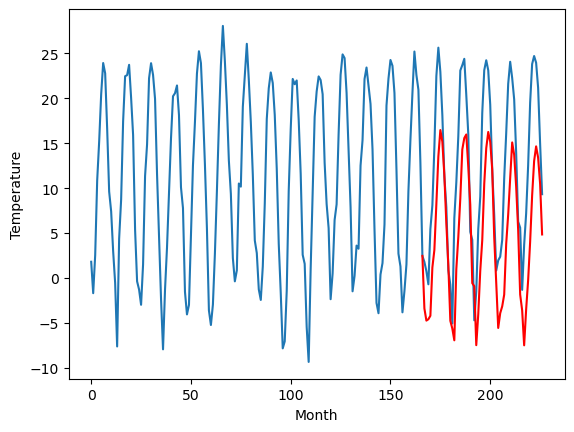

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -2.98  -3.385745
1                 1    3.39   3.534255
2                 2    4.93   5.844255
3                 3    1.13   0.234255
4                 4    7.34   5.554255
5                 5    4.63   4.624255
6                 6    0.68   2.114255
7                 7   -1.37   0.174255
8                 8   -0.95  -0.805745
9                 9   -4.56  -2.185745
10               10   -5.06  -3.385745


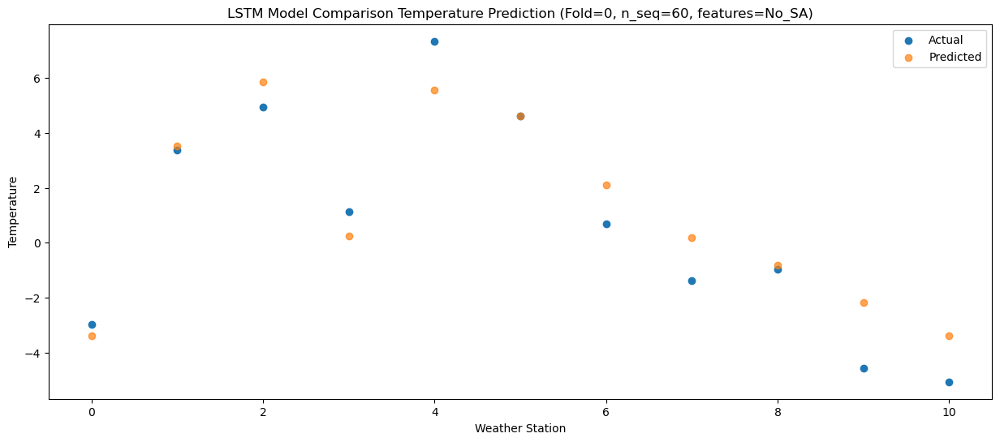

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -3.45  -4.740639
1                 1    2.49   2.179361
2                 2    4.82   4.489361
3                 3    1.11  -1.120639
4                 4    5.29   4.199361
5                 5    4.06   3.269360
6                 6    0.32   0.759360
7                 7   -1.74  -1.180640
8                 8   -1.11  -2.160639
9                 9   -4.38  -3.540640
10               10   -5.73  -4.740639


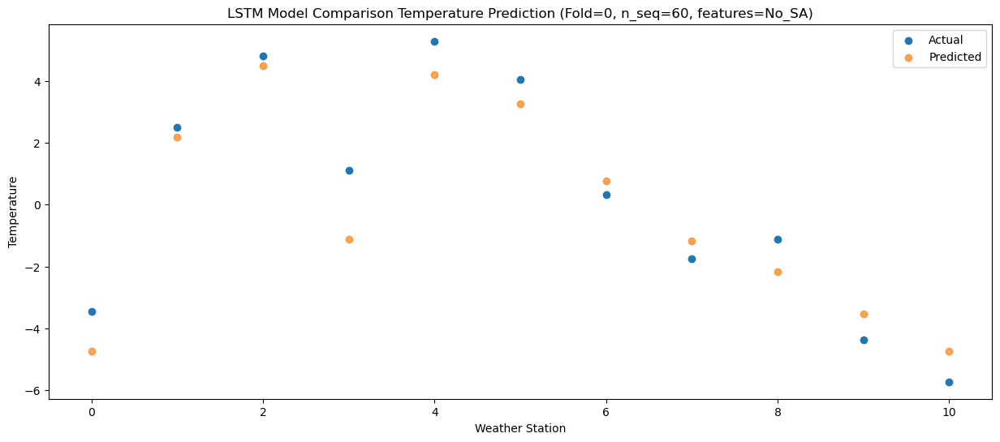

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -3.72  -4.588786
1                 1    2.11   2.331214
2                 2    4.20   4.641214
3                 3    1.15  -0.968786
4                 4    6.03   4.351214
5                 5    3.53   3.421213
6                 6   -0.15   0.911213
7                 7   -1.86  -1.028787
8                 8   -2.30  -2.008786
9                 9   -5.66  -3.388787
10               10   -6.76  -4.588786


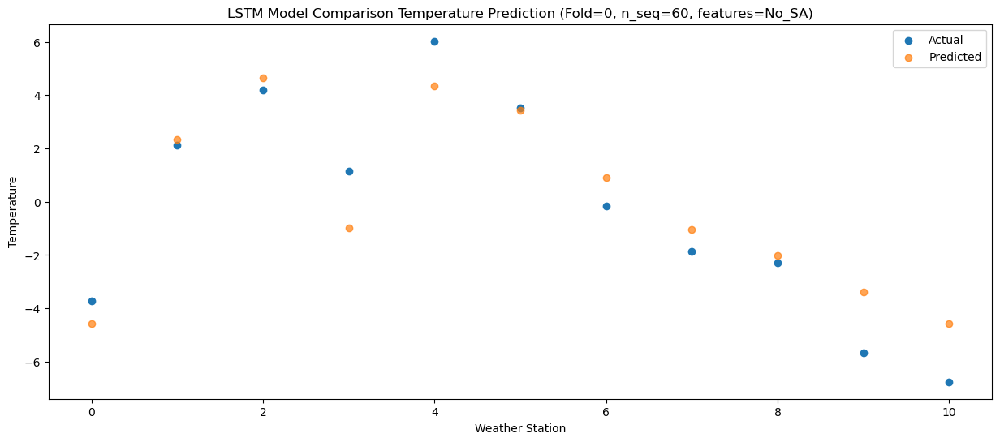

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -3.37  -4.201984
1                 1    2.86   2.718016
2                 2    4.82   5.028016
3                 3    1.15  -0.581984
4                 4    5.36   4.738016
5                 5    3.22   3.808015
6                 6    0.96   1.298015
7                 7   -0.82  -0.641985
8                 8   -1.80  -1.621984
9                 9   -6.53  -3.001985
10               10   -8.22  -4.201984


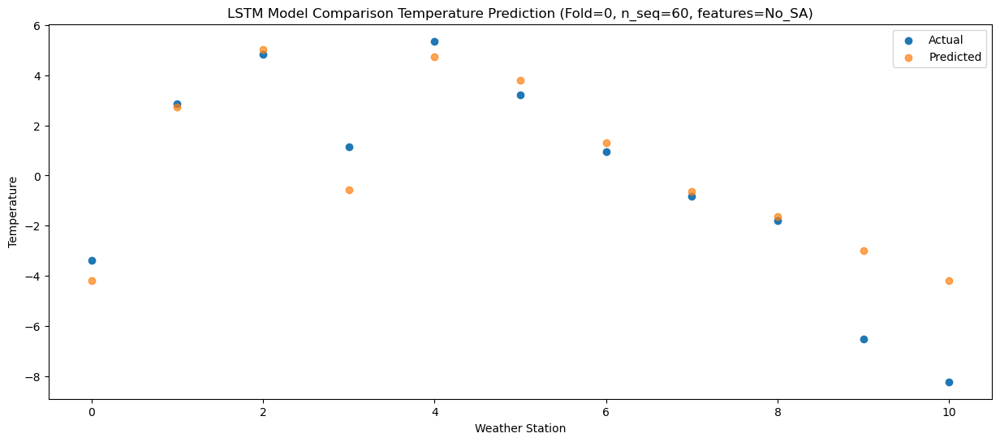

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.21   1.171777
1                 1    8.69   8.091777
2                 2   11.07  10.401777
3                 3    8.07   4.791777
4                 4   13.11  10.111777
5                 5    6.81   9.181776
6                 6    6.38   6.671776
7                 7    4.76   4.731776
8                 8    4.77   3.751777
9                 9    0.66   2.371776
10               10   -2.08   1.171777


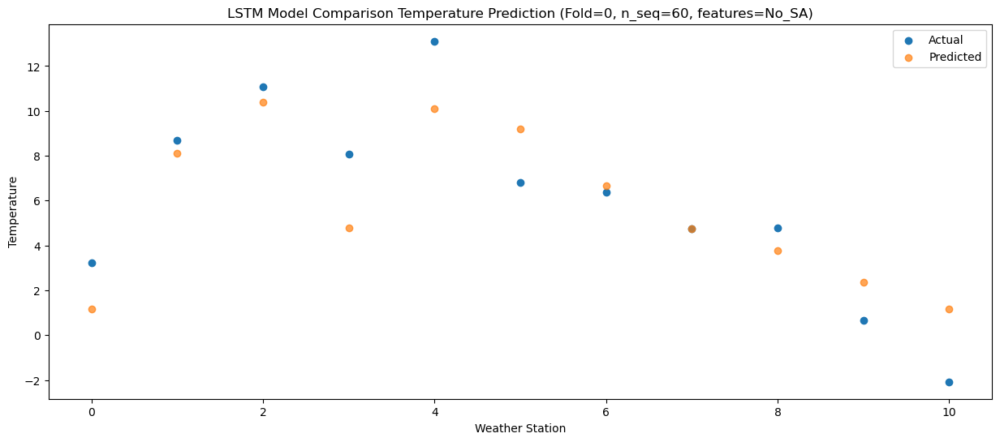

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.86   3.113708
1                 1    9.18  10.033708
2                 2   10.83  12.343708
3                 3    8.15   6.733708
4                 4   13.36  12.053708
5                 5    8.78  11.123707
6                 6    7.62   8.613707
7                 7    5.66   6.673707
8                 8    7.05   5.693708
9                 9    2.32   4.313707
10               10    0.57   3.113708


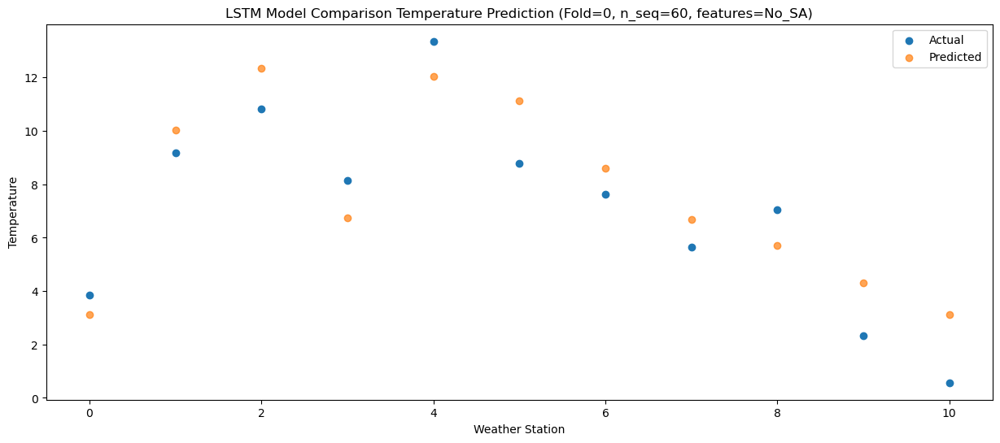

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    8.59   8.241306
1                 1   11.95  15.161306
2                 2   14.52  17.471306
3                 3   11.04  11.861306
4                 4   18.34  17.181306
5                 5   12.47  16.251305
6                 6    9.96  13.741305
7                 7    8.78  11.801305
8                 8   11.93  10.821306
9                 9    7.41   9.441305
10               10    7.00   8.241306


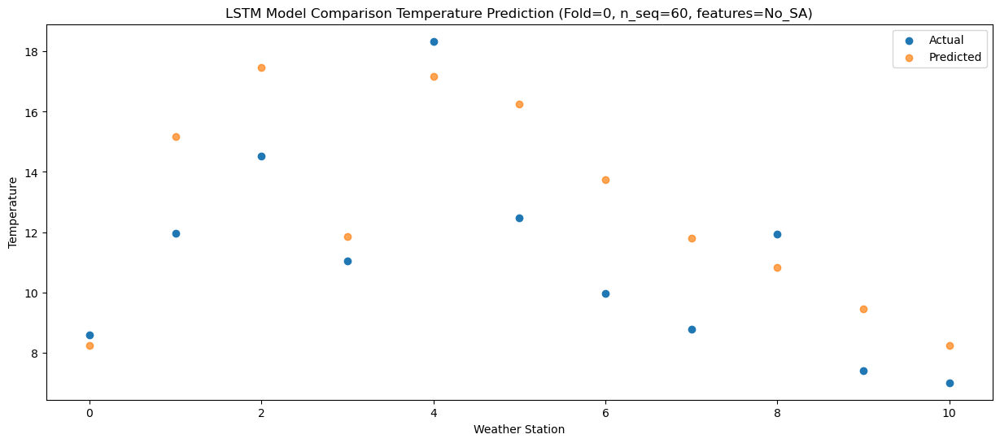

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   12.81  13.529869
1                 1   15.70  20.449869
2                 2   18.24  22.759869
3                 3   13.95  17.149869
4                 4   22.54  22.469869
5                 5   16.82  21.539868
6                 6   15.21  19.029868
7                 7   14.30  17.089868
8                 8   17.86  16.109869
9                 9   14.39  14.729868
10               10   14.96  13.529869


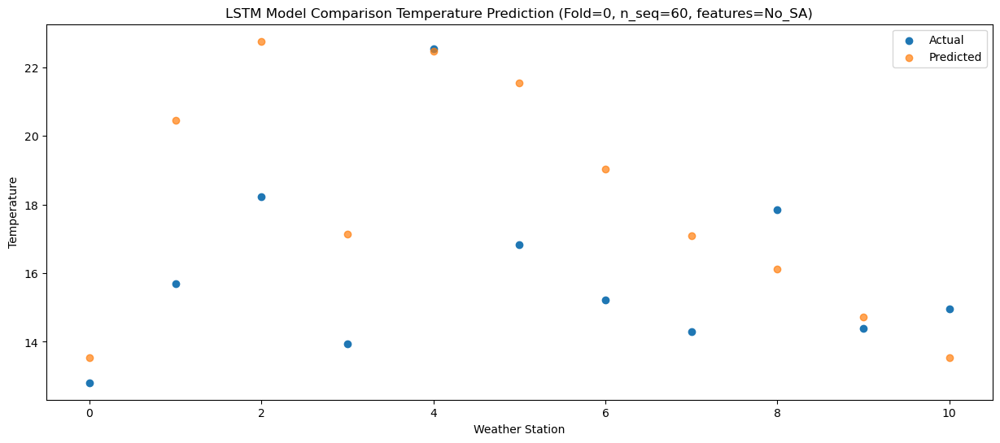

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   15.26  16.469328
1                 1   16.18  23.389328
2                 2   20.61  25.699328
3                 3   14.92  20.089328
4                 4   24.15  25.409328
5                 5   20.56  24.479327
6                 6   18.28  21.969327
7                 7   17.56  20.029327
8                 8   20.60  19.049328
9                 9   17.02  17.669327
10               10   18.12  16.469328


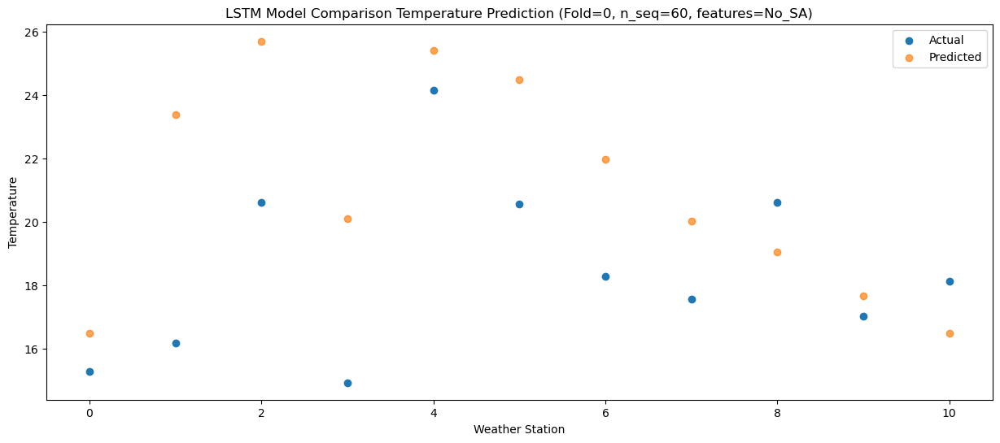

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   13.63  15.172128
1                 1   16.81  22.092128
2                 2   19.85  24.402128
3                 3   15.26  18.792128
4                 4   24.64  24.112128
5                 5   19.71  23.182126
6                 6   17.25  20.672126
7                 7   16.19  18.732126
8                 8   17.59  17.752128
9                 9   14.64  16.372125
10               10   15.43  15.172127


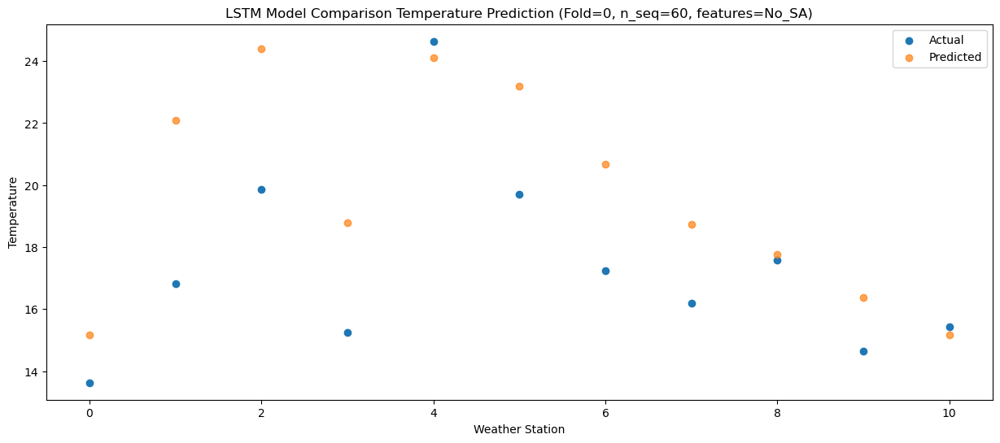

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   10.57  11.461118
1                 1   13.83  18.381118
2                 2   16.46  20.691118
3                 3   12.93  15.081118
4                 4   18.93  20.401118
5                 5   16.68  19.471117
6                 6   13.36  16.961117
7                 7   11.32  15.021117
8                 8   14.03  14.041118
9                 9   10.97  12.661116
10               10   10.60  11.461117


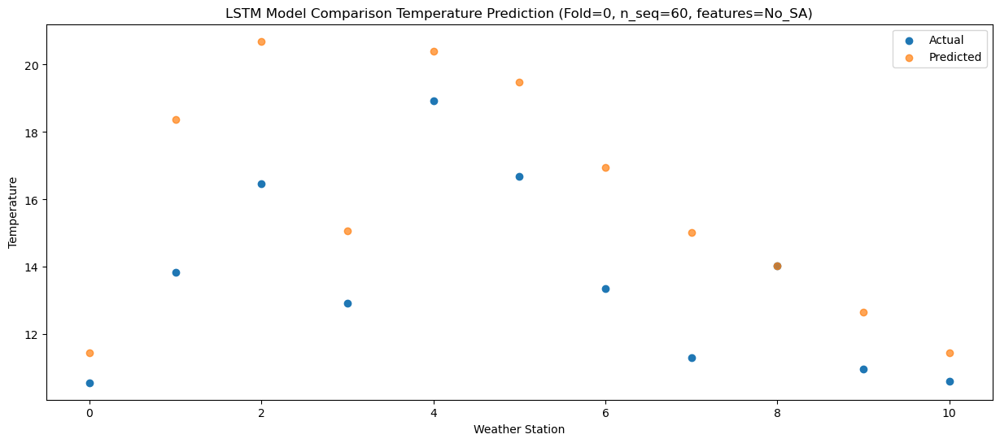

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.07   6.080437
1                 1   11.20  13.000437
2                 2   12.74  15.310437
3                 3    8.87   9.700438
4                 4   14.05  15.020437
5                 5   12.59  14.090437
6                 6    9.36  11.580437
7                 7    7.48   9.640437
8                 8    6.77   8.660437
9                 9    4.58   7.280435
10               10    3.85   6.080436


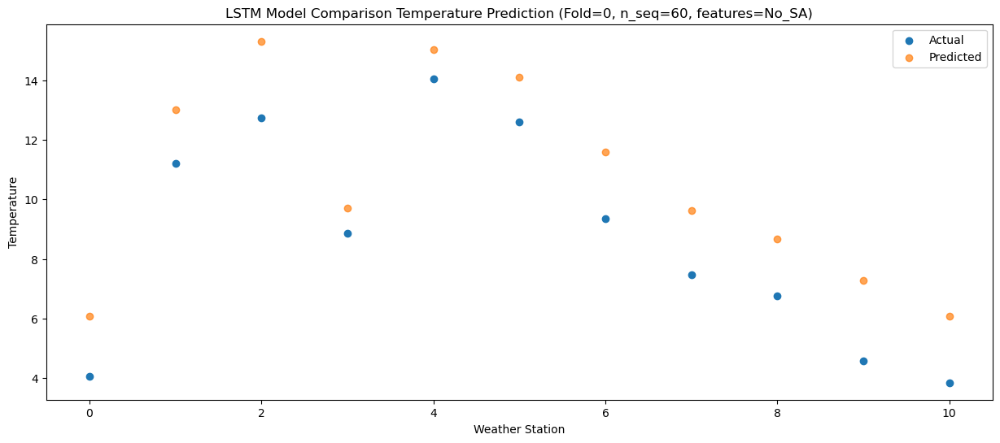

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    0.83   1.421080
1                 1    7.78   8.341080
2                 2    7.81  10.651080
3                 3    6.03   5.041081
4                 4   11.53  10.361080
5                 5    8.47   9.431080
6                 6    5.18   6.921080
7                 7    3.25   4.981080
8                 8    3.91   4.001080
9                 9    0.90   2.621078
10               10    0.37   1.421079


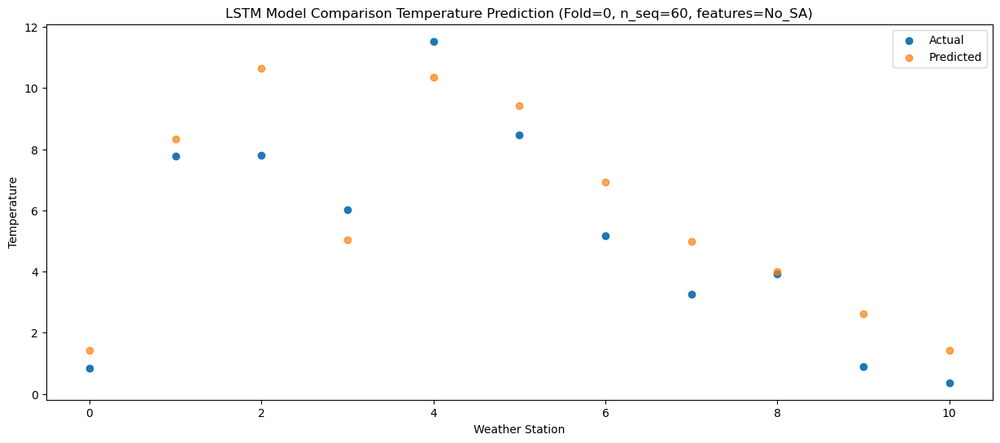

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -4.79  -4.762793
1                 1    0.57   2.157207
2                 2    0.81   4.467207
3                 3   -1.43  -1.142792
4                 4    5.06   4.177207
5                 5    1.72   3.247207
6                 6   -1.75   0.737207
7                 7   -3.68  -1.202793
8                 8   -2.80  -2.182793
9                 9   -6.61  -3.562795
10               10   -6.66  -4.762794


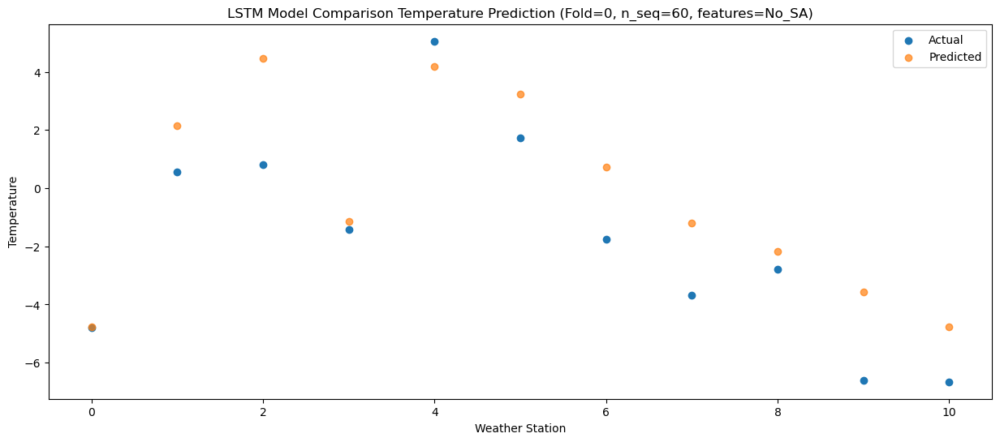

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -5.65  -5.627206
1                 1    1.23   1.292794
2                 2    1.63   3.602794
3                 3   -1.34  -2.007205
4                 4    4.18   3.312794
5                 5   -0.06   2.382794
6                 6   -2.33  -0.127206
7                 7   -4.62  -2.067206
8                 8   -3.59  -3.047206
9                 9   -8.20  -4.427208
10               10   -8.27  -5.627207


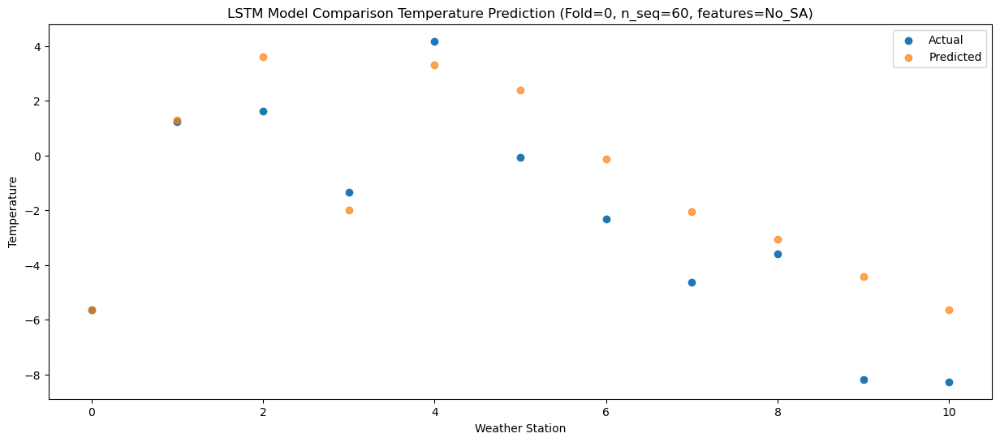

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -9.00  -6.934463
1                 1    1.14  -0.014463
2                 2    2.49   2.295537
3                 3   -2.91  -3.314462
4                 4    1.09   2.005537
5                 5    0.59   1.075537
6                 6   -1.69  -1.434463
7                 7   -4.00  -3.374463
8                 8   -7.86  -4.354463
9                 9  -10.37  -5.734465
10               10  -12.58  -6.934463


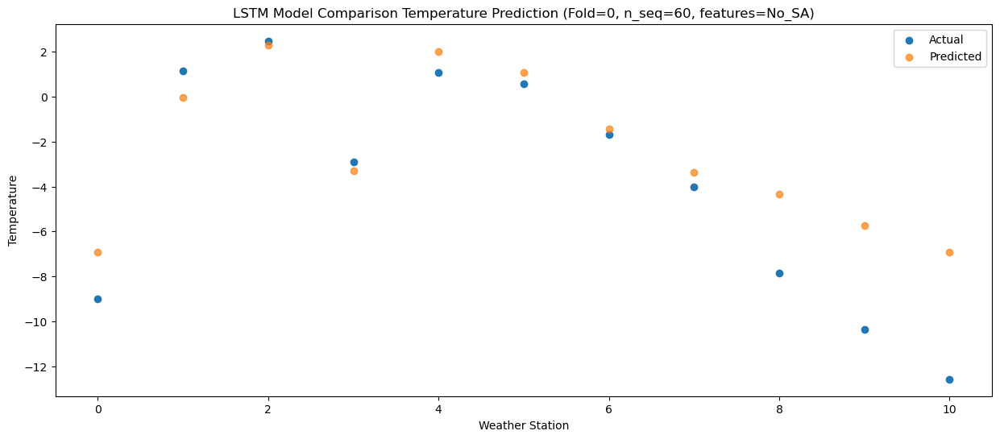

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.07   0.981340
1                 1    6.20   7.901340
2                 2    8.47  10.211340
3                 3    5.00   4.601341
4                 4   10.99   9.921340
5                 5    5.49   8.991340
6                 6    5.29   6.481340
7                 7    2.52   4.541340
8                 8    4.61   3.561340
9                 9    0.38   2.181338
10               10   -0.85   0.981339


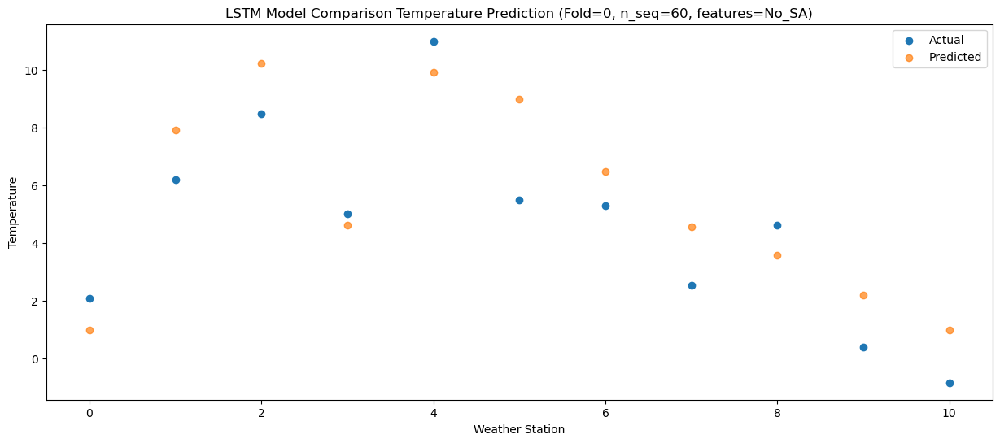

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    3.60   4.568130
1                 1    7.60  11.488130
2                 2   10.11  13.798130
3                 3    6.79   8.188131
4                 4   12.92  13.508130
5                 5    8.86  12.578130
6                 6    6.32  10.068130
7                 7    6.15   8.128130
8                 8    7.21   7.148130
9                 9    3.44   5.768128
10               10    3.12   4.568129


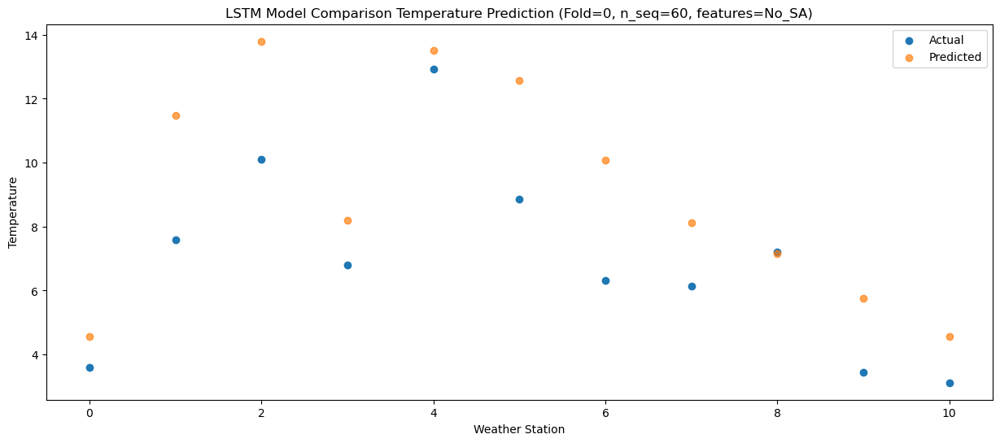

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    8.10   8.865825
1                 1   11.62  15.785825
2                 2   14.09  18.095825
3                 3   10.76  12.485826
4                 4   16.78  17.805825
5                 5   12.37  16.875825
6                 6   10.03  14.365825
7                 7    9.17  12.425825
8                 8   11.90  11.445825
9                 9    7.91  10.065823
10               10    8.27   8.865824


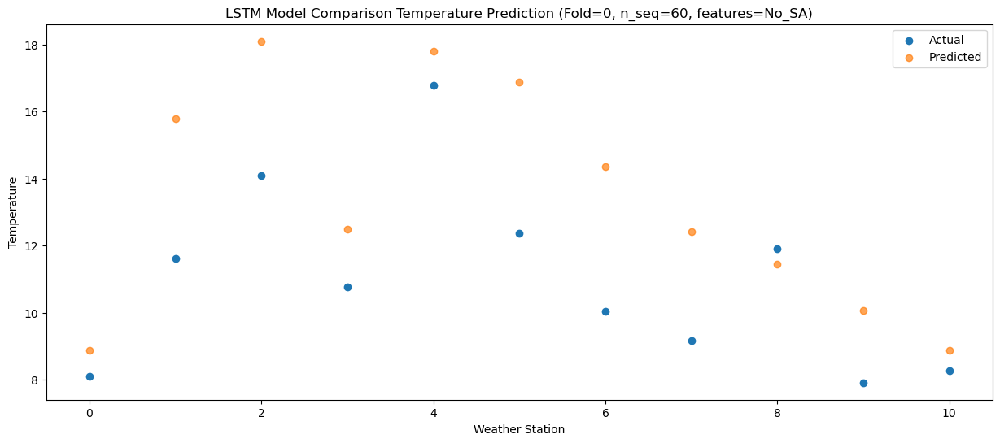

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   12.77  14.312799
1                 1   15.10  21.232799
2                 2   18.23  23.542799
3                 3   14.04  17.932800
4                 4   21.98  23.252799
5                 5   16.94  22.322799
6                 6   14.36  19.812799
7                 7   13.96  17.872799
8                 8   18.09  16.892799
9                 9   14.39  15.512797
10               10   15.58  14.312799


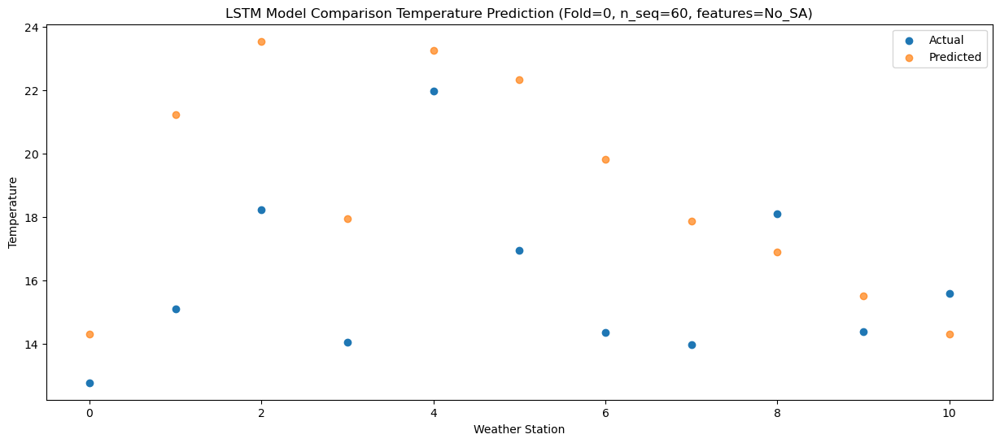

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   14.36  15.578134
1                 1   16.32  22.498134
2                 2   19.99  24.808134
3                 3   14.67  19.198135
4                 4   22.41  24.518134
5                 5   18.93  23.588134
6                 6   15.98  21.078134
7                 7   16.08  19.138134
8                 8   18.66  18.158134
9                 9   15.40  16.778132
10               10   16.17  15.578133


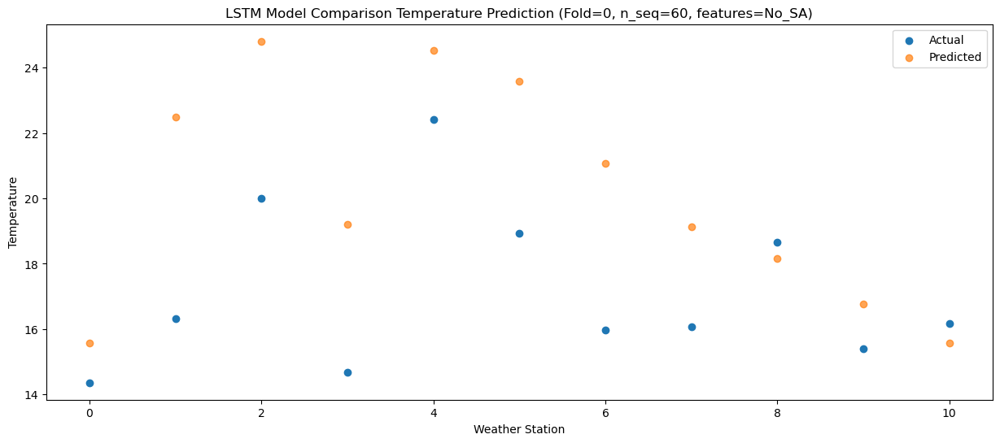

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   14.47  15.976997
1                 1   16.66  22.896997
2                 2   20.27  25.206997
3                 3   14.72  19.596998
4                 4   23.17  24.916997
5                 5   19.41  23.986997
6                 6   15.92  21.476997
7                 7   16.03  19.536997
8                 8   18.60  18.556997
9                 9   16.00  17.176995
10               10   16.88  15.976996


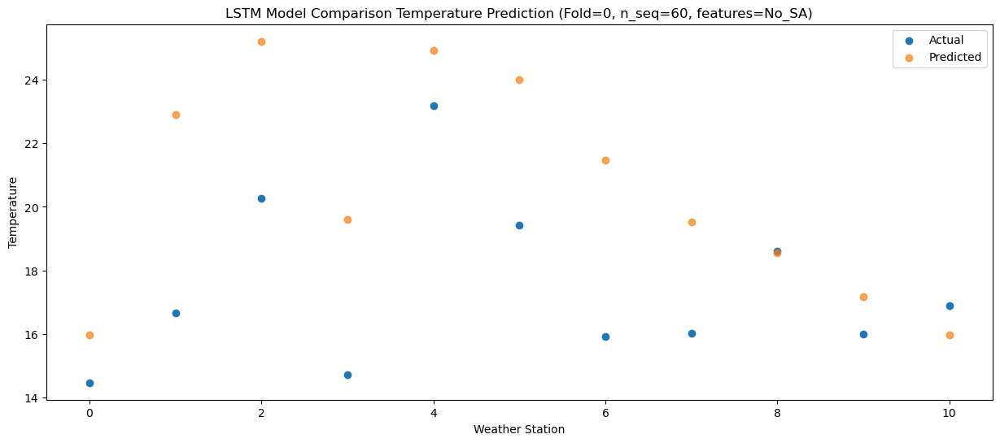

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   10.89  12.376565
1                 1   14.53  19.296565
2                 2   16.70  21.606565
3                 3   12.21  15.996566
4                 4   21.16  21.316565
5                 5   16.40  20.386565
6                 6   11.87  17.876565
7                 7   11.52  15.936565
8                 8   14.86  14.956565
9                 9   12.14  13.576563
10               10   12.83  12.376564


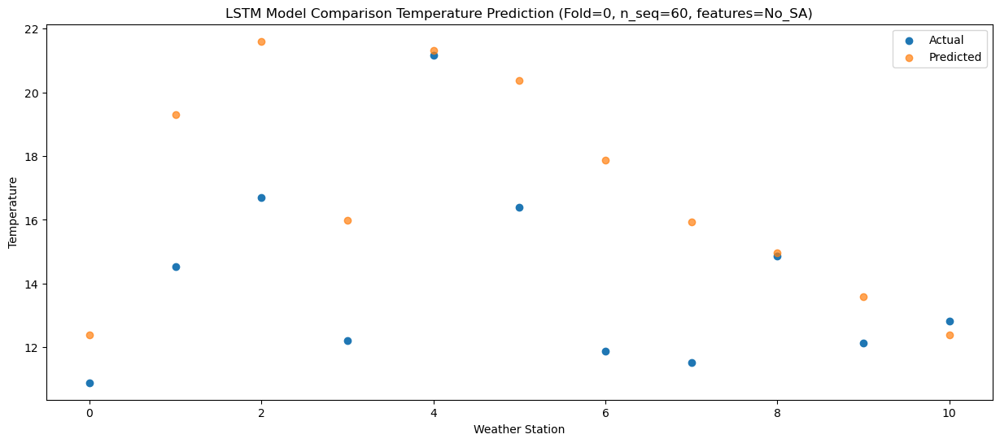

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    6.87   8.136073
1                 1   11.90  15.056073
2                 2   12.82  17.366073
3                 3    9.90  11.756074
4                 4   16.81  17.076073
5                 5   12.80  16.146073
6                 6    8.64  13.636073
7                 7    7.67  11.696073
8                 8   10.90  10.716073
9                 9    7.67   9.336071
10               10    8.48   8.136072


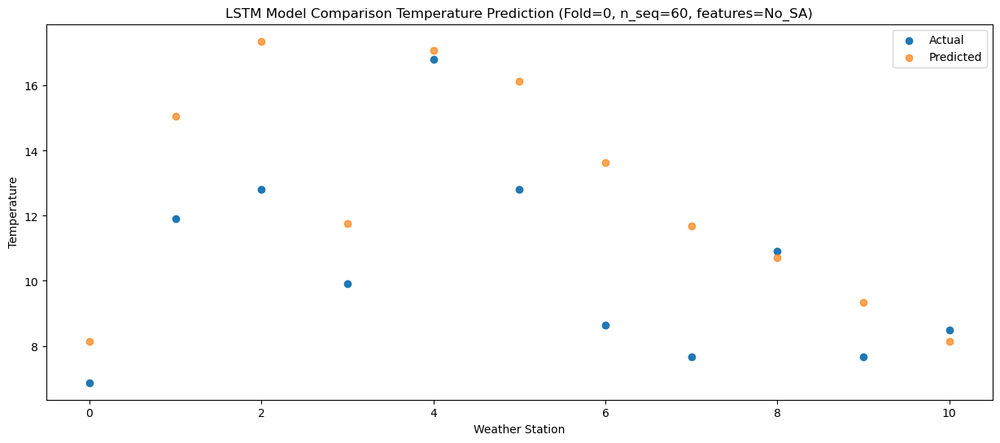

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -1.89  -0.574650
1                 1    6.39   6.345350
2                 2    4.46   8.655350
3                 3    1.81   3.045350
4                 4    9.24   8.365350
5                 5    4.63   7.435350
6                 6   -0.01   4.925350
7                 7   -1.83   2.985350
8                 8    0.86   2.005350
9                 9   -2.99   0.625348
10               10   -2.38  -0.574650


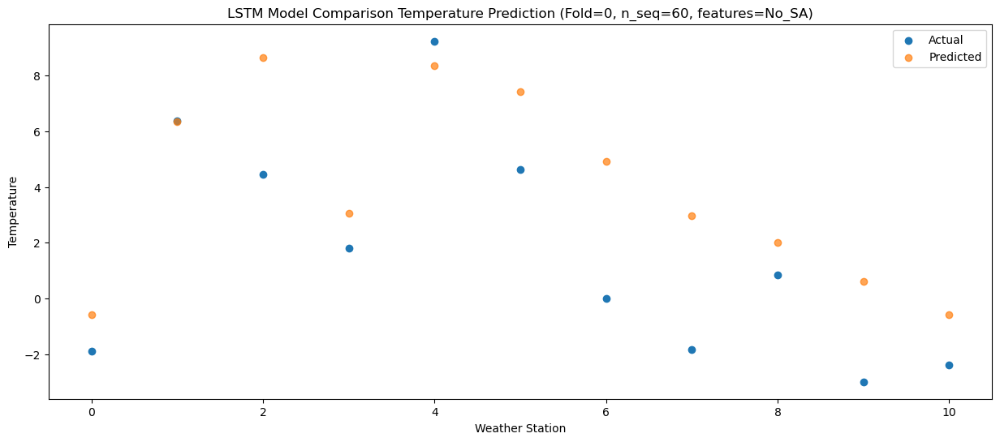

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    1.49  -0.912762
1                 1    6.15   6.007238
2                 2    6.64   8.317238
3                 3    4.58   2.707238
4                 4   11.57   8.027238
5                 5    5.68   7.097238
6                 6    1.93   4.587238
7                 7    0.23   2.647238
8                 8    2.66   1.667238
9                 9   -1.76   0.287236
10               10   -3.28  -0.912763


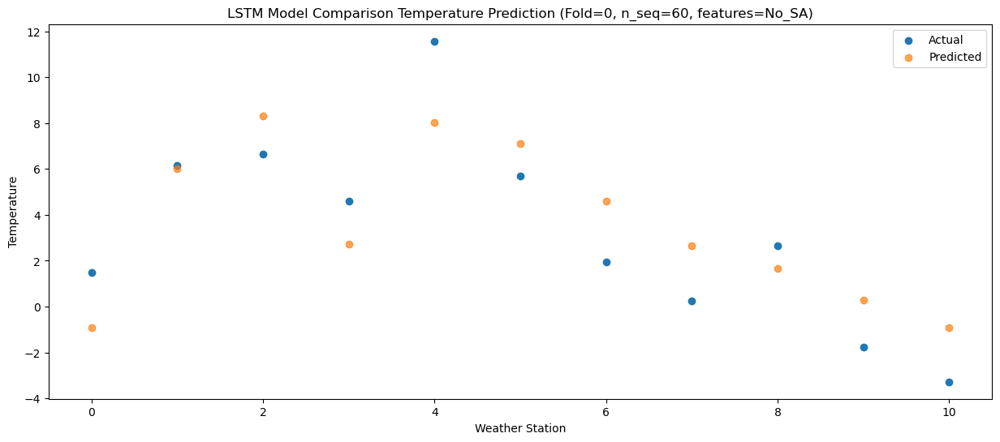

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -6.76  -7.476314
1                 1   -0.53  -0.556314
2                 2    0.63   1.753686
3                 3   -2.77  -3.856314
4                 4    3.12   1.463686
5                 5   -0.70   0.533686
6                 6   -4.72  -1.976314
7                 7   -6.95  -3.916314
8                 8   -5.85  -4.896314
9                 9  -10.73  -6.276316
10               10  -12.23  -7.476315


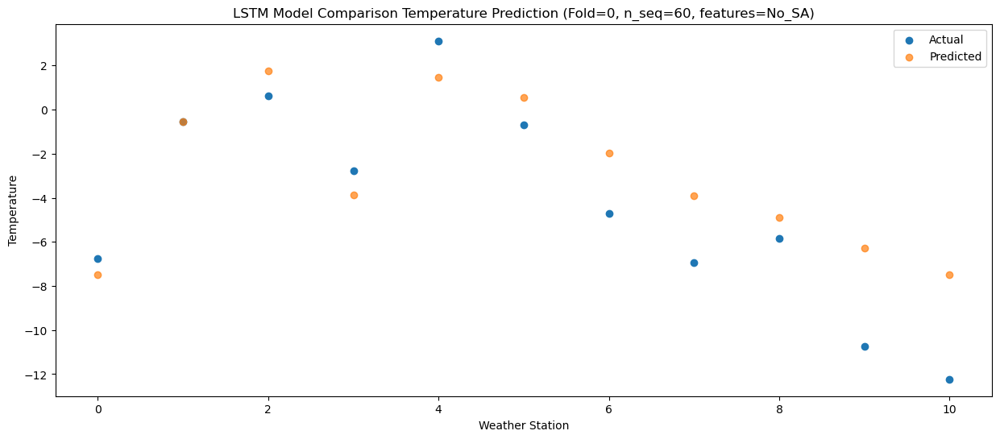

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -5.24  -4.028818
1                 1    2.24   2.891182
2                 2    4.58   5.201182
3                 3   -0.33  -0.408818
4                 4    2.89   4.911182
5                 5    2.91   3.981182
6                 6   -0.74   1.471182
7                 7   -2.71  -0.468818
8                 8   -3.81  -1.448818
9                 9   -7.15  -2.828820
10               10   -8.99  -4.028819


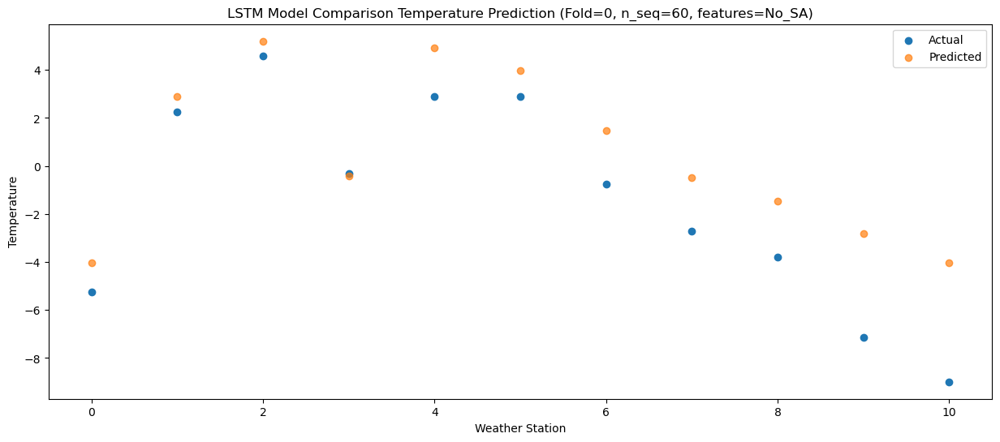

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    0.34   0.802171
1                 1    6.10   7.722171
2                 2    8.08  10.032171
3                 3    3.46   4.422171
4                 4    9.38   9.742171
5                 5    6.83   8.812171
6                 6    3.60   6.302171
7                 7    2.13   4.362171
8                 8    3.41   3.382171
9                 9   -0.17   2.002169
10               10   -2.08   0.802170


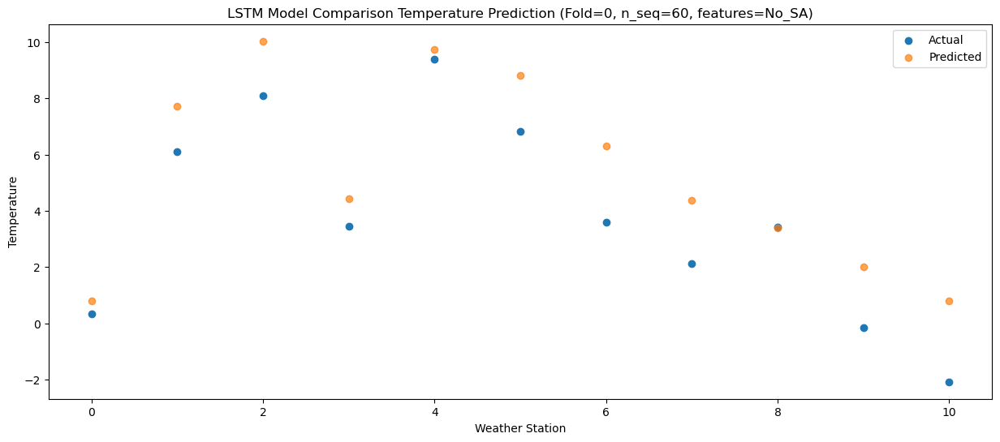

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    4.47   4.210891
1                 1    9.07  11.130891
2                 2   10.82  13.440891
3                 3    8.25   7.830891
4                 4   15.42  13.150891
5                 5    9.70  12.220890
6                 6    6.52   9.710890
7                 7    5.45   7.770890
8                 8    7.36   6.790891
9                 9    2.56   5.410889
10               10    1.53   4.210890


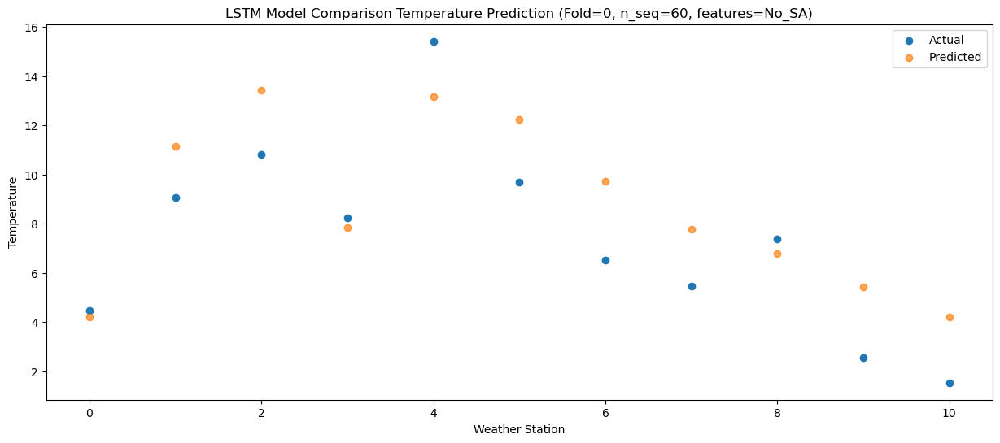

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   10.66  10.501985
1                 1   13.38  17.421985
2                 2   16.58  19.731985
3                 3   12.77  14.121985
4                 4   20.13  19.441985
5                 5   14.33  18.511985
6                 6   11.59  16.001985
7                 7   10.43  14.061985
8                 8   14.20  13.081985
9                 9   10.73  11.701983
10               10   10.85  10.501984


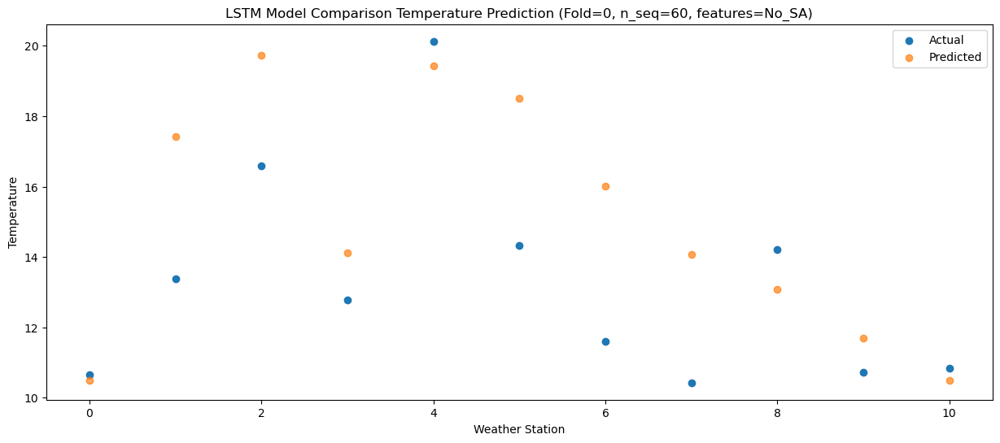

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   13.87  14.448498
1                 1   17.07  21.368498
2                 2   20.36  23.678498
3                 3   15.20  18.068498
4                 4   24.47  23.388498
5                 5   17.90  22.458498
6                 6   15.50  19.948498
7                 7   14.43  18.008498
8                 8   18.72  17.028498
9                 9   14.63  15.648496
10               10   15.61  14.448497


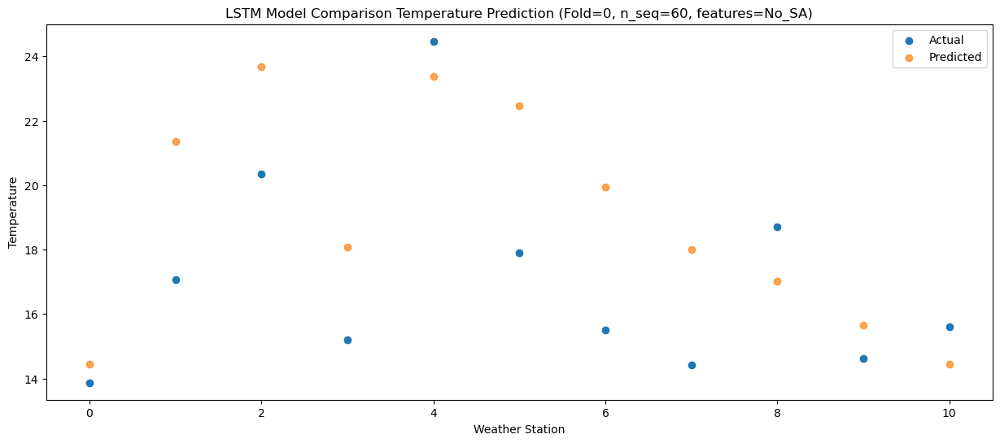

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   16.09  16.255092
1                 1   17.21  23.175092
2                 2   21.28  25.485092
3                 3   15.18  19.875092
4                 4   26.83  25.195092
5                 5   20.04  24.265091
6                 6   16.60  21.755091
7                 7   16.30  19.815091
8                 8   21.05  18.835092
9                 9   16.66  17.455090
10               10   16.72  16.255091


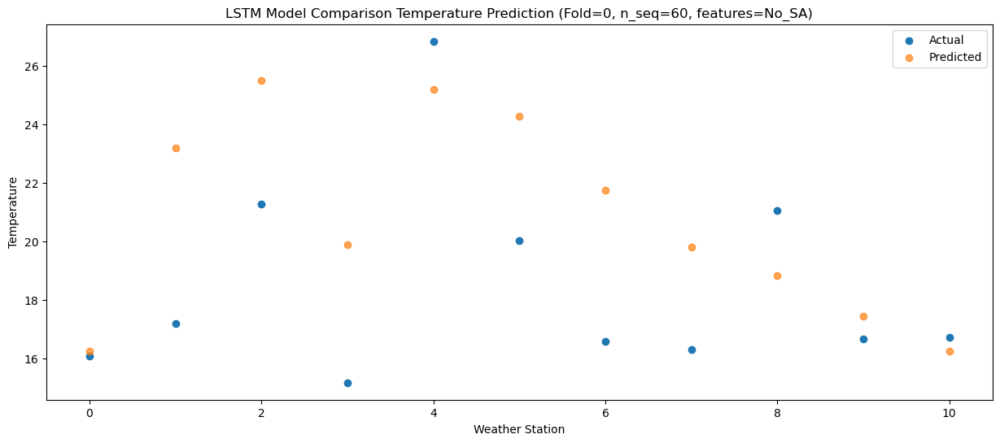

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   13.91  15.160875
1                 1   16.66  22.080875
2                 2   20.05  24.390875
3                 3   13.99  18.780875
4                 4   24.47  24.100875
5                 5   19.19  23.170875
6                 6   15.31  20.660875
7                 7   14.62  18.720875
8                 8   18.17  17.740875
9                 9   14.75  16.360873
10               10   15.60  15.160874


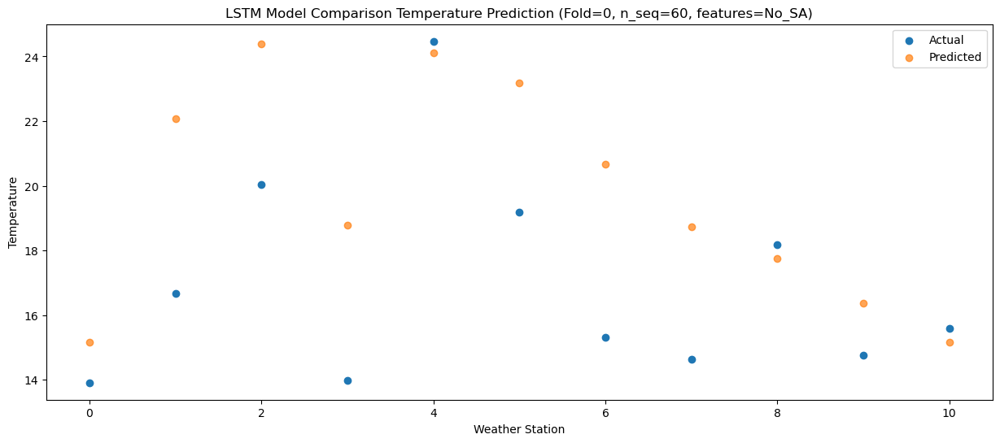

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   10.94  12.066123
1                 1   15.64  18.986123
2                 2   16.93  21.296123
3                 3   12.75  15.686123
4                 4   21.52  21.006123
5                 5   16.54  20.076123
6                 6   12.25  17.566123
7                 7   10.92  15.626123
8                 8   14.53  14.646123
9                 9   11.02  13.266121
10               10   11.76  12.066122


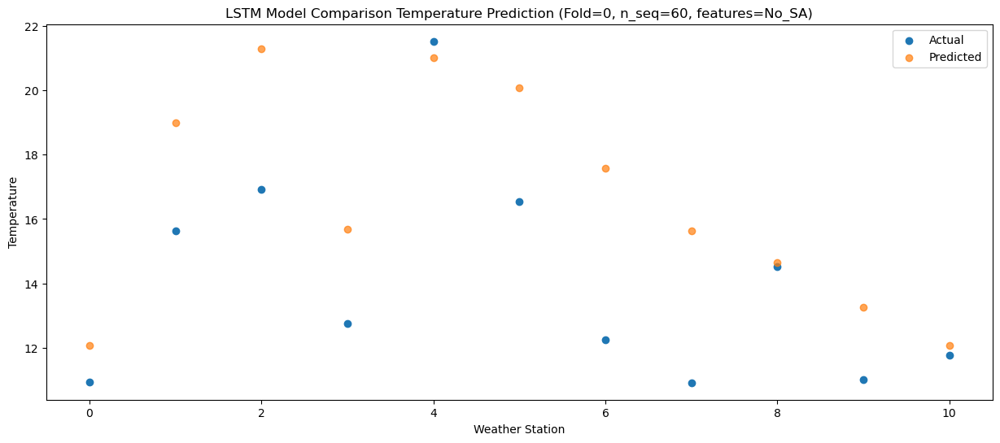

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    5.26   4.511669
1                 1   10.04  11.431670
2                 2    9.79  13.741669
3                 3    7.13   8.131670
4                 4   15.60  13.451670
5                 5    9.98  12.521669
6                 6    5.31  10.011670
7                 7    3.73   8.071670
8                 8    7.97   7.091669
9                 9    3.98   5.711667
10               10    4.52   4.511668


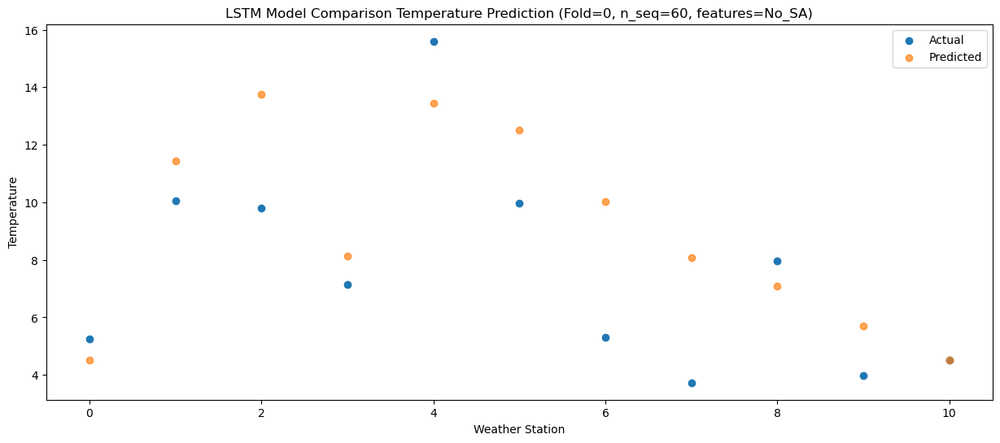

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0   -1.69  -0.512674
1                 1    7.35   6.407327
2                 2    7.31   8.717326
3                 3    3.02   3.107327
4                 4    8.67   8.427327
5                 5    8.29   7.497326
6                 6    3.08   4.987327
7                 7    1.53   3.047327
8                 8    2.00   2.067326
9                 9   -1.04   0.687324
10               10   -0.51  -0.512675


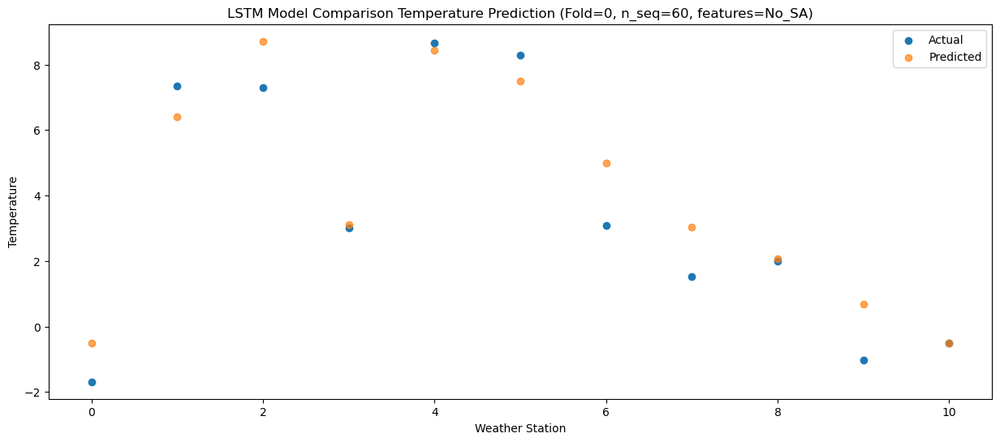

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -3.78  -5.558485
1                 1    3.50   1.361516
2                 2    2.79   3.671515
3                 3    0.84  -1.938485
4                 4    5.94   3.381516
5                 5    1.77   2.451515
6                 6   -3.43  -0.058484
7                 7   -5.64  -1.998484
8                 8   -3.29  -2.978485
9                 9   -6.75  -4.358487
10               10   -6.69  -5.558486


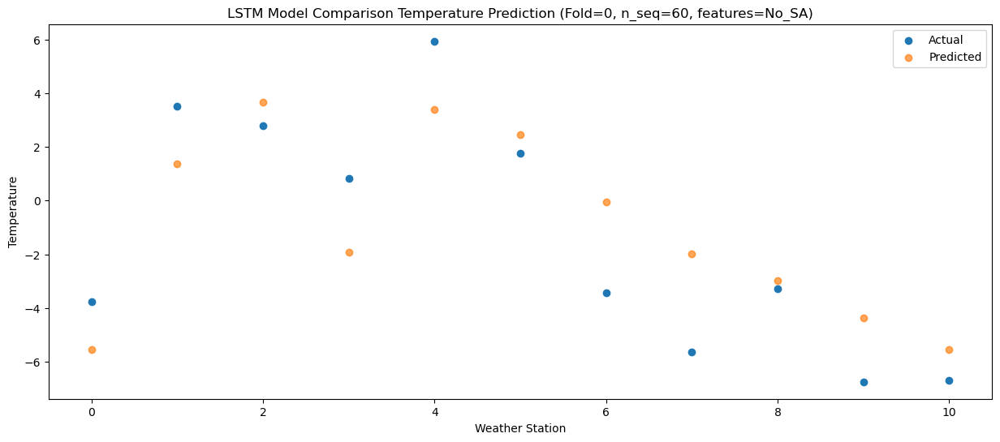

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -2.14  -3.915232
1                 1    4.29   3.004769
2                 2    4.74   5.314768
3                 3    2.28  -0.295232
4                 4    6.91   5.024769
5                 5    3.46   4.094768
6                 6   -0.24   1.584769
7                 7   -2.47  -0.355231
8                 8   -0.73  -1.335232
9                 9   -4.86  -2.715234
10               10   -5.56  -3.915231


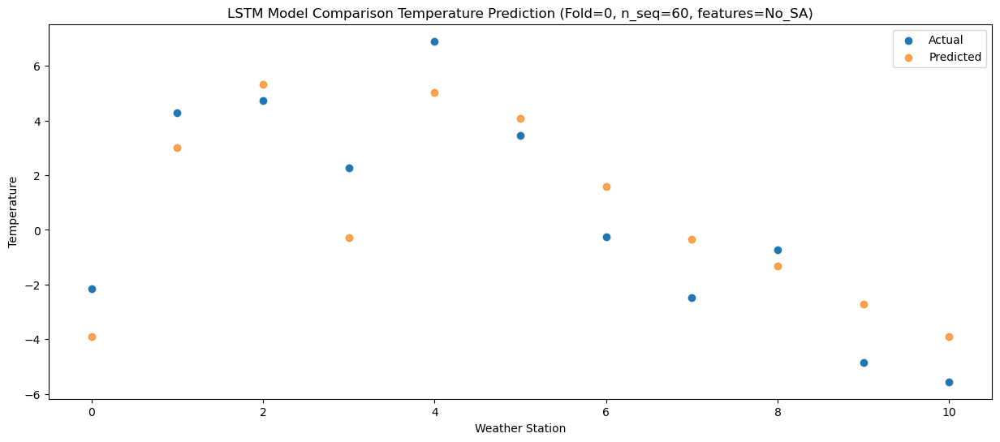

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -0.61  -3.153939
1                 1    5.39   3.766062
2                 2    7.52   6.076061
3                 3    2.69   0.466061
4                 4    7.04   5.786062
5                 5    4.95   4.856061
6                 6    2.76   2.346062
7                 7    0.50   0.406062
8                 8    0.88  -0.573939
9                 9   -2.82  -1.953941
10               10   -5.15  -3.153938


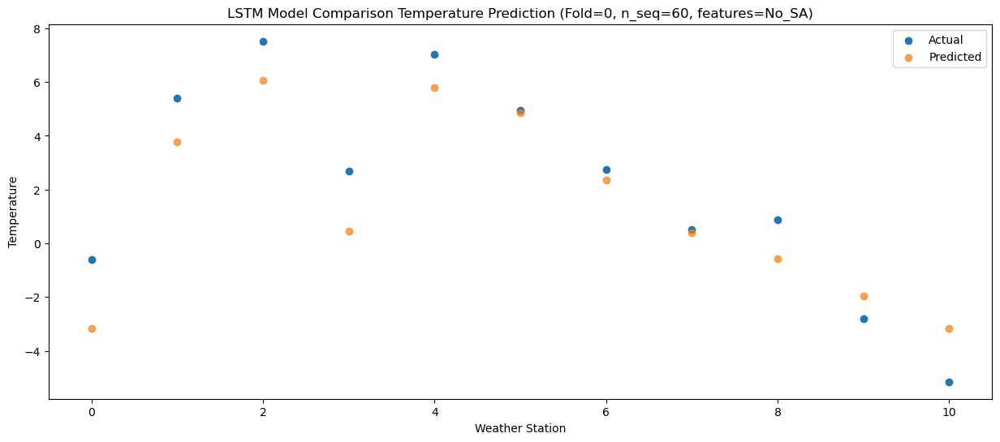

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    1.76  -1.847458
1                 1    6.98   5.072543
2                 2    7.50   7.382542
3                 3    6.21   1.772542
4                 4   11.76   7.092543
5                 5    5.86   6.162542
6                 6    3.24   3.652543
7                 7    1.18   1.712543
8                 8    2.70   0.732542
9                 9   -2.48  -0.647460
10               10   -3.29  -1.847457


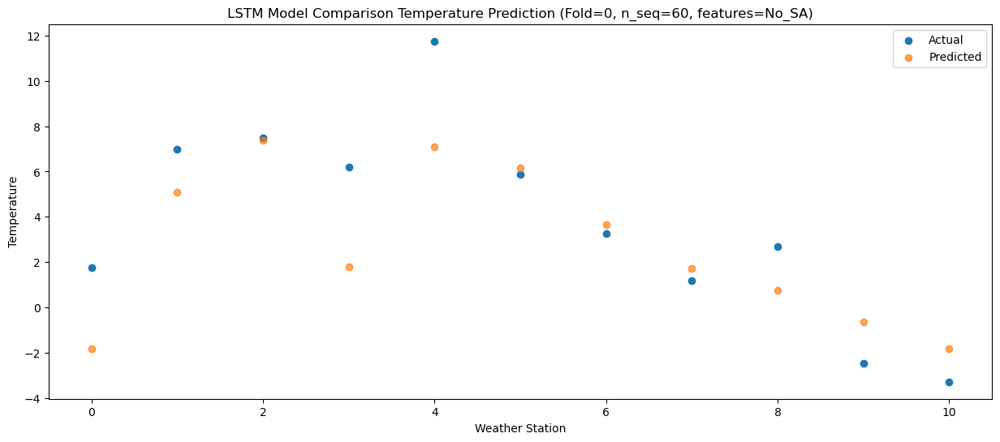

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    4.38   3.805629
1                 1    9.13  10.725630
2                 2   10.57  13.035629
3                 3    7.63   7.425629
4                 4   13.26  12.745630
5                 5   10.54  11.815628
6                 6    6.80   9.305629
7                 7    5.80   7.365629
8                 8    8.48   6.385629
9                 9    3.80   5.005627
10               10    3.56   3.805630


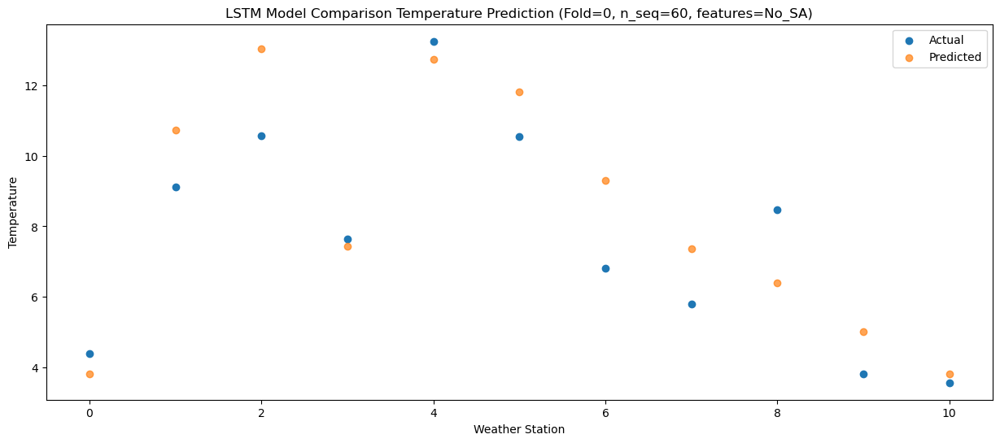

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    9.85   7.074429
1                 1   12.31  13.994430
2                 2   13.98  16.304429
3                 3   12.06  10.694429
4                 4   18.79  16.014430
5                 5   12.06  15.084428
6                 6    9.49  12.574429
7                 7    8.09  10.634429
8                 8   14.07   9.654429
9                 9    8.76   8.274427
10               10    8.58   7.074430


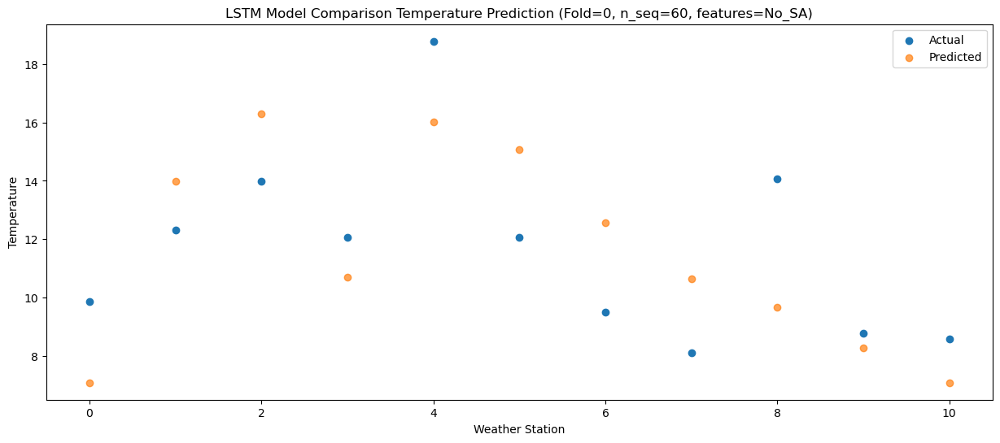

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   13.63  11.115160
1                 1   15.39  18.035161
2                 2   17.30  20.345160
3                 3   15.81  14.735160
4                 4   23.34  20.055161
5                 5   15.88  19.125160
6                 6   12.84  16.615161
7                 7   11.84  14.675161
8                 8   17.94  13.695160
9                 9   12.60  12.315158
10               10   14.09  11.115161


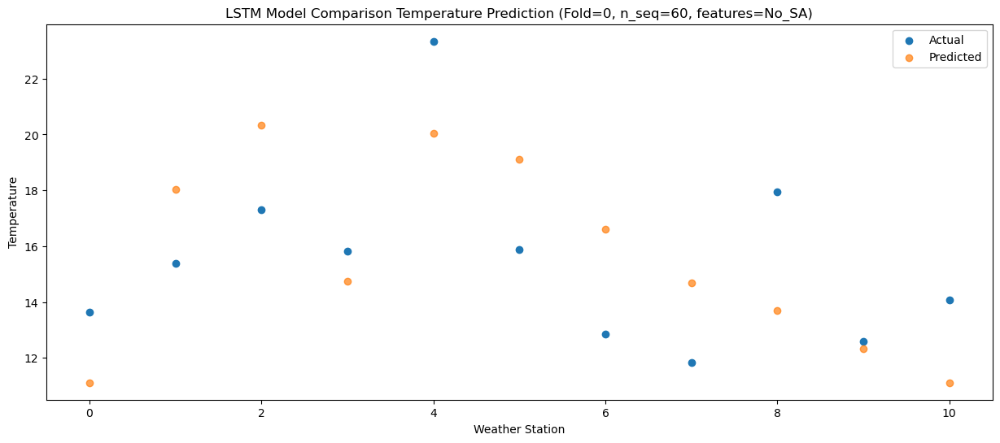

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   15.17  15.090227
1                 1   17.22  22.010228
2                 2   20.40  24.320227
3                 3   16.93  18.710227
4                 4   26.33  24.030228
5                 5   19.71  23.100227
6                 6   16.55  20.590228
7                 7   15.98  18.650228
8                 8   19.43  17.670227
9                 9   15.43  16.290225
10               10   16.55  15.090228


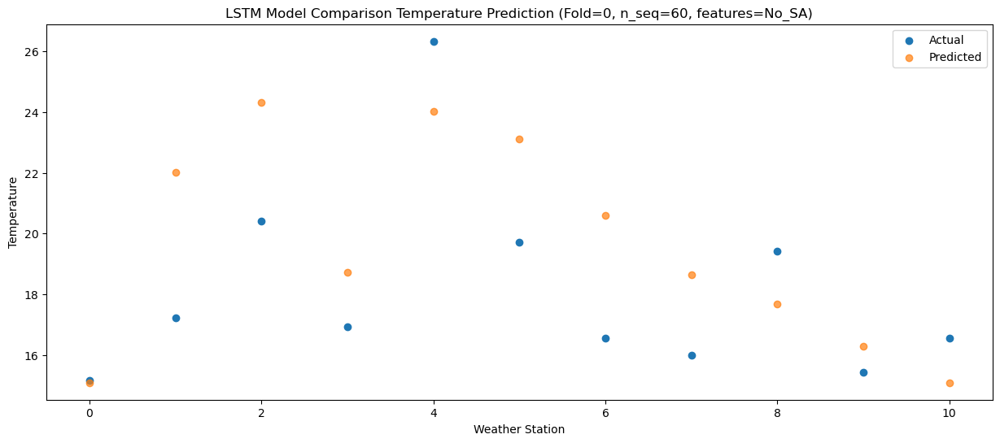

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   15.89  13.714940
1                 1   18.81  20.634940
2                 2   20.01  22.944940
3                 3   18.46  17.334940
4                 4   28.07  22.654940
5                 5   19.23  21.724939
6                 6   15.86  19.214940
7                 7   14.84  17.274940
8                 8   18.17  16.294940
9                 9   14.63  14.914938
10               10   14.74  13.714941


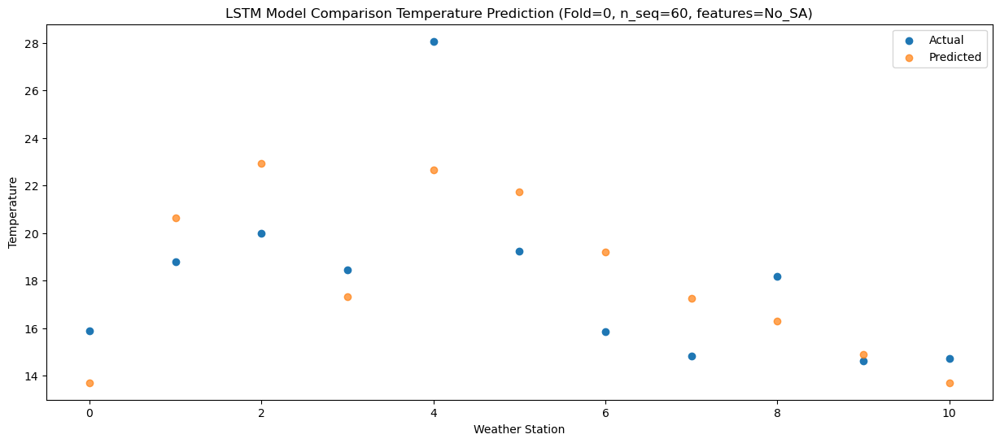

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   11.66  10.152295
1                 1   15.43  17.072296
2                 2   16.56  19.382295
3                 3   15.02  13.772295
4                 4   23.59  19.092296
5                 5   15.71  18.162294
6                 6   12.35  15.652295
7                 7   11.08  13.712295
8                 8   15.00  12.732295
9                 9   12.02  11.352293
10               10   12.36  10.152296


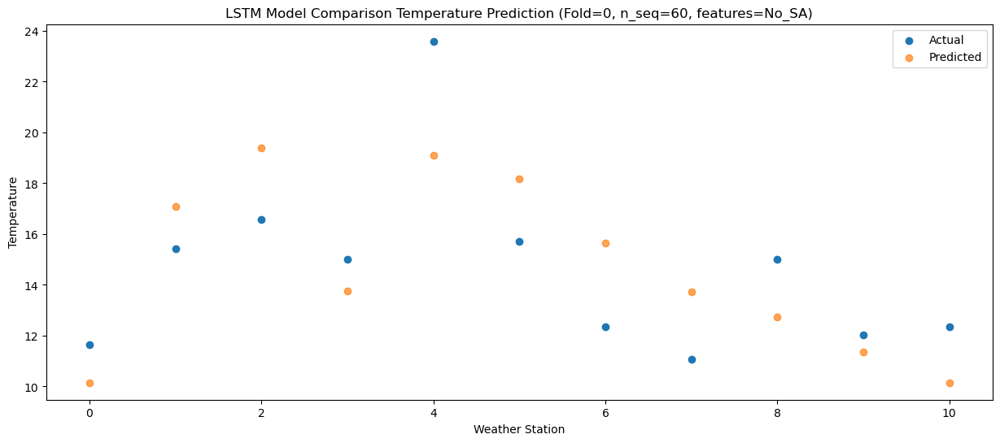

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    6.60   5.332913
1                 1   10.32  12.252914
2                 2   10.58  14.562913
3                 3    8.77   8.952913
4                 4   15.93  14.272914
5                 5   11.36  13.342913
6                 6    7.14  10.832914
7                 7    5.69   8.892914
8                 8    9.40   7.912913
9                 9    5.44   6.532911
10               10    6.40   5.332914


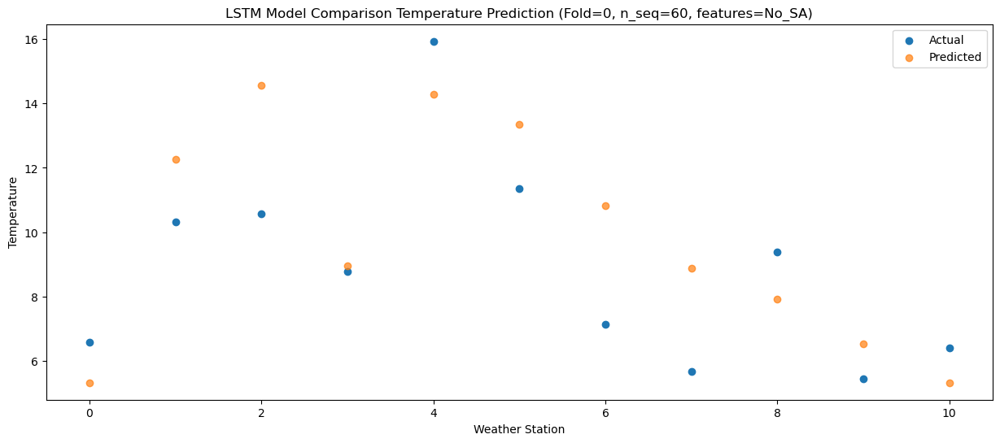

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0   -0.26  -1.841115
1                 1    5.08   5.078886
2                 2    5.49   7.388885
3                 3    2.91   1.778885
4                 4    9.57   7.098886
5                 5    5.92   6.168885
6                 6    1.27   3.658886
7                 7   -0.76   1.718886
8                 8    2.41   0.738885
9                 9   -1.06  -0.641117
10               10   -1.24  -1.841114


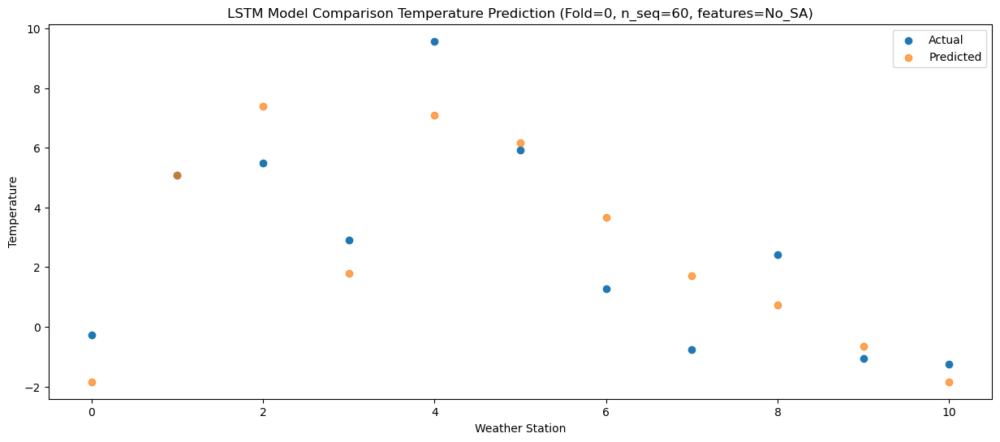

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -2.86  -3.599437
1                 1    2.38   3.320564
2                 2    2.46   5.630563
3                 3    0.12   0.020562
4                 4    6.78   5.340564
5                 5    3.78   4.410563
6                 6   -1.02   1.900564
7                 7   -2.35  -0.039436
8                 8   -0.15  -1.019437
9                 9   -3.49  -2.399439
10               10   -1.92  -3.599437


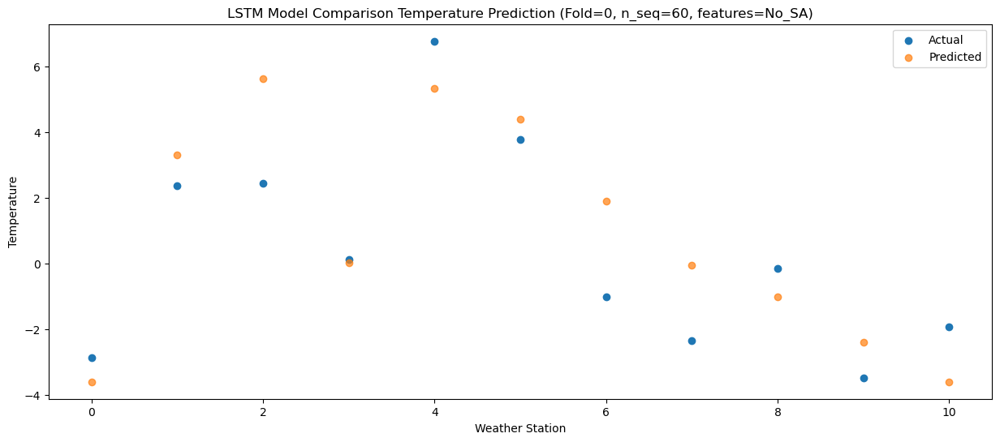

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -7.98  -7.493377
1                 1    0.11  -0.573375
2                 2   -0.05   1.736623
3                 3   -2.76  -3.873377
4                 4    1.80   1.446624
5                 5    2.51   0.516623
6                 6   -3.15  -1.993376
7                 7   -5.05  -3.933376
8                 8   -6.41  -4.913377
9                 9   -9.25  -6.293377
10               10   -8.84  -7.493375


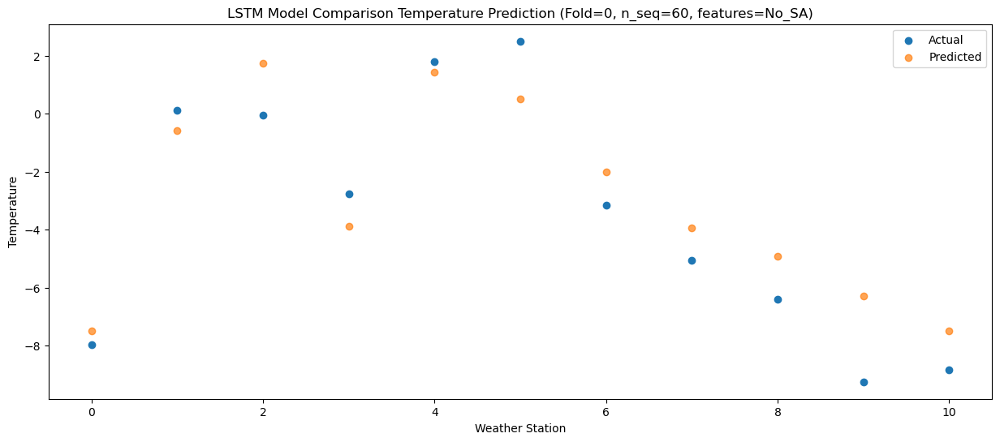

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -0.10  -3.492711
1                 1    2.61   3.427291
2                 2    4.46   5.737289
3                 3    1.89   0.127289
4                 4    9.67   5.447292
5                 5    3.03   4.517289
6                 6    0.41   2.007290
7                 7   -1.91   0.067290
8                 8    2.21  -0.912711
9                 9   -3.11  -2.292711
10               10   -3.83  -3.492709


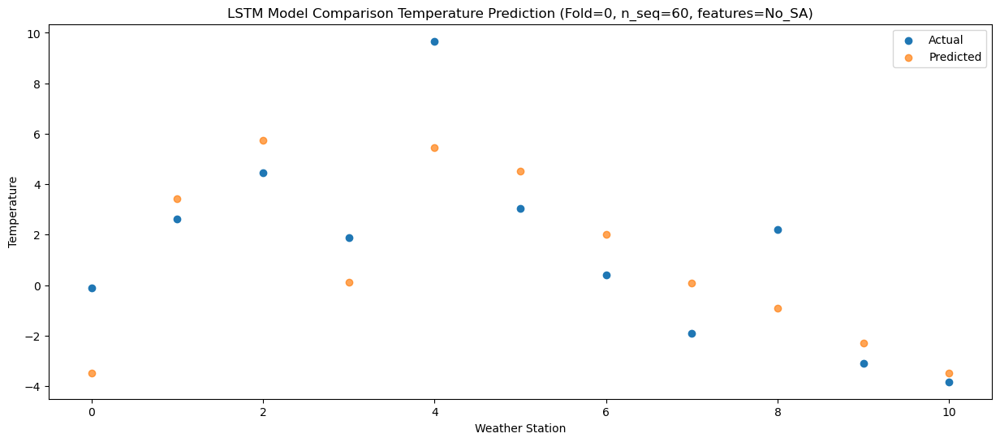

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    1.65  -0.239112
1                 1    5.91   6.680890
2                 2    8.84   8.990888
3                 3    4.83   3.380890
4                 4   12.22   8.700891
5                 5    7.08   7.770889
6                 6    4.25   5.260890
7                 7    2.24   3.320890
8                 8    5.49   2.340890
9                 9    0.21   0.960889
10               10   -0.33  -0.239108


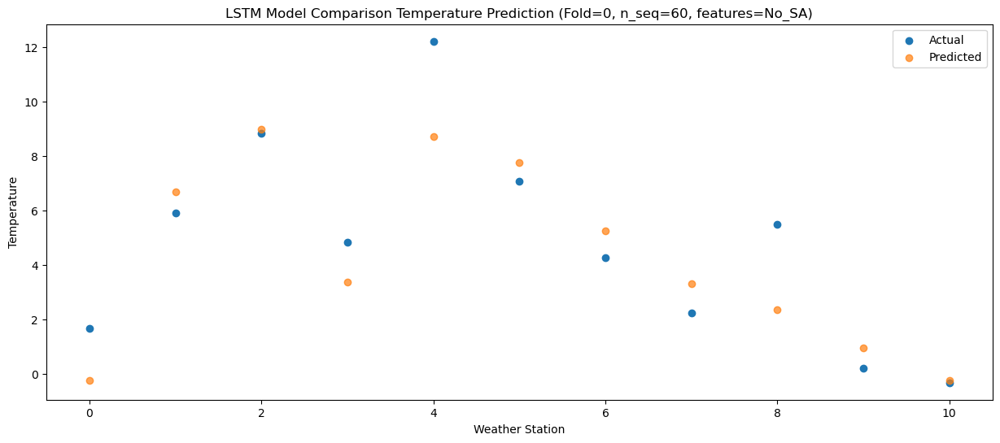

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    6.42   4.031175
1                 1    8.79  10.951177
2                 2   12.53  13.261175
3                 3    8.40   7.651177
4                 4   15.49  12.971178
5                 5   10.30  12.041177
6                 6    7.84   9.531178
7                 7    6.72   7.591178
8                 8   10.37   6.611177
9                 9    5.43   5.231177
10               10    5.01   4.031179


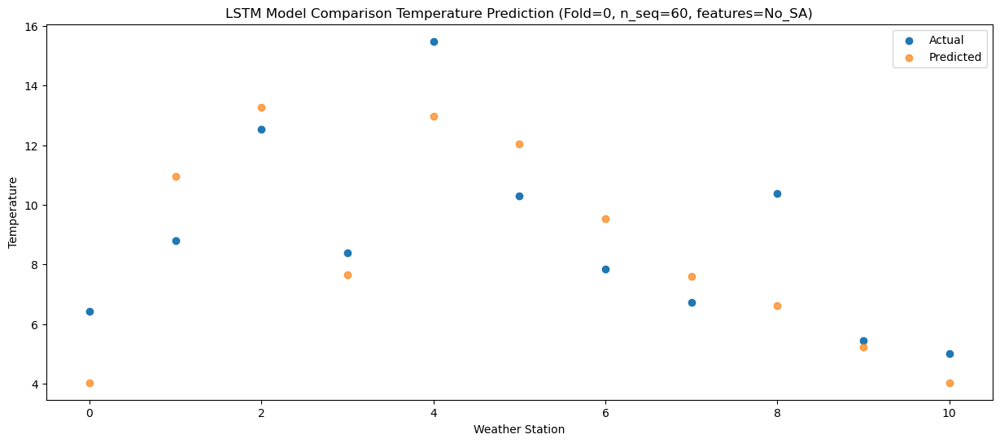

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   11.33   9.182101
1                 1   13.28  16.102103
2                 2   17.01  18.412101
3                 3   12.79  12.802103
4                 4   20.07  18.122104
5                 5   15.11  17.192103
6                 6   11.84  14.682104
7                 7   10.68  12.742104
8                 8   15.44  11.762103
9                 9   11.23  10.382103
10               10   11.98   9.182105


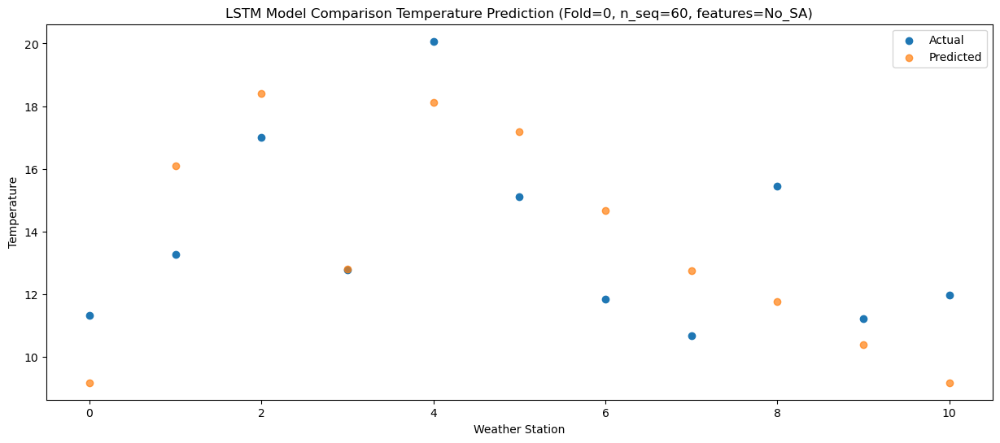

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   13.94  13.021119
1                 1   16.21  19.941121
2                 2   21.25  22.251119
3                 3   14.91  16.641121
4                 4   23.57  21.961122
5                 5   18.54  21.031121
6                 6   15.75  18.521122
7                 7   14.70  16.581122
8                 8   18.37  15.601121
9                 9   14.99  14.221121
10               10   16.30  13.021123


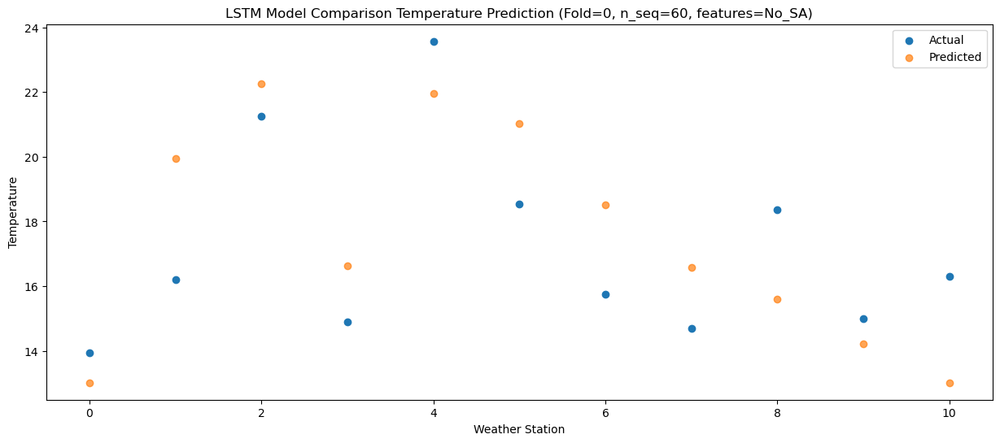

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   14.82  14.652670
1                 1   17.34  21.572672
2                 2   21.52  23.882670
3                 3   14.85  18.272672
4                 4   23.43  23.592673
5                 5   20.20  22.662672
6                 6   17.01  20.152673
7                 7   15.92  18.212673
8                 8   18.92  17.232672
9                 9   15.83  15.852672
10               10   17.19  14.652674


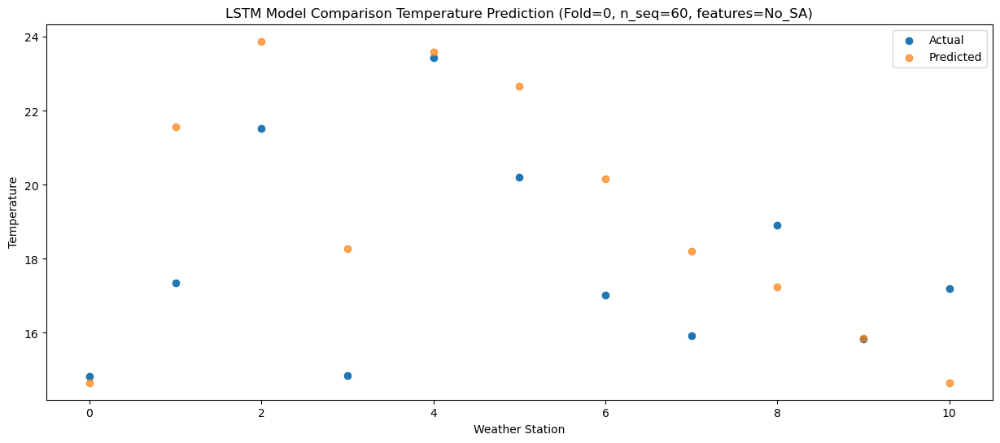

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   15.16  13.392740
1                 1   17.73  20.312742
2                 2   19.84  22.622740
3                 3   15.66  17.012742
4                 4   25.11  22.332743
5                 5   18.93  21.402742
6                 6   15.26  18.892743
7                 7   14.08  16.952743
8                 8   18.86  15.972742
9                 9   15.50  14.592742
10               10   16.44  13.392744


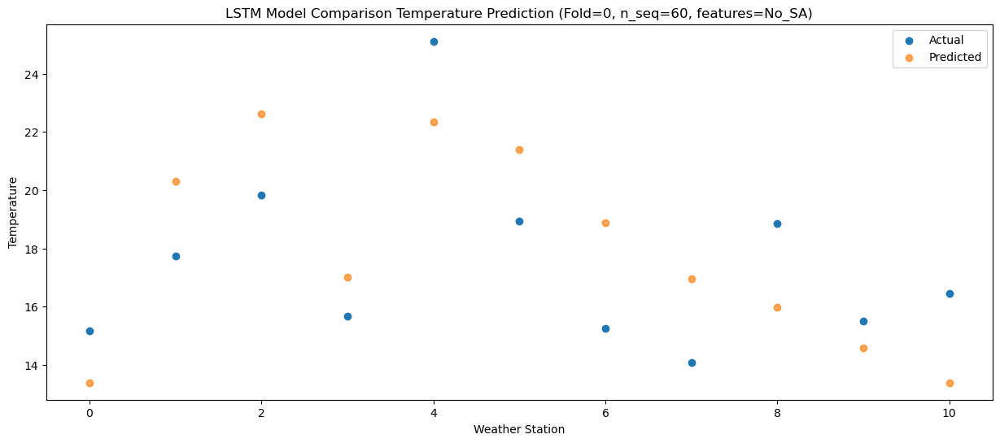

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   11.02  10.478711
1                 1   14.49  17.398713
2                 2   17.07  19.708711
3                 3   13.07  14.098713
4                 4   21.19  19.418714
5                 5   16.99  18.488712
6                 6   12.83  15.978713
7                 7   11.15  14.038713
8                 8   15.24  13.058713
9                 9   13.31  11.678712
10               10   13.66  10.478715


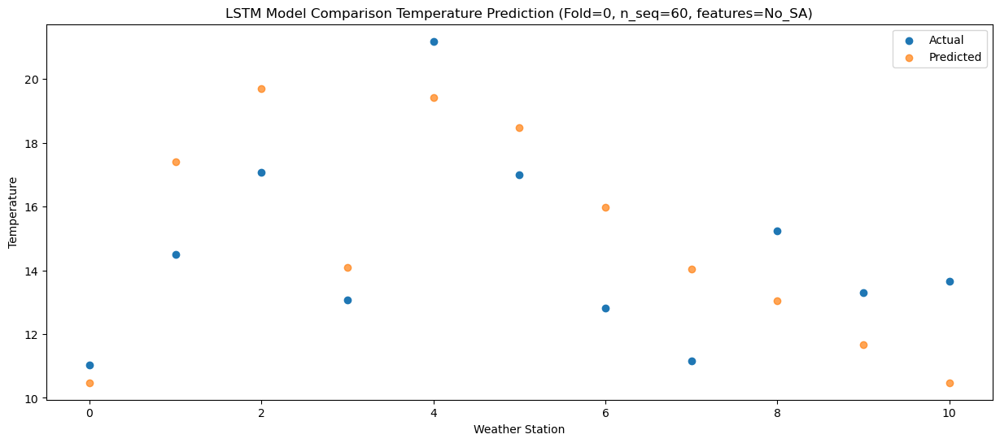

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    7.75   4.847765
1                 1   11.17  11.767767
2                 2   11.17  14.077765
3                 3    8.93   8.467767
4                 4   18.74  13.787768
5                 5   11.96  12.857767
6                 6    7.56  10.347768
7                 7    5.32   8.407768
8                 8    9.81   7.427767
9                 9    6.57   6.047767
10               10    7.43   4.847769


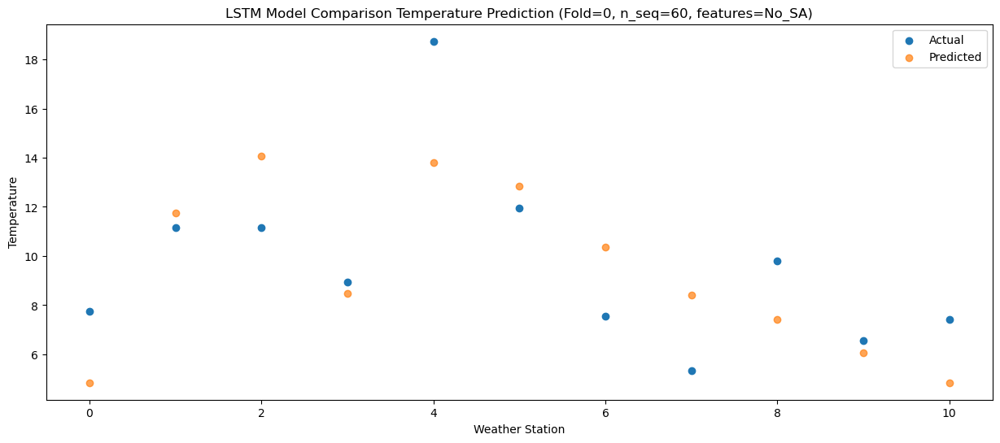

f, t:
[[-2.980e+00  3.390e+00  4.930e+00  1.130e+00  7.340e+00  4.630e+00
   6.800e-01 -1.370e+00 -9.500e-01 -4.560e+00 -5.060e+00]
 [-3.450e+00  2.490e+00  4.820e+00  1.110e+00  5.290e+00  4.060e+00
   3.200e-01 -1.740e+00 -1.110e+00 -4.380e+00 -5.730e+00]
 [-3.720e+00  2.110e+00  4.200e+00  1.150e+00  6.030e+00  3.530e+00
  -1.500e-01 -1.860e+00 -2.300e+00 -5.660e+00 -6.760e+00]
 [-3.370e+00  2.860e+00  4.820e+00  1.150e+00  5.360e+00  3.220e+00
   9.600e-01 -8.200e-01 -1.800e+00 -6.530e+00 -8.220e+00]
 [ 3.210e+00  8.690e+00  1.107e+01  8.070e+00  1.311e+01  6.810e+00
   6.380e+00  4.760e+00  4.770e+00  6.600e-01 -2.080e+00]
 [ 3.860e+00  9.180e+00  1.083e+01  8.150e+00  1.336e+01  8.780e+00
   7.620e+00  5.660e+00  7.050e+00  2.320e+00  5.700e-01]
 [ 8.590e+00  1.195e+01  1.452e+01  1.104e+01  1.834e+01  1.247e+01
   9.960e+00  8.780e+00  1.193e+01  7.410e+00  7.000e+00]
 [ 1.281e+01  1.570e+01  1.824e+01  1.395e+01  2.254e+01  1.682e+01
   1.521e+01  1.430e+01  1.786e+01  1.439e+0

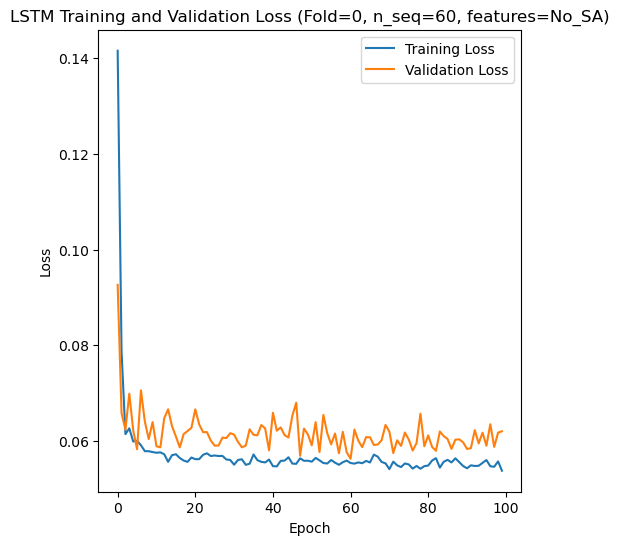

[[12.2  10.03 13.86 ... 24.46 19.58 17.03]
 [ 8.35  6.22 11.74 ... 22.47 18.02 13.98]
 [10.82  7.37 13.36 ... 24.57 19.57 16.15]
 ...
 [ 7.69  4.56 11.66 ... 25.3  19.83 13.28]
 [ 8.93  6.7  14.14 ... 25.37 21.51 12.55]
 [ 7.96  5.46 11.14 ... 25.13 20.28 10.63]]
Epoch 1/100
84/84 [==============================] - 44s 254ms/step - loss: 0.1444 - accuracy: 0.3333 - mae: 0.1175 - rmse: 0.1444 - mape: inf - pearson: 0.5900 - val_loss: 0.1028 - val_accuracy: 0.6000 - val_mae: 0.0841 - val_rmse: 0.1028 - val_mape: 16.5184 - val_pearson: 0.7553
Epoch 2/100
84/84 [==============================] - 15s 177ms/step - loss: 0.0780 - accuracy: 0.4524 - mae: 0.0629 - rmse: 0.0780 - mape: inf - pearson: 0.7992 - val_loss: 0.0639 - val_accuracy: 0.6000 - val_mae: 0.0510 - val_rmse: 0.0639 - val_mape: 11.1523 - val_pearson: 0.8437
Epoch 3/100
84/84 [==============================] - 15s 177ms/step - loss: 0.0632 - accuracy: 0.5238 - mae: 0.0503 - rmse: 0.0632 - mape: inf - pearson: 0.8278 - val_loss:

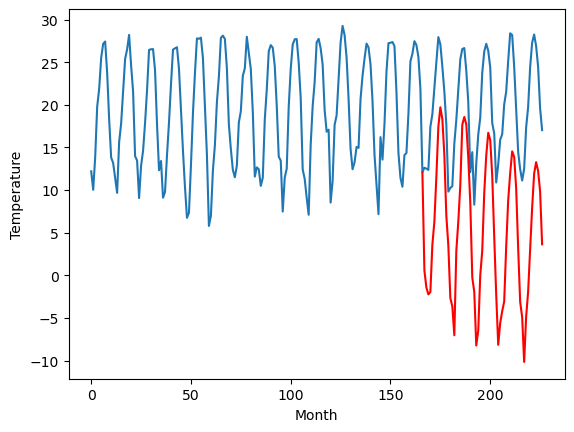

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.52		4.80		1.28
2.61		2.81		0.20
1.50		2.00		0.50
1.59		2.29		0.70
7.59		7.84		0.25
8.81		10.52		1.71
12.16		15.79		3.63
16.51		21.67		5.16
19.88		23.95		4.07
18.47		22.56		4.09
14.93		18.39		3.46
11.21		11.22		0.01
7.11		7.73		0.62
0.22		1.58		1.36
0.02		0.60		0.58
0.68		-2.80		-3.48
7.45		7.10		-0.35
9.59		10.56		0.97
13.32		14.83		1.51
17.46		21.90		4.44
18.84		22.82		3.98
19.11		21.95		2.84
15.37		18.03		2.66
11.59		12.77		1.18
3.93		3.99		0.06
5.56		2.29		-3.27
-1.17		-4.00		-2.83
3.06		-2.23		-5.29
6.63		4.25		-2.38
9.63		7.13		-2.50
15.51		13.92		-1.59
19.48		18.28		-1.20
19.98		20.96		0.98
18.52		20.12		1.60
15.43		15.92		0.49
9.09		8.77		-0.32
6.09		1.94		-4.15
0.28		-3.92		-4.20
2.47		-1.35		-3.82
5.84		0.03		-5.81
6.61		1.16		-5.45
9.88		7.59		-2.29
13.16		13.03		-0.13
16.35		16.23		-0.12
19.95		18.79		-1.16
19.41		18.12		-1.29
15.90		14.44		-1.46
10.89		7.40		-3.49
5.27		1.14		-4

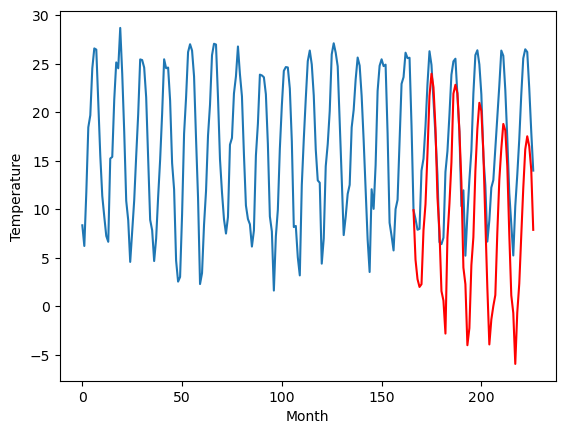

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.48		0.95		2.43
-1.05		-1.04		0.01
-1.58		-1.85		-0.27
-1.30		-1.56		-0.26
5.80		3.99		-1.81
4.83		6.67		1.84
8.98		11.94		2.96
13.21		17.82		4.61
14.68		20.10		5.42
14.67		18.71		4.04
11.87		14.54		2.67
7.52		7.37		-0.15
2.72		3.88		1.16
-4.34		-2.27		2.07
-3.92		-3.25		0.67
-3.43		-6.65		-3.22
3.63		3.25		-0.38
5.03		6.71		1.68
9.15		10.98		1.83
13.03		18.05		5.02
13.80		18.97		5.17
14.46		18.10		3.64
11.44		14.18		2.74
7.66		8.92		1.26
-0.08		0.14		0.22
2.52		-1.56		-4.08
-4.37		-7.85		-3.48
-1.02		-6.08		-5.06
2.98		0.40		-2.58
6.57		3.28		-3.29
11.93		10.07		-1.86
14.90		14.43		-0.47
15.61		17.11		1.50
14.00		16.27		2.27
11.61		12.07		0.46
4.92		4.92		-0.00
1.60		-1.91		-3.51
-1.56		-7.77		-6.21
-0.56		-5.20		-4.64
2.03		-3.82		-5.85
3.46		-2.69		-6.15
6.15		3.74		-2.41
9.39		9.18		-0.21
13.14		12.38		-0.76
15.51		14.94		-0.57
15.95		14.27		-1.68
12.99		10.59		-2.40
6.95		3.55		-3.40
0

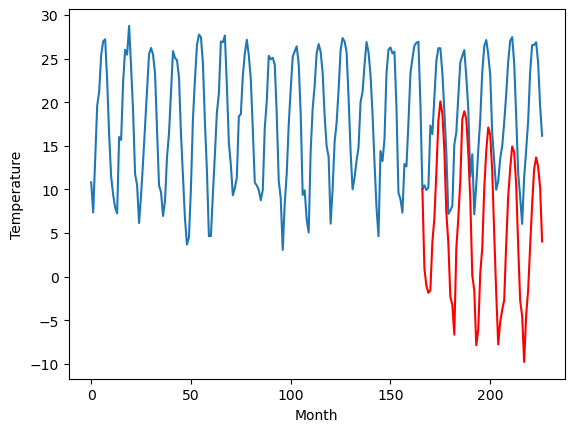

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.05		3.42		-0.63
2.63		1.43		-1.20
3.38		0.62		-2.76
2.85		0.91		-1.94
10.49		6.46		-4.03
10.37		9.14		-1.23
14.12		14.41		0.29
16.90		20.29		3.39
18.55		22.57		4.02
18.79		21.18		2.39
15.38		17.01		1.63
10.84		9.84		-1.00
7.94		6.35		-1.59
1.76		0.20		-1.56
1.66		-0.78		-2.44
0.07		-4.18		-4.25
7.44		5.72		-1.72
9.78		9.18		-0.60
13.67		13.45		-0.22
17.56		20.52		2.96
17.44		21.44		4.00
18.41		20.57		2.16
15.40		16.65		1.25
12.71		11.39		-1.32
5.55		2.61		-2.94
8.92		0.91		-8.01
0.87		-5.38		-6.25
0.40		-3.61		-4.01
6.24		2.87		-3.37
12.24		5.75		-6.49
16.67		12.54		-4.13
19.67		16.90		-2.77
20.61		19.58		-1.03
18.97		18.74		-0.23
16.20		14.54		-1.66
10.64		7.39		-3.25
5.59		0.56		-5.03
3.50		-5.30		-8.80
4.21		-2.73		-6.94
5.21		-1.35		-6.56
9.04		-0.22		-9.26
9.88		6.21		-3.67
14.47		11.65		-2.82
18.62		14.85		-3.77
20.34		17.41		-2.93
22.31		16.74		-5.57
19.23		13.06		-6.17
11.97		6.02		

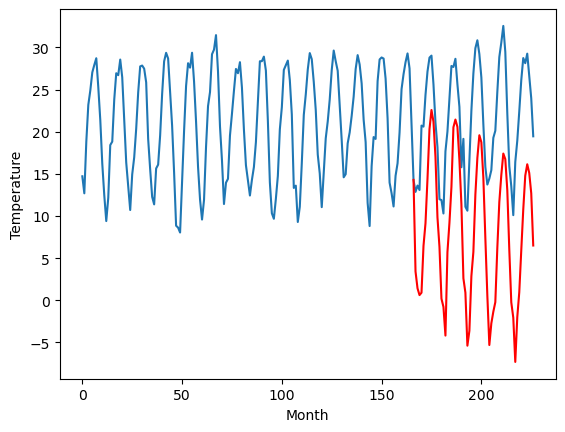

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
8.11		7.31		-0.80
6.22		5.32		-0.90
7.03		4.51		-2.52
6.65		4.80		-1.85
14.69		10.35		-4.34
14.43		13.03		-1.40
18.23		18.30		0.07
21.26		24.18		2.92
23.30		26.46		3.16
23.54		25.07		1.53
19.96		20.90		0.94
15.02		13.73		-1.29
11.92		10.24		-1.68
5.56		4.09		-1.47
5.55		3.11		-2.44
3.85		-0.29		-4.14
11.46		9.61		-1.85
13.76		13.07		-0.69
17.88		17.34		-0.54
21.35		24.41		3.06
21.44		25.33		3.89
22.41		24.46		2.05
18.83		20.54		1.71
15.79		15.28		-0.51
8.24		6.50		-1.74
12.12		4.80		-7.32
3.64		-1.49		-5.13
3.33		0.28		-3.05
9.11		6.76		-2.35
15.38		9.64		-5.74
20.00		16.43		-3.57
23.37		20.79		-2.58
24.46		23.47		-0.99
22.45		22.63		0.18
19.27		18.43		-0.84
13.88		11.28		-2.60
8.88		4.45		-4.43
6.86		-1.41		-8.27
7.34		1.16		-6.18
8.52		2.54		-5.98
12.34		3.67		-8.67
13.30		10.10		-3.20
17.94		15.54		-2.40
22.83		18.74		-4.09
24.78		21.30		-3.48
26.21		20.63		-5.58
22.36		16.95		-5.41
14.96	

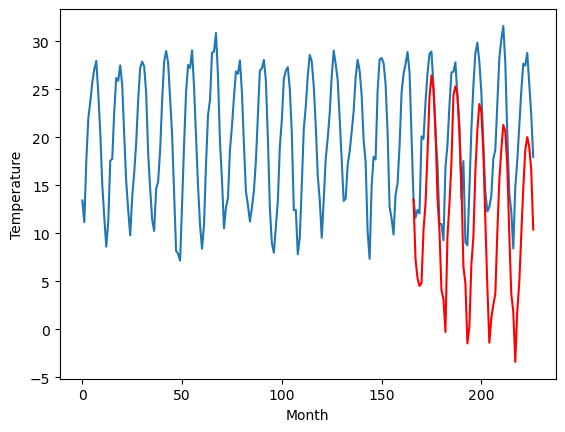

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
7.80		6.02		-1.78
5.77		4.03		-1.74
5.11		3.22		-1.89
4.59		3.51		-1.08
11.94		9.06		-2.88
14.73		11.74		-2.99
19.92		17.01		-2.91
22.64		22.89		0.25
25.34		25.17		-0.17
25.19		23.78		-1.41
17.66		19.61		1.95
14.82		12.44		-2.38
11.10		8.95		-2.15
4.35		2.80		-1.55
2.84		1.82		-1.02
3.22		-1.58		-4.80
10.56		8.32		-2.24
12.83		11.78		-1.05
18.42		16.05		-2.37
22.69		23.12		0.43
22.03		24.04		2.01
21.44		23.17		1.73
21.08		19.25		-1.83
16.76		13.99		-2.77
10.29		5.21		-5.08
10.55		3.51		-7.04
3.23		-2.78		-6.01
3.12		-1.01		-4.13
10.07		5.47		-4.60
16.98		8.35		-8.63
22.38		15.14		-7.24
24.44		19.50		-4.94
25.36		22.18		-3.18
22.51		21.34		-1.17
19.46		17.14		-2.32
13.38		9.99		-3.39
6.42		3.16		-3.26
5.30		-2.70		-8.00
5.76		-0.13		-5.89
5.90		1.25		-4.65
10.96		2.38		-8.58
14.12		8.81		-5.31
18.73		14.25		-4.48
25.42		17.45		-7.97
26.52		20.01		-6.51
25.71		19.34		-6.37
23.43		15.66		-7.77
1

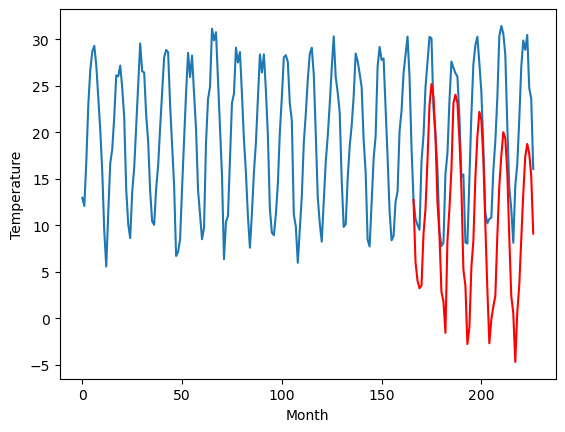

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.88		5.55		1.67
3.15		3.56		0.41
2.34		2.75		0.41
2.41		3.04		0.63
8.08		8.59		0.51
9.71		11.27		1.56
12.49		16.54		4.05
17.16		22.42		5.26
20.34		24.70		4.36
18.71		23.31		4.60
15.29		19.14		3.85
11.80		11.97		0.17
7.65		8.48		0.83
0.44		2.33		1.89
0.24		1.35		1.11
1.02		-2.05		-3.07
7.30		7.85		0.55
9.87		11.31		1.44
13.64		15.58		1.94
17.65		22.65		5.00
19.01		23.57		4.56
19.27		22.70		3.43
15.94		18.78		2.84
11.99		13.52		1.53
4.39		4.74		0.35
5.91		3.04		-2.87
-0.48		-3.25		-2.77
3.33		-1.48		-4.81
7.17		5.00		-2.17
9.93		7.88		-2.05
15.85		14.67		-1.18
19.43		19.03		-0.40
20.17		21.71		1.54
18.67		20.87		2.20
15.78		16.67		0.89
9.44		9.52		0.08
6.55		2.69		-3.86
0.54		-3.17		-3.71
2.67		-0.60		-3.27
6.26		0.78		-5.48
6.93		1.91		-5.02
10.19		8.34		-1.85
13.19		13.78		0.59
16.47		16.98		0.51
19.92		19.54		-0.38
19.50		18.87		-0.63
16.33		15.19		-1.14
11.32		8.15		-3.17
5.63		1.89		-3.74

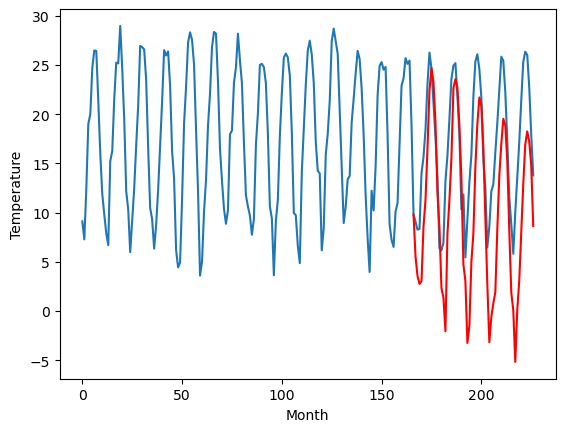

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.92		1.72		0.80
0.30		-0.27		-0.57
-0.55		-1.08		-0.53
0.13		-0.79		-0.92
7.05		4.76		-2.29
8.19		7.44		-0.75
12.69		12.71		0.02
18.25		18.59		0.34
20.79		20.87		0.08
18.77		19.48		0.71
15.47		15.31		-0.16
8.70		8.14		-0.56
5.03		4.65		-0.38
-1.57		-1.50		0.07
-1.88		-2.48		-0.60
-4.88		-5.88		-1.00
6.44		4.02		-2.42
8.15		7.48		-0.67
12.81		11.75		-1.06
18.89		18.82		-0.07
19.88		19.74		-0.14
21.10		18.87		-2.23
17.39		14.95		-2.44
12.19		9.69		-2.50
2.89		0.91		-1.98
5.30		-0.79		-6.09
-3.53		-7.08		-3.55
-1.48		-5.31		-3.83
4.47		1.17		-3.30
9.66		4.05		-5.61
15.13		10.84		-4.29
19.19		15.20		-3.99
23.32		17.88		-5.44
20.45		17.04		-3.41
16.61		12.84		-3.77
9.94		5.69		-4.25
3.34		-1.14		-4.48
-0.40		-7.00		-6.60
0.79		-4.43		-5.22
2.29		-3.05		-5.34
5.12		-1.92		-7.04
9.52		4.51		-5.01
14.87		9.95		-4.92
18.68		13.15		-5.53
20.98		15.71		-5.27
21.48		15.04		-6.44
17.86		11.36		-6.50
11.5

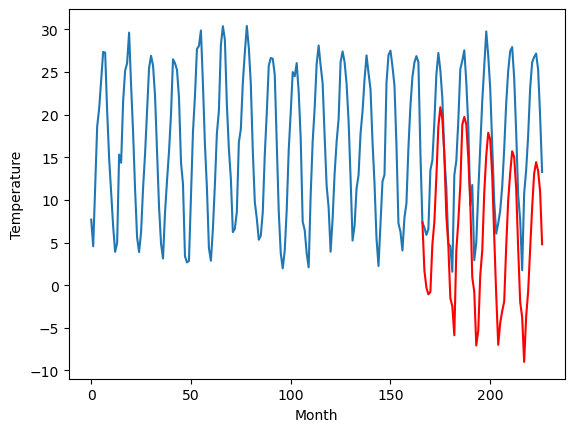

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.44		0.29		-0.15
-1.41		-1.70		-0.29
-1.23		-2.51		-1.28
-1.74		-2.22		-0.48
6.09		3.33		-2.76
7.47		6.01		-1.46
13.58		11.28		-2.30
18.69		17.16		-1.53
21.23		19.44		-1.79
20.30		18.05		-2.25
13.65		13.88		0.23
7.47		6.71		-0.76
4.59		3.22		-1.37
-2.09		-2.93		-0.84
-2.44		-3.91		-1.47
-7.22		-7.31		-0.09
5.34		2.59		-2.75
7.14		6.05		-1.09
11.95		10.32		-1.63
17.98		17.39		-0.59
19.49		18.31		-1.18
19.88		17.44		-2.44
17.37		13.52		-3.85
11.12		8.26		-2.86
3.37		-0.52		-3.89
2.56		-2.22		-4.78
-5.06		-8.51		-3.45
-4.08		-6.74		-2.66
3.17		-0.26		-3.43
10.28		2.62		-7.66
15.64		9.41		-6.23
19.93		13.77		-6.16
24.08		16.45		-7.63
21.41		15.61		-5.80
17.58		11.41		-6.17
9.35		4.26		-5.09
1.50		-2.57		-4.07
-2.13		-8.43		-6.30
-1.27		-5.86		-4.59
-0.90		-4.48		-3.58
3.53		-3.35		-6.88
7.86		3.08		-4.78
13.55		8.52		-5.03
18.48		11.72		-6.76
21.36		14.28		-7.08
23.17		13.61		-9.56
18.53		9.93		

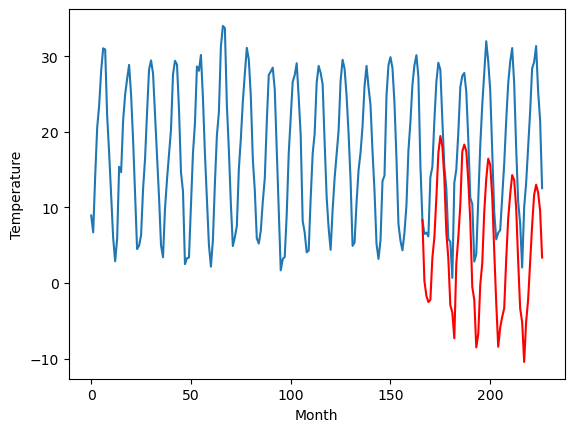

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.68		1.53		-3.15
3.32		-0.46		-3.78
2.87		-1.27		-4.14
1.63		-0.98		-2.61
9.59		4.57		-5.02
11.90		7.25		-4.65
18.43		12.52		-5.91
24.81		18.40		-6.41
26.39		20.68		-5.71
25.16		19.29		-5.87
18.41		15.12		-3.29
11.81		7.95		-3.86
8.63		4.46		-4.17
1.36		-1.69		-3.05
1.47		-2.67		-4.14
-2.90		-6.07		-3.17
7.81		3.83		-3.98
11.57		7.29		-4.28
16.12		11.56		-4.56
23.23		18.63		-4.60
23.90		19.55		-4.35
23.75		18.68		-5.07
21.80		14.76		-7.04
14.36		9.50		-4.86
8.11		0.72		-7.39
6.50		-0.98		-7.48
-0.42		-7.27		-6.85
-0.36		-5.50		-5.14
6.57		0.98		-5.59
13.05		3.86		-9.19
18.50		10.65		-7.85
23.07		15.01		-8.06
26.67		17.69		-8.98
23.84		16.85		-6.99
21.43		12.65		-8.78
12.89		5.50		-7.39
3.90		-1.33		-5.23
1.55		-7.19		-8.74
1.83		-4.62		-6.45
2.98		-3.24		-6.22
6.71		-2.11		-8.82
12.06		4.32		-7.74
17.17		9.76		-7.41
20.40		12.96		-7.44
25.02		15.52		-9.50
25.42		14.85		-10.57
21.90		11.17		

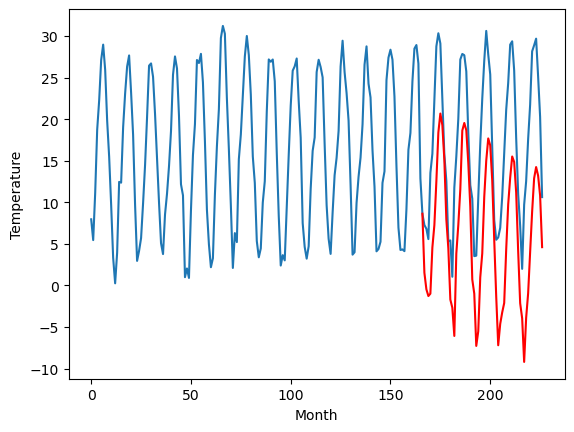

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.56		0.56		2.12
-4.37		-1.43		2.94
-4.03		-2.24		1.79
-3.29		-1.95		1.34
1.03		3.60		2.57
2.66		6.28		3.62
8.12		11.55		3.43
15.44		17.43		1.99
19.31		19.71		0.40
17.12		18.32		1.20
12.59		14.15		1.56
7.05		6.98		-0.07
2.85		3.49		0.64
-4.16		-2.66		1.50
-6.00		-3.64		2.36
-6.96		-7.04		-0.08
0.26		2.86		2.60
4.91		6.32		1.41
9.45		10.59		1.14
15.54		17.66		2.12
17.77		18.58		0.81
17.55		17.71		0.16
13.85		13.79		-0.06
9.43		8.53		-0.90
0.11		-0.25		-0.36
-0.66		-1.95		-1.29
-7.68		-8.24		-0.56
-3.78		-6.47		-2.69
0.78		0.01		-0.77
4.13		2.89		-1.24
11.11		9.68		-1.43
15.50		14.04		-1.46
19.44		16.72		-2.72
18.90		15.88		-3.02
13.99		11.68		-2.31
5.89		4.53		-1.36
2.38		-2.30		-4.68
-4.77		-8.16		-3.39
-1.81		-5.59		-3.78
-2.13		-4.21		-2.08
-1.01		-3.08		-2.07
6.21		3.35		-2.86
8.77		8.79		0.02
13.14		11.99		-1.15
18.28		14.55		-3.73
16.54		13.88		-2.66
13.35		10.20		-3.15
8.00		3.16		-4.

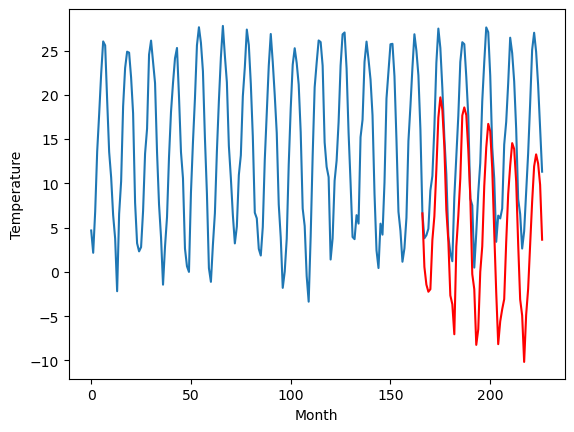

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -1.84   0.562054
1                 1    3.52   4.802054
2                 2   -1.48   0.952054
3                 3    4.05   3.422054
4                 4    8.11   7.312054
5                 5    7.80   6.022054
6                 6    3.88   5.552054
7                 7    0.92   1.722054
8                 8    0.44   0.292054
9                 9    4.68   1.532054
10               10   -1.56   0.562054


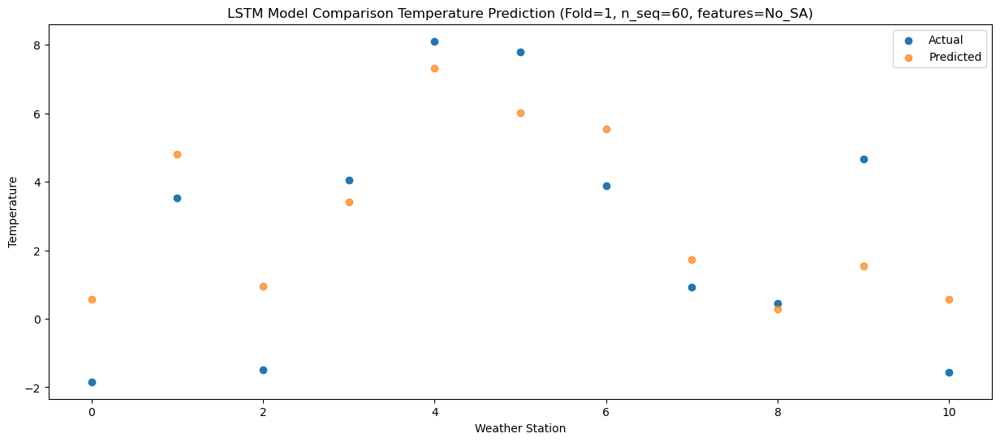

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -1.31   -1.43335
1                 1    2.61    2.80665
2                 2   -1.05   -1.04335
3                 3    2.63    1.42665
4                 4    6.22    5.31665
5                 5    5.77    4.02665
6                 6    3.15    3.55665
7                 7    0.30   -0.27335
8                 8   -1.41   -1.70335
9                 9    3.32   -0.46335
10               10   -4.37   -1.43335


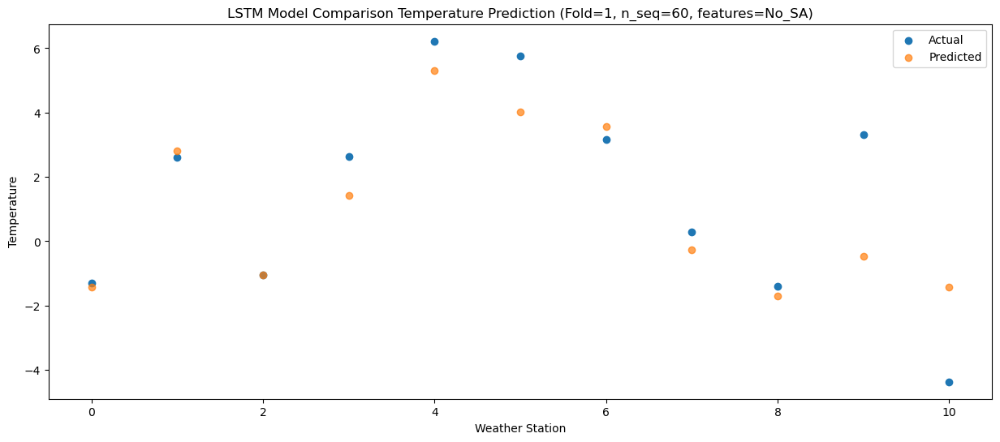

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -1.42  -2.238494
1                 1    1.50   2.001506
2                 2   -1.58  -1.848494
3                 3    3.38   0.621506
4                 4    7.03   4.511506
5                 5    5.11   3.221506
6                 6    2.34   2.751506
7                 7   -0.55  -1.078494
8                 8   -1.23  -2.508494
9                 9    2.87  -1.268494
10               10   -4.03  -2.238494


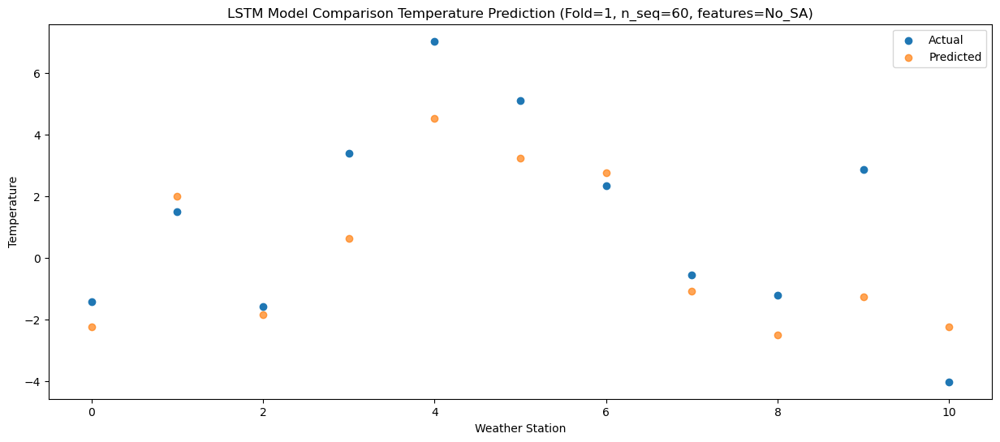

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -1.56  -1.953833
1                 1    1.59   2.286167
2                 2   -1.30  -1.563833
3                 3    2.85   0.906167
4                 4    6.65   4.796167
5                 5    4.59   3.506167
6                 6    2.41   3.036167
7                 7    0.13  -0.793833
8                 8   -1.74  -2.223833
9                 9    1.63  -0.983833
10               10   -3.29  -1.953833


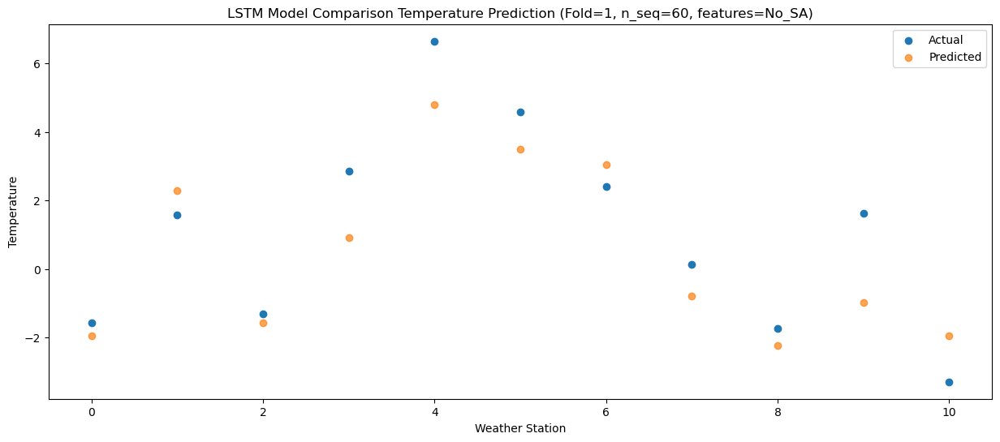

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.50   3.599092
1                 1    7.59   7.839092
2                 2    5.80   3.989092
3                 3   10.49   6.459092
4                 4   14.69  10.349092
5                 5   11.94   9.059092
6                 6    8.08   8.589092
7                 7    7.05   4.759092
8                 8    6.09   3.329092
9                 9    9.59   4.569092
10               10    1.03   3.599092


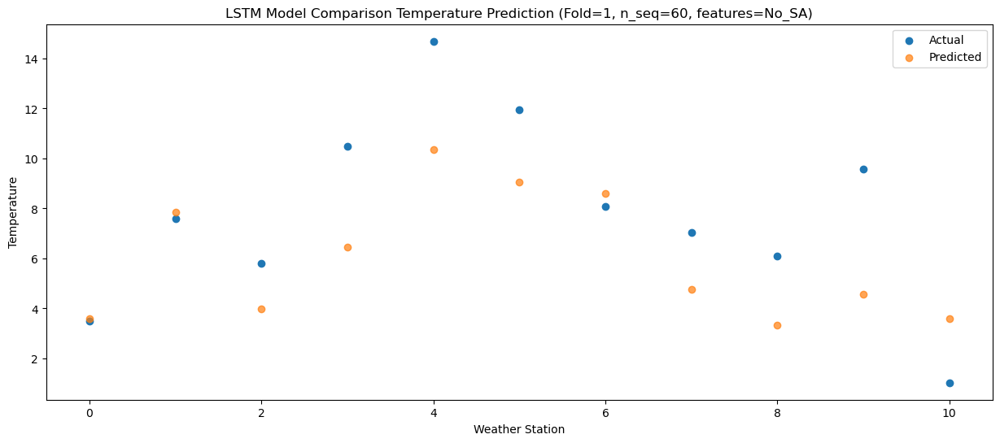

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    4.99   6.283885
1                 1    8.81  10.523885
2                 2    4.83   6.673885
3                 3   10.37   9.143885
4                 4   14.43  13.033885
5                 5   14.73  11.743885
6                 6    9.71  11.273885
7                 7    8.19   7.443885
8                 8    7.47   6.013885
9                 9   11.90   7.253885
10               10    2.66   6.283885


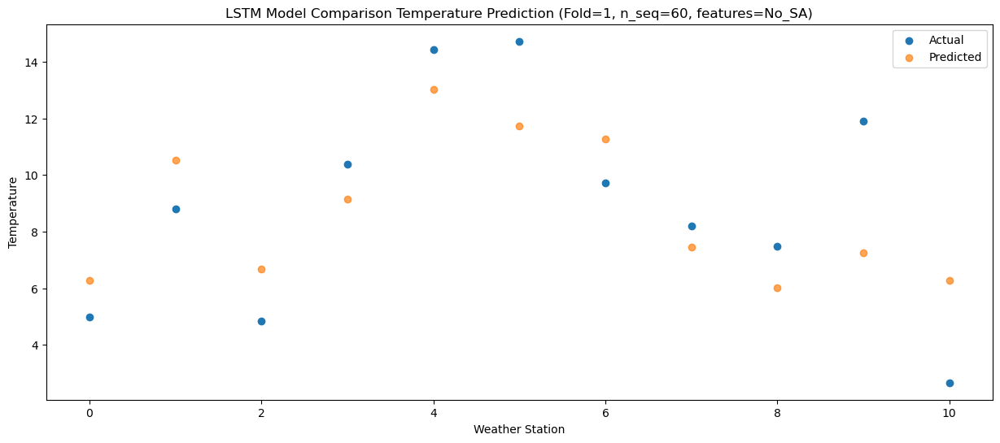

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    8.07  11.554657
1                 1   12.16  15.794657
2                 2    8.98  11.944657
3                 3   14.12  14.414657
4                 4   18.23  18.304657
5                 5   19.92  17.014657
6                 6   12.49  16.544657
7                 7   12.69  12.714657
8                 8   13.58  11.284657
9                 9   18.43  12.524657
10               10    8.12  11.554657


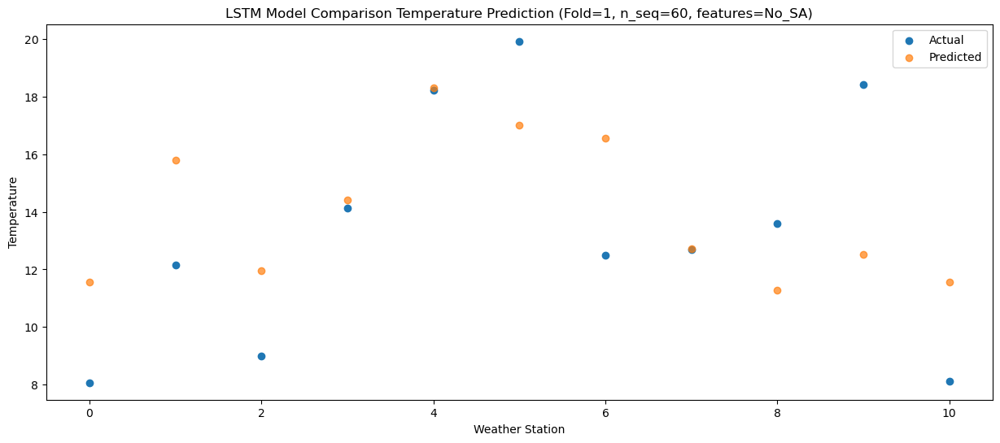

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   11.07  17.432984
1                 1   16.51  21.672984
2                 2   13.21  17.822984
3                 3   16.90  20.292984
4                 4   21.26  24.182984
5                 5   22.64  22.892984
6                 6   17.16  22.422984
7                 7   18.25  18.592984
8                 8   18.69  17.162984
9                 9   24.81  18.402984
10               10   15.44  17.432984


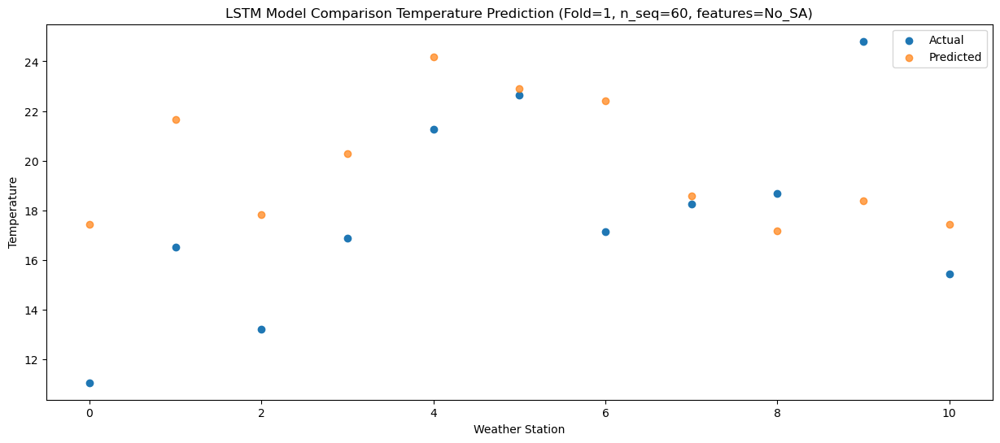

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   14.02  19.710134
1                 1   19.88  23.950134
2                 2   14.68  20.100134
3                 3   18.55  22.570134
4                 4   23.30  26.460134
5                 5   25.34  25.170134
6                 6   20.34  24.700134
7                 7   20.79  20.870134
8                 8   21.23  19.440134
9                 9   26.39  20.680134
10               10   19.31  19.710134


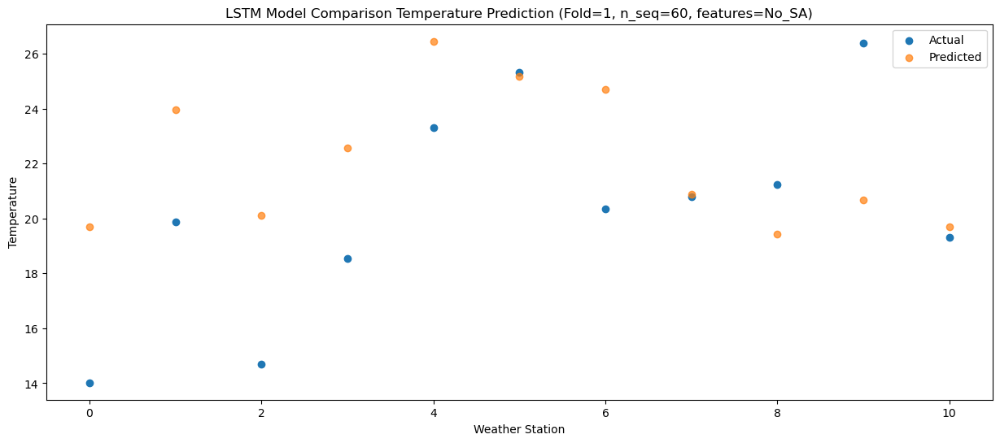

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   13.18  18.320553
1                 1   18.47  22.560553
2                 2   14.67  18.710553
3                 3   18.79  21.180553
4                 4   23.54  25.070553
5                 5   25.19  23.780553
6                 6   18.71  23.310553
7                 7   18.77  19.480553
8                 8   20.30  18.050553
9                 9   25.16  19.290553
10               10   17.12  18.320553


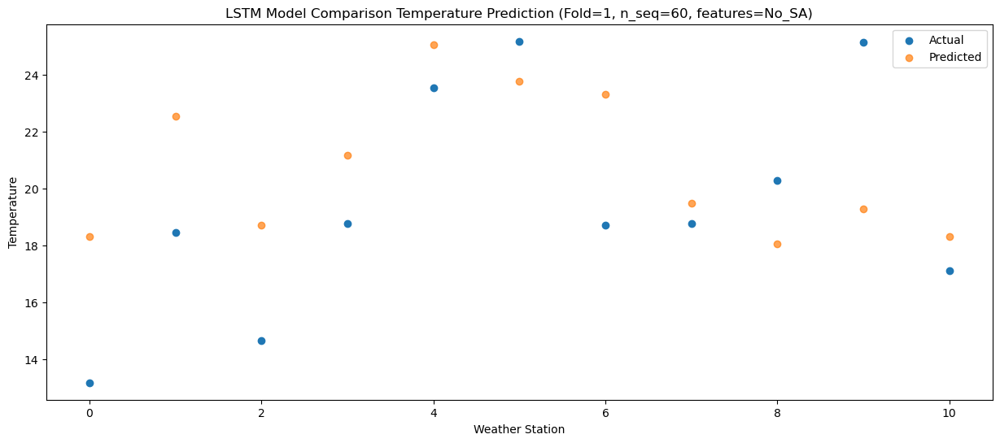

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   10.56    14.1481
1                 1   14.93    18.3881
2                 2   11.87    14.5381
3                 3   15.38    17.0081
4                 4   19.96    20.8981
5                 5   17.66    19.6081
6                 6   15.29    19.1381
7                 7   15.47    15.3081
8                 8   13.65    13.8781
9                 9   18.41    15.1181
10               10   12.59    14.1481


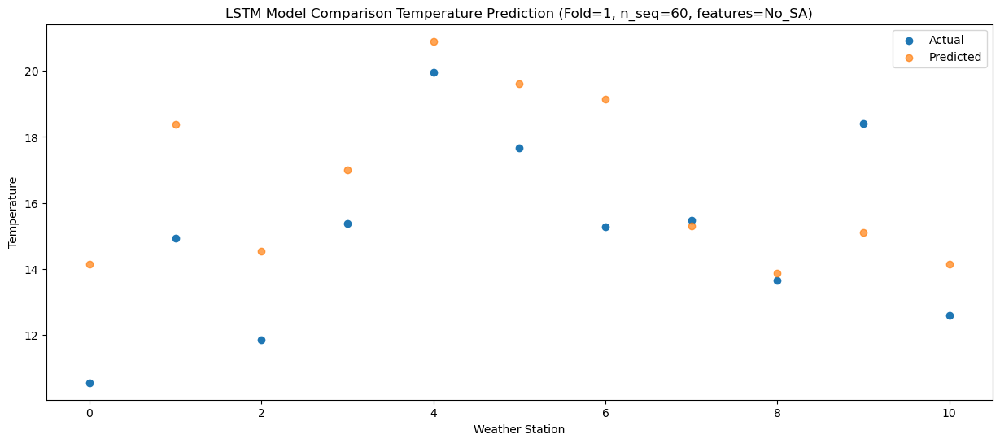

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    7.63   6.977042
1                 1   11.21  11.217042
2                 2    7.52   7.367042
3                 3   10.84   9.837042
4                 4   15.02  13.727042
5                 5   14.82  12.437042
6                 6   11.80  11.967042
7                 7    8.70   8.137042
8                 8    7.47   6.707042
9                 9   11.81   7.947042
10               10    7.05   6.977042


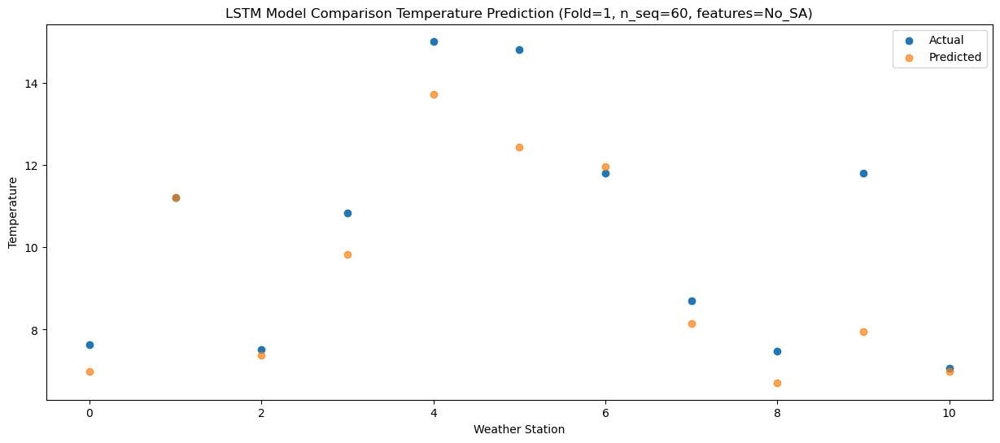

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    3.73   3.492324
1                 1    7.11   7.732324
2                 2    2.72   3.882324
3                 3    7.94   6.352324
4                 4   11.92  10.242324
5                 5   11.10   8.952324
6                 6    7.65   8.482324
7                 7    5.03   4.652324
8                 8    4.59   3.222324
9                 9    8.63   4.462324
10               10    2.85   3.492324


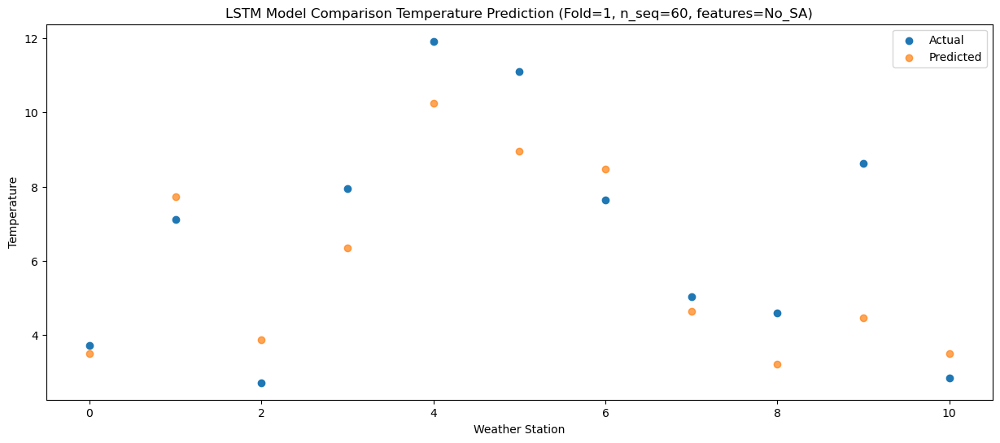

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -4.11  -2.660297
1                 1    0.22   1.579703
2                 2   -4.34  -2.270297
3                 3    1.76   0.199703
4                 4    5.56   4.089703
5                 5    4.35   2.799703
6                 6    0.44   2.329703
7                 7   -1.57  -1.500297
8                 8   -2.09  -2.930297
9                 9    1.36  -1.690297
10               10   -4.16  -2.660297


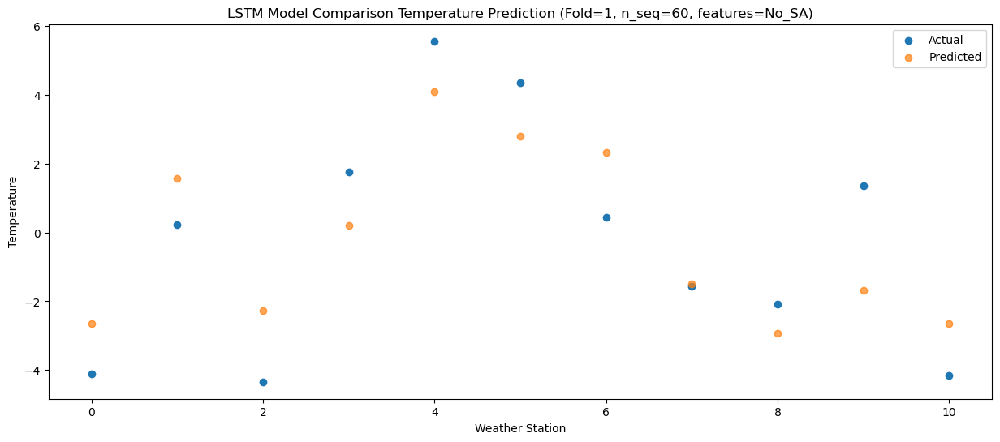

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -3.69  -3.644016
1                 1    0.02   0.595984
2                 2   -3.92  -3.254016
3                 3    1.66  -0.784016
4                 4    5.55   3.105984
5                 5    2.84   1.815984
6                 6    0.24   1.345984
7                 7   -1.88  -2.484016
8                 8   -2.44  -3.914016
9                 9    1.47  -2.674016
10               10   -6.00  -3.644016


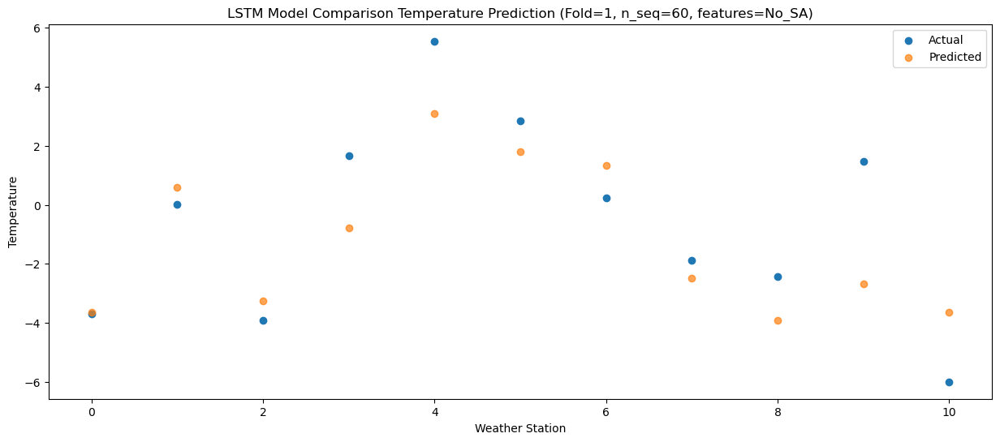

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -3.47  -7.039585
1                 1    0.68  -2.799585
2                 2   -3.43  -6.649585
3                 3    0.07  -4.179585
4                 4    3.85  -0.289585
5                 5    3.22  -1.579585
6                 6    1.02  -2.049585
7                 7   -4.88  -5.879585
8                 8   -7.22  -7.309585
9                 9   -2.90  -6.069585
10               10   -6.96  -7.039585


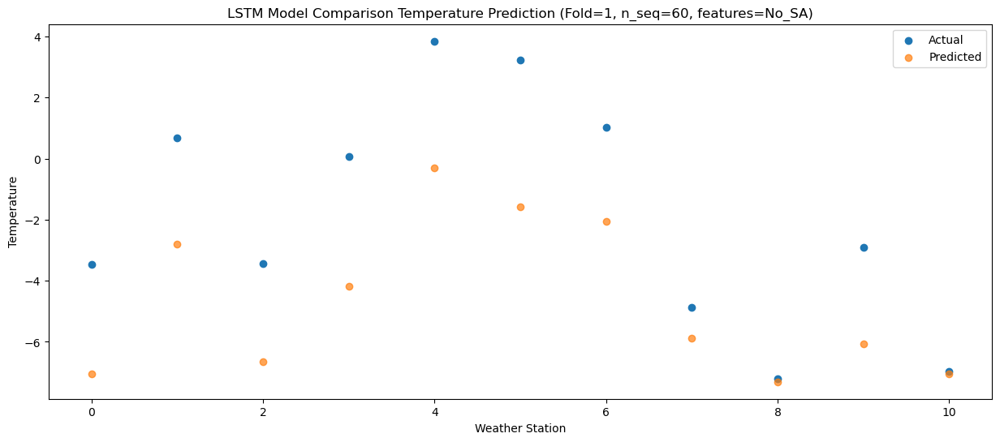

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    1.51   2.858858
1                 1    7.45   7.098856
2                 2    3.63   3.248856
3                 3    7.44   5.718856
4                 4   11.46   9.608856
5                 5   10.56   8.318856
6                 6    7.30   7.848858
7                 7    6.44   4.018858
8                 8    5.34   2.588856
9                 9    7.81   3.828856
10               10    0.26   2.858858


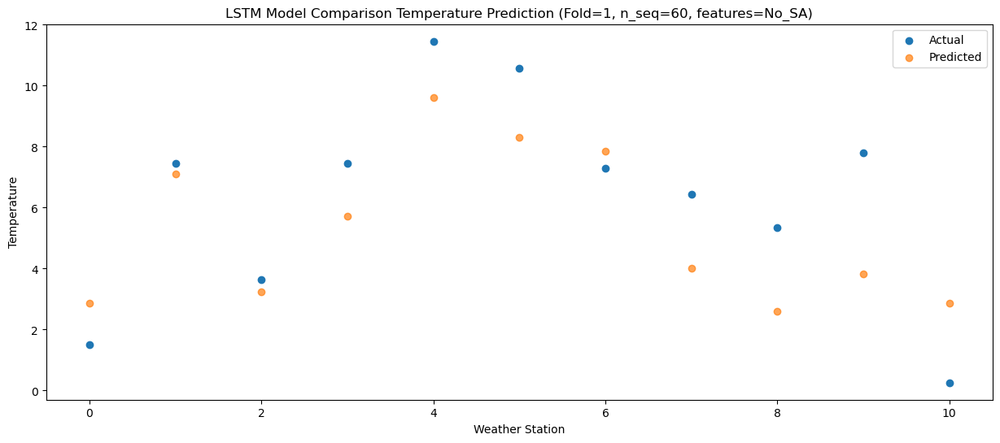

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    4.32   6.321060
1                 1    9.59  10.561058
2                 2    5.03   6.711058
3                 3    9.78   9.181058
4                 4   13.76  13.071058
5                 5   12.83  11.781058
6                 6    9.87  11.311060
7                 7    8.15   7.481060
8                 8    7.14   6.051058
9                 9   11.57   7.291058
10               10    4.91   6.321060


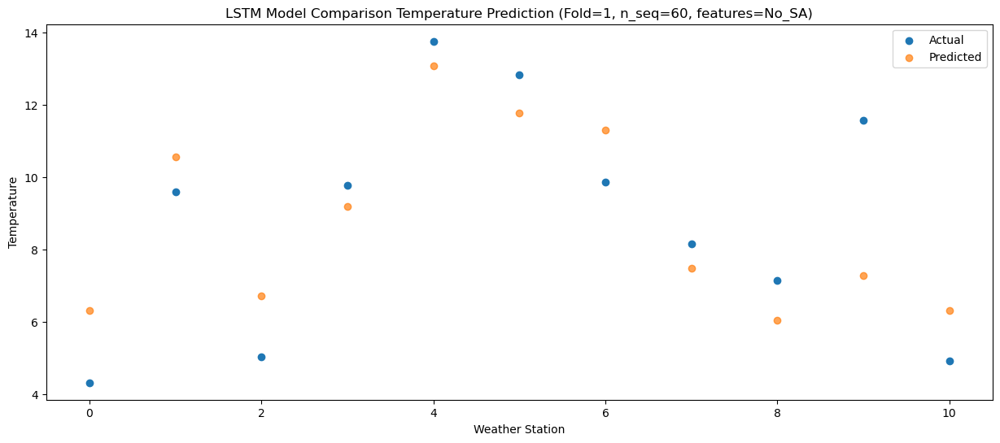

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    7.93  10.585516
1                 1   13.32  14.825514
2                 2    9.15  10.975514
3                 3   13.67  13.445514
4                 4   17.88  17.335514
5                 5   18.42  16.045514
6                 6   13.64  15.575516
7                 7   12.81  11.745516
8                 8   11.95  10.315514
9                 9   16.12  11.555514
10               10    9.45  10.585516


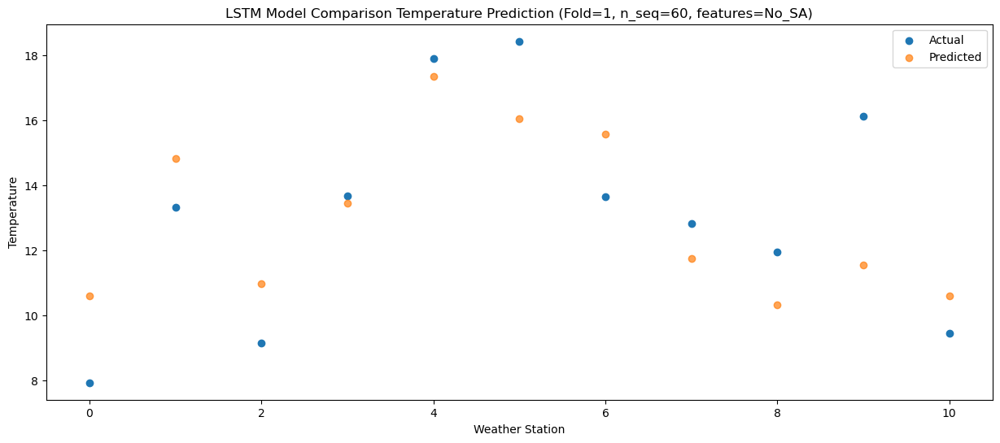

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   11.42  17.663517
1                 1   17.46  21.903513
2                 2   13.03  18.053513
3                 3   17.56  20.523513
4                 4   21.35  24.413513
5                 5   22.69  23.123513
6                 6   17.65  22.653515
7                 7   18.89  18.823515
8                 8   17.98  17.393513
9                 9   23.23  18.633513
10               10   15.54  17.663517


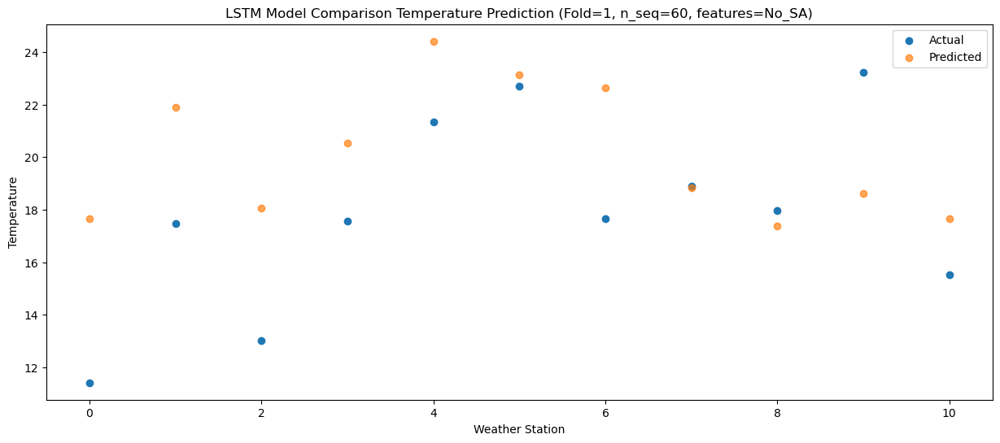

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   12.62  18.577175
1                 1   18.84  22.817172
2                 2   13.80  18.967170
3                 3   17.44  21.437170
4                 4   21.44  25.327170
5                 5   22.03  24.037170
6                 6   19.01  23.567173
7                 7   19.88  19.737173
8                 8   19.49  18.307170
9                 9   23.90  19.547170
10               10   17.77  18.577175


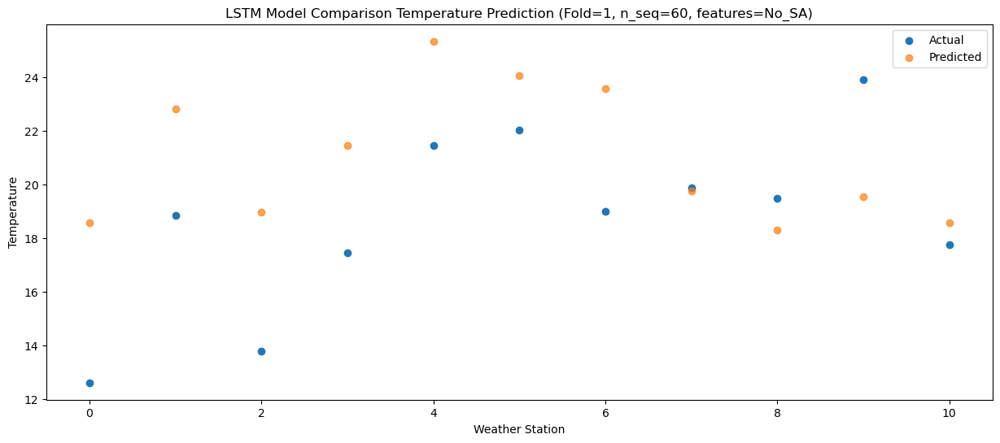

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   12.73  17.710799
1                 1   19.11  21.950795
2                 2   14.46  18.100793
3                 3   18.41  20.570793
4                 4   22.41  24.460793
5                 5   21.44  23.170793
6                 6   19.27  22.700797
7                 7   21.10  18.870797
8                 8   19.88  17.440793
9                 9   23.75  18.680793
10               10   17.55  17.710799


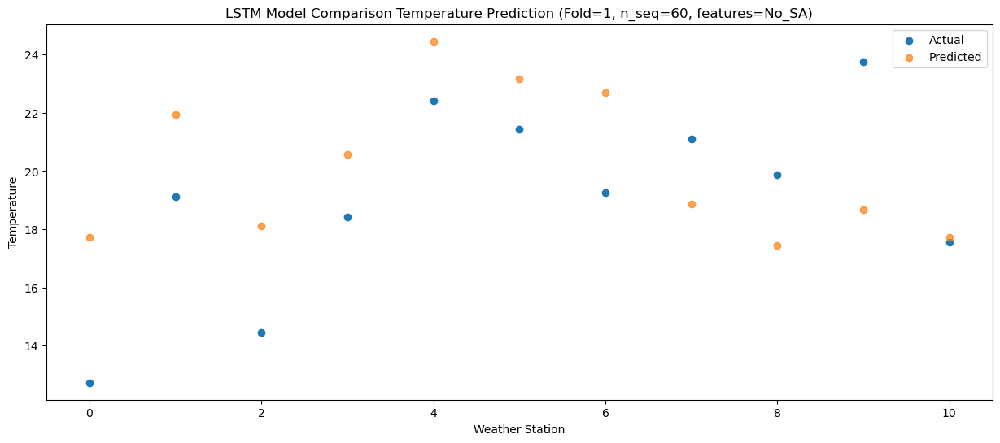

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   10.08  13.786239
1                 1   15.37  18.026236
2                 2   11.44  14.176234
3                 3   15.40  16.646234
4                 4   18.83  20.536234
5                 5   21.08  19.246234
6                 6   15.94  18.776237
7                 7   17.39  14.946237
8                 8   17.37  13.516234
9                 9   21.80  14.756234
10               10   13.85  13.786239


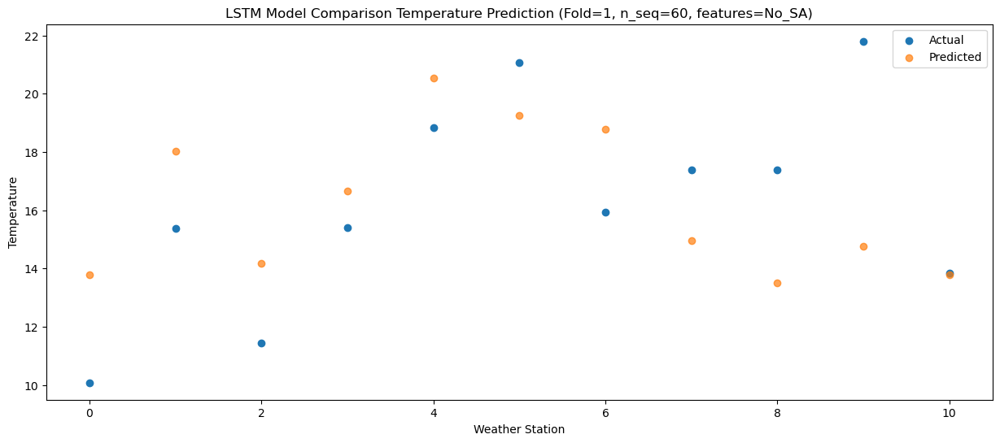

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    6.38   8.530764
1                 1   11.59  12.770759
2                 2    7.66   8.920757
3                 3   12.71  11.390757
4                 4   15.79  15.280757
5                 5   16.76  13.990757
6                 6   11.99  13.520762
7                 7   12.19   9.690762
8                 8   11.12   8.260757
9                 9   14.36   9.500757
10               10    9.43   8.530764


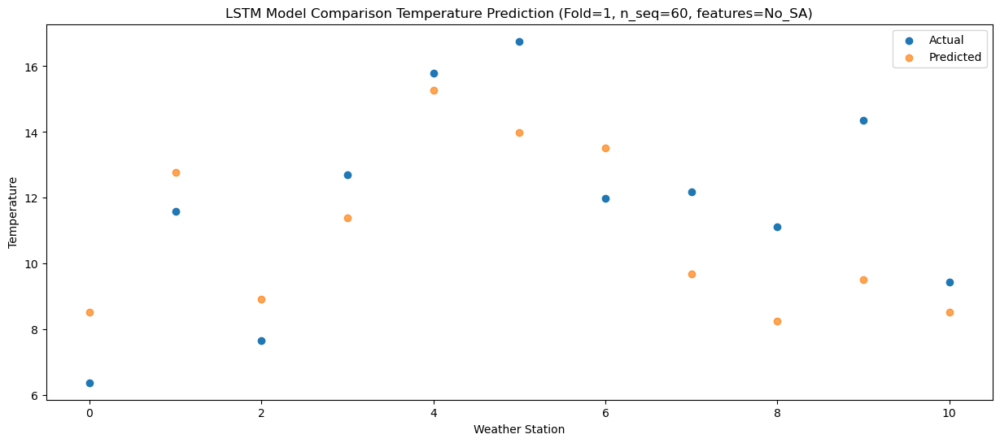

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -1.83  -0.250900
1                 1    3.93   3.989095
2                 2   -0.08   0.139093
3                 3    5.55   2.609093
4                 4    8.24   6.499093
5                 5   10.29   5.209093
6                 6    4.39   4.739098
7                 7    2.89   0.909098
8                 8    3.37  -0.520907
9                 9    8.11   0.719093
10               10    0.11  -0.250900


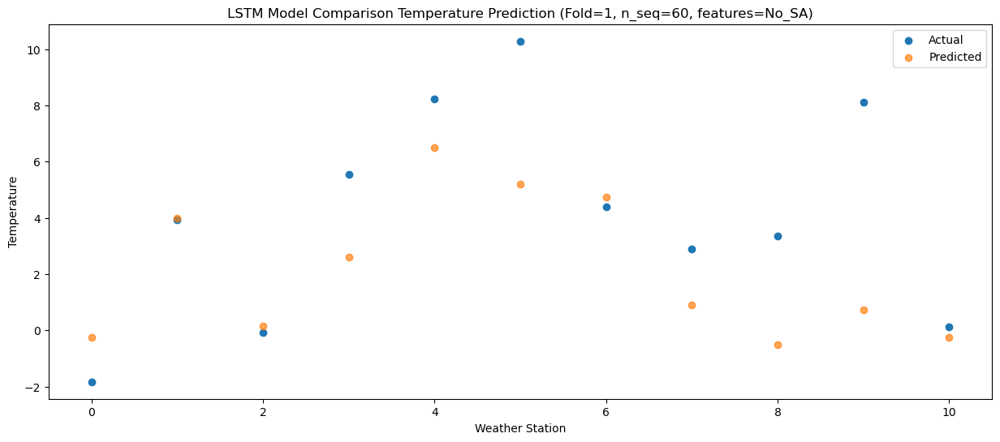

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    0.52  -1.952364
1                 1    5.56   2.287632
2                 2    2.52  -1.562370
3                 3    8.92   0.907630
4                 4   12.12   4.797630
5                 5   10.55   3.507630
6                 6    5.91   3.037635
7                 7    5.30  -0.792365
8                 8    2.56  -2.222370
9                 9    6.50  -0.982370
10               10   -0.66  -1.952364


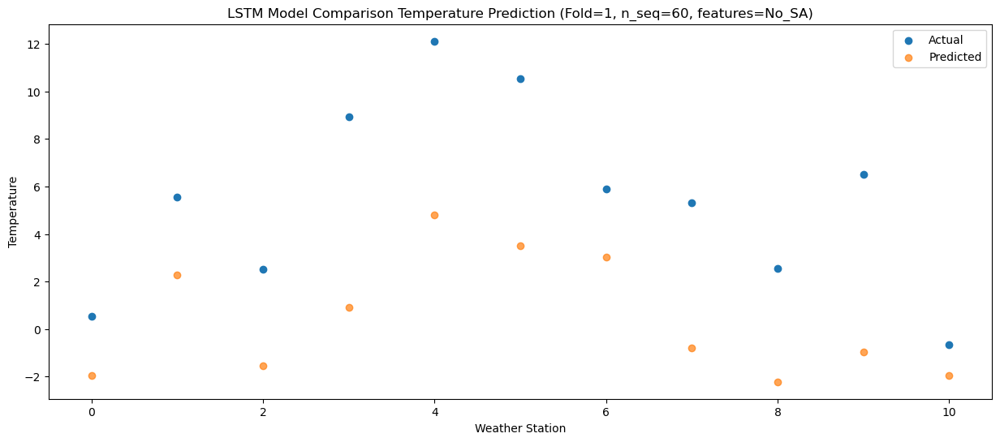

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -5.64  -8.237233
1                 1   -1.17  -3.997238
2                 2   -4.37  -7.847240
3                 3    0.87  -5.377240
4                 4    3.64  -1.487240
5                 5    3.23  -2.777240
6                 6   -0.48  -3.247235
7                 7   -3.53  -7.077235
8                 8   -5.06  -8.507240
9                 9   -0.42  -7.267240
10               10   -7.68  -8.237233


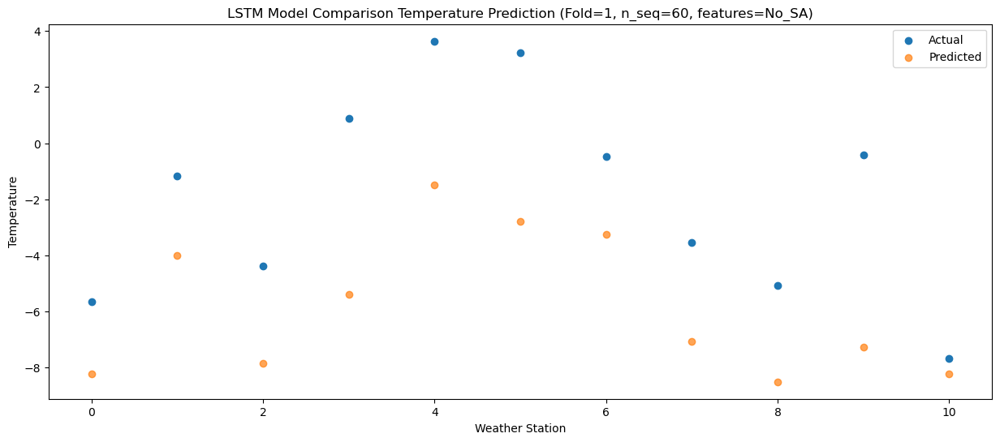

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.80  -6.473085
1                 1    3.06  -2.233090
2                 2   -1.02  -6.083092
3                 3    0.40  -3.613092
4                 4    3.33   0.276908
5                 5    3.12  -1.013092
6                 6    3.33  -1.483087
7                 7   -1.48  -5.313087
8                 8   -4.08  -6.743092
9                 9   -0.36  -5.503092
10               10   -3.78  -6.473085


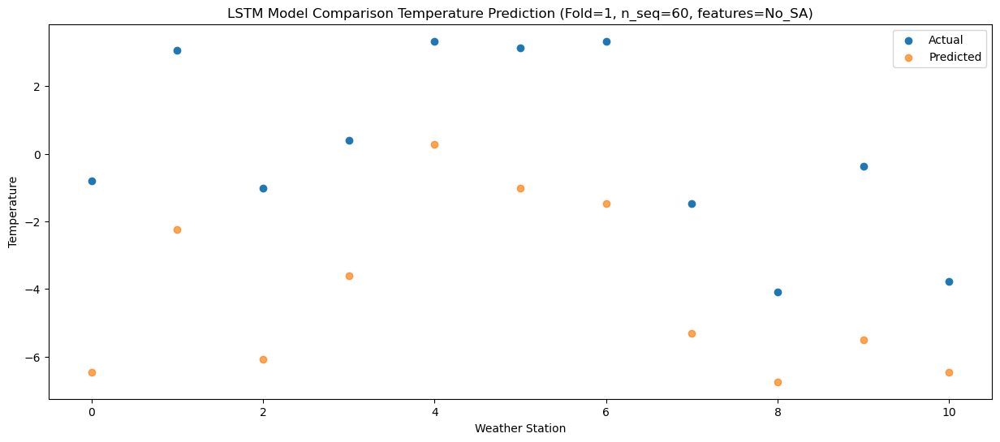

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    2.59   0.009874
1                 1    6.63   4.249869
2                 2    2.98   0.399867
3                 3    6.24   2.869867
4                 4    9.11   6.759867
5                 5   10.07   5.469867
6                 6    7.17   4.999872
7                 7    4.47   1.169872
8                 8    3.17  -0.260133
9                 9    6.57   0.979867
10               10    0.78   0.009874


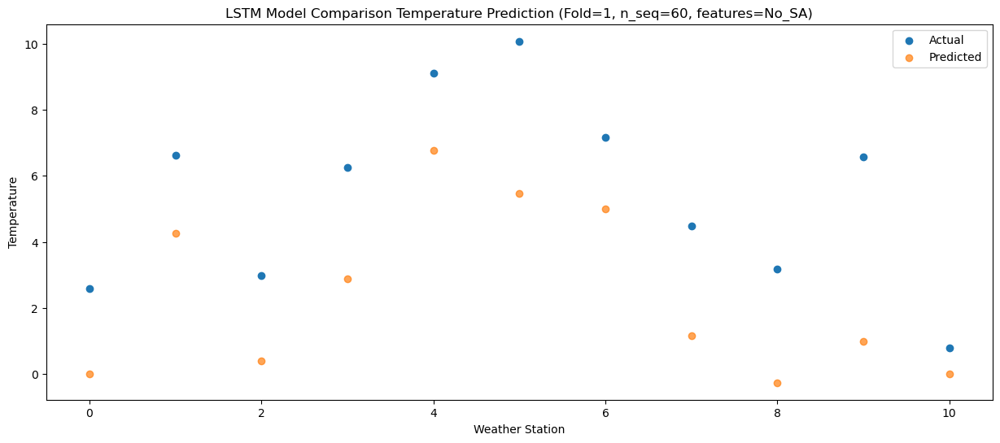

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    4.58   2.886319
1                 1    9.63   7.126315
2                 2    6.57   3.276313
3                 3   12.24   5.746313
4                 4   15.38   9.636313
5                 5   16.98   8.346313
6                 6    9.93   7.876317
7                 7    9.66   4.046317
8                 8   10.28   2.616313
9                 9   13.05   3.856313
10               10    4.13   2.886317


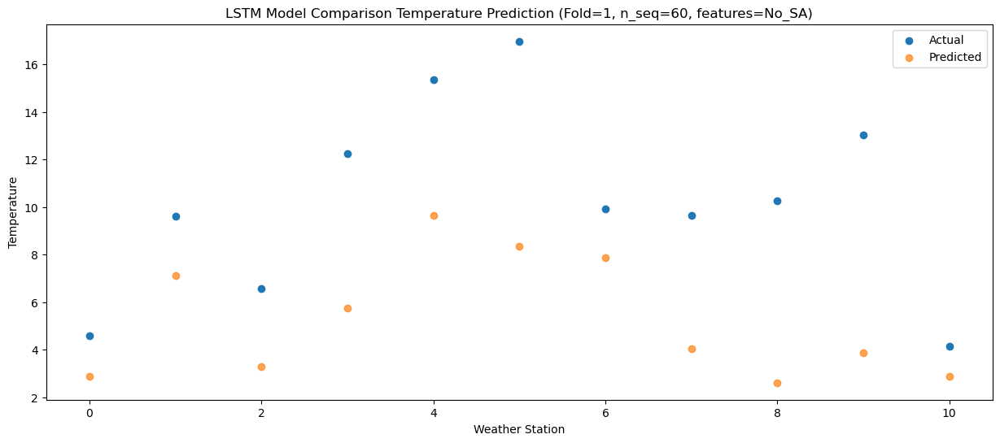

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    9.83   9.684082
1                 1   15.51  13.924077
2                 2   11.93  10.074075
3                 3   16.67  12.544075
4                 4   20.00  16.434075
5                 5   22.38  15.144075
6                 6   15.85  14.674080
7                 7   15.13  10.844080
8                 8   15.64   9.414075
9                 9   18.50  10.654075
10               10   11.11   9.684080


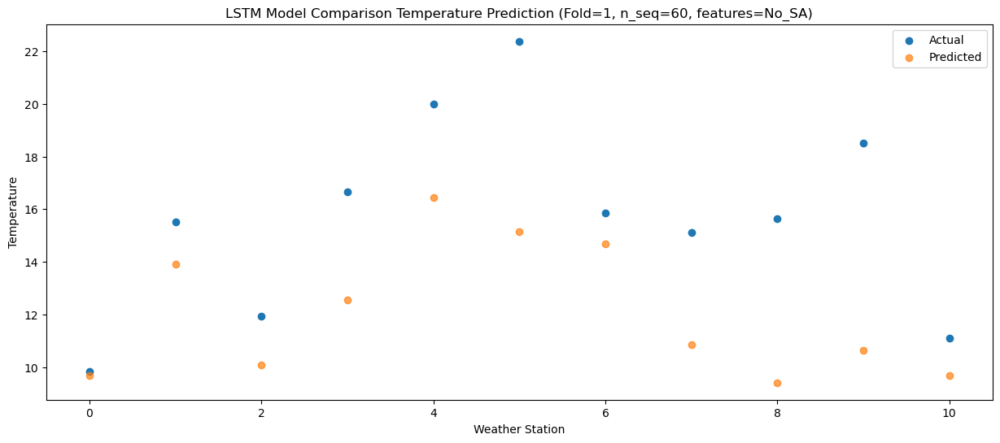

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   12.33  14.038502
1                 1   19.48  18.278496
2                 2   14.90  14.428496
3                 3   19.67  16.898496
4                 4   23.37  20.788496
5                 5   24.44  19.498496
6                 6   19.43  19.028499
7                 7   19.19  15.198501
8                 8   19.93  13.768496
9                 9   23.07  15.008496
10               10   15.50  14.038499


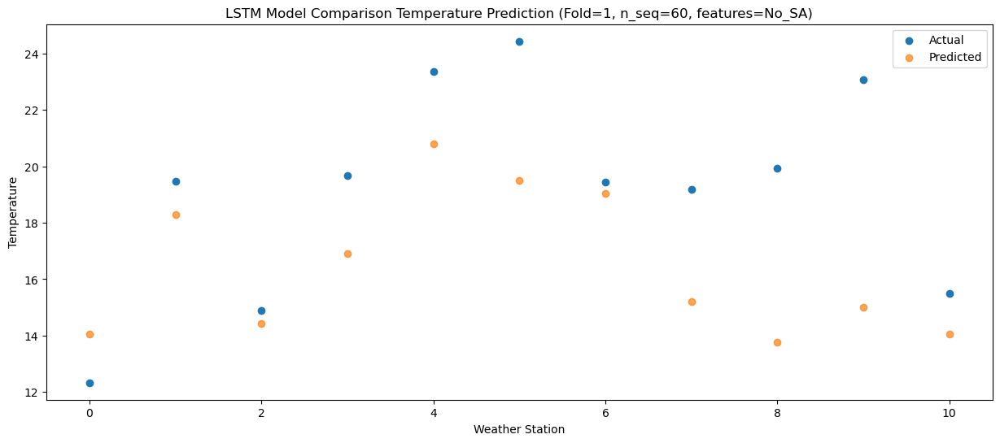

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   13.23  16.719937
1                 1   19.98  20.959931
2                 2   15.61  17.109931
3                 3   20.61  19.579931
4                 4   24.46  23.469931
5                 5   25.36  22.179932
6                 6   20.17  21.709933
7                 7   23.32  17.879935
8                 8   24.08  16.449931
9                 9   26.67  17.689931
10               10   19.44  16.719935


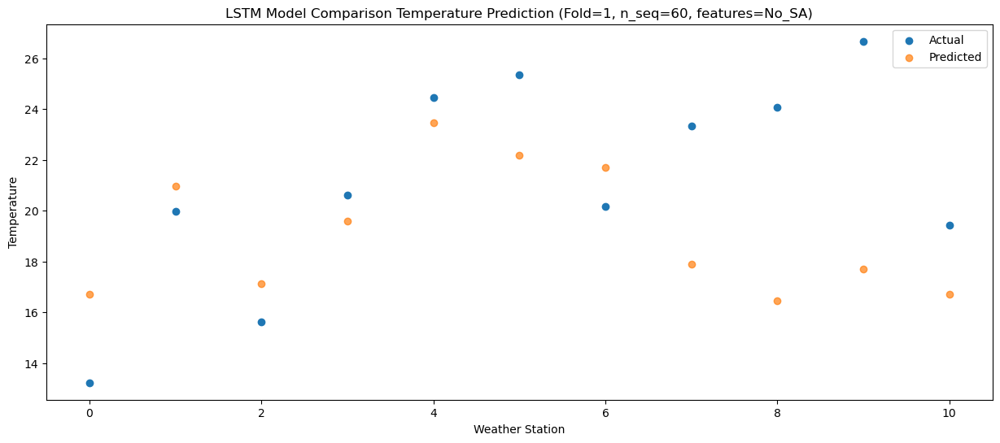

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   12.43  15.879490
1                 1   18.52  20.119484
2                 2   14.00  16.269484
3                 3   18.97  18.739484
4                 4   22.45  22.629484
5                 5   22.51  21.339486
6                 6   18.67  20.869487
7                 7   20.45  17.039489
8                 8   21.41  15.609484
9                 9   23.84  16.849484
10               10   18.90  15.879489


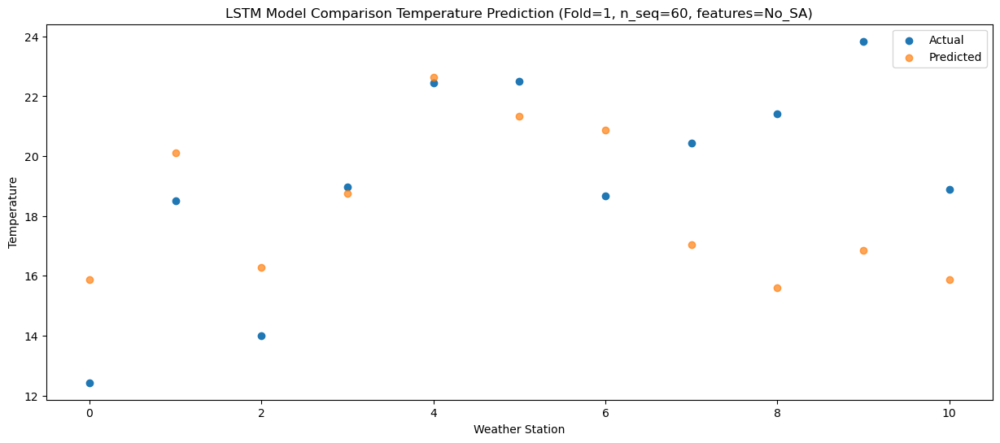

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   10.47  11.683421
1                 1   15.43  15.923415
2                 2   11.61  12.073414
3                 3   16.20  14.543414
4                 4   19.27  18.433414
5                 5   19.46  17.143416
6                 6   15.78  16.673417
7                 7   16.61  12.843419
8                 8   17.58  11.413414
9                 9   21.43  12.653414
10               10   13.99  11.683419


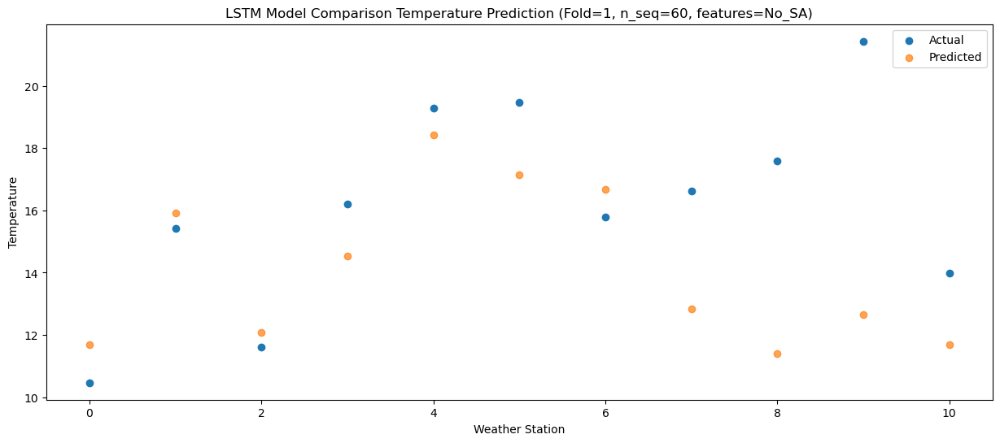

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    3.92   4.525479
1                 1    9.09   8.765472
2                 2    4.92   4.915472
3                 3   10.64   7.385472
4                 4   13.88  11.275472
5                 5   13.38   9.985474
6                 6    9.44   9.515475
7                 7    9.94   5.685477
8                 8    9.35   4.255472
9                 9   12.89   5.495472
10               10    5.89   4.525477


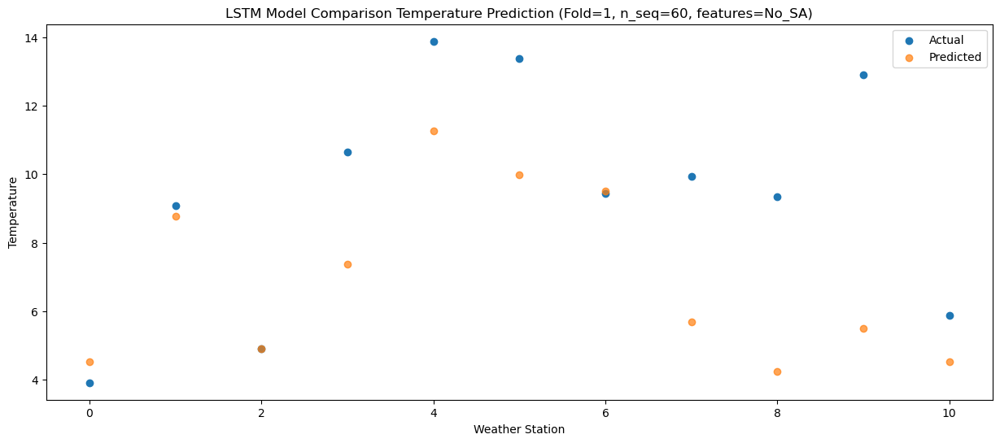

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    2.72  -2.304944
1                 1    6.09   1.935049
2                 2    1.60  -1.914951
3                 3    5.59   0.555049
4                 4    8.88   4.445049
5                 5    6.42   3.155051
6                 6    6.55   2.685052
7                 7    3.34  -1.144946
8                 8    1.50  -2.574951
9                 9    3.90  -1.334951
10               10    2.38  -2.304946


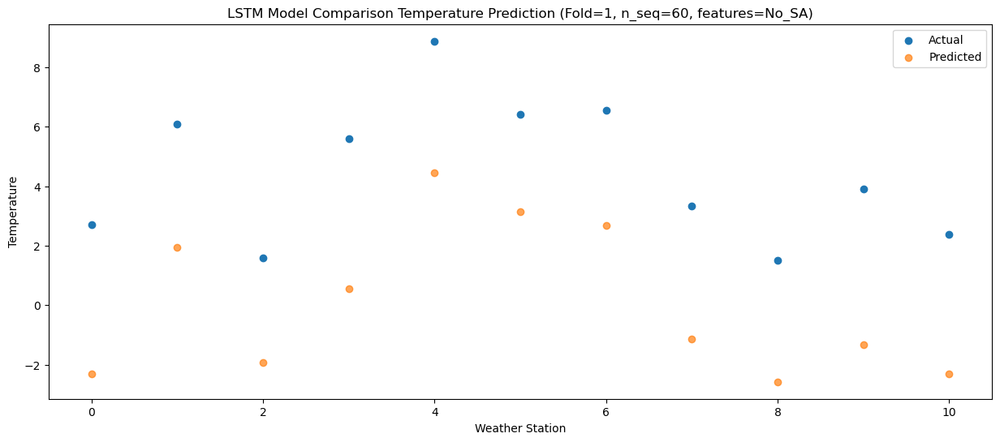

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -3.04  -8.158605
1                 1    0.28  -3.918612
2                 2   -1.56  -7.768612
3                 3    3.50  -5.298612
4                 4    6.86  -1.408612
5                 5    5.30  -2.698610
6                 6    0.54  -3.168609
7                 7   -0.40  -6.998607
8                 8   -2.13  -8.428612
9                 9    1.55  -7.188612
10               10   -4.77  -8.158607


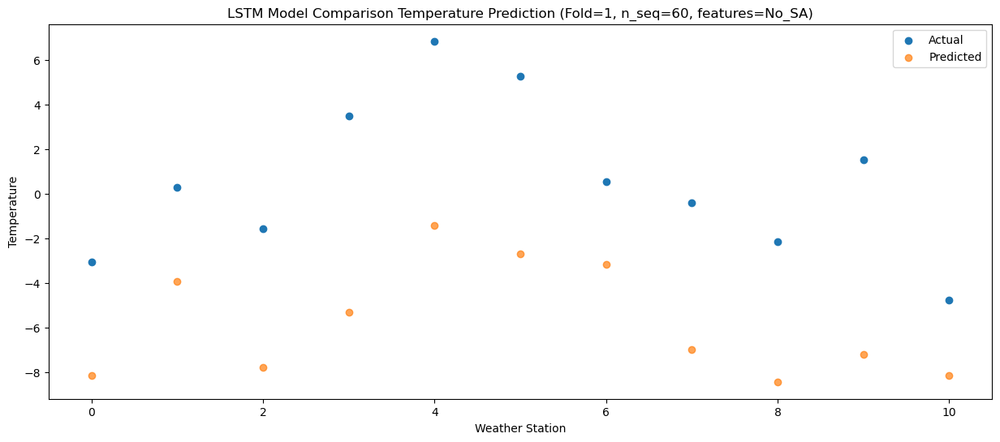

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -0.93  -5.590852
1                 1    2.47  -1.350858
2                 2   -0.56  -5.200858
3                 3    4.21  -2.730858
4                 4    7.34   1.159142
5                 5    5.76  -0.130857
6                 6    2.67  -0.600856
7                 7    0.79  -4.430854
8                 8   -1.27  -5.860858
9                 9    1.83  -4.620858
10               10   -1.81  -5.590854


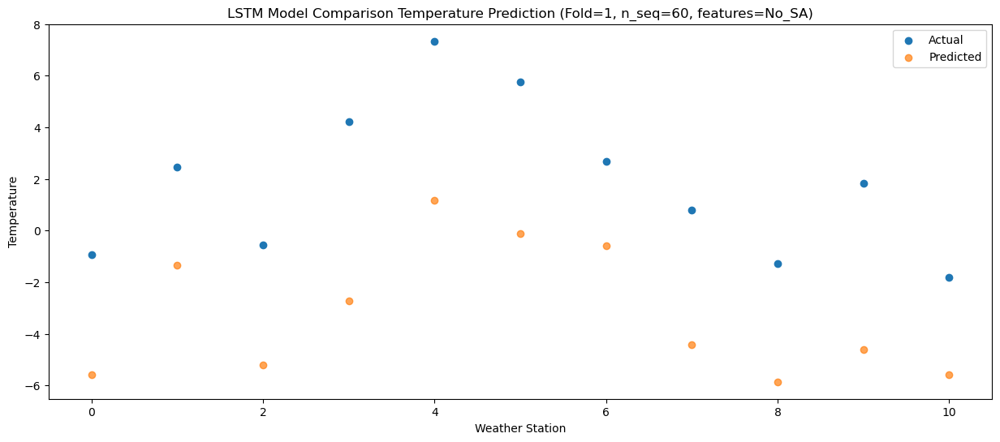

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    1.98  -4.207714
1                 1    5.84   0.032277
2                 2    2.03  -3.817723
3                 3    5.21  -1.347723
4                 4    8.52   2.542277
5                 5    5.90   1.252281
6                 6    6.26   0.782282
7                 7    2.29  -3.047716
8                 8   -0.90  -4.477723
9                 9    2.98  -3.237723
10               10   -2.13  -4.207716


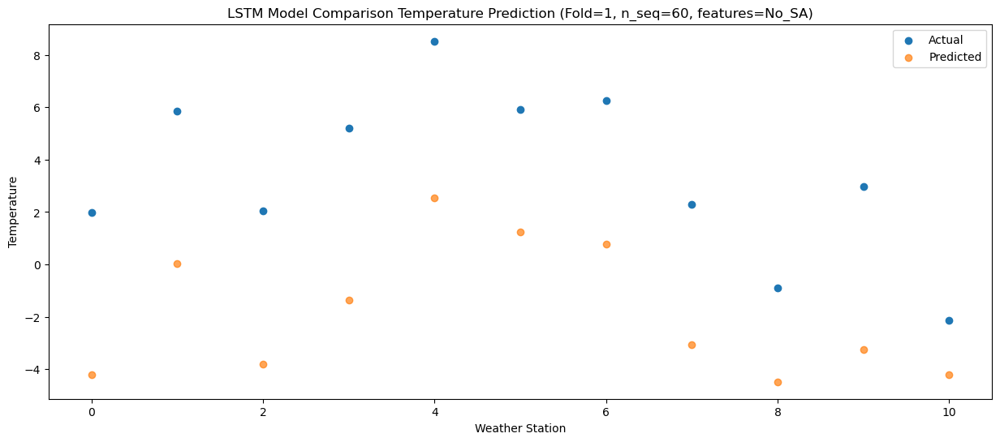

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    2.62  -3.076416
1                 1    6.61   1.163575
2                 2    3.46  -2.686425
3                 3    9.04  -0.216425
4                 4   12.34   3.673575
5                 5   10.96   2.383579
6                 6    6.93   1.913580
7                 7    5.12  -1.916418
8                 8    3.53  -3.346425
9                 9    6.71  -2.106425
10               10   -1.01  -3.076418


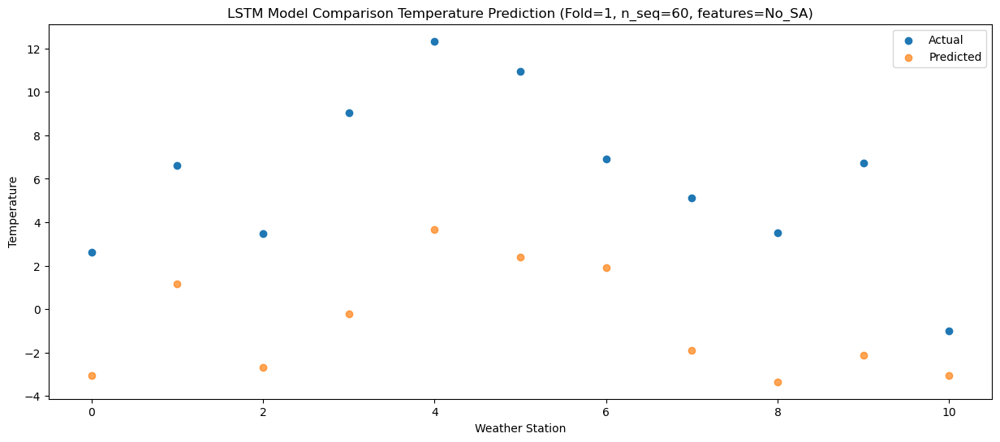

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    6.12   3.349183
1                 1    9.88   7.589174
2                 2    6.15   3.739174
3                 3    9.88   6.209174
4                 4   13.30  10.099174
5                 5   14.12   8.809178
6                 6   10.19   8.339179
7                 7    9.52   4.509181
8                 8    7.86   3.079174
9                 9   12.06   4.319174
10               10    6.21   3.349181


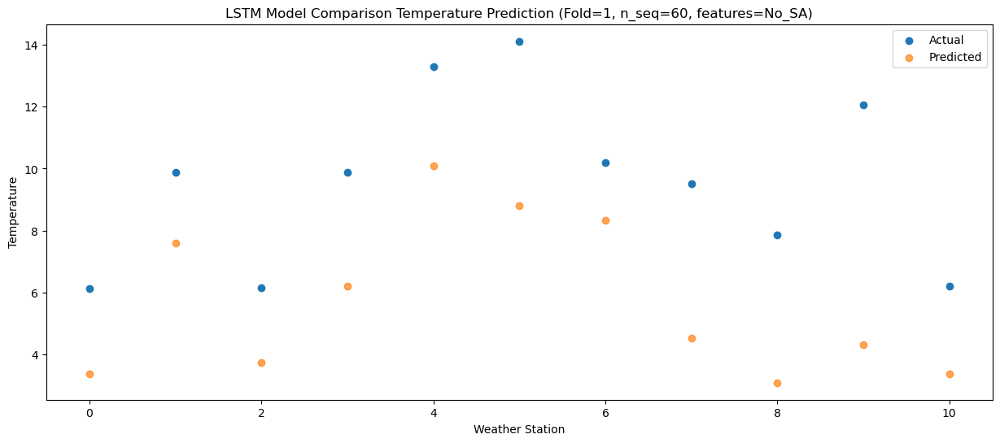

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    7.62   8.788642
1                 1   13.16  13.028634
2                 2    9.39   9.178634
3                 3   14.47  11.648634
4                 4   17.94  15.538634
5                 5   18.73  14.248637
6                 6   13.19  13.778638
7                 7   14.87   9.948640
8                 8   13.55   8.518634
9                 9   17.17   9.758634
10               10    8.77   8.788640


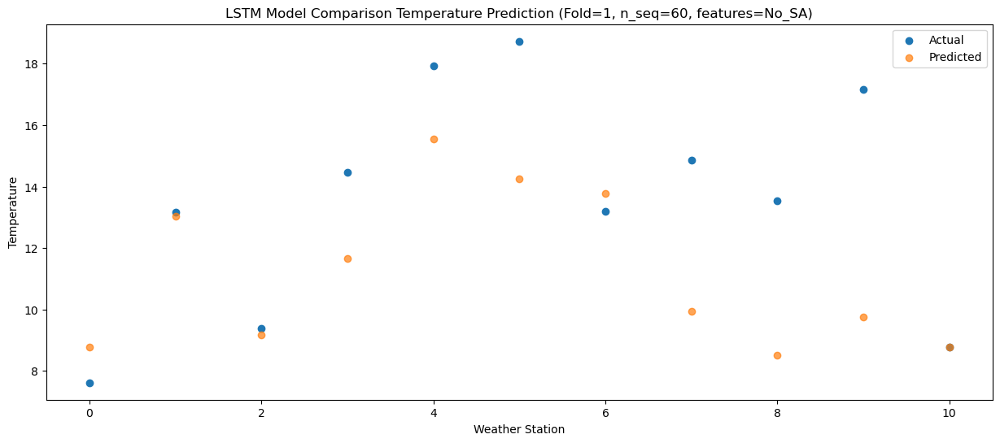

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   11.24  11.988879
1                 1   16.35  16.228870
2                 2   13.14  12.378870
3                 3   18.62  14.848870
4                 4   22.83  18.738870
5                 5   25.42  17.448874
6                 6   16.47  16.978875
7                 7   18.68  13.148877
8                 8   18.48  11.718870
9                 9   20.40  12.958870
10               10   13.14  11.988877


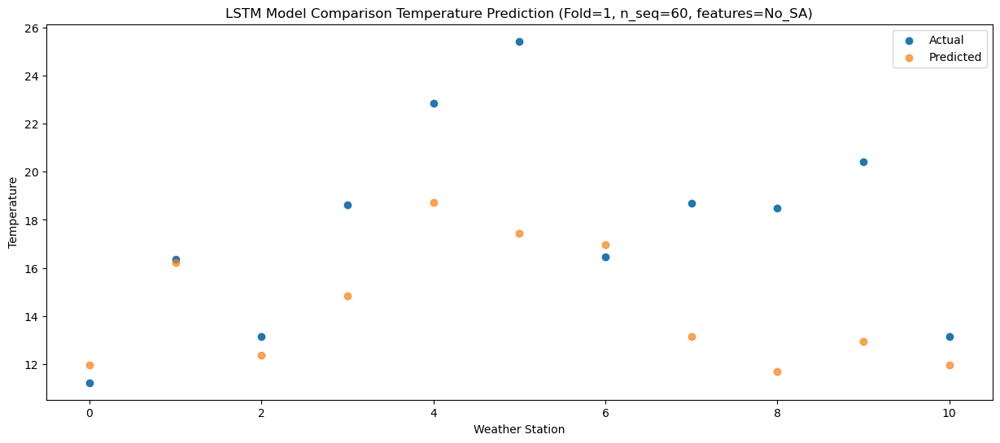

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   14.47  14.545533
1                 1   19.95  18.785525
2                 2   15.51  14.935525
3                 3   20.34  17.405525
4                 4   24.78  21.295525
5                 5   26.52  20.005528
6                 6   19.92  19.535529
7                 7   20.98  15.705531
8                 8   21.36  14.275525
9                 9   25.02  15.515525
10               10   18.28  14.545531


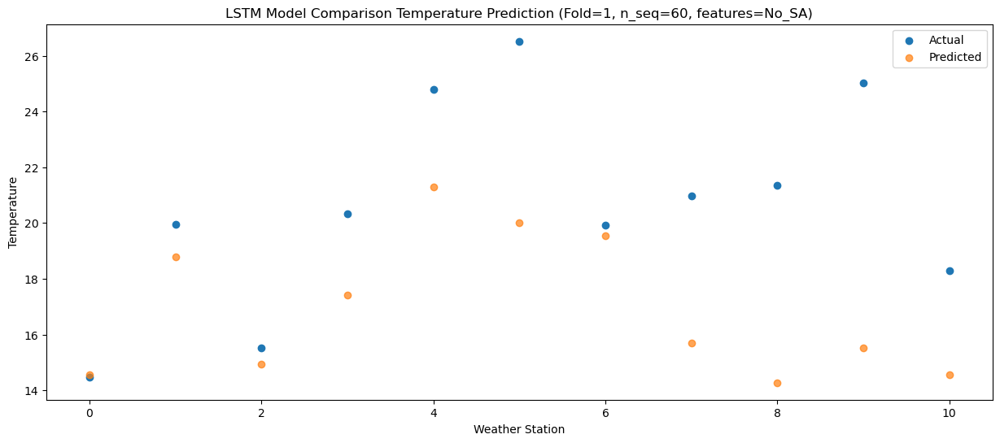

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   14.26  13.881265
1                 1   19.41  18.121256
2                 2   15.95  14.271256
3                 3   22.31  16.741256
4                 4   26.21  20.631256
5                 5   25.71  19.341260
6                 6   19.50  18.871261
7                 7   21.48  15.041263
8                 8   23.17  13.611256
9                 9   25.42  14.851256
10               10   16.54  13.881263


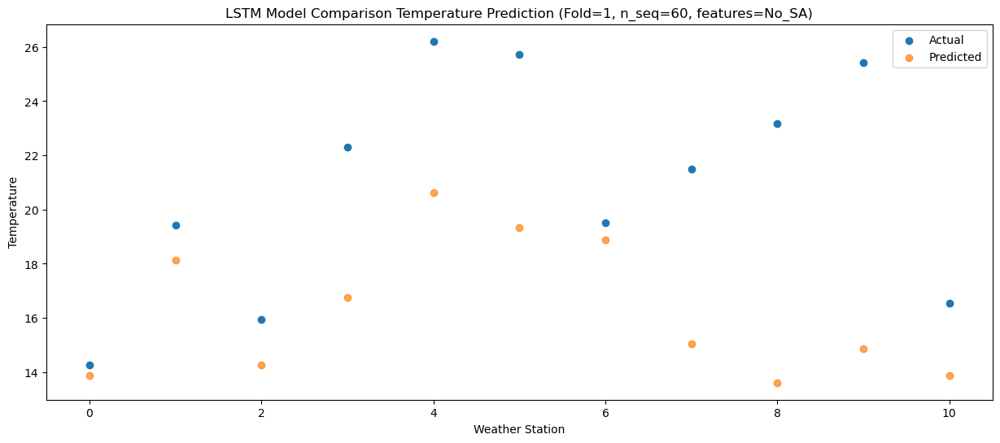

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   10.57  10.204399
1                 1   15.90  14.444390
2                 2   12.99  10.594390
3                 3   19.23  13.064390
4                 4   22.36  16.954390
5                 5   23.43  15.664394
6                 6   16.33  15.194395
7                 7   17.86  11.364397
8                 8   18.53   9.934390
9                 9   21.90  11.174390
10               10   13.35  10.204397


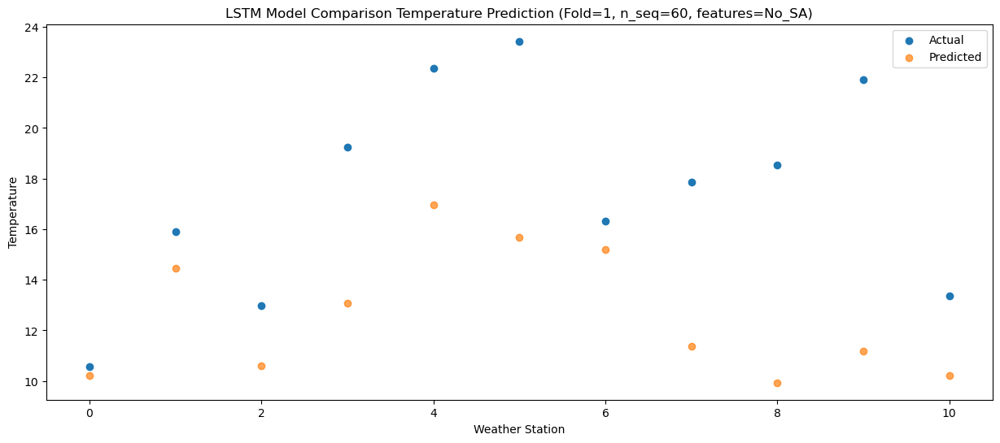

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    5.69   3.159412
1                 1   10.89   7.399403
2                 2    6.95   3.549403
3                 3   11.97   6.019403
4                 4   14.96   9.909403
5                 5   15.83   8.619406
6                 6   11.32   8.149408
7                 7   11.55   4.319410
8                 8    9.95   2.889403
9                 9   13.80   4.129403
10               10    8.00   3.159410


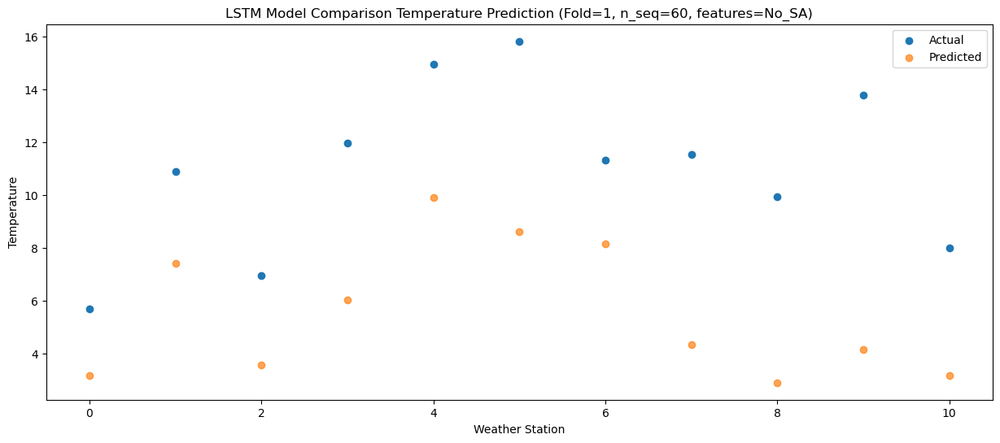

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    0.54  -3.101770
1                 1    5.27   1.138220
2                 2    0.39  -2.711780
3                 3    5.69  -0.241780
4                 4    8.76   3.648220
5                 5    9.17   2.358224
6                 6    5.63   1.888226
7                 7    4.15  -1.941772
8                 8    2.83  -3.371780
9                 9    7.05  -2.131780
10               10    0.06  -3.101772


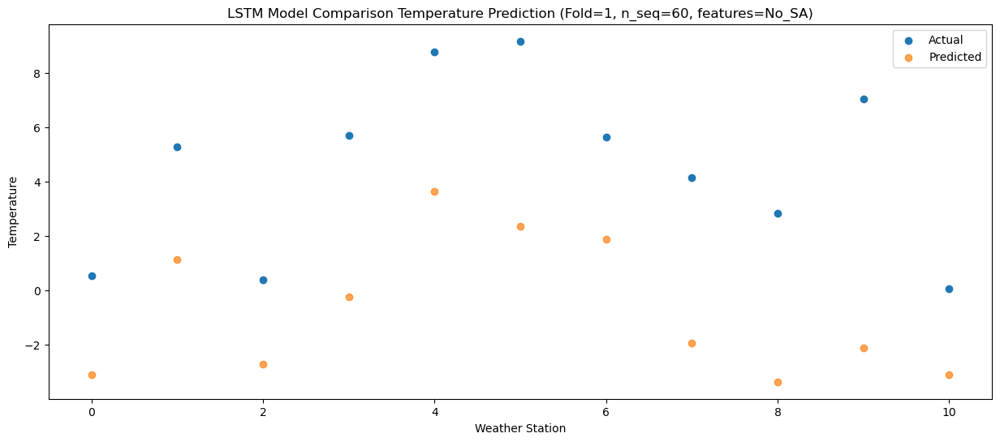

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -1.49  -4.917113
1                 1    2.13  -0.677122
2                 2   -2.39  -4.527122
3                 3    3.29  -2.057122
4                 4    6.86   1.832878
5                 5    6.81   0.542881
6                 6    2.89   0.072883
7                 7    1.23  -3.757115
8                 8   -0.02  -5.187122
9                 9    3.22  -3.947122
10               10   -1.63  -4.917115


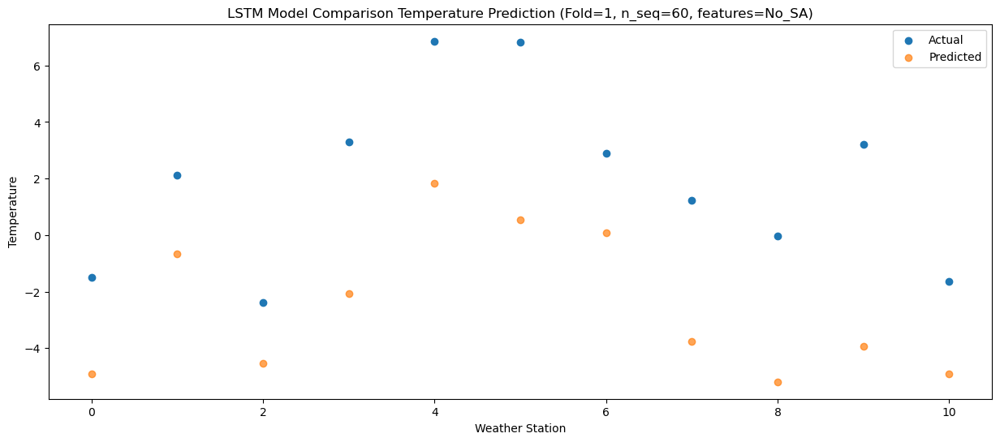

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -2.81 -10.163167
1                 1   -1.15  -5.923177
2                 2   -5.47  -9.773177
3                 3   -0.13  -7.303177
4                 4    3.01  -3.413177
5                 5    3.20  -4.703173
6                 6   -0.11  -5.173171
7                 7   -4.70  -9.003169
8                 8   -5.85 -10.433177
9                 9   -1.95  -9.193177
10               10   -5.53 -10.163169


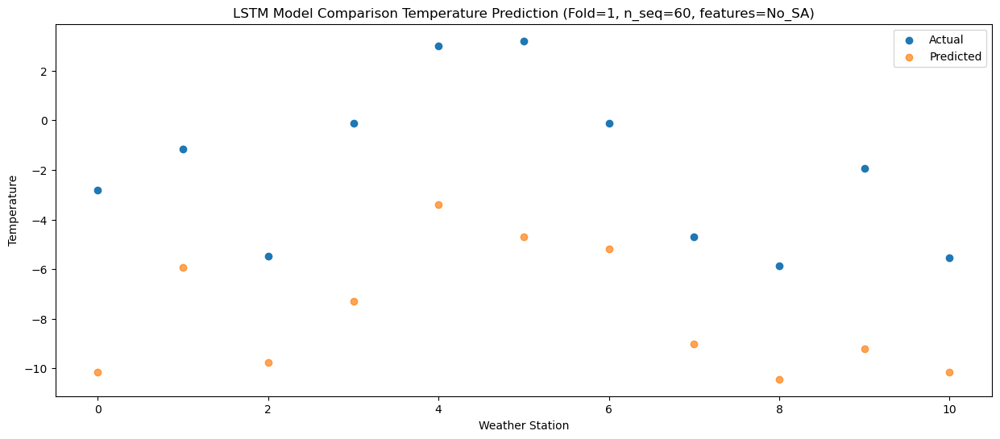

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -1.43  -4.860153
1                 1    3.93  -0.620162
2                 2   -0.13  -4.470162
3                 3    6.18  -2.000162
4                 4    9.38   1.889838
5                 5    9.32   0.599841
6                 6    4.10   0.129843
7                 7    4.30  -3.700155
8                 8    2.10  -5.130162
9                 9    5.76  -3.890162
10               10   -3.58  -4.860155


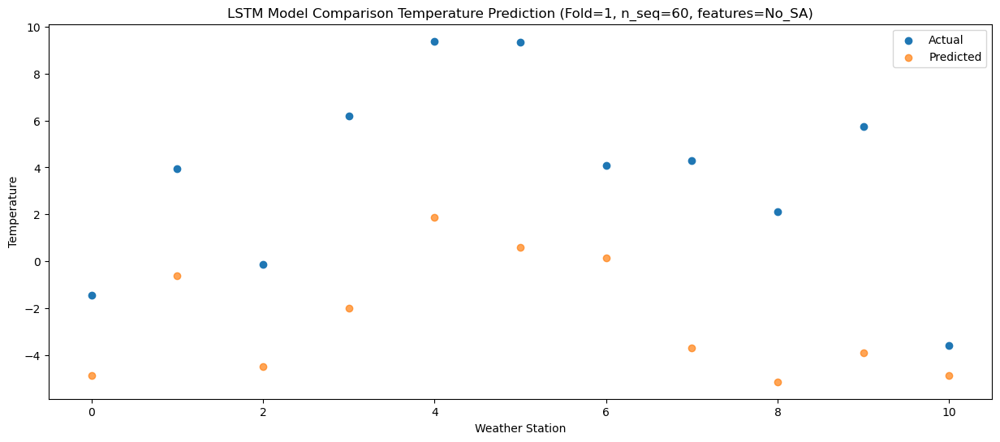

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    3.42  -1.903787
1                 1    7.15   2.336204
2                 2    2.97  -1.513796
3                 3    8.69   0.956204
4                 4   12.12   4.846204
5                 5   11.67   3.556208
6                 6    7.76   3.086209
7                 7    7.02  -0.743789
8                 8    5.34  -2.173796
9                 9    8.59  -0.933796
10               10    0.82  -1.903789


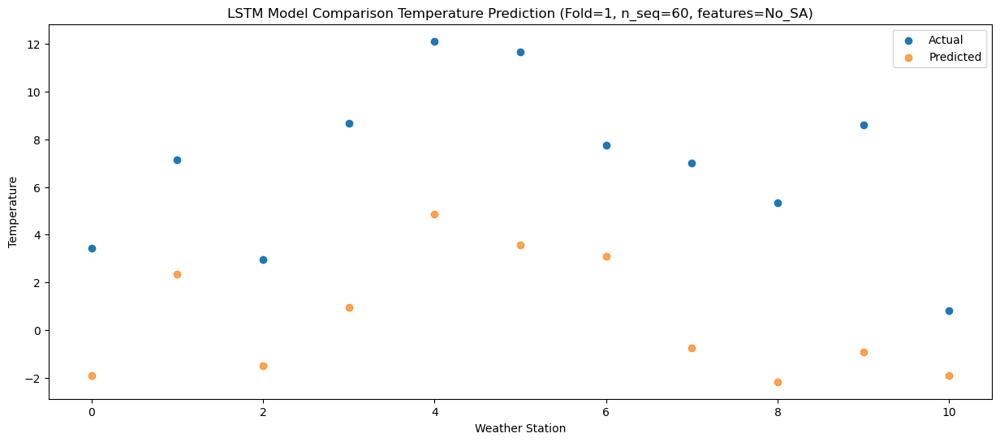

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    5.82   3.053733
1                 1   10.82   7.293722
2                 2    6.31   3.443722
3                 3   12.17   5.913722
4                 4   15.68   9.803722
5                 5   16.47   8.513726
6                 6   11.23   8.043729
7                 7   11.06   4.213731
8                 8   10.02   2.783722
9                 9   13.66   4.023722
10               10    5.21   3.053731


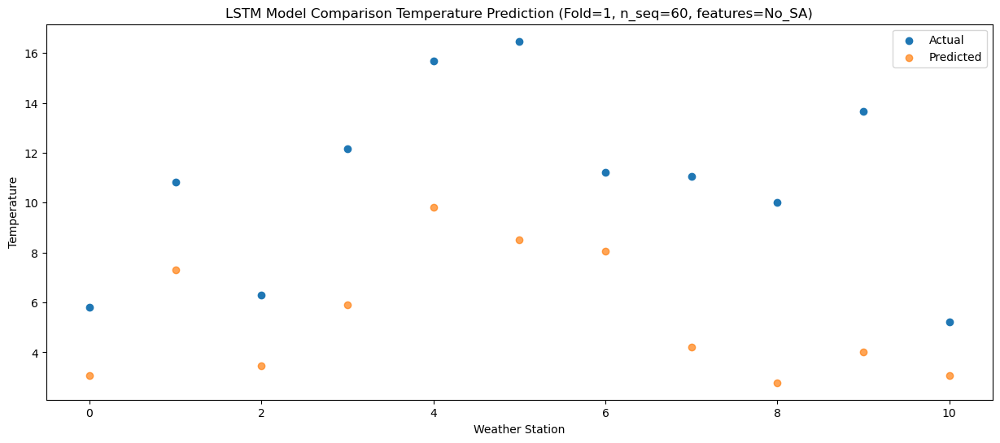

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   10.49   7.900366
1                 1   15.39  12.140355
2                 2   11.92   8.290355
3                 3   15.87  10.760355
4                 4   19.38  14.650355
5                 5   22.09  13.360359
6                 6   15.47  12.890362
7                 7   16.60   9.060364
8                 8   14.78   7.630355
9                 9   17.80   8.870355
10               10   10.80   7.900364


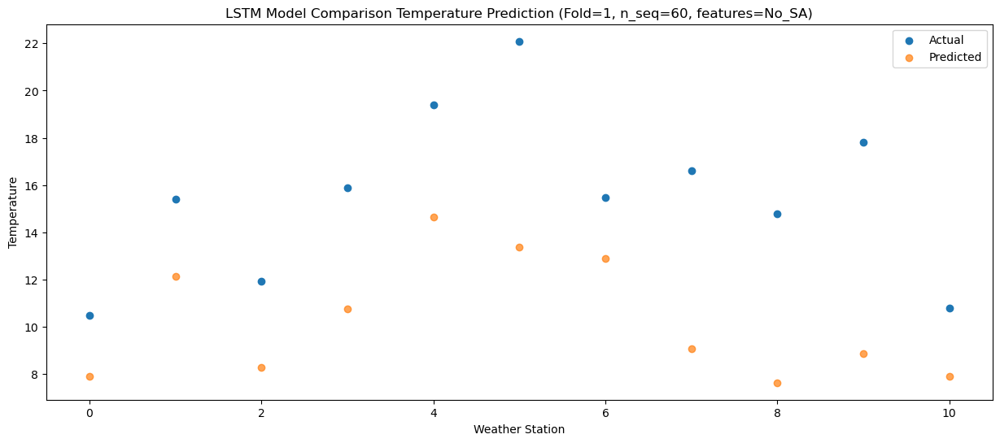

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   13.36  11.922567
1                 1   19.15  16.162556
2                 2   15.03  12.312554
3                 3   18.50  14.782554
4                 4   22.27  18.672556
5                 5   24.95  17.382558
6                 6   19.40  16.912562
7                 7   19.67  13.082565
8                 8   20.48  11.652554
9                 9   24.21  12.892556
10               10   16.91  11.922565


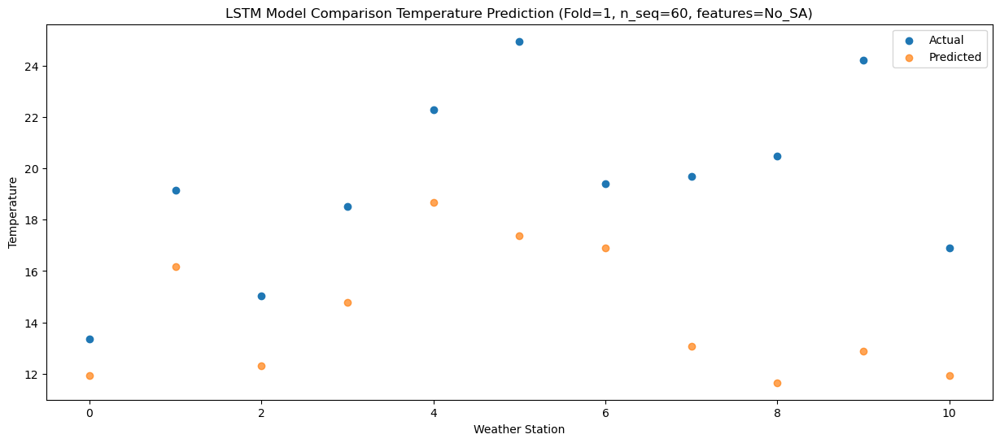

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   14.32  13.276933
1                 1   20.08  17.516922
2                 2   15.05  13.666918
3                 3   17.89  16.136918
4                 4   22.08  20.026920
5                 5   23.95  18.736922
6                 6   20.43  18.266928
7                 7   20.31  14.436930
8                 8   21.33  13.006918
9                 9   24.94  14.246920
10               10   18.84  13.276931


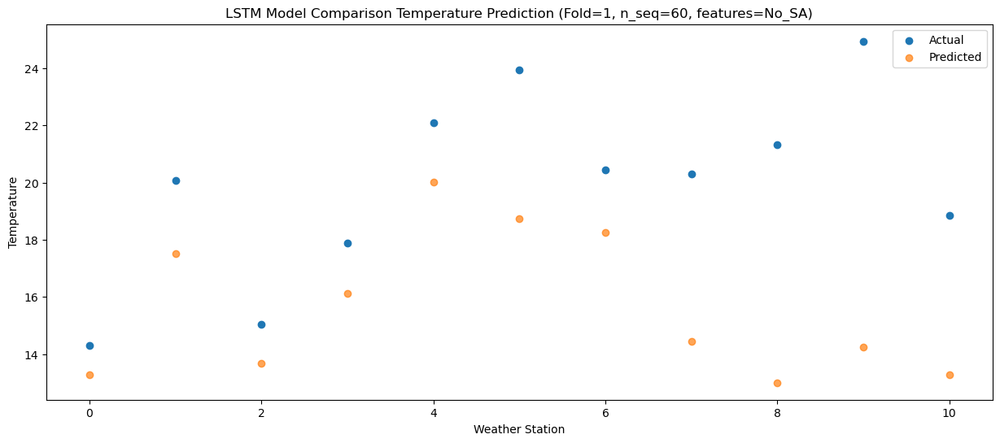

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   12.97  12.236244
1                 1   19.80  16.476233
2                 2   15.36  12.626229
3                 3   19.02  15.096229
4                 4   23.40  18.986231
5                 5   25.55  17.696233
6                 6   20.10  17.226238
7                 7   20.72  13.396240
8                 8   23.44  11.966229
9                 9   25.74  13.206231
10               10   16.69  12.236242


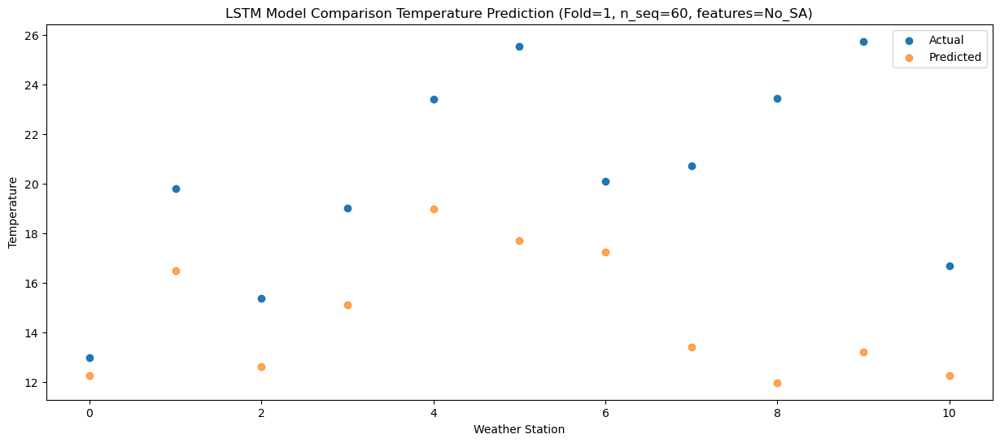

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   10.53   9.836576
1                 1   16.08  14.076564
2                 2   13.05  10.226560
3                 3   16.42  12.696560
4                 4   20.11  16.586562
5                 5   19.84  15.296564
6                 6   16.80  14.826571
7                 7   18.85  10.996573
8                 8   17.47   9.566560
9                 9   21.18  10.806562
10               10   12.96   9.836575


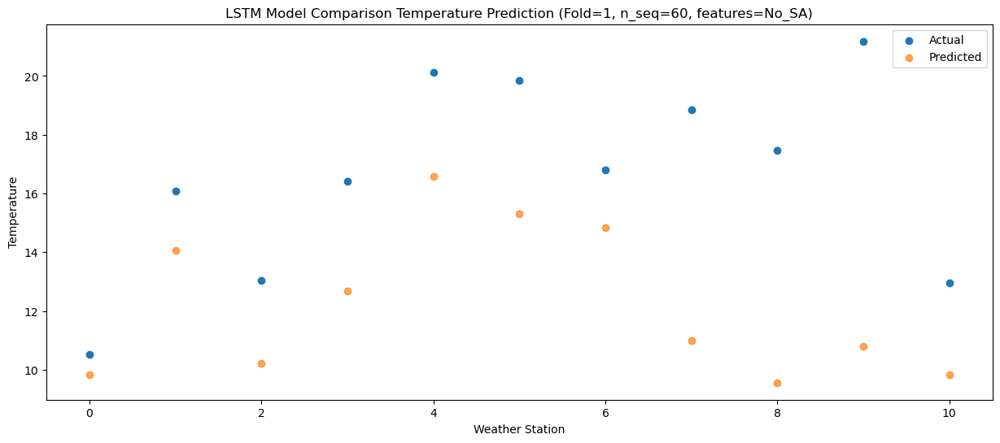

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    5.65   3.640820
1                 1   11.63   7.880808
2                 2    8.05   4.030804
3                 3   13.73   6.500804
4                 4   16.96  10.390806
5                 5   18.69   9.100808
6                 6   12.00   8.630815
7                 7   13.38   4.800817
8                 8   13.61   3.370804
9                 9   16.33   4.610806
10               10    8.09   3.640819


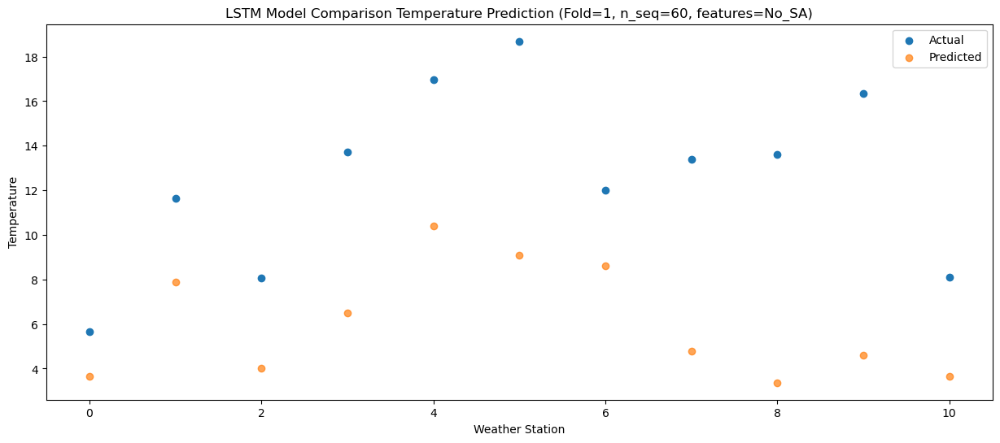

f, t:
[[-1.840e+00  3.520e+00 -1.480e+00  4.050e+00  8.110e+00  7.800e+00
   3.880e+00  9.200e-01  4.400e-01  4.680e+00 -1.560e+00]
 [-1.310e+00  2.610e+00 -1.050e+00  2.630e+00  6.220e+00  5.770e+00
   3.150e+00  3.000e-01 -1.410e+00  3.320e+00 -4.370e+00]
 [-1.420e+00  1.500e+00 -1.580e+00  3.380e+00  7.030e+00  5.110e+00
   2.340e+00 -5.500e-01 -1.230e+00  2.870e+00 -4.030e+00]
 [-1.560e+00  1.590e+00 -1.300e+00  2.850e+00  6.650e+00  4.590e+00
   2.410e+00  1.300e-01 -1.740e+00  1.630e+00 -3.290e+00]
 [ 3.500e+00  7.590e+00  5.800e+00  1.049e+01  1.469e+01  1.194e+01
   8.080e+00  7.050e+00  6.090e+00  9.590e+00  1.030e+00]
 [ 4.990e+00  8.810e+00  4.830e+00  1.037e+01  1.443e+01  1.473e+01
   9.710e+00  8.190e+00  7.470e+00  1.190e+01  2.660e+00]
 [ 8.070e+00  1.216e+01  8.980e+00  1.412e+01  1.823e+01  1.992e+01
   1.249e+01  1.269e+01  1.358e+01  1.843e+01  8.120e+00]
 [ 1.107e+01  1.651e+01  1.321e+01  1.690e+01  2.126e+01  2.264e+01
   1.716e+01  1.825e+01  1.869e+01  2.481e+0

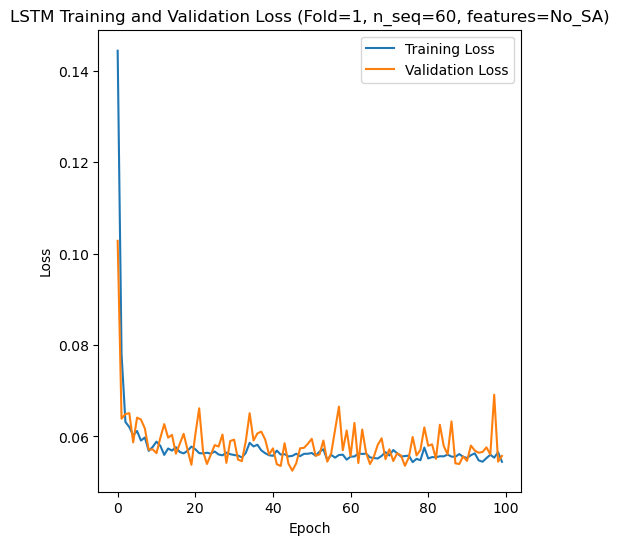

[[ 8.61  4.71 12.22 ... 22.49 18.22 13.52]
 [ 6.28  3.18  8.73 ... 22.36 17.39  7.52]
 [17.82 16.52 20.35 ... 28.79 25.32 22.93]
 ...
 [ 6.77  9.55 12.16 ... 24.55 20.29 10.24]
 [12.04 12.81 10.78 ... 23.32 20.33 13.93]
 [ 8.57  6.56 11.36 ... 21.36 16.14 12.65]]
Epoch 1/100
84/84 [==============================] - 45s 229ms/step - loss: 0.1490 - accuracy: 0.2262 - mae: 0.1219 - rmse: 0.1490 - mape: inf - pearson: 0.5797 - val_loss: 0.0699 - val_accuracy: 0.1000 - val_mae: 0.0570 - val_rmse: 0.0699 - val_mape: 13.1652 - val_pearson: 0.8014
Epoch 2/100
84/84 [==============================] - 13s 159ms/step - loss: 0.0747 - accuracy: 0.4762 - mae: 0.0601 - rmse: 0.0747 - mape: inf - pearson: 0.7993 - val_loss: 0.0544 - val_accuracy: 0.1000 - val_mae: 0.0429 - val_rmse: 0.0544 - val_mape: 9.1601 - val_pearson: 0.8950
Epoch 3/100
84/84 [==============================] - 14s 168ms/step - loss: 0.0675 - accuracy: 0.4405 - mae: 0.0533 - rmse: 0.0675 - mape: inf - pearson: 0.8102 - val_loss: 

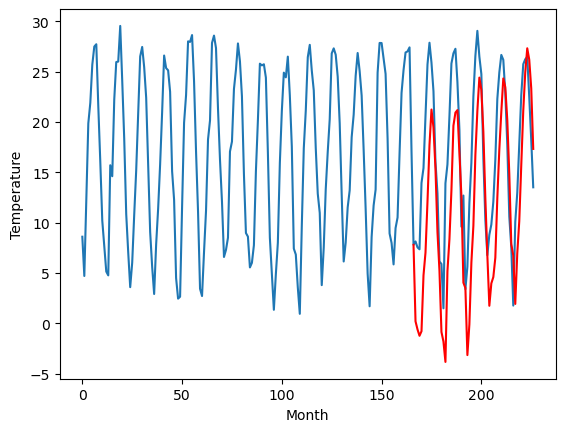

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.41		0.25		-3.16
1.13		-0.56		-1.69
0.89		-1.19		-2.08
0.16		-0.74		-0.90
8.17		4.81		-3.36
10.40		7.07		-3.33
17.20		12.13		-5.07
24.40		17.76		-6.64
24.43		21.29		-3.14
23.10		19.51		-3.59
16.97		15.41		-1.56
9.98		9.13		-0.85
6.86		5.28		-1.58
0.23		-0.81		-1.04
0.15		-1.76		-1.91
-3.89		-3.79		0.10
6.30		5.23		-1.07
10.06		8.41		-1.65
15.24		13.27		-1.97
22.49		19.68		-2.81
23.18		20.98		-2.20
23.94		21.23		-2.71
21.70		16.99		-4.71
13.44		12.70		-0.74
6.73		4.08		-2.65
4.34		3.56		-0.78
-0.35		-3.11		-2.76
-0.36		-0.05		0.31
6.62		6.08		-0.54
13.30		9.73		-3.57
19.10		16.77		-2.33
22.90		21.16		-1.74
26.14		24.46		-1.68
23.83		23.23		-0.60
21.07		19.08		-1.99
12.69		12.46		-0.23
2.70		6.81		4.11
-0.01		1.79		1.80
-0.26		4.01		4.27
1.34		4.64		3.30
5.41		6.56		1.15
11.27		12.50		1.23
16.76		17.29		0.53
19.37		21.04		1.67
23.47		24.37		0.90
23.96		23.51		-0.45
21.09		20.21		-0.88
12.05		1

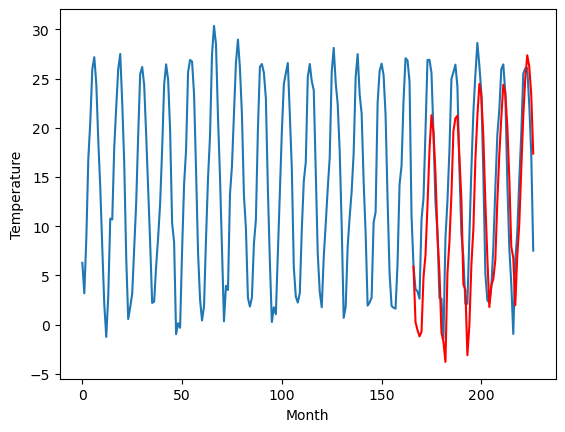

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.10		-2.08		-1.98
-1.22		-2.89		-1.67
-2.37		-3.52		-1.15
-1.33		-3.07		-1.74
2.29		2.48		0.19
3.68		4.74		1.06
4.99		9.80		4.81
7.58		15.43		7.85
8.22		18.96		10.74
7.91		17.18		9.27
6.65		13.08		6.43
5.38		6.80		1.42
1.96		2.95		0.99
-5.03		-3.14		1.89
-4.37		-4.09		0.28
-1.64		-6.12		-4.48
0.17		2.90		2.73
1.98		6.08		4.10
5.56		10.94		5.38
6.78		17.35		10.57
7.57		18.65		11.08
7.62		18.90		11.28
6.34		14.66		8.32
5.20		10.37		5.17
-1.65		1.75		3.40
-0.75		1.23		1.98
-5.01		-5.44		-0.43
-2.68		-2.38		0.30
0.79		3.75		2.96
2.60		7.40		4.80
5.36		14.44		9.08
7.17		18.83		11.66
7.35		22.13		14.78
6.78		20.90		14.12
5.37		16.75		11.38
2.74		10.13		7.39
0.98		4.48		3.50
-3.12		-0.54		2.58
-3.32		1.68		5.00
-0.26		2.31		2.57
0.76		4.23		3.47
3.30		10.17		6.87
4.28		14.96		10.68
6.69		18.71		12.02
8.60		22.04		13.44
8.78		21.18		12.40
6.83		17.88		11.05
3.25		12.57		9.32
-0.73		5.59		6.32
-2.66

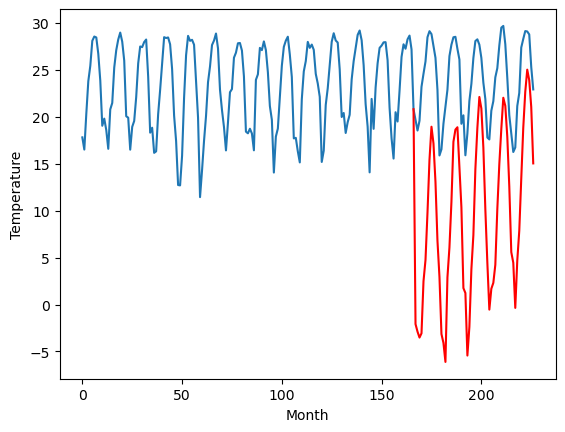

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
9.24		9.46		0.22
6.18		8.65		2.47
6.45		8.02		1.57
6.60		8.47		1.87
10.15		14.02		3.87
11.38		16.28		4.90
17.27		21.34		4.07
23.33		26.97		3.64
27.61		30.50		2.89
25.76		28.72		2.96
21.18		24.62		3.44
15.96		18.34		2.38
12.00		14.49		2.49
5.17		8.40		3.23
2.09		7.45		5.36
2.11		5.42		3.31
6.22		14.44		8.22
10.72		17.62		6.90
15.98		22.48		6.50
21.55		28.89		7.34
23.55		30.19		6.64
24.61		30.44		5.83
21.44		26.20		4.76
17.61		21.91		4.30
9.53		13.29		3.76
7.61		12.77		5.16
1.46		6.10		4.64
3.78		9.16		5.38
7.64		15.29		7.65
12.08		18.94		6.86
17.42		25.98		8.56
21.66		30.37		8.71
26.28		33.67		7.39
26.20		32.44		6.24
21.16		28.29		7.13
15.72		21.67		5.95
11.92		16.02		4.10
5.75		11.00		5.25
7.04		13.22		6.18
5.16		13.85		8.69
7.60		15.77		8.17
13.32		21.71		8.39
16.95		26.50		9.55
20.74		30.25		9.51
26.31		33.58		7.27
24.30		32.72		8.42
21.88		29.42		7.54
16.86		24.11		7.25
8.88		17.13		8.25
8

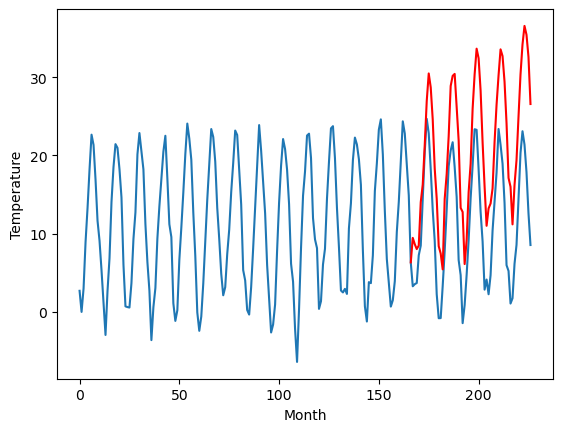

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-6.25		-5.68		0.57
-5.90		-6.49		-0.59
-5.56		-7.12		-1.56
-4.92		-6.67		-1.75
1.77		-1.12		-2.89
1.24		1.14		-0.10
4.21		6.20		1.99
7.25		11.83		4.58
7.99		15.36		7.37
8.36		13.58		5.22
6.01		9.48		3.47
2.32		3.20		0.88
-1.80		-0.65		1.15
-8.10		-6.74		1.36
-7.75		-7.69		0.06
-8.49		-9.72		-1.23
-1.16		-0.70		0.46
-0.29		2.48		2.77
4.18		7.34		3.16
7.66		13.75		6.09
8.25		15.05		6.80
8.42		15.30		6.88
5.88		11.06		5.18
3.14		6.77		3.63
-5.13		-1.85		3.28
-1.72		-2.37		-0.65
-9.45		-9.04		0.41
-6.31		-5.98		0.33
-2.55		0.15		2.70
1.25		3.80		2.55
6.41		10.84		4.43
9.00		15.23		6.23
8.83		18.53		9.70
8.01		17.30		9.29
6.04		13.15		7.11
-0.15		6.53		6.68
-3.22		0.88		4.10
-5.73		-4.14		1.59
-4.56		-1.92		2.64
-2.43		-1.29		1.14
-0.60		0.63		1.23
1.32		6.57		5.25
5.35		11.36		6.01
9.00		15.11		6.11
10.44		18.44		8.00
11.74		17.58		5.84
7.31		14.28		6.97
1.15		8.97		7.82
-3.96		1.99		5.95
-6.56		

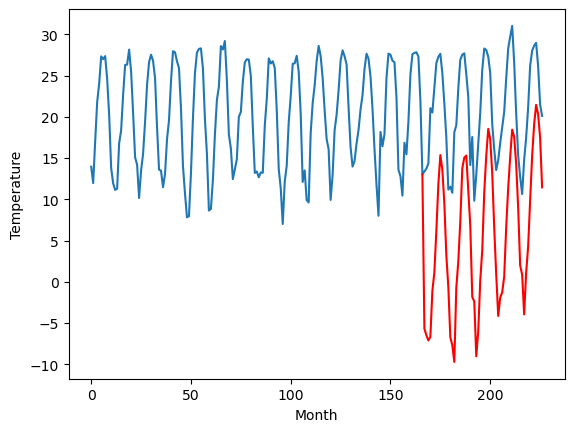

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
7.27		5.58		-1.69
5.84		4.77		-1.07
6.21		4.14		-2.07
5.45		4.59		-0.86
13.54		10.14		-3.40
13.51		12.40		-1.11
17.35		17.46		0.11
20.96		23.09		2.13
22.66		26.62		3.96
22.96		24.84		1.88
18.56		20.74		2.18
14.09		14.46		0.37
11.41		10.61		-0.80
5.30		4.52		-0.78
4.71		3.57		-1.14
2.36		1.54		-0.82
10.74		10.56		-0.18
12.86		13.74		0.88
16.90		18.60		1.70
21.45		25.01		3.56
21.53		26.31		4.78
22.64		26.56		3.92
19.90		22.32		2.42
16.60		18.03		1.43
8.96		9.41		0.45
12.20		8.89		-3.31
3.77		2.22		-1.55
3.39		5.28		1.89
9.51		11.41		1.90
15.66		15.06		-0.60
20.26		22.10		1.84
23.98		26.49		2.51
25.34		29.79		4.45
22.62		28.56		5.94
19.96		24.41		4.45
14.39		17.79		3.40
8.51		12.14		3.63
6.28		7.12		0.84
7.04		9.34		2.30
8.23		9.97		1.74
12.03		11.89		-0.14
12.95		17.83		4.88
18.03		22.62		4.59
22.95		26.37		3.42
25.11		29.70		4.59
26.81		28.84		2.03
22.33		25.54		3.21
14.44		20.23		5.79
8.16		1

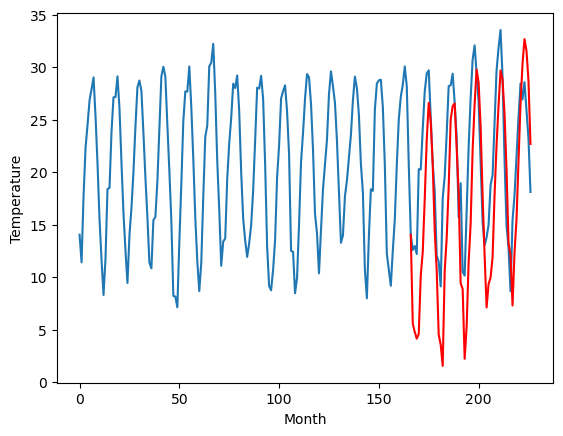

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
6.65		5.69		-0.96
4.84		4.88		0.04
5.19		4.25		-0.94
4.63		4.70		0.07
12.28		10.25		-2.03
12.59		12.51		-0.08
17.49		17.57		0.08
22.23		23.20		0.97
23.41		26.73		3.32
23.64		24.95		1.31
17.70		20.85		3.15
12.22		14.57		2.35
9.73		10.72		0.99
3.27		4.63		1.36
2.57		3.68		1.11
-0.54		1.65		2.19
9.83		10.67		0.84
11.53		13.85		2.32
15.61		18.71		3.10
21.17		25.12		3.95
22.06		26.42		4.36
22.62		26.67		4.05
20.35		22.43		2.08
15.84		18.14		2.30
7.87		9.52		1.65
10.16		9.00		-1.16
1.68		2.33		0.65
1.51		5.39		3.88
8.09		11.52		3.43
14.36		15.17		0.81
19.38		22.21		2.83
24.09		26.60		2.51
26.88		29.90		3.02
24.07		28.67		4.60
20.24		24.52		4.28
13.86		17.90		4.04
7.19		12.25		5.06
4.57		7.23		2.66
5.45		9.45		4.00
5.64		10.08		4.44
10.29		12.00		1.71
12.11		17.94		5.83
17.85		22.73		4.88
22.00		26.48		4.48
24.56		29.81		5.25
26.90		28.95		2.05
22.12		25.65		3.53
13.40		20.34		6.94
8.06		13.36		5.30

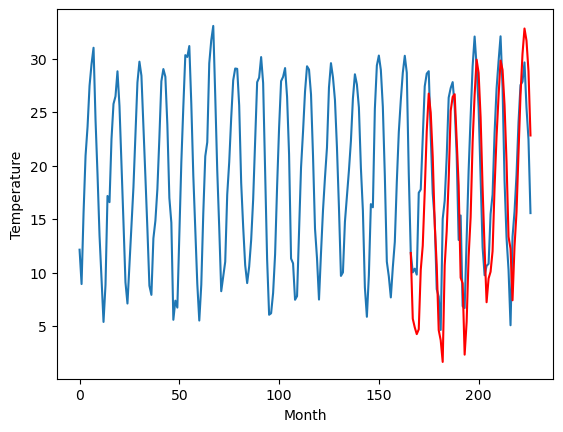

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
6.03		3.78		-2.25
1.50		2.97		1.47
2.75		2.34		-0.41
3.56		2.79		-0.77
8.06		8.34		0.28
13.04		10.60		-2.44
19.33		15.66		-3.67
22.85		21.29		-1.56
24.95		24.82		-0.13
25.39		23.04		-2.35
19.14		18.94		-0.20
13.54		12.66		-0.88
7.98		8.81		0.83
0.33		2.72		2.39
0.87		1.77		0.90
3.79		-0.26		-4.05
6.89		8.76		1.87
13.55		11.94		-1.61
18.56		16.80		-1.76
23.55		23.21		-0.34
22.35		24.51		2.16
21.83		24.76		2.93
19.65		20.52		0.87
13.09		16.23		3.14
7.69		7.61		-0.08
4.34		7.09		2.75
1.34		0.42		-0.92
2.31		3.48		1.17
7.37		9.61		2.24
14.56		13.26		-1.30
19.26		20.30		1.04
23.12		24.69		1.57
24.26		27.99		3.73
21.24		26.76		5.52
19.51		22.61		3.10
11.30		15.99		4.69
4.41		10.34		5.93
2.24		5.32		3.08
1.53		7.54		6.01
2.74		8.17		5.43
7.44		10.09		2.65
13.08		16.03		2.95
17.73		20.82		3.09
22.39		24.57		2.18
27.14		27.90		0.76
24.14		27.04		2.90
21.48		23.74		2.26
14.74		18.43		3.69
7.63		11.45		

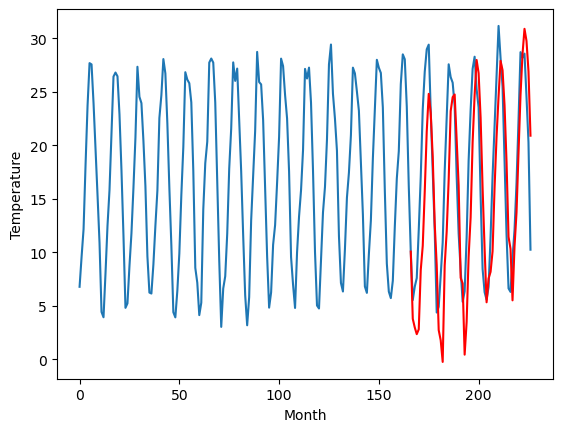

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.17		-1.59		-3.76
-1.37		-2.40		-1.03
-0.83		-3.03		-2.20
1.28		-2.58		-3.86
1.35		2.97		1.62
4.56		5.23		0.67
8.61		10.29		1.68
9.90		15.92		6.02
12.31		19.45		7.14
14.71		17.67		2.96
13.11		13.57		0.46
9.87		7.29		-2.58
3.15		3.44		0.29
1.10		-2.65		-3.75
1.04		-3.60		-4.64
0.12		-5.63		-5.75
-0.28		3.39		3.67
3.58		6.57		2.99
5.80		11.43		5.63
10.04		17.84		7.80
13.02		19.14		6.12
12.62		19.39		6.77
10.84		15.15		4.31
5.86		10.86		5.00
4.60		2.24		-2.36
-1.91		1.72		3.63
0.50		-4.95		-5.45
1.37		-1.89		-3.26
3.16		4.24		1.08
5.28		7.89		2.61
6.24		14.93		8.69
11.16		19.32		8.16
11.97		22.62		10.65
14.01		21.39		7.38
13.60		17.24		3.64
7.33		10.62		3.29
1.10		4.97		3.87
-1.60		-0.05		1.55
-1.94		2.17		4.11
-2.26		2.80		5.06
-1.25		4.72		5.97
2.59		10.66		8.07
3.80		15.45		11.65
5.76		19.20		13.44
12.68		22.53		9.85
12.31		21.67		9.36
8.81		18.37		9.56
7.22		13.06		5.84
2.83		6.08		3.25
0.5

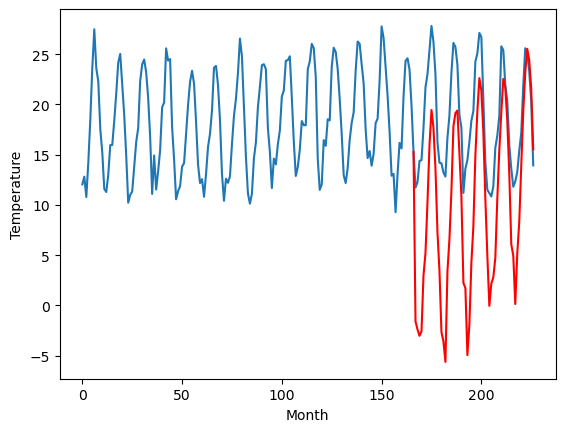

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.04		3.68		1.64
1.63		2.87		1.24
1.34		2.24		0.90
2.38		2.69		0.31
7.61		8.24		0.63
8.91		10.50		1.59
11.51		15.56		4.05
16.80		21.19		4.39
19.79		24.72		4.93
18.79		22.94		4.15
14.76		18.84		4.08
10.84		12.56		1.72
6.23		8.71		2.48
-0.77		2.62		3.39
-1.18		1.67		2.85
-0.68		-0.36		0.32
6.20		8.66		2.46
8.99		11.84		2.85
13.01		16.70		3.69
17.30		23.11		5.81
18.87		24.41		5.54
18.96		24.66		5.70
14.85		20.42		5.57
11.57		16.13		4.56
2.66		7.51		4.85
4.58		6.99		2.41
-1.90		0.32		2.22
2.12		3.38		1.26
6.23		9.51		3.28
9.52		13.16		3.64
14.37		20.20		5.83
18.13		24.59		6.46
19.57		27.89		8.32
18.19		26.66		8.47
14.88		22.51		7.63
7.57		15.89		8.32
5.45		10.24		4.79
-1.08		5.22		6.30
2.12		7.44		5.32
5.14		8.07		2.93
5.59		9.99		4.40
9.11		15.93		6.82
11.89		20.72		8.83
15.55		24.47		8.92
19.14		27.80		8.66
18.59		26.94		8.35
14.63		23.64		9.01
9.34		18.33		8.99
3.44		11.35		7.91
0.97		10.21		

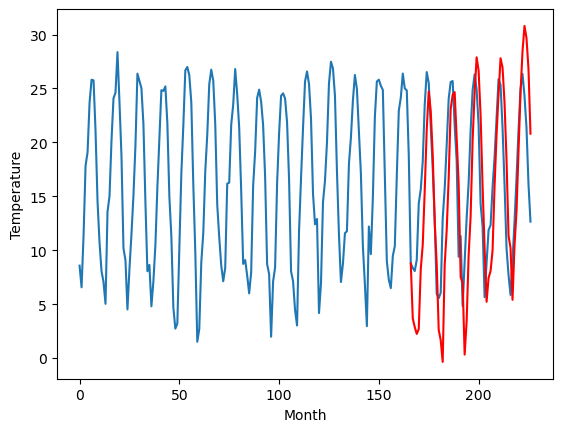

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.92		0.21		2.13
-1.32		-0.60		0.72
-1.76		-1.23		0.53
-1.96		-0.78		1.18
4.08		4.77		0.69
4.51		7.03		2.52
8.55		12.09		3.54
13.92		17.72		3.80
17.21		21.25		4.04
15.95		19.47		3.52
12.00		15.37		3.37
7.34		9.09		1.75
2.29		5.24		2.95
-4.77		-0.85		3.92
-4.44		-1.80		2.64
-3.09		-3.83		-0.74
3.12		5.19		2.07
5.09		8.37		3.28
10.00		13.23		3.23
15.41		19.64		4.23
16.72		20.94		4.22
16.80		21.19		4.39
12.31		16.95		4.64
8.55		12.66		4.11
-1.67		4.04		5.71
0.43		3.52		3.09
-6.44		-3.15		3.29
-1.85		-0.09		1.76
2.70		6.04		3.34
5.86		9.69		3.83
12.10		16.73		4.63
15.75		21.12		5.37
17.10		24.42		7.32
15.85		23.19		7.34
11.70		19.04		7.34
4.42		12.42		8.00
1.97		6.77		4.80
-3.49		1.75		5.24
-1.57		3.97		5.54
1.22		4.60		3.38
1.75		6.52		4.77
6.64		12.46		5.82
9.99		17.25		7.26
12.90		21.00		8.10
16.45		24.33		7.88
15.74		23.47		7.73
12.96		20.17		7.21
6.91		14.86		7.95
0.70		7.88		7.18
-2.15		6

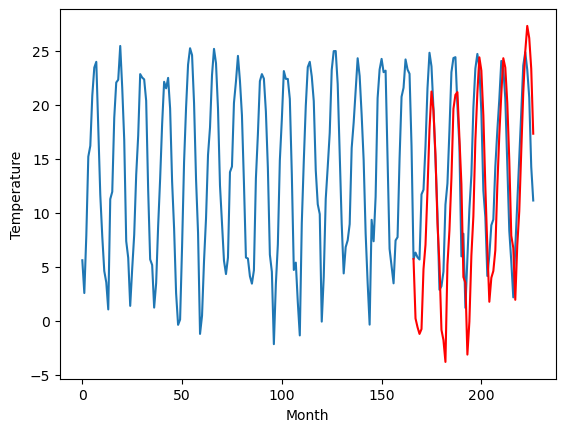

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -0.65   0.205733
1                 1    3.41   0.245733
2                 2   -0.10  -2.084267
3                 3    9.24   9.455733
4                 4   -6.25  -5.684267
5                 5    7.27   5.575733
6                 6    6.65   5.685733
7                 7    6.03   3.775733
8                 8    2.17  -1.594267
9                 9    2.04   3.675733
10               10   -1.92   0.205733


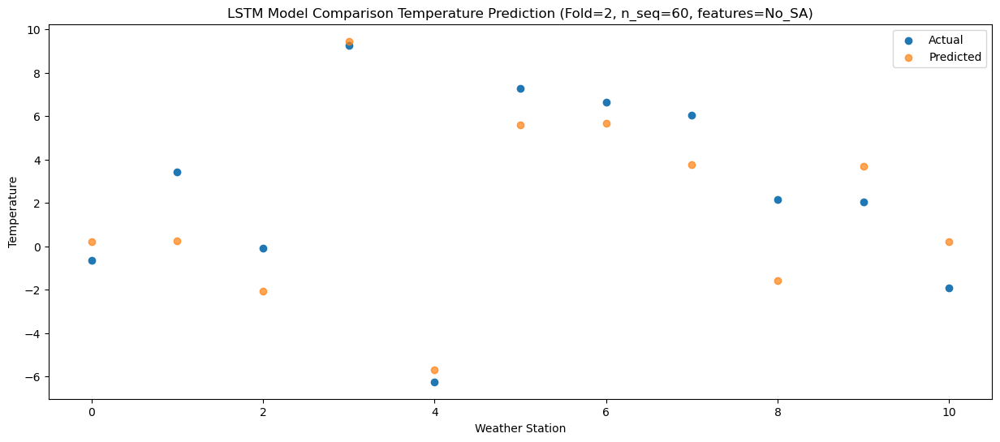

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -0.31  -0.601027
1                 1    1.13  -0.561027
2                 2   -1.22  -2.891027
3                 3    6.18   8.648973
4                 4   -5.90  -6.491027
5                 5    5.84   4.768973
6                 6    4.84   4.878973
7                 7    1.50   2.968973
8                 8   -1.37  -2.401027
9                 9    1.63   2.868973
10               10   -1.32  -0.601027


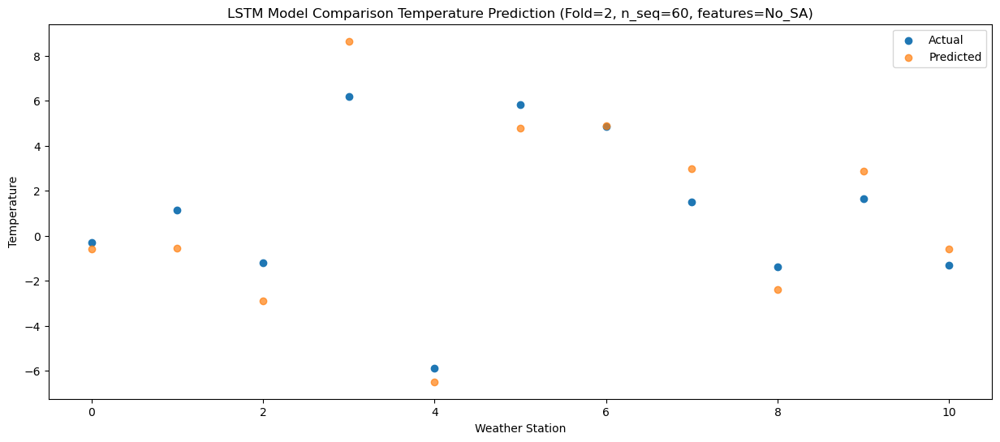

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -0.90  -1.230433
1                 1    0.89  -1.190433
2                 2   -2.37  -3.520433
3                 3    6.45   8.019567
4                 4   -5.56  -7.120433
5                 5    6.21   4.139568
6                 6    5.19   4.249567
7                 7    2.75   2.339567
8                 8   -0.83  -3.030433
9                 9    1.34   2.239567
10               10   -1.76  -1.230433


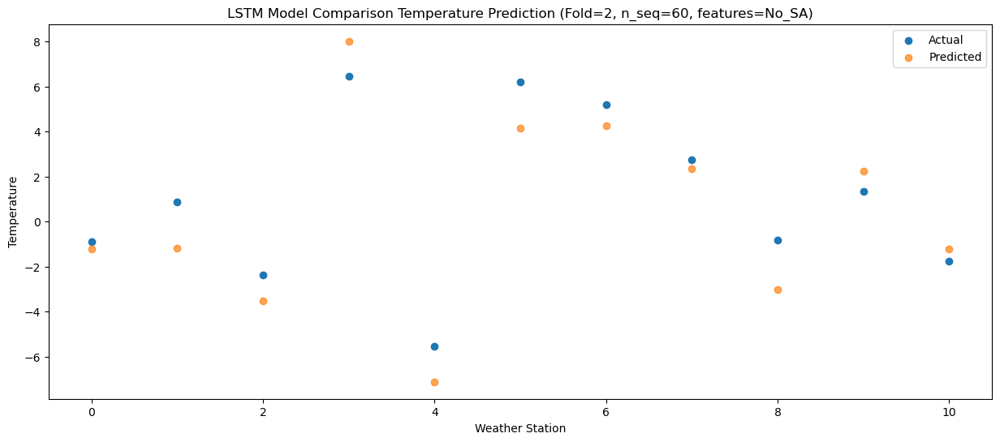

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -1.09  -0.778832
1                 1    0.16  -0.738832
2                 2   -1.33  -3.068832
3                 3    6.60   8.471168
4                 4   -4.92  -6.668832
5                 5    5.45   4.591169
6                 6    4.63   4.701168
7                 7    3.56   2.791168
8                 8    1.28  -2.578832
9                 9    2.38   2.691168
10               10   -1.96  -0.778832


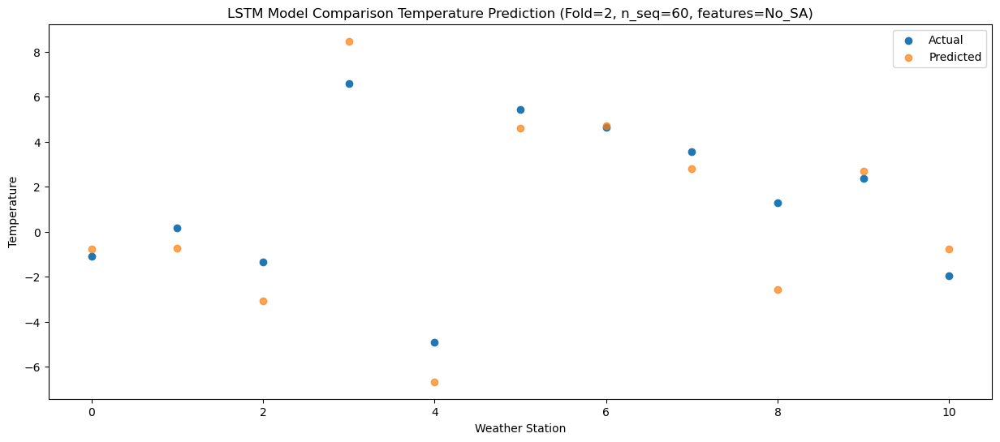

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    5.50   4.771473
1                 1    8.17   4.811473
2                 2    2.29   2.481473
3                 3   10.15  14.021473
4                 4    1.77  -1.118527
5                 5   13.54  10.141474
6                 6   12.28  10.251475
7                 7    8.06   8.341473
8                 8    1.35   2.971475
9                 9    7.61   8.241473
10               10    4.08   4.771473


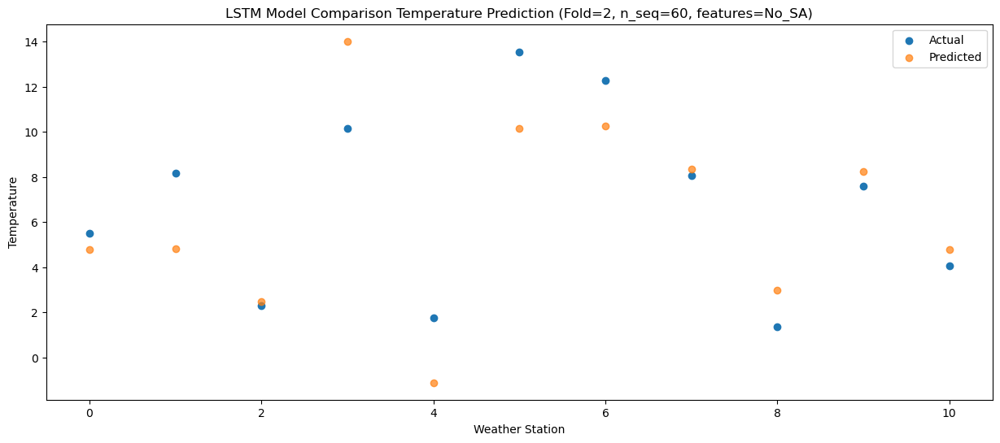

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    6.98   7.032252
1                 1   10.40   7.072252
2                 2    3.68   4.742252
3                 3   11.38  16.282252
4                 4    1.24   1.142252
5                 5   13.51  12.402253
6                 6   12.59  12.512254
7                 7   13.04  10.602252
8                 8    4.56   5.232254
9                 9    8.91  10.502252
10               10    4.51   7.032252


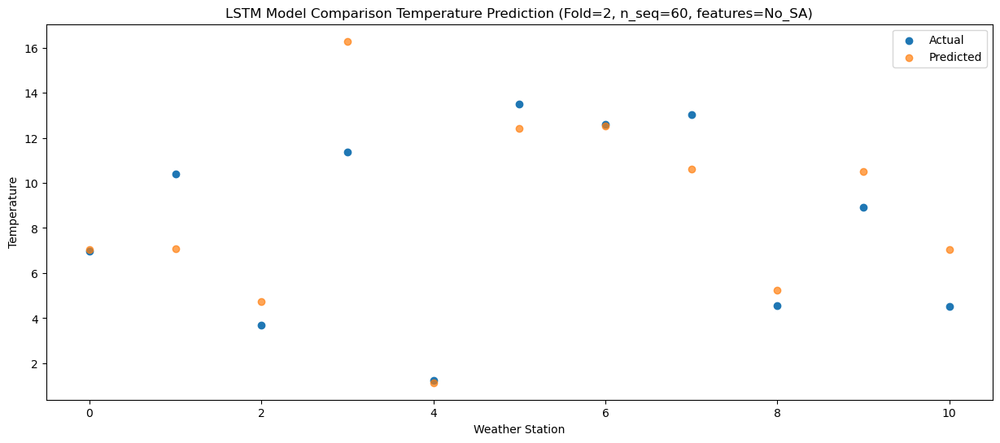

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   12.27  12.089136
1                 1   17.20  12.129136
2                 2    4.99   9.799136
3                 3   17.27  21.339136
4                 4    4.21   6.199136
5                 5   17.35  17.459137
6                 6   17.49  17.569138
7                 7   19.33  15.659136
8                 8    8.61  10.289138
9                 9   11.51  15.559136
10               10    8.55  12.089136


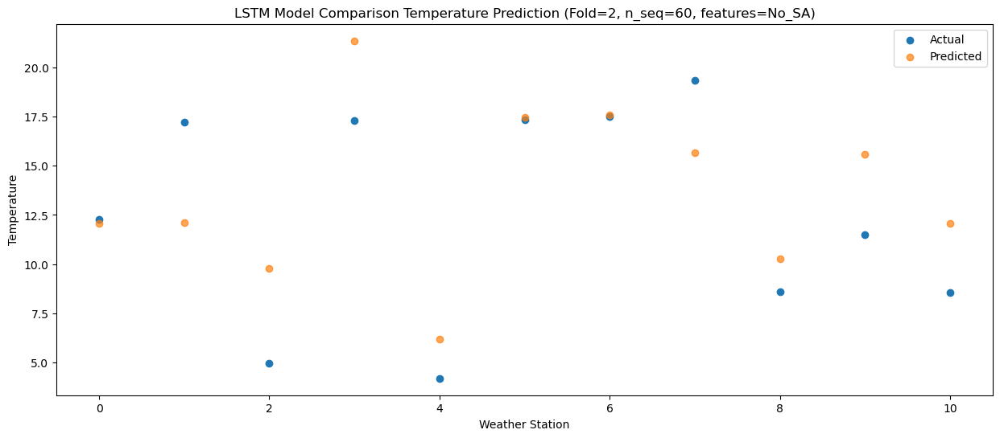

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   17.27  17.718374
1                 1   24.40  17.758374
2                 2    7.58  15.428374
3                 3   23.33  26.968374
4                 4    7.25  11.828374
5                 5   20.96  23.088375
6                 6   22.23  23.198375
7                 7   22.85  21.288374
8                 8    9.90  15.918375
9                 9   16.80  21.188374
10               10   13.92  17.718374


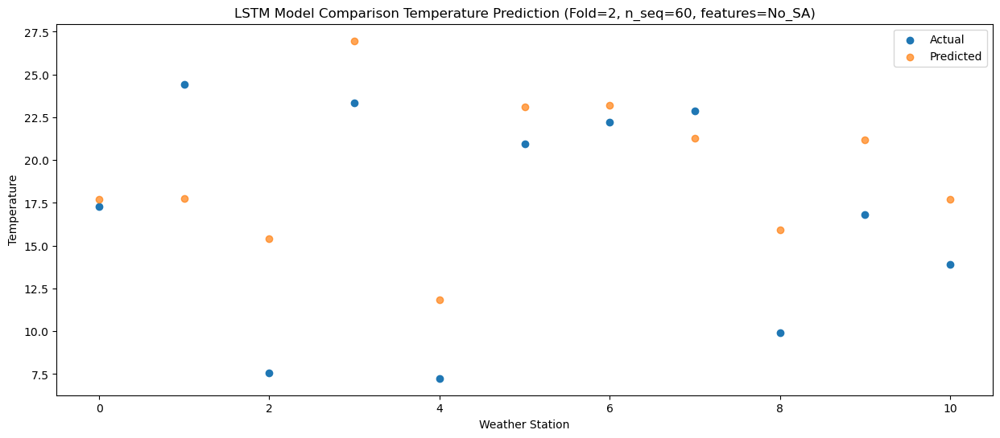

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   19.43  21.245379
1                 1   24.43  21.285379
2                 2    8.22  18.955379
3                 3   27.61  30.495379
4                 4    7.99  15.355379
5                 5   22.66  26.615380
6                 6   23.41  26.725381
7                 7   24.95  24.815379
8                 8   12.31  19.445381
9                 9   19.79  24.715379
10               10   17.21  21.245379


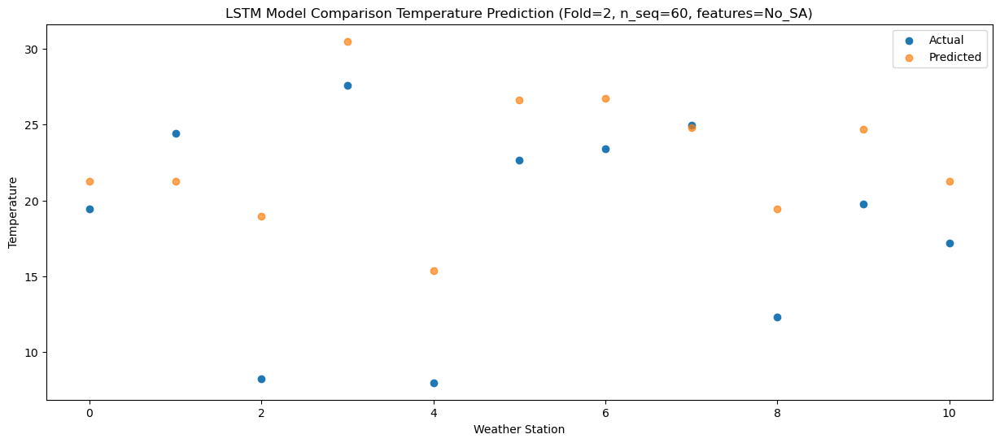

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   17.45  19.467379
1                 1   23.10  19.507379
2                 2    7.91  17.177379
3                 3   25.76  28.717379
4                 4    8.36  13.577379
5                 5   22.96  24.837380
6                 6   23.64  24.947381
7                 7   25.39  23.037379
8                 8   14.71  17.667381
9                 9   18.79  22.937379
10               10   15.95  19.467379


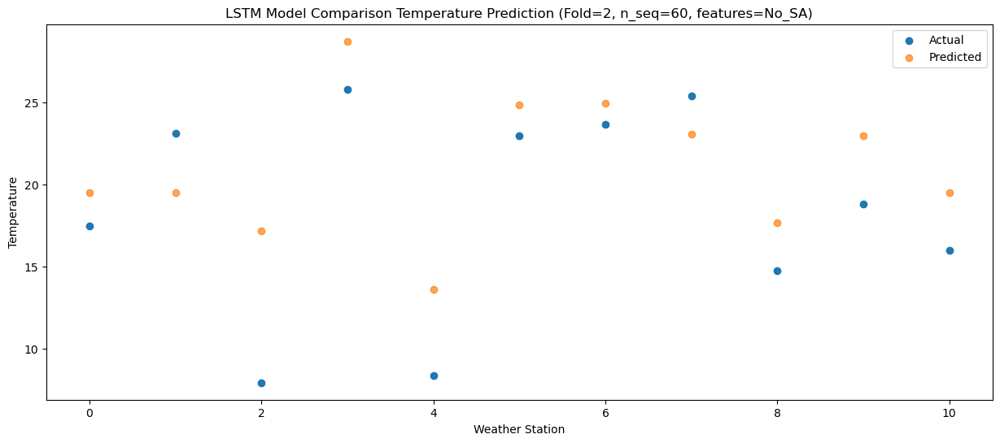

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   14.61  15.369383
1                 1   16.97  15.409383
2                 2    6.65  13.079383
3                 3   21.18  24.619383
4                 4    6.01   9.479383
5                 5   18.56  20.739384
6                 6   17.70  20.849385
7                 7   19.14  18.939383
8                 8   13.11  13.569385
9                 9   14.76  18.839383
10               10   12.00  15.369383


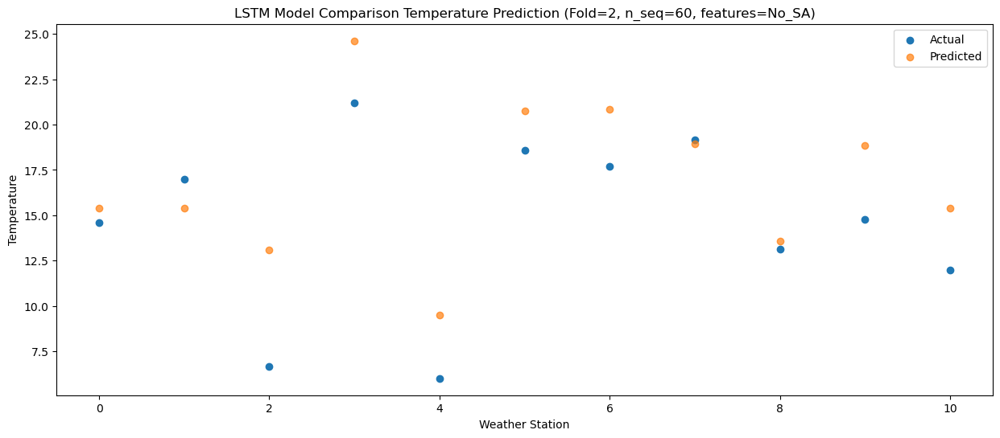

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    7.60   9.085482
1                 1    9.98   9.125482
2                 2    5.38   6.795482
3                 3   15.96  18.335482
4                 4    2.32   3.195482
5                 5   14.09  14.455483
6                 6   12.22  14.565484
7                 7   13.54  12.655482
8                 8    9.87   7.285484
9                 9   10.84  12.555482
10               10    7.34   9.085482


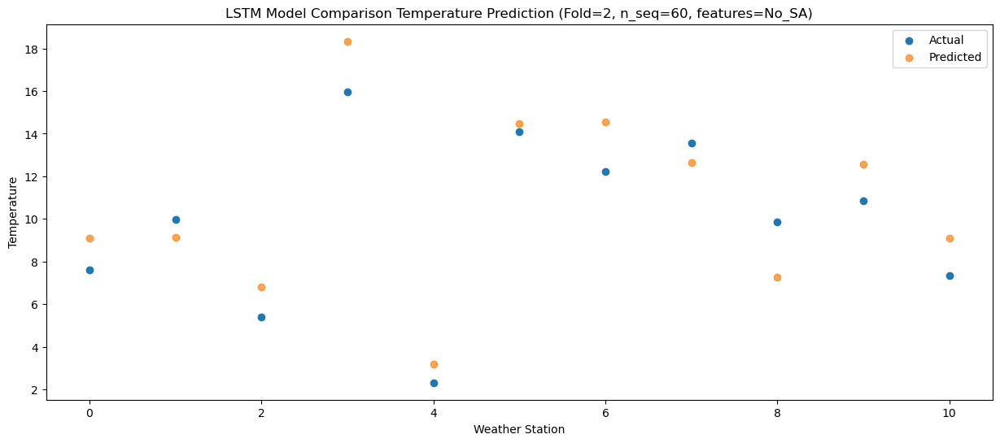

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    4.47   5.235966
1                 1    6.86   5.275966
2                 2    1.96   2.945966
3                 3   12.00  14.485966
4                 4   -1.80  -0.654034
5                 5   11.41  10.605966
6                 6    9.73  10.715966
7                 7    7.98   8.805965
8                 8    3.15   3.435966
9                 9    6.23   8.705966
10               10    2.29   5.235966


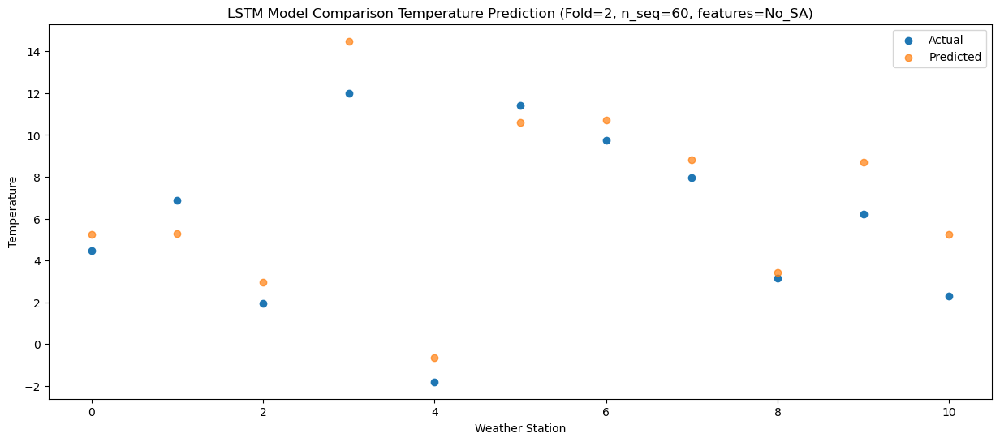

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -2.29  -0.853375
1                 1    0.23  -0.813375
2                 2   -5.03  -3.143375
3                 3    5.17   8.396625
4                 4   -8.10  -6.743375
5                 5    5.30   4.516625
6                 6    3.27   4.626626
7                 7    0.33   2.716624
8                 8    1.10  -2.653374
9                 9   -0.77   2.616625
10               10   -4.77  -0.853375


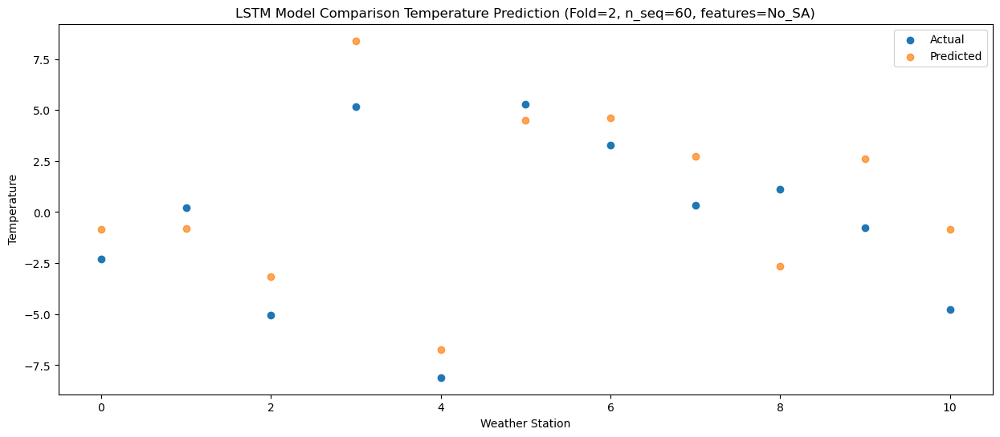

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -2.55  -1.802811
1                 1    0.15  -1.762812
2                 2   -4.37  -4.092811
3                 3    2.09   7.447189
4                 4   -7.75  -7.692811
5                 5    4.71   3.567188
6                 6    2.57   3.677189
7                 7    0.87   1.767187
8                 8    1.04  -3.602811
9                 9   -1.18   1.667188
10               10   -4.44  -1.802811


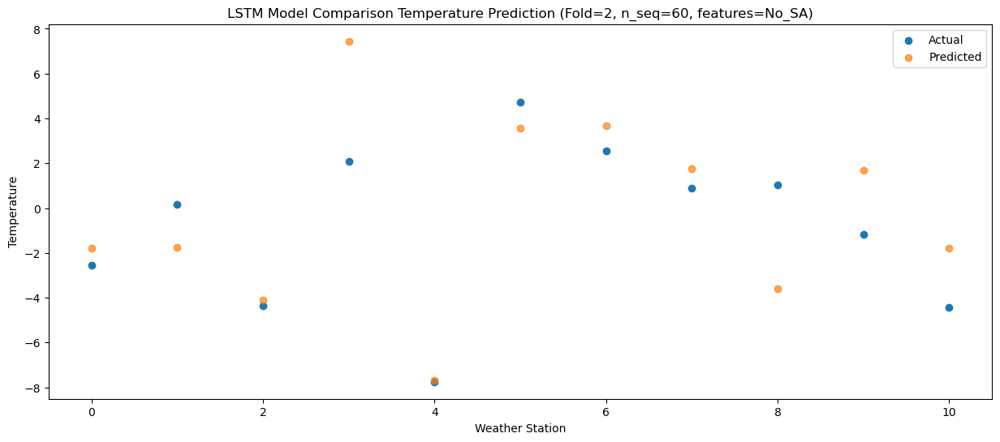

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -6.95  -3.827049
1                 1   -3.89  -3.787049
2                 2   -1.64  -6.117049
3                 3    2.11   5.422951
4                 4   -8.49  -9.717049
5                 5    2.36   1.542950
6                 6   -0.54   1.652951
7                 7    3.79  -0.257050
8                 8    0.12  -5.627049
9                 9   -0.68  -0.357050
10               10   -3.09  -3.827049


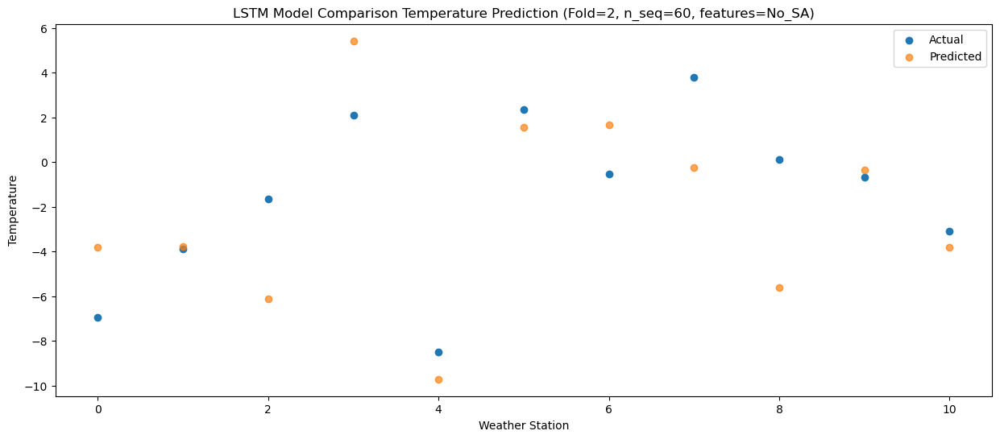

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    5.47   5.192547
1                 1    6.30   5.232547
2                 2    0.17   2.902546
3                 3    6.22  14.442547
4                 4   -1.16  -0.697454
5                 5   10.74  10.562546
6                 6    9.83  10.672547
7                 7    6.89   8.762545
8                 8   -0.28   3.392547
9                 9    6.20   8.662546
10               10    3.12   5.192547


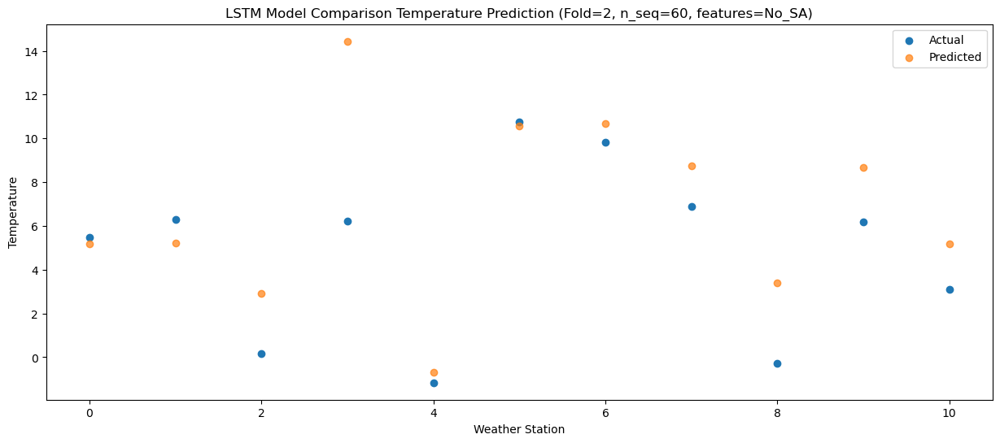

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    7.34   8.372340
1                 1   10.06   8.412340
2                 2    1.98   6.082339
3                 3   10.72  17.622340
4                 4   -0.29   2.482339
5                 5   12.86  13.742339
6                 6   11.53  13.852340
7                 7   13.55  11.942338
8                 8    3.58   6.572340
9                 9    8.99  11.842339
10               10    5.09   8.372340


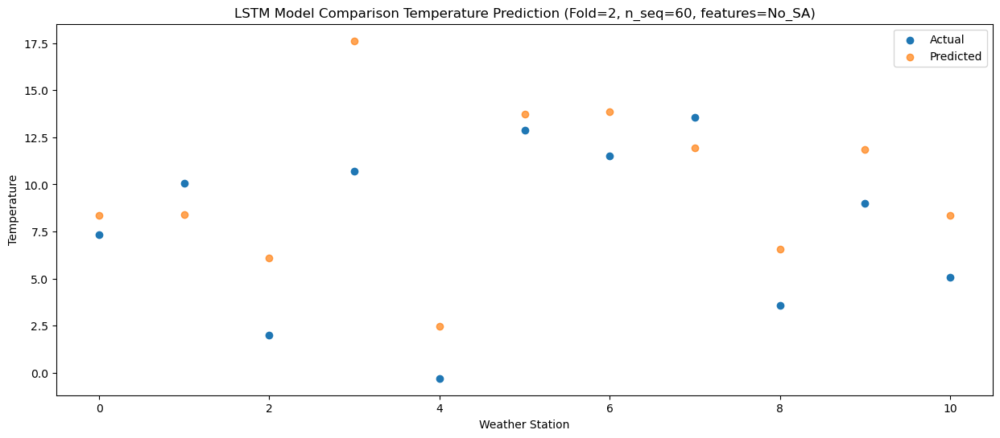

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   12.12  13.225243
1                 1   15.24  13.265243
2                 2    5.56  10.935242
3                 3   15.98  22.475243
4                 4    4.18   7.335242
5                 5   16.90  18.595242
6                 6   15.61  18.705243
7                 7   18.56  16.795241
8                 8    5.80  11.425243
9                 9   13.01  16.695242
10               10   10.00  13.225243


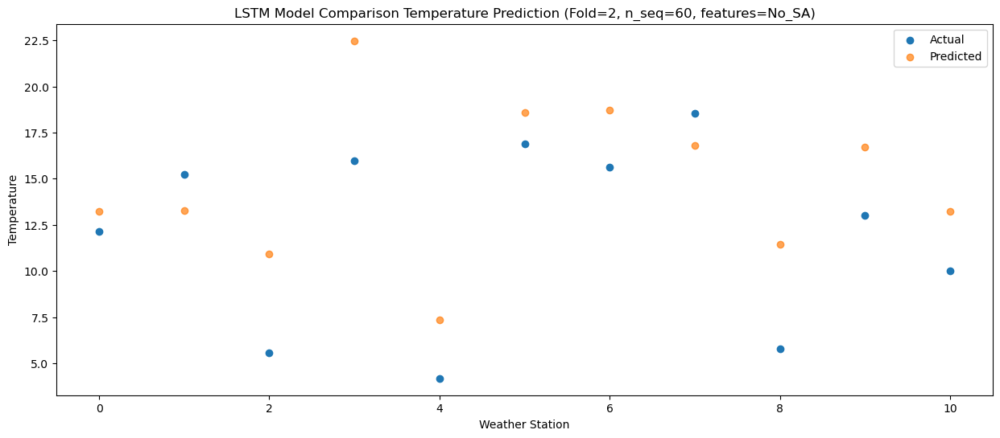

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   17.37  19.640729
1                 1   22.49  19.680729
2                 2    6.78  17.350728
3                 3   21.55  28.890729
4                 4    7.66  13.750728
5                 5   21.45  25.010728
6                 6   21.17  25.120729
7                 7   23.55  23.210727
8                 8   10.04  17.840729
9                 9   17.30  23.110728
10               10   15.41  19.640729


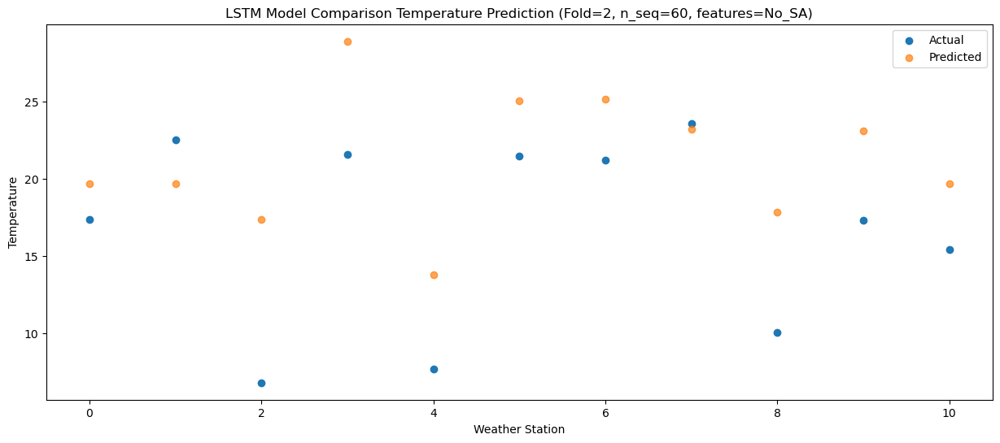

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   18.38  20.938830
1                 1   23.18  20.978830
2                 2    7.57  18.648829
3                 3   23.55  30.188830
4                 4    8.25  15.048829
5                 5   21.53  26.308829
6                 6   22.06  26.418830
7                 7   22.35  24.508828
8                 8   13.02  19.138830
9                 9   18.87  24.408829
10               10   16.72  20.938830


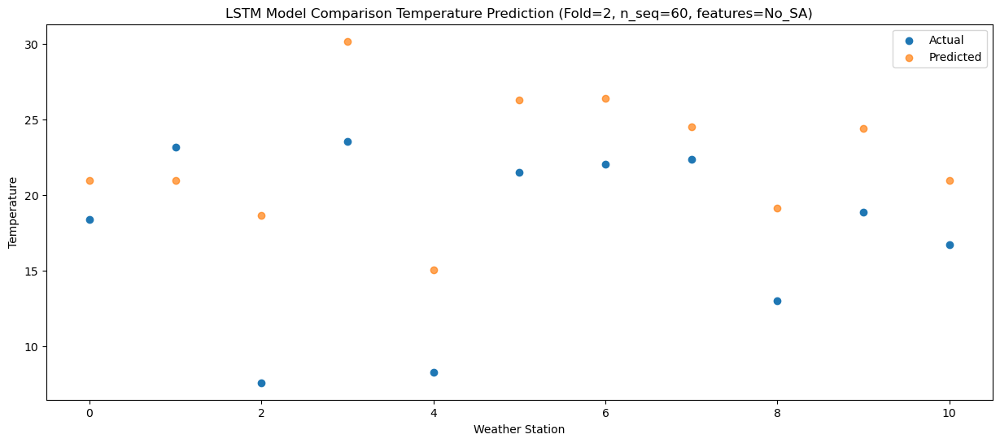

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   18.83  21.188271
1                 1   23.94  21.228273
2                 2    7.62  18.898270
3                 3   24.61  30.438271
4                 4    8.42  15.298270
5                 5   22.64  26.558272
6                 6   22.62  26.668273
7                 7   21.83  24.758271
8                 8   12.62  19.388273
9                 9   18.96  24.658270
10               10   16.80  21.188271


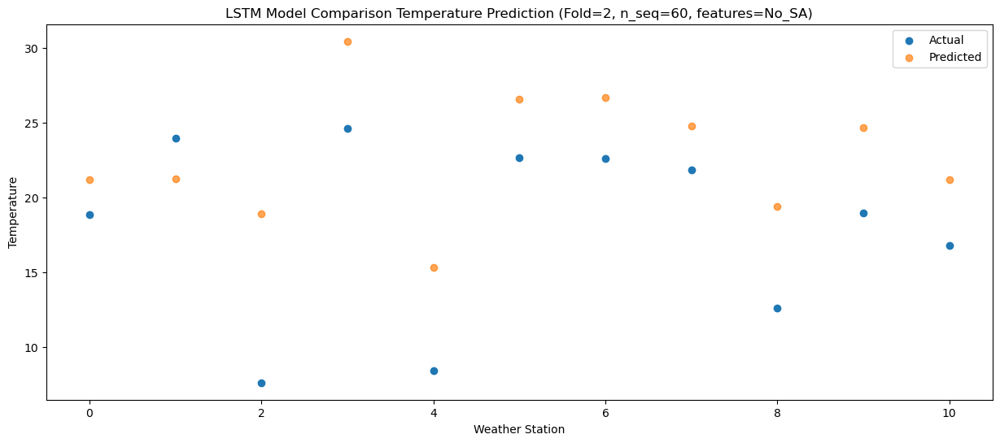

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   15.53  16.949808
1                 1   21.70  16.989811
2                 2    6.34  14.659807
3                 3   21.44  26.199809
4                 4    5.88  11.059807
5                 5   19.90  22.319809
6                 6   20.35  22.429810
7                 7   19.65  20.519808
8                 8   10.84  15.149810
9                 9   14.85  20.419807
10               10   12.31  16.949809


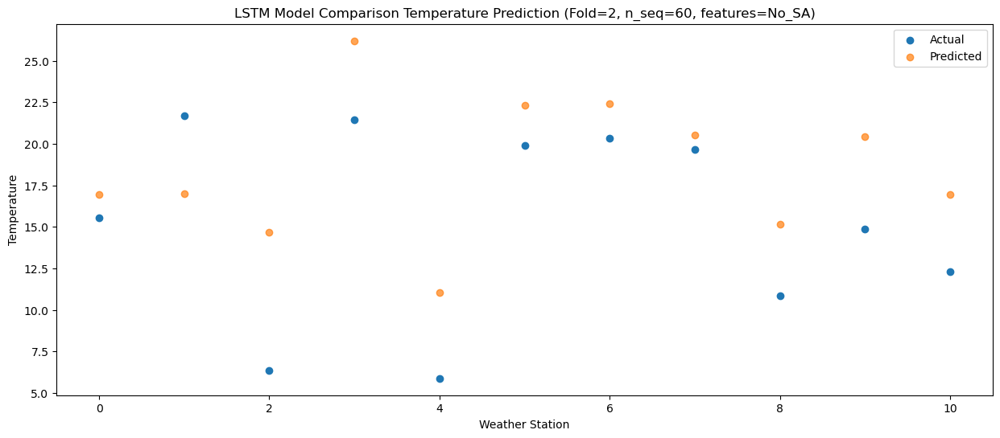

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   10.78  12.656555
1                 1   13.44  12.696558
2                 2    5.20  10.366556
3                 3   17.61  21.906558
4                 4    3.14   6.766554
5                 5   16.60  18.026556
6                 6   15.84  18.136557
7                 7   13.09  16.226555
8                 8    5.86  10.856557
9                 9   11.57  16.126556
10               10    8.55  12.656556


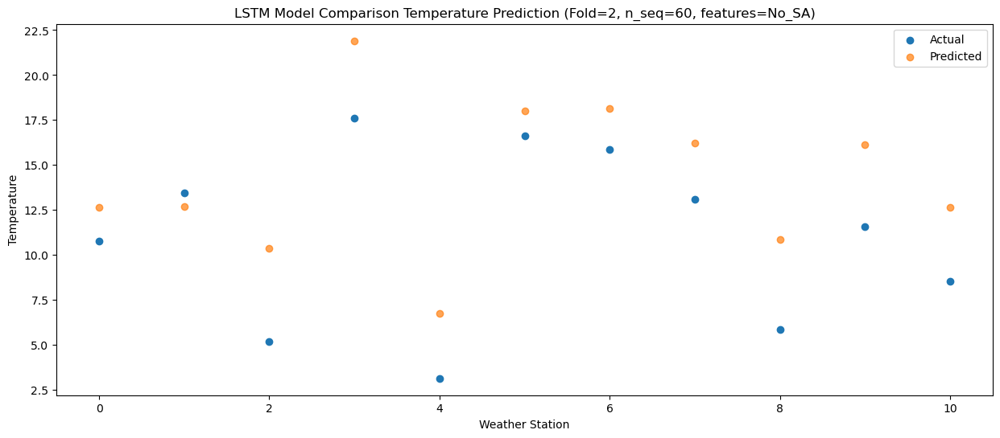

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    1.16   4.042781
1                 1    6.73   4.082784
2                 2   -1.65   1.752782
3                 3    9.53  13.292784
4                 4   -5.13  -1.847220
5                 5    8.96   9.412782
6                 6    7.87   9.522783
7                 7    7.69   7.612781
8                 8    4.60   2.242783
9                 9    2.66   7.512782
10               10   -1.67   4.042782


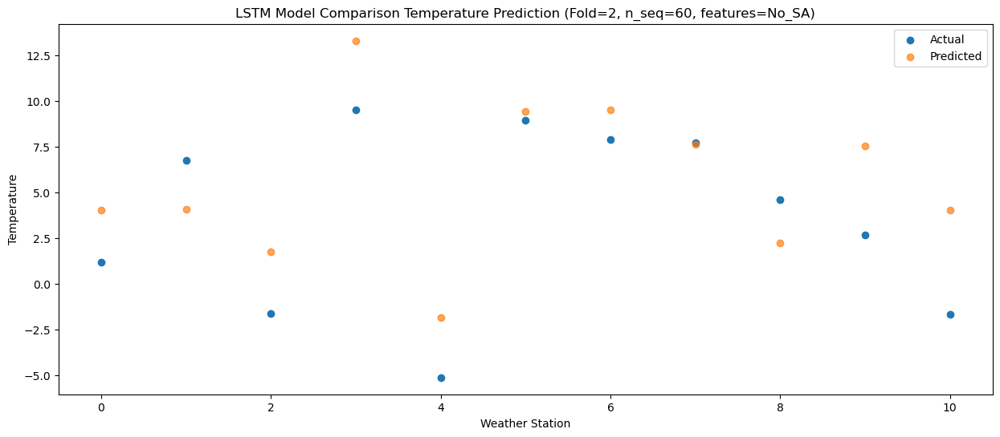

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    4.25   3.517851
1                 1    4.34   3.557854
2                 2   -0.75   1.227851
3                 3    7.61  12.767853
4                 4   -1.72  -2.372149
5                 5   12.20   8.887852
6                 6   10.16   8.997852
7                 7    4.34   7.087852
8                 8   -1.91   1.717852
9                 9    4.58   6.987851
10               10    0.43   3.517852


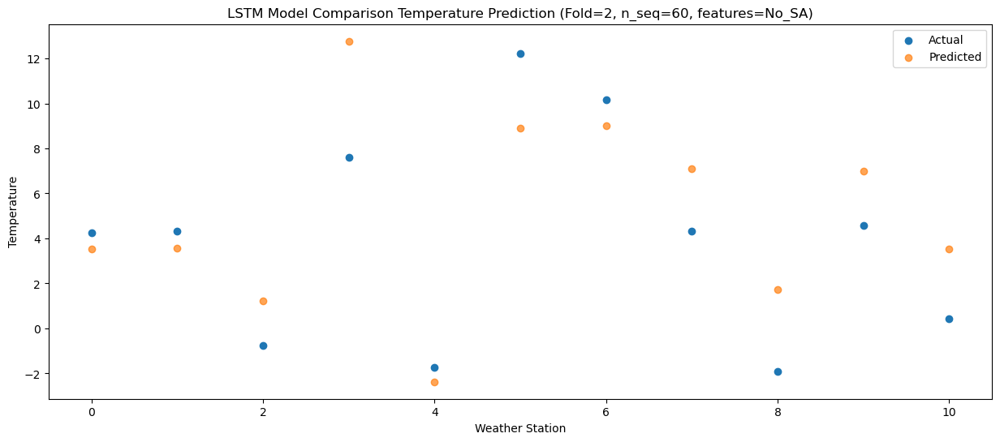

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -5.05  -3.148090
1                 1   -0.35  -3.108086
2                 2   -5.01  -5.438089
3                 3    1.46   6.101913
4                 4   -9.45  -9.038090
5                 5    3.77   2.221911
6                 6    1.68   2.331912
7                 7    1.34   0.421911
8                 8    0.50  -4.948088
9                 9   -1.90   0.321911
10               10   -6.44  -3.148089


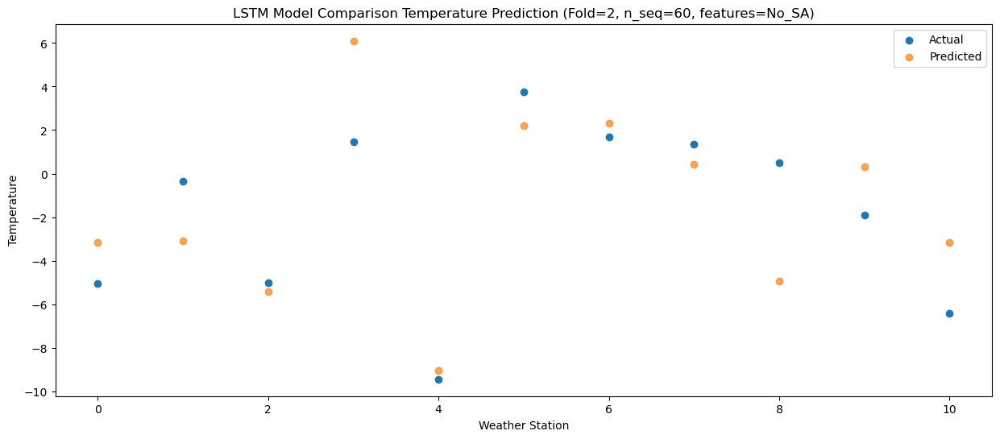

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -2.81  -0.085146
1                 1   -0.36  -0.045143
2                 2   -2.68  -2.375146
3                 3    3.78   9.164856
4                 4   -6.31  -5.975146
5                 5    3.39   5.284854
6                 6    1.51   5.394855
7                 7    2.31   3.484855
8                 8    1.37  -1.885145
9                 9    2.12   3.384854
10               10   -1.85  -0.085146


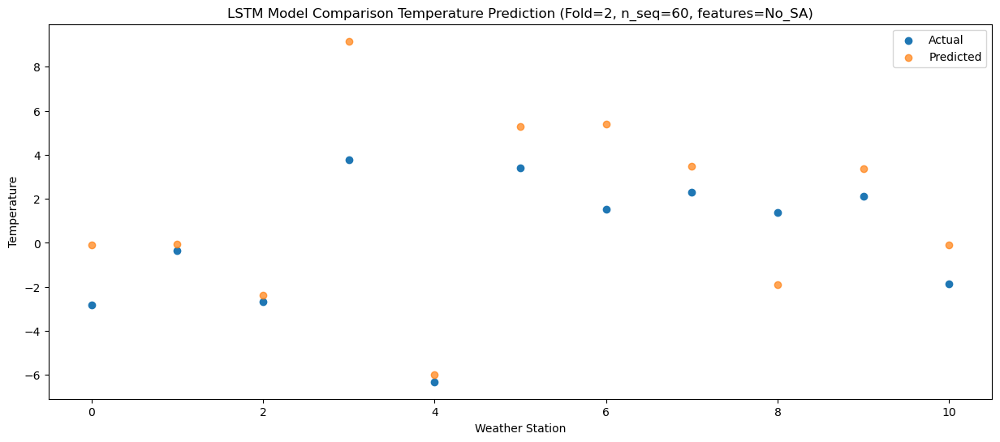

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    3.48   6.039692
1                 1    6.62   6.079696
2                 2    0.79   3.749692
3                 3    7.64  15.289694
4                 4   -2.55   0.149692
5                 5    9.51  11.409693
6                 6    8.09  11.519694
7                 7    7.37   9.609693
8                 8    3.16   4.239694
9                 9    6.23   9.509692
10               10    2.70   6.039693


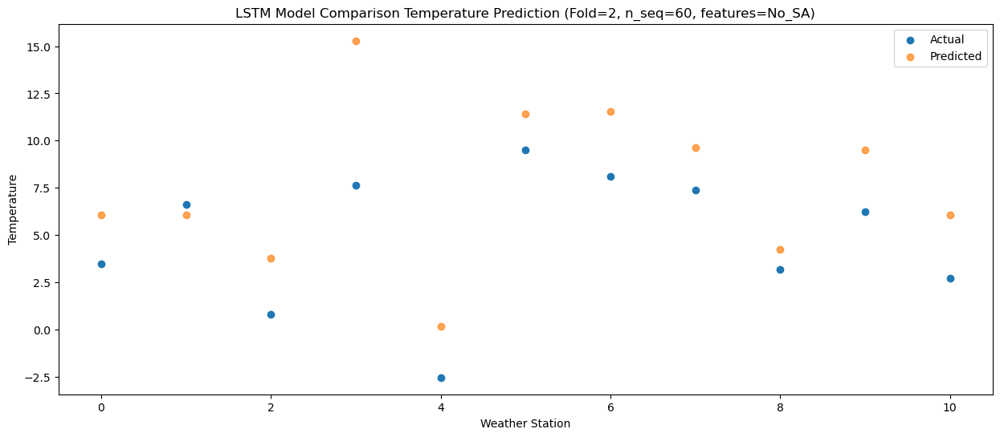

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    7.51   9.690992
1                 1   13.30   9.730996
2                 2    2.60   7.400993
3                 3   12.08  18.940995
4                 4    1.25   3.800992
5                 5   15.66  15.060993
6                 6   14.36  15.170994
7                 7   14.56  13.260993
8                 8    5.28   7.890994
9                 9    9.52  13.160993
10               10    5.86   9.690993


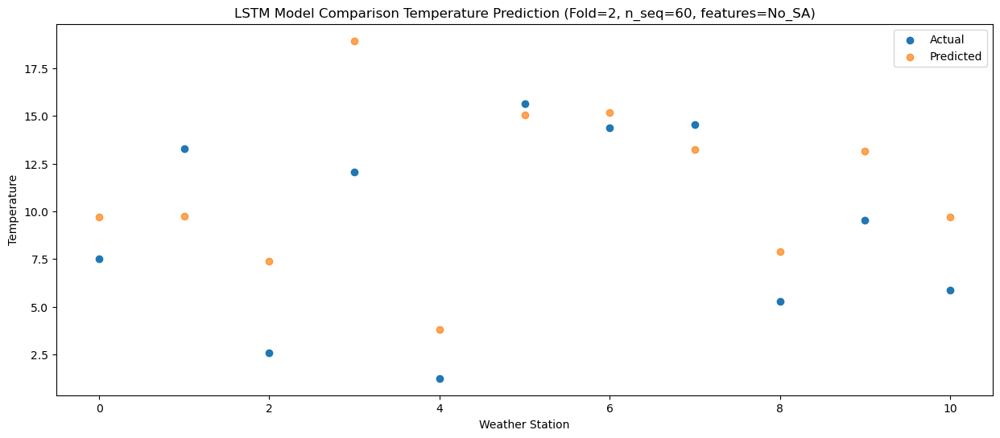

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   14.06  16.728257
1                 1   19.10  16.768261
2                 2    5.36  14.438255
3                 3   17.42  25.978259
4                 4    6.41  10.838255
5                 5   20.26  22.098258
6                 6   19.38  22.208259
7                 7   19.26  20.298258
8                 8    6.24  14.928259
9                 9   14.37  20.198257
10               10   12.10  16.728258


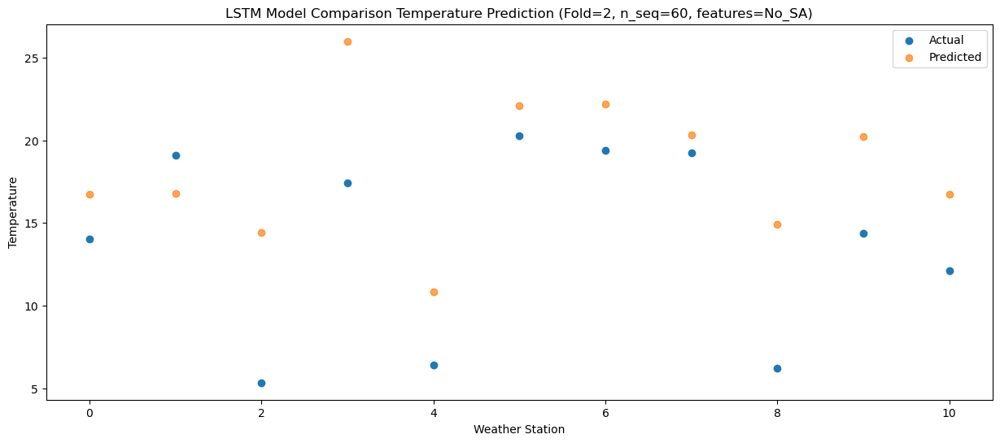

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   18.11  21.115341
1                 1   22.90  21.155345
2                 2    7.17  18.825340
3                 3   21.66  30.365344
4                 4    9.00  15.225339
5                 5   23.98  26.485342
6                 6   24.09  26.595343
7                 7   23.12  24.685342
8                 8   11.16  19.315343
9                 9   18.13  24.585342
10               10   15.75  21.115342


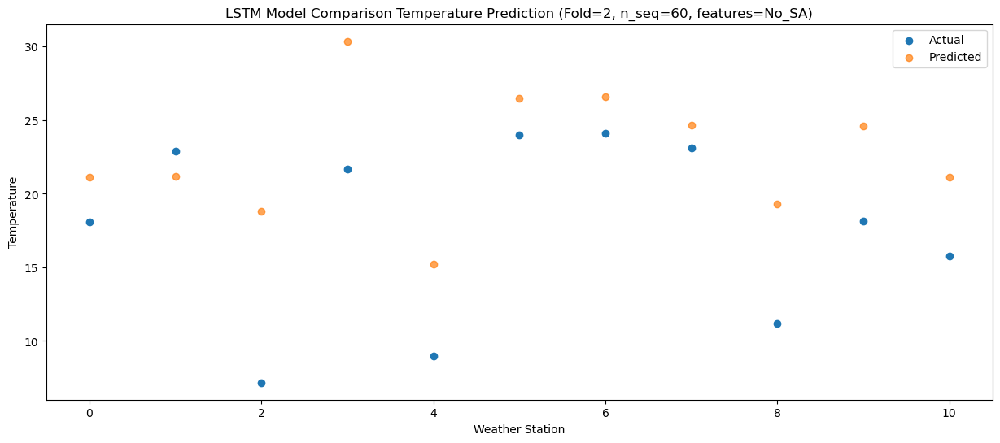

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   20.61  24.416482
1                 1   26.14  24.456486
2                 2    7.35  22.126480
3                 3   26.28  33.666484
4                 4    8.83  18.526480
5                 5   25.34  29.786483
6                 6   26.88  29.896484
7                 7   24.26  27.986483
8                 8   11.97  22.616484
9                 9   19.57  27.886482
10               10   17.10  24.416483


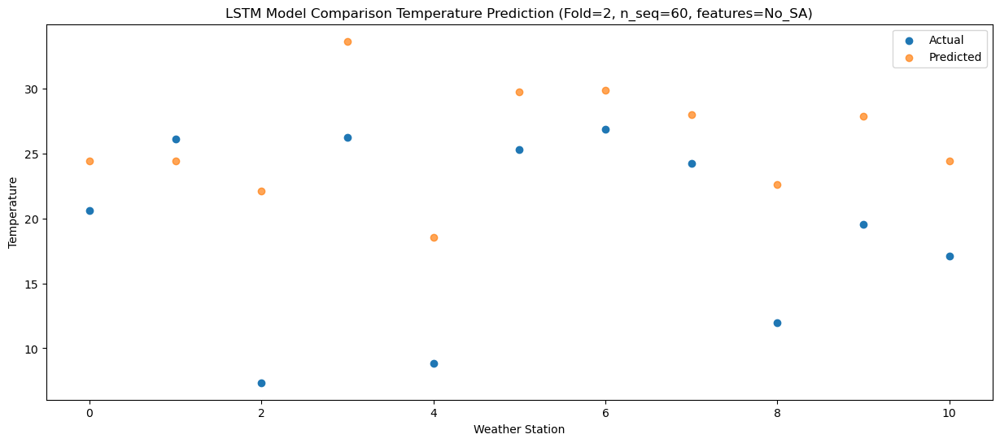

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   18.06  23.186923
1                 1   23.83  23.226927
2                 2    6.78  20.896921
3                 3   26.20  32.436925
4                 4    8.01  17.296921
5                 5   22.62  28.556924
6                 6   24.07  28.666925
7                 7   21.24  26.756924
8                 8   14.01  21.386925
9                 9   18.19  26.656923
10               10   15.85  23.186924


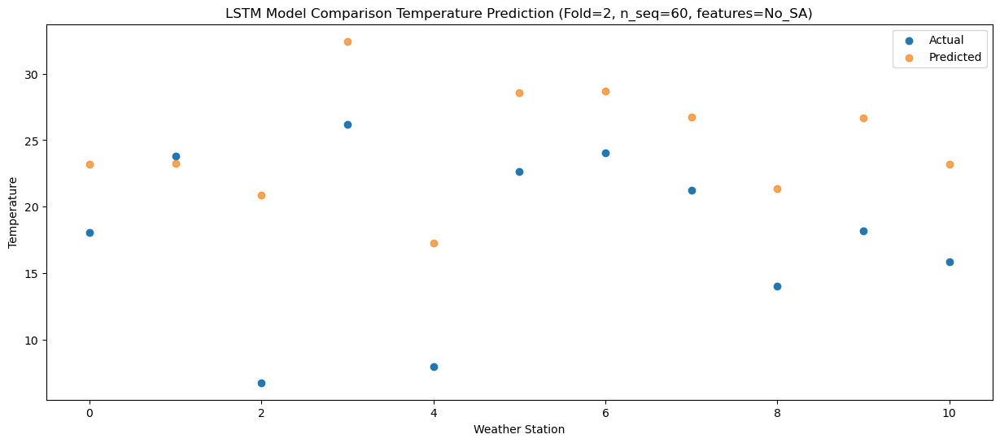

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   16.31  19.038878
1                 1   21.07  19.078883
2                 2    5.37  16.748877
3                 3   21.16  28.288881
4                 4    6.04  13.148877
5                 5   19.96  24.408880
6                 6   20.24  24.518881
7                 7   19.51  22.608881
8                 8   13.60  17.238881
9                 9   14.88  22.508878
10               10   11.70  19.038879


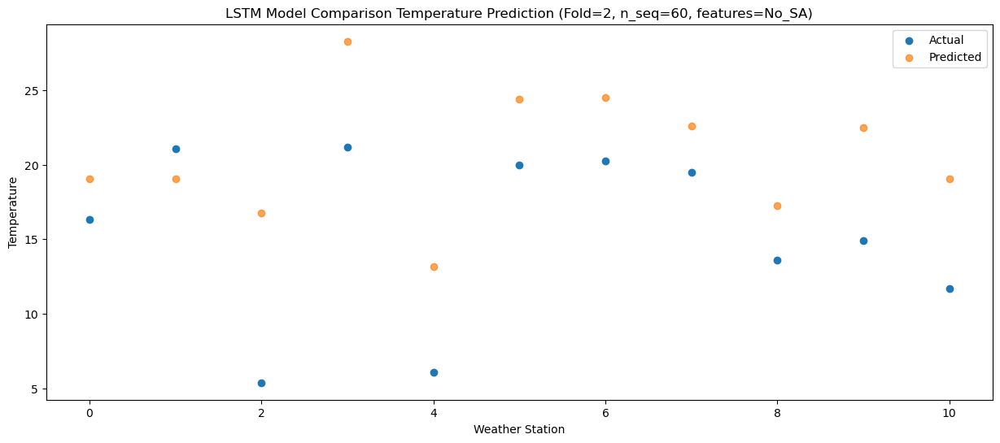

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    7.97  12.416795
1                 1   12.69  12.456801
2                 2    2.74  10.126794
3                 3   15.72  21.666798
4                 4   -0.15   6.526794
5                 5   14.39  17.786797
6                 6   13.86  17.896798
7                 7   11.30  15.986798
8                 8    7.33  10.616798
9                 9    7.57  15.886795
10               10    4.42  12.416796


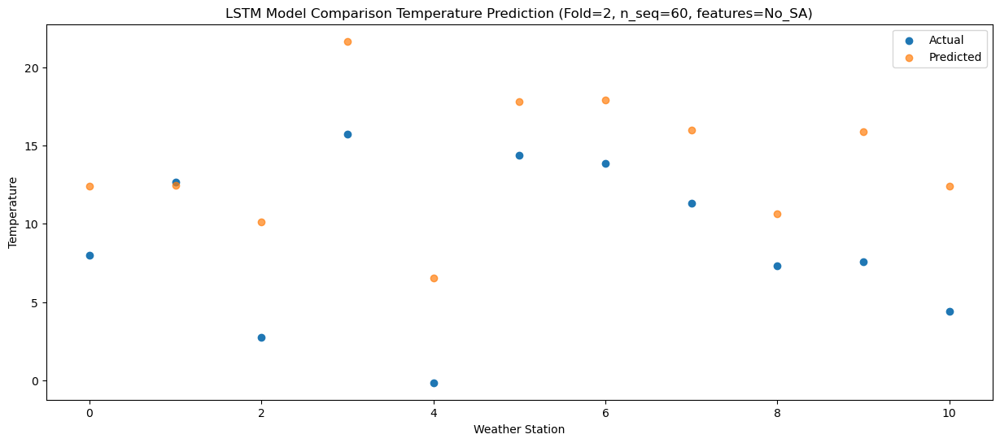

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.84   6.766271
1                 1    2.70   6.806277
2                 2    0.98   4.476271
3                 3   11.92  16.016275
4                 4   -3.22   0.876270
5                 5    8.51  12.136273
6                 6    7.19  12.246274
7                 7    4.41  10.336274
8                 8    1.10   4.966274
9                 9    5.45  10.236272
10               10    1.97   6.766272


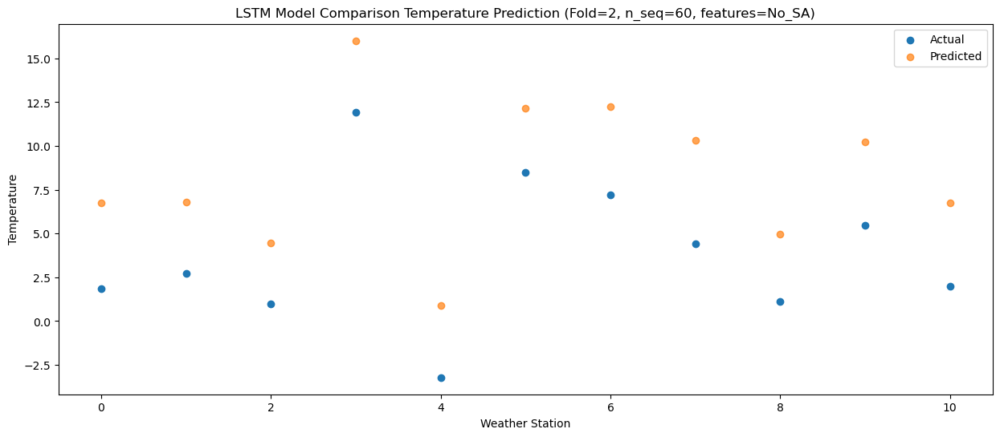

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -1.67   1.749687
1                 1   -0.01   1.789693
2                 2   -3.12  -0.540313
3                 3    5.75  10.999691
4                 4   -5.73  -4.140314
5                 5    6.28   7.119689
6                 6    4.57   7.229690
7                 7    2.24   5.319690
8                 8   -1.60  -0.050310
9                 9   -1.08   5.219688
10               10   -3.49   1.749688


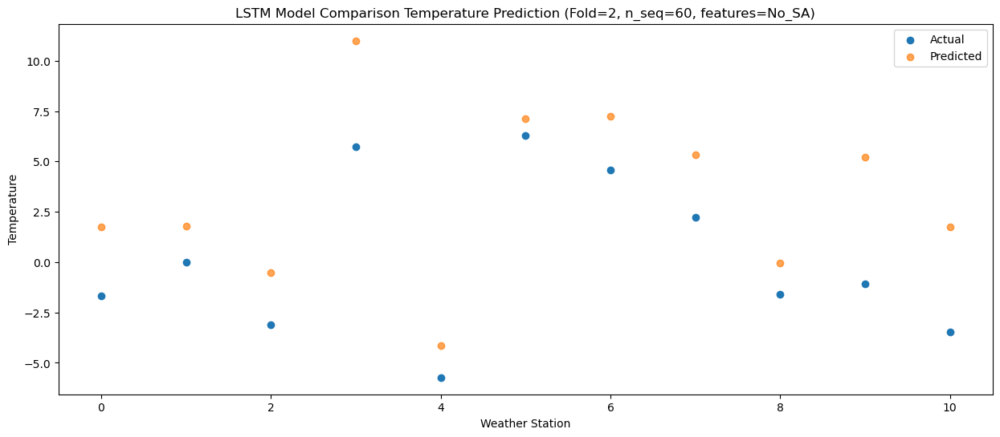

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    0.35   3.973830
1                 1   -0.26   4.013836
2                 2   -3.32   1.683829
3                 3    7.04  13.223833
4                 4   -4.56  -1.916171
5                 5    7.04   9.343832
6                 6    5.45   9.453833
7                 7    1.53   7.543833
8                 8   -1.94   2.173835
9                 9    2.12   7.443830
10               10   -1.57   3.973831


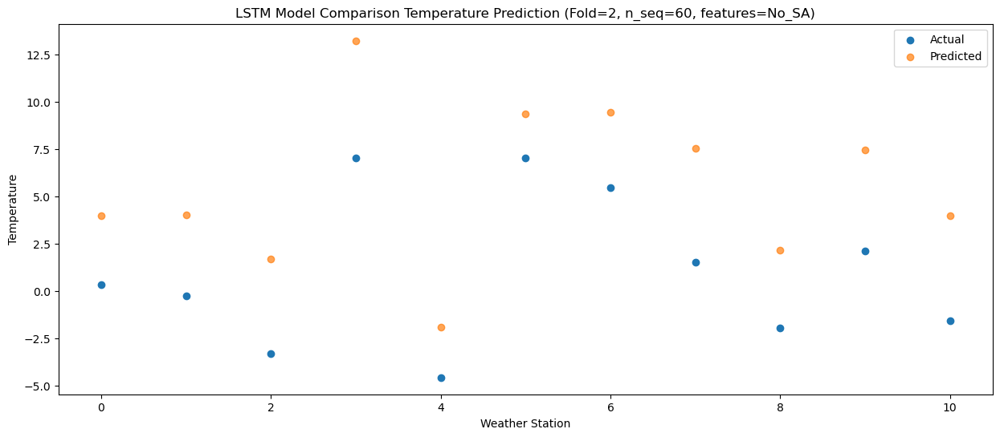

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    1.37   4.601880
1                 1    1.34   4.641886
2                 2   -0.26   2.311880
3                 3    5.16  13.851884
4                 4   -2.43  -1.288121
5                 5    8.23   9.971882
6                 6    5.64  10.081883
7                 7    2.74   8.171883
8                 8   -2.26   2.801885
9                 9    5.14   8.071881
10               10    1.22   4.601881


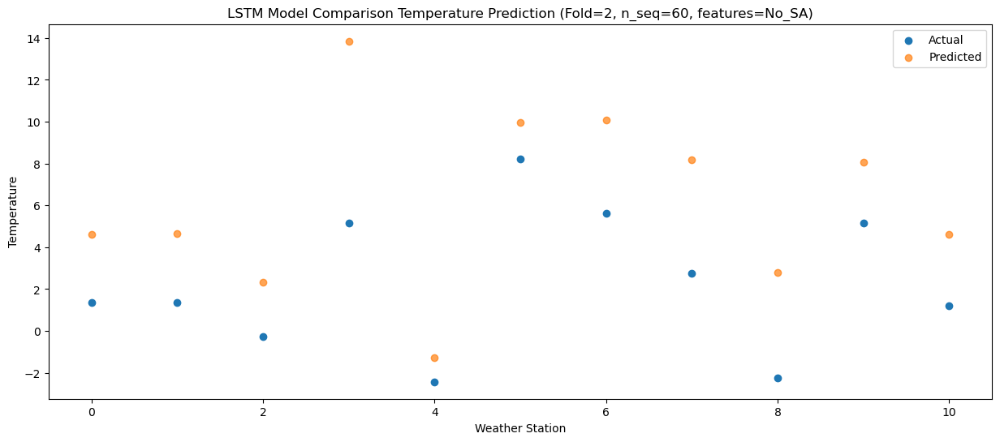

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    3.64   6.524021
1                 1    5.41   6.564027
2                 2    0.76   4.234021
3                 3    7.60  15.774024
4                 4   -0.60   0.634020
5                 5   12.03  11.894023
6                 6   10.29  12.004024
7                 7    7.44  10.094024
8                 8   -1.25   4.724026
9                 9    5.59   9.994021
10               10    1.75   6.524022


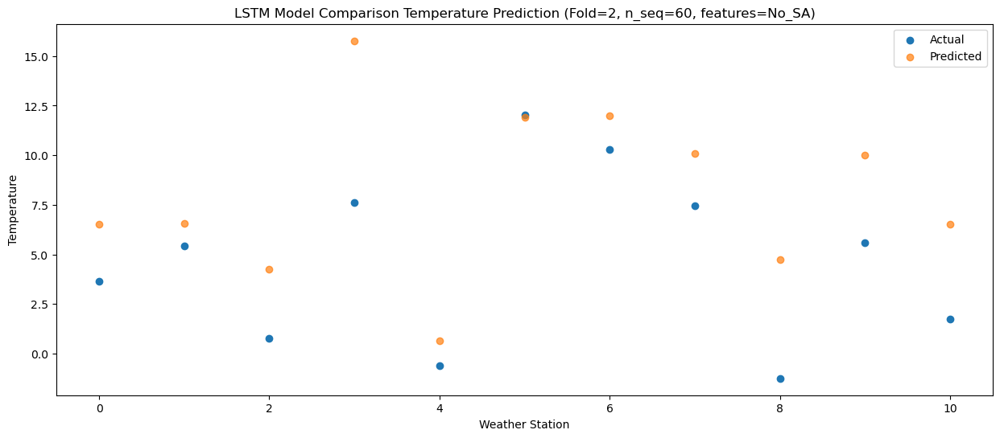

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    7.79  12.463233
1                 1   11.27  12.503239
2                 2    3.30  10.173232
3                 3   13.32  21.713236
4                 4    1.32   6.573232
5                 5   12.95  17.833235
6                 6   12.11  17.943236
7                 7   13.08  16.033236
8                 8    2.59  10.663238
9                 9    9.11  15.933233
10               10    6.64  12.463234


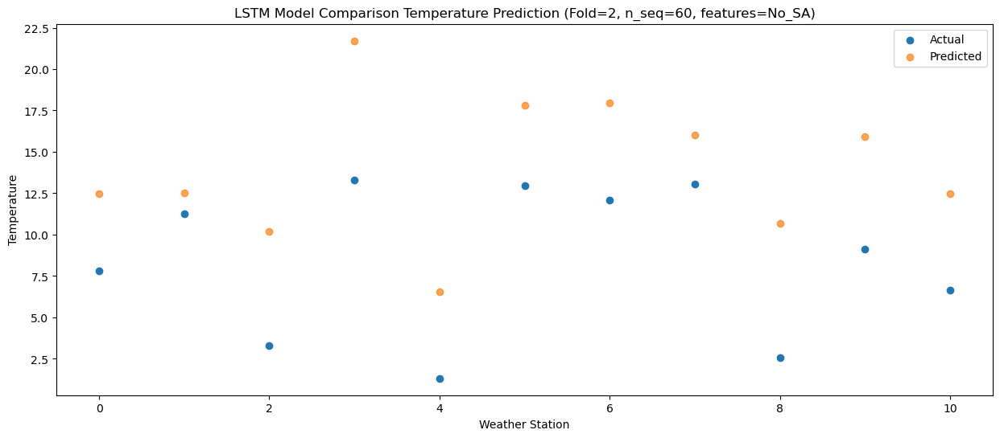

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   13.84  17.247228
1                 1   16.76  17.287234
2                 2    4.28  14.957227
3                 3   16.95  26.497231
4                 4    5.35  11.357227
5                 5   18.03  22.617230
6                 6   17.85  22.727231
7                 7   17.73  20.817231
8                 8    3.80  15.447233
9                 9   11.89  20.717228
10               10    9.99  17.247229


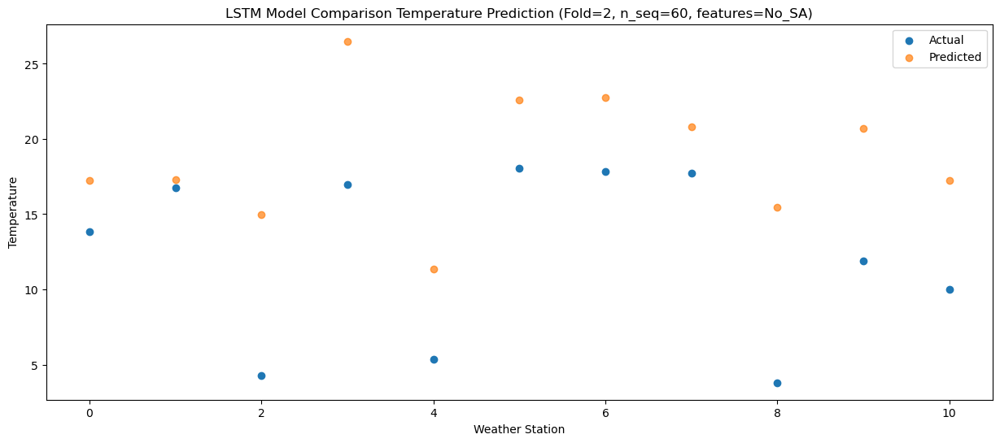

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   16.47  21.003384
1                 1   19.37  21.043389
2                 2    6.69  18.713383
3                 3   20.74  30.253387
4                 4    9.00  15.113383
5                 5   22.95  26.373386
6                 6   22.00  26.483387
7                 7   22.39  24.573387
8                 8    5.76  19.203388
9                 9   15.55  24.473384
10               10   12.90  21.003385


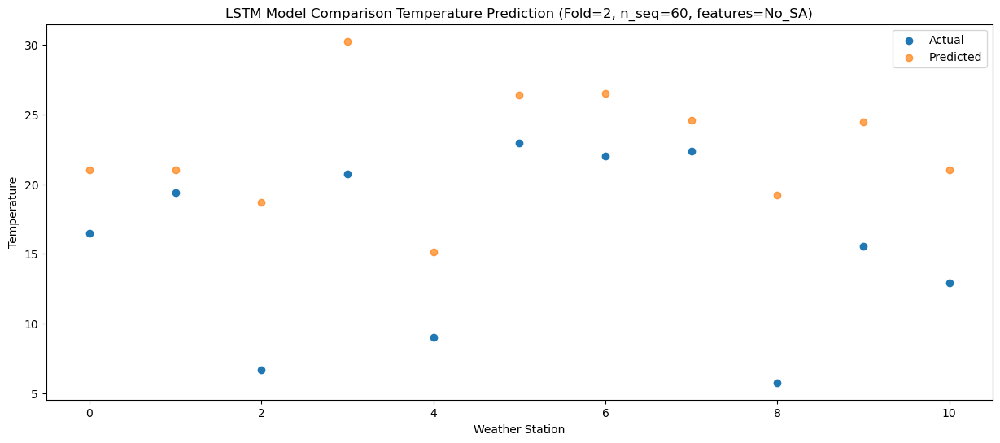

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   18.22  24.331883
1                 1   23.47  24.371889
2                 2    8.60  22.041883
3                 3   26.31  33.581886
4                 4   10.44  18.441882
5                 5   25.11  29.701885
6                 6   24.56  29.811886
7                 7   27.14  27.901886
8                 8   12.68  22.531888
9                 9   19.14  27.801883
10               10   16.45  24.331884


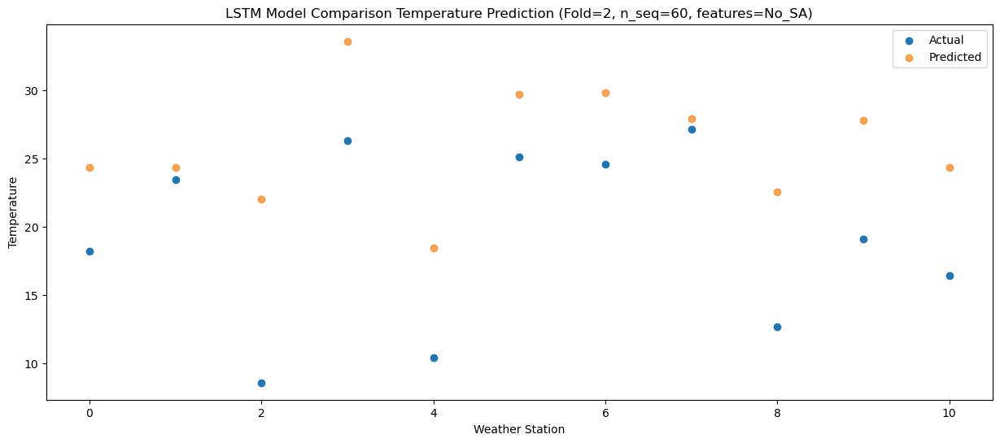

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   17.73  23.465204
1                 1   23.96  23.505209
2                 2    8.78  21.175203
3                 3   24.30  32.715207
4                 4   11.74  17.575203
5                 5   26.81  28.835206
6                 6   26.90  28.945207
7                 7   24.14  27.035207
8                 8   12.31  21.665208
9                 9   18.59  26.935204
10               10   15.74  23.465205


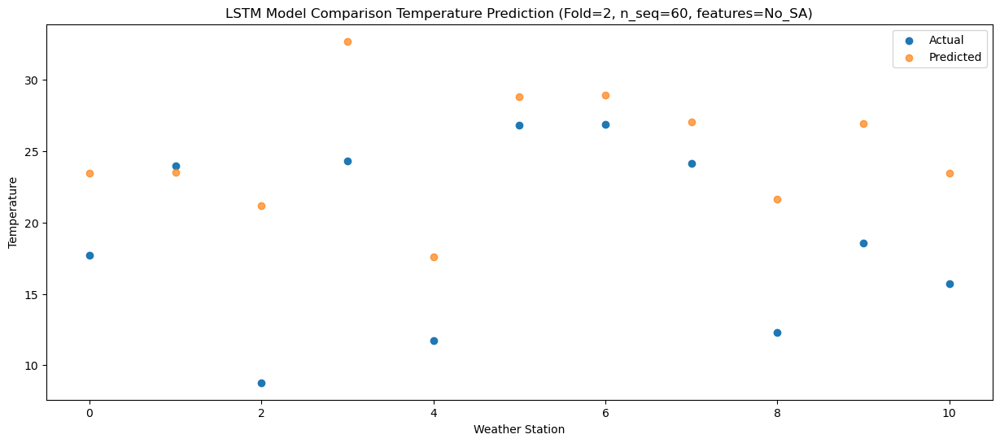

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   14.44  20.174055
1                 1   21.09  20.214060
2                 2    6.83  17.884054
3                 3   21.88  29.424058
4                 4    7.31  14.284054
5                 5   22.33  25.544056
6                 6   22.12  25.654057
7                 7   21.48  23.744057
8                 8    8.81  18.374059
9                 9   14.63  23.644055
10               10   12.96  20.174055


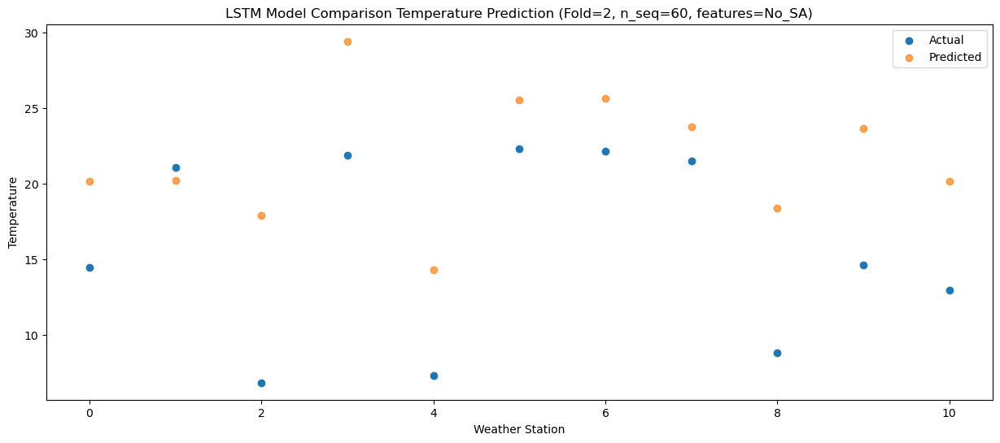

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    9.28  14.864480
1                 1   12.05  14.904486
2                 2    3.25  12.574480
3                 3   16.86  24.114484
4                 4    1.15   8.974479
5                 5   14.44  20.234482
6                 6   13.40  20.344483
7                 7   14.74  18.434483
8                 8    7.22  13.064485
9                 9    9.34  18.334481
10               10    6.91  14.864481


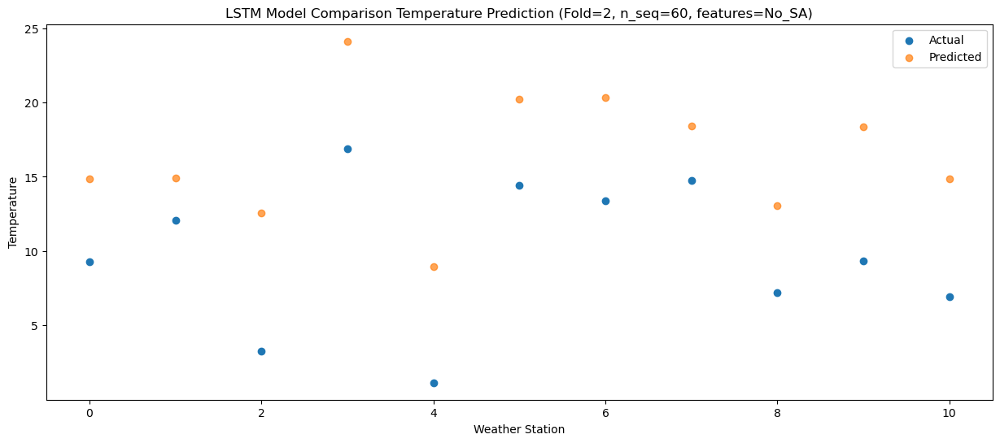

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    2.17   7.875794
1                 1    5.33   7.915800
2                 2   -0.73   5.585793
3                 3    8.88  17.125797
4                 4   -3.96   1.985793
5                 5    8.16  13.245796
6                 6    8.06  13.355797
7                 7    7.63  11.445797
8                 8    2.83   6.075799
9                 9    3.44  11.345794
10               10    0.70   7.875795


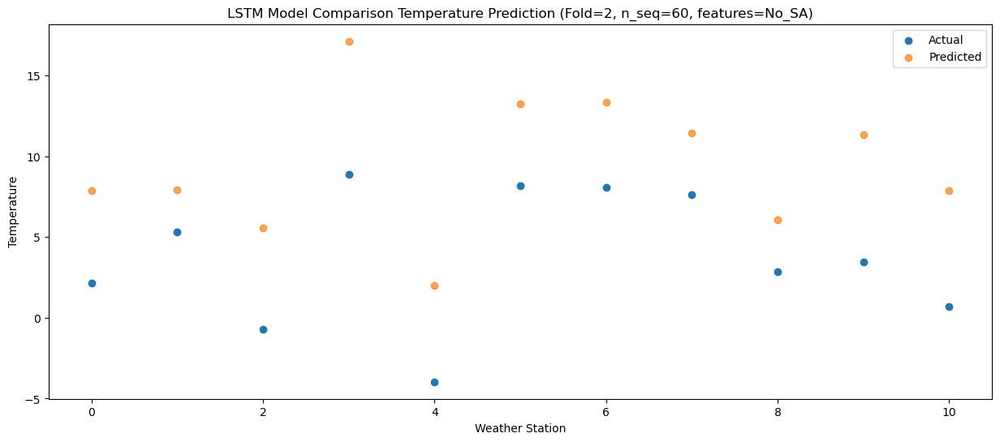

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -0.89   6.744655
1                 1    1.66   6.784661
2                 2   -2.66   4.454654
3                 3    8.14  15.994658
4                 4   -6.56   0.854654
5                 5    6.05  12.114657
6                 6    5.08  12.224658
7                 7    2.59  10.314658
8                 8    0.50   4.944660
9                 9    0.97  10.214655
10               10   -2.15   6.744655


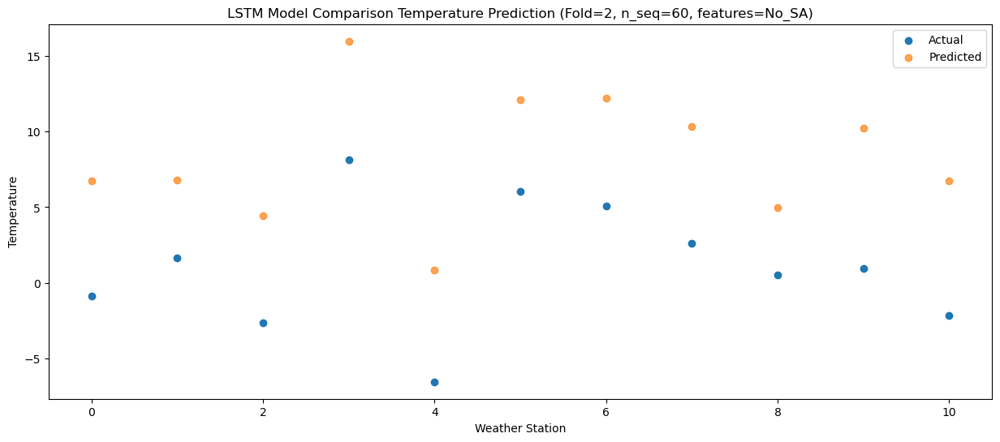

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -6.68   1.932224
1                 1   -3.43   1.972230
2                 2   -4.66  -0.357778
3                 3    3.97  11.182227
4                 4   -8.64  -3.957777
5                 5    1.90   7.302226
6                 6   -0.10   7.412227
7                 7    2.26   5.502227
8                 8   -1.30   0.132229
9                 9   -0.88   5.402223
10               10   -5.47   1.932224


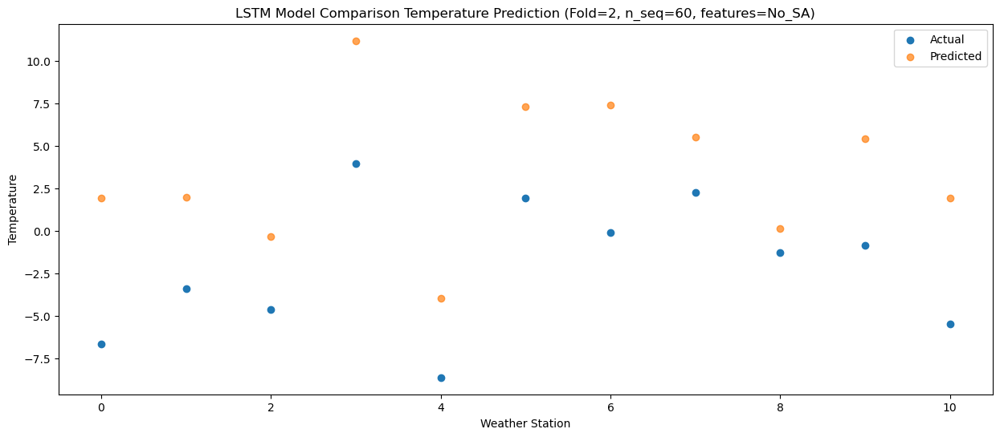

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    1.64   6.971939
1                 1    4.05   7.011944
2                 2   -4.18   4.681937
3                 3    4.65  16.221942
4                 4   -4.48   1.081938
5                 5    8.66  12.341941
6                 6    8.16  12.451941
7                 7    5.47  10.541942
8                 8   -0.77   5.171943
9                 9    2.34  10.441938
10               10   -0.93   6.971939


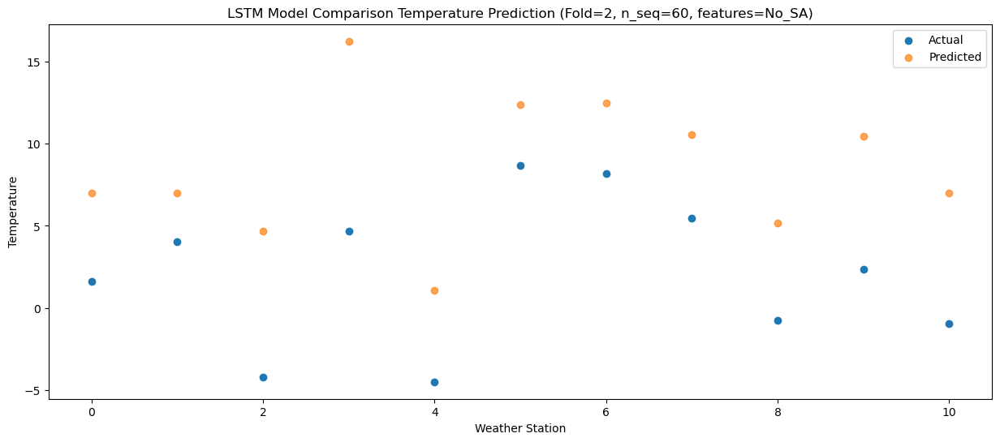

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    4.53  10.149140
1                 1    6.82  10.189146
2                 2    0.24   7.859138
3                 3    9.05  19.399143
4                 4   -1.81   4.259139
5                 5   11.03  15.519142
6                 6   10.51  15.629143
7                 7    8.04  13.719143
8                 8    0.17   8.349145
9                 9    5.90  13.619139
10               10    3.24  10.149140


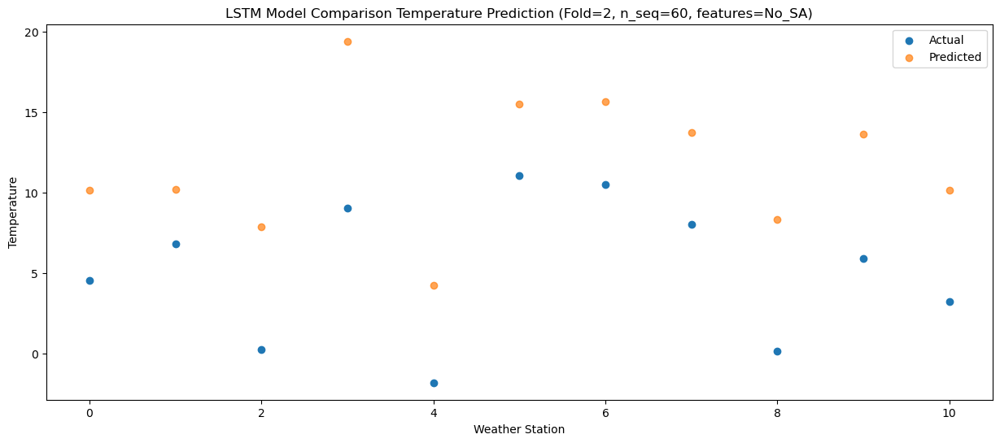

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    9.29  15.708567
1                 1   12.23  15.748573
2                 2    1.63  13.418566
3                 3   11.48  24.958570
4                 4    1.85   9.818566
5                 5   14.77  21.078569
6                 6   13.96  21.188570
7                 7   12.45  19.278570
8                 8    2.28  13.908572
9                 9    9.96  19.178567
10               10    7.22  15.708567


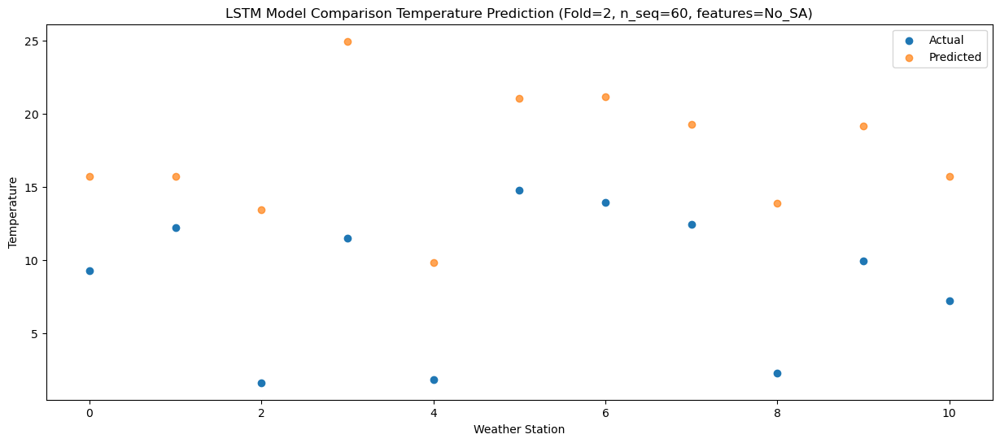

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   14.22  21.114041
1                 1   16.84  21.154047
2                 2    6.48  18.824040
3                 3   17.27  30.364045
4                 4    6.90  15.224040
5                 5   18.47  26.484043
6                 6   18.85  26.594044
7                 7   18.27  24.684044
8                 8    4.08  19.314046
9                 9   14.34  24.584041
10               10   11.68  21.114041


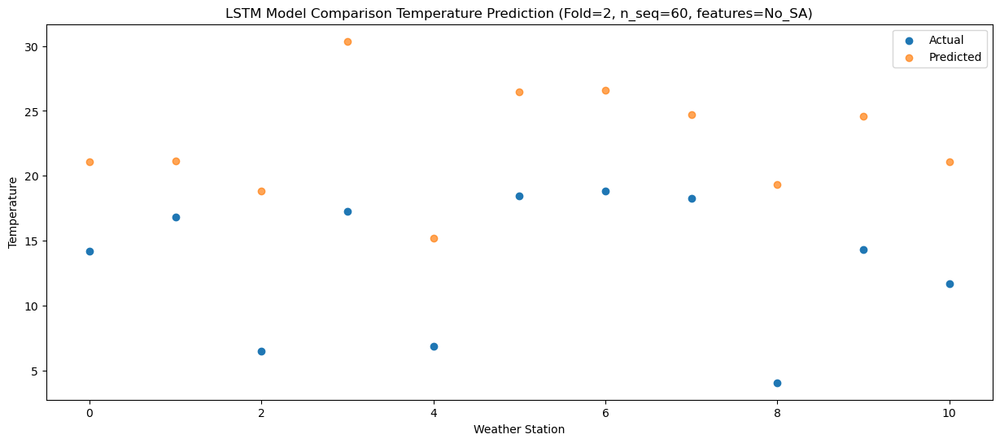

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   17.30  24.949771
1                 1   23.01  24.989777
2                 2    7.39  22.659770
3                 3   23.24  34.199775
4                 4    8.73  19.059771
5                 5   21.70  30.319773
6                 6   22.35  30.429774
7                 7   24.69  28.519774
8                 8    8.76  23.149776
9                 9   18.22  28.419771
10               10   16.03  24.949770


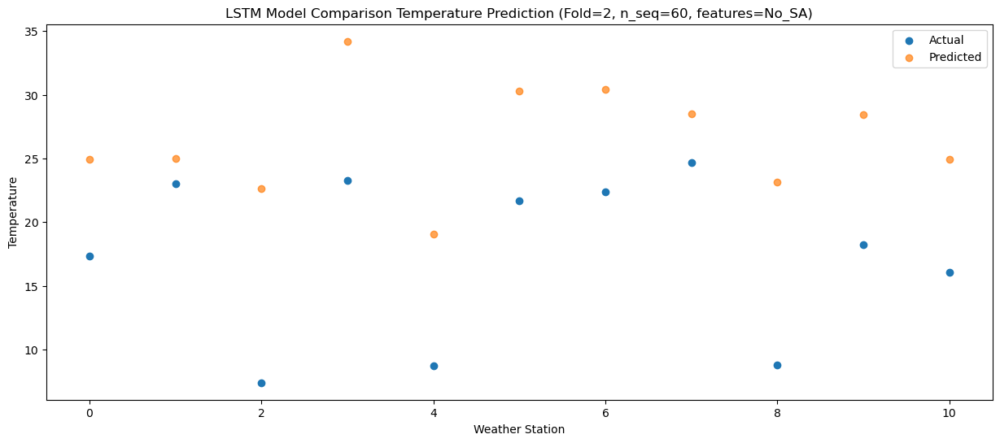

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   17.79  27.327932
1                 1   23.56  27.367937
2                 2    8.23  25.037930
3                 3   26.02  36.577935
4                 4    9.34  21.437931
5                 5   20.18  32.697934
6                 6   22.66  32.807935
7                 7   24.16  30.897935
8                 8   12.49  25.527936
9                 9   19.61  30.797931
10               10   17.26  27.327930


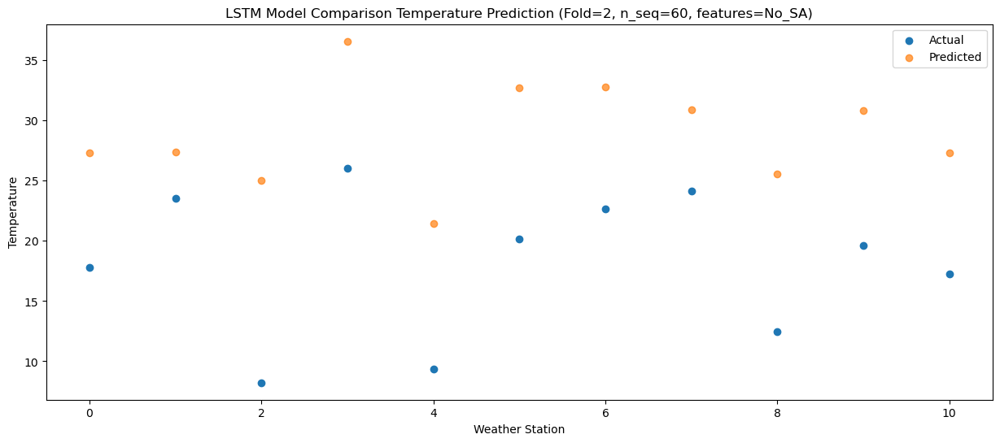

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   18.02  26.202661
1                 1   23.61  26.242666
2                 2    8.19  23.912659
3                 3   24.31  35.452664
4                 4    9.69  20.312660
5                 5   21.83  31.572663
6                 6   24.46  31.682663
7                 7   24.55  29.772664
8                 8   12.07  24.402665
9                 9   17.59  29.672661
10               10   15.64  26.202659


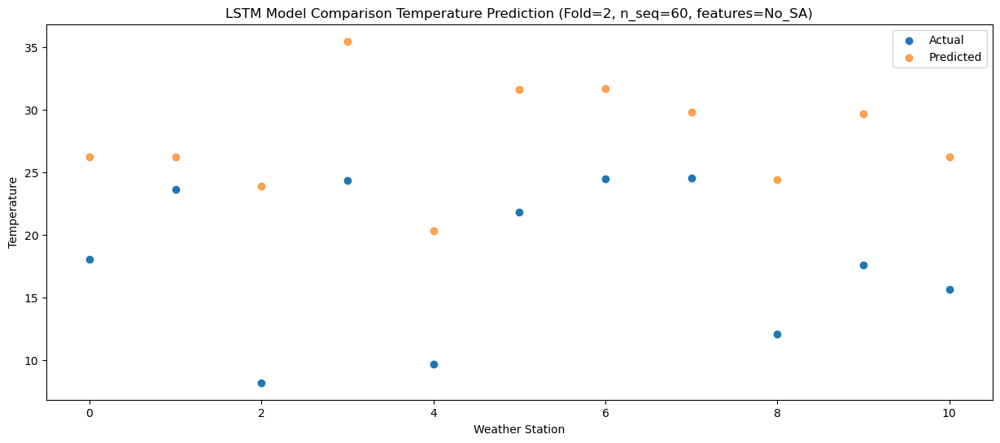

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   14.04  23.350680
1                 1   19.88  23.390686
2                 2    7.87  21.060679
3                 3   20.79  32.600683
4                 4    6.89  17.460679
5                 5   19.10  28.720683
6                 6   20.23  28.830683
7                 7   20.52  26.920684
8                 8   10.22  21.550685
9                 9   14.63  26.820680
10               10   13.05  23.350678


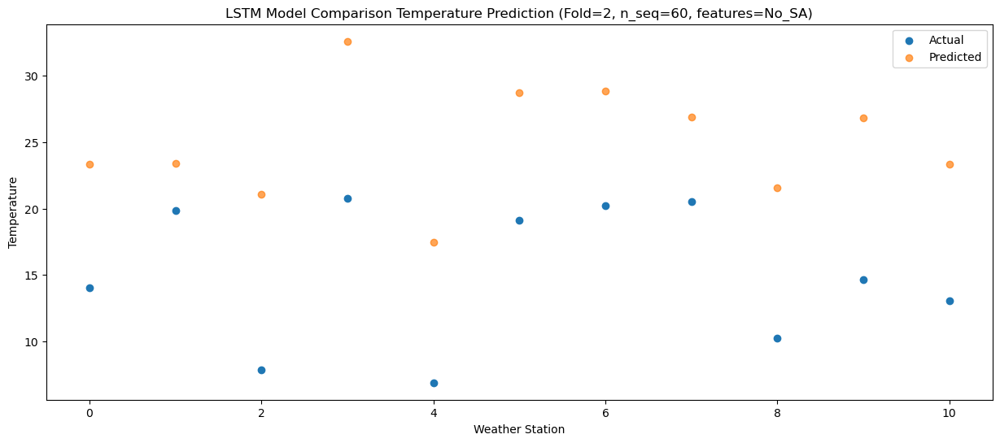

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    9.77  17.333876
1                 1   14.91  17.373883
2                 2    4.40  15.043875
3                 3   15.53  26.583880
4                 4    2.20  11.443875
5                 5   16.45  22.703880
6                 6   17.26  22.813880
7                 7   16.26  20.903881
8                 8    7.23  15.533882
9                 9    9.41  20.803877
10               10    6.63  17.333874


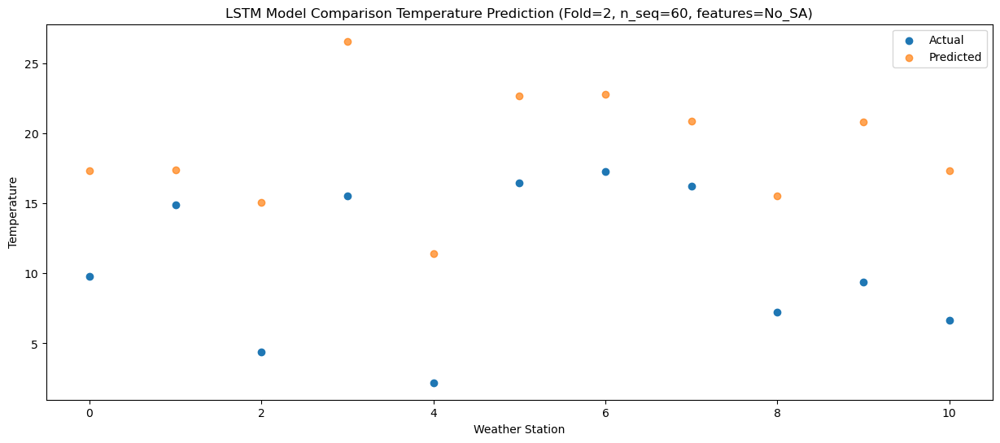

f, t:
[[-6.500e-01  3.410e+00 -1.000e-01  9.240e+00 -6.250e+00  7.270e+00
   6.650e+00  6.030e+00  2.170e+00  2.040e+00 -1.920e+00]
 [-3.100e-01  1.130e+00 -1.220e+00  6.180e+00 -5.900e+00  5.840e+00
   4.840e+00  1.500e+00 -1.370e+00  1.630e+00 -1.320e+00]
 [-9.000e-01  8.900e-01 -2.370e+00  6.450e+00 -5.560e+00  6.210e+00
   5.190e+00  2.750e+00 -8.300e-01  1.340e+00 -1.760e+00]
 [-1.090e+00  1.600e-01 -1.330e+00  6.600e+00 -4.920e+00  5.450e+00
   4.630e+00  3.560e+00  1.280e+00  2.380e+00 -1.960e+00]
 [ 5.500e+00  8.170e+00  2.290e+00  1.015e+01  1.770e+00  1.354e+01
   1.228e+01  8.060e+00  1.350e+00  7.610e+00  4.080e+00]
 [ 6.980e+00  1.040e+01  3.680e+00  1.138e+01  1.240e+00  1.351e+01
   1.259e+01  1.304e+01  4.560e+00  8.910e+00  4.510e+00]
 [ 1.227e+01  1.720e+01  4.990e+00  1.727e+01  4.210e+00  1.735e+01
   1.749e+01  1.933e+01  8.610e+00  1.151e+01  8.550e+00]
 [ 1.727e+01  2.440e+01  7.580e+00  2.333e+01  7.250e+00  2.096e+01
   2.223e+01  2.285e+01  9.900e+00  1.680e+0

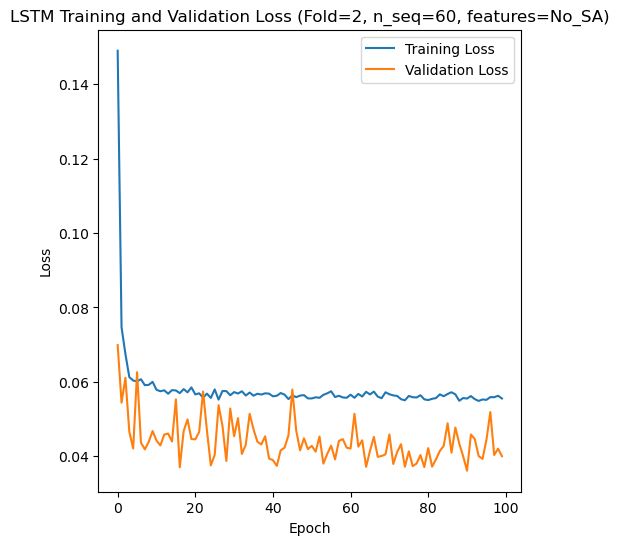

[[ 8.9   6.89 11.3  ... 22.19 16.88 13.54]
 [ 7.02  3.15 10.24 ... 22.31 18.92 11.32]
 [ 7.65  9.7   9.44 ... 25.68 20.65 11.46]
 ...
 [ 9.57 11.93 12.22 ... 30.9  25.01 12.37]
 [ 9.04  9.3   8.59 ... 17.72 17.26 10.73]
 [ 3.2   0.4   3.78 ... 18.92 14.39 10.04]]
Epoch 1/100
84/84 [==============================] - 47s 268ms/step - loss: 0.1381 - accuracy: 0.2857 - mae: 0.1130 - rmse: 0.1381 - mape: 25.5782 - pearson: 0.6153 - val_loss: 0.0937 - val_accuracy: 0.1000 - val_mae: 0.0738 - val_rmse: 0.0937 - val_mape: 15.8302 - val_pearson: 0.7016
Epoch 2/100
84/84 [==============================] - 18s 216ms/step - loss: 0.0775 - accuracy: 0.4643 - mae: 0.0626 - rmse: 0.0775 - mape: 14.2471 - pearson: 0.8262 - val_loss: 0.0774 - val_accuracy: 0.5000 - val_mae: 0.0618 - val_rmse: 0.0774 - val_mape: 14.4939 - val_pearson: 0.8032
Epoch 3/100
84/84 [==============================] - 17s 204ms/step - loss: 0.0626 - accuracy: 0.4643 - mae: 0.0498 - rmse: 0.0626 - mape: 11.6362 - pearson: 0.8459

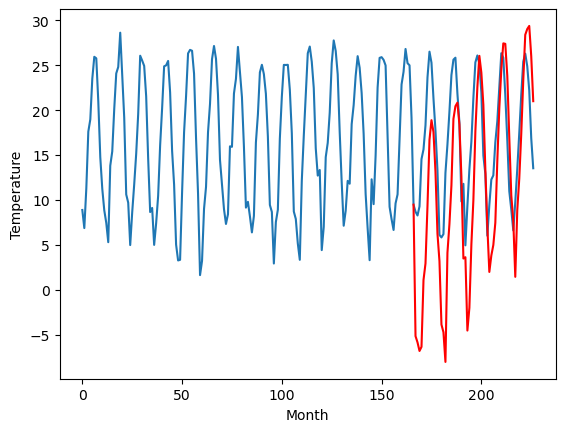

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.22		0.58		-1.64
0.87		-0.12		-0.99
0.03		-1.07		-1.10
0.18		-0.61		-0.79
7.67		6.81		-0.86
8.59		8.66		0.07
12.99		15.05		2.06
20.09		22.40		2.31
21.95		24.58		2.63
20.09		23.27		3.18
16.42		18.87		2.45
9.31		11.97		2.66
6.49		8.92		2.43
-0.06		1.86		1.92
-1.21		1.01		2.22
-4.93		-2.29		2.64
7.04		9.85		2.81
8.90		13.05		4.15
13.12		17.35		4.23
19.83		24.72		4.89
21.14		26.14		5.00
21.71		26.53		4.82
18.98		24.10		5.12
12.38		18.31		5.93
4.67		9.20		4.53
5.98		9.35		3.37
-2.85		1.20		4.05
-1.63		3.73		5.36
5.15		10.78		5.63
10.00		15.69		5.69
15.43		23.35		7.92
20.58		28.25		7.67
24.62		31.73		7.11
21.54		29.86		8.32
17.68		26.29		8.61
11.13		19.11		7.98
3.90		12.76		8.86
-0.15		7.71		7.86
0.55		9.54		8.99
2.51		10.71		8.20
5.11		13.18		8.07
10.16		20.10		9.94
15.47		25.91		10.44
19.80		30.21		10.41
22.06		33.12		11.06
22.24		33.07		10.83
18.19		29.49		11.30
11.25		22.64		11.39
5.47		16.23	

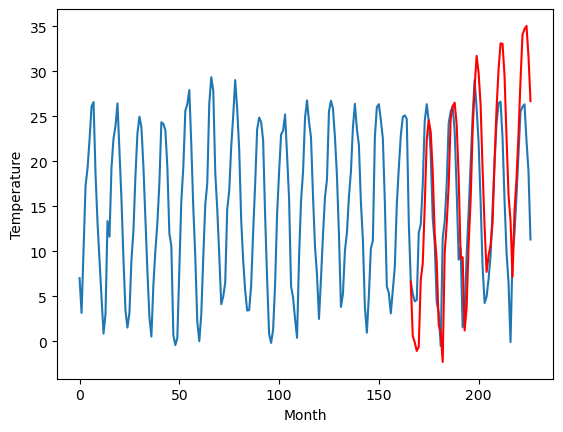

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.71		-1.30		-4.01
0.18		-2.00		-2.18
-1.04		-2.95		-1.91
1.38		-2.49		-3.87
3.17		4.93		1.76
7.83		6.78		-1.05
13.02		13.17		0.15
16.37		20.52		4.15
19.15		22.70		3.55
19.68		21.39		1.71
15.35		16.99		1.64
9.86		10.09		0.23
1.21		7.04		5.83
-1.99		-0.02		1.97
-0.73		-0.87		-0.14
1.57		-4.17		-5.74
2.72		7.97		5.25
8.45		11.17		2.72
13.25		15.47		2.22
18.10		22.84		4.74
21.23		24.26		3.03
19.03		24.65		5.62
15.72		22.22		6.50
7.06		16.43		9.37
2.72		7.32		4.60
-1.20		7.47		8.67
-1.53		-0.68		0.85
0.17		1.85		1.68
4.88		8.90		4.02
7.95		13.81		5.86
12.19		21.47		9.28
17.58		26.37		8.79
20.15		29.85		9.70
20.33		27.98		7.65
17.51		24.41		6.90
10.33		17.23		6.90
-0.40		10.88		11.28
-1.36		5.83		7.19
0.03		7.66		7.63
-0.82		8.83		9.65
2.05		11.30		9.25
7.68		18.22		10.54
12.12		24.03		11.91
14.92		28.33		13.41
20.58		31.24		10.66
18.89		31.19		12.30
15.12		27.61		12.49
9.81		20.76		10.95
2.90		14

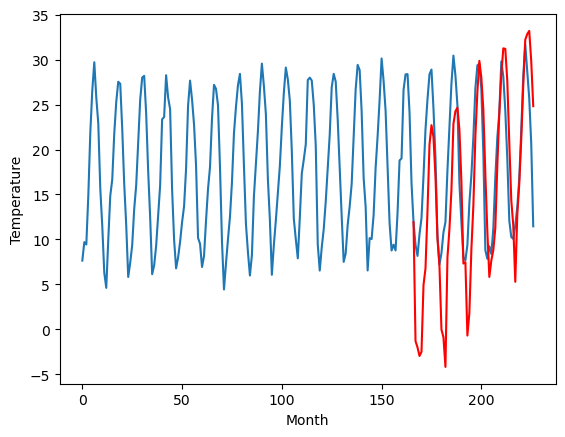

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-2.86		-0.67		2.19
-2.85		-1.37		1.48
-3.40		-2.32		1.08
-3.75		-1.86		1.89
3.16		5.56		2.40
3.80		7.41		3.61
8.37		13.80		5.43
14.19		21.15		6.96
17.99		23.33		5.34
15.57		22.02		6.45
11.51		17.62		6.11
6.09		10.72		4.63
2.17		7.67		5.50
-5.03		0.61		5.64
-6.49		-0.24		6.25
-7.81		-3.54		4.27
2.40		8.60		6.20
4.75		11.80		7.05
8.82		16.10		7.28
14.74		23.47		8.73
15.73		24.89		9.16
16.25		25.28		9.03
12.12		22.85		10.73
8.54		17.06		8.52
-1.12		7.95		9.07
0.37		8.10		7.73
-8.58		-0.05		8.53
-4.06		2.48		6.54
1.69		9.53		7.84
4.70		14.44		9.74
11.48		22.10		10.62
14.96		27.00		12.04
16.51		30.48		13.97
15.44		28.61		13.17
11.46		25.04		13.58
4.19		17.86		13.67
1.07		11.51		10.44
-4.20		6.46		10.66
-2.45		8.29		10.74
-0.11		9.46		9.57
0.13		11.93		11.80
6.37		18.85		12.48
9.06		24.66		15.60
12.80		28.96		16.16
16.42		31.87		15.45
15.31		31.82		16.51
12.58		28.24		15.66
7.14		21.39		14.25
0.75	

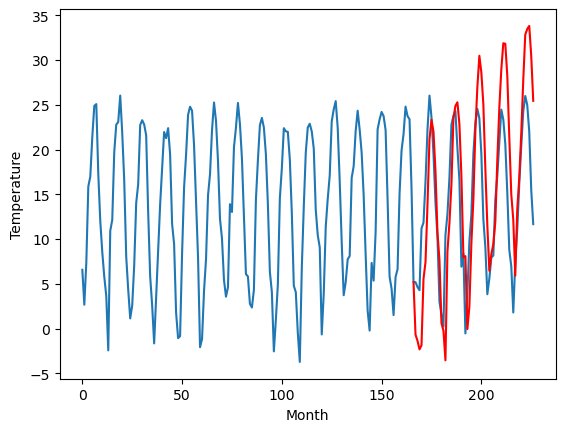

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.31		-1.75		-5.06
0.05		-2.45		-2.50
-2.82		-3.40		-0.58
-1.67		-2.94		-1.27
5.74		4.48		-1.26
8.77		6.33		-2.44
14.84		12.72		-2.12
21.89		20.07		-1.82
23.35		22.25		-1.10
20.79		20.94		0.15
16.72		16.54		-0.18
8.99		9.64		0.65
6.17		6.59		0.42
-1.00		-0.47		0.53
-2.47		-1.32		1.15
-6.34		-4.62		1.72
6.74		7.52		0.78
10.03		10.72		0.69
14.60		15.02		0.42
22.08		22.39		0.31
22.08		23.81		1.73
22.20		24.20		2.00
18.84		21.77		2.93
13.42		15.98		2.56
3.68		6.87		3.19
3.32		7.02		3.70
-6.15		-1.13		5.02
-3.63		1.40		5.03
4.83		8.45		3.62
8.96		13.36		4.40
16.53		21.02		4.49
21.98		25.92		3.94
23.10		29.40		6.30
21.28		27.53		6.25
16.96		23.96		7.00
9.69		16.78		7.09
3.80		10.43		6.63
-2.17		5.38		7.55
-0.45		7.21		7.66
6.07		8.38		2.31
3.11		10.85		7.74
10.32		17.77		7.45
16.32		23.58		7.26
20.42		27.88		7.46
22.12		30.79		8.67
20.83		30.74		9.91
17.47		27.16		9.69
11.01		20.31		9.30
4.06		13.9

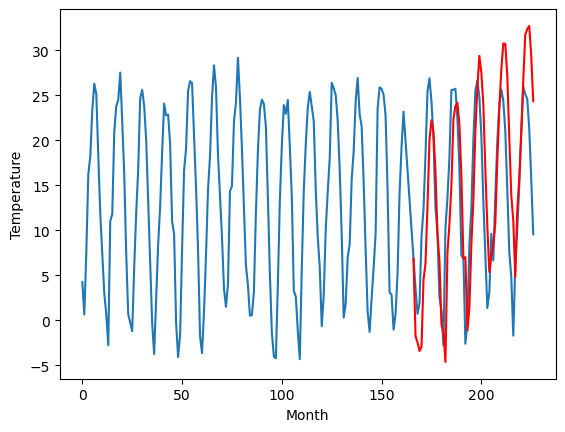

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-5.82		-4.07		1.75
-5.61		-4.77		0.84
-7.03		-5.72		1.31
-7.44		-5.26		2.18
-0.58		2.16		2.74
1.69		4.01		2.32
7.10		10.40		3.30
14.09		17.75		3.66
15.98		19.93		3.95
13.47		18.62		5.15
9.84		14.22		4.38
3.84		7.32		3.48
-0.10		4.27		4.37
-7.71		-2.79		4.92
-9.16		-3.64		5.52
-11.88		-6.94		4.94
-0.55		5.20		5.75
2.90		8.40		5.50
7.18		12.70		5.52
13.89		20.07		6.18
14.27		21.49		7.22
14.59		21.88		7.29
11.33		19.45		8.12
6.75		13.66		6.91
-4.10		4.55		8.65
-3.05		4.70		7.75
-11.87		-3.45		8.42
-8.68		-0.92		7.76
-1.72		6.13		7.85
2.13		11.04		8.91
9.93		18.70		8.77
13.87		23.60		9.73
15.86		27.08		11.22
14.21		25.21		11.00
10.26		21.64		11.38
4.22		14.46		10.24
-2.33		8.11		10.44
-7.87		3.06		10.93
-5.73		4.89		10.62
-4.01		6.06		10.07
-3.11		8.53		11.64
3.12		15.45		12.33
8.53		21.26		12.73
11.99		25.56		13.57
15.25		28.47		13.22
13.70		28.42		14.72
10.24		24.84		14.60
4.59		17.99		13.40
-1

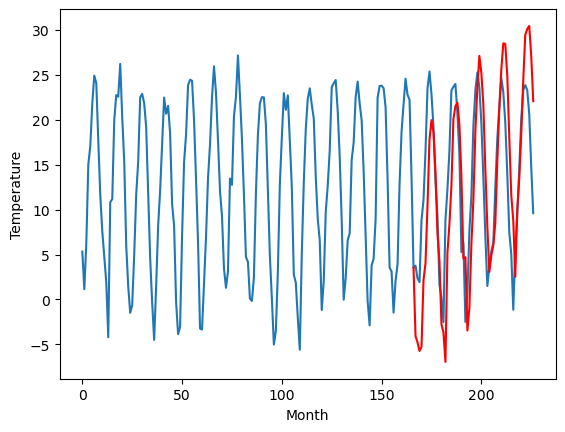

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-6.46		-2.99		3.47
-12.13		-3.69		8.44
-12.22		-4.64		7.58
-12.03		-4.18		7.85
-7.10		3.24		10.34
-4.12		5.09		9.21
2.99		11.48		8.49
7.20		18.83		11.63
9.19		21.01		11.82
9.94		19.70		9.76
4.44		15.30		10.86
0.70		8.40		7.70
-6.49		5.35		11.84
-12.19		-1.71		10.48
-11.92		-2.56		9.36
-11.82		-5.86		5.96
-8.85		6.28		15.13
-4.07		9.48		13.55
0.98		13.78		12.80
8.37		21.15		12.78
10.21		22.57		12.36
8.29		22.96		14.67
6.42		20.53		14.11
-1.55		14.74		16.29
-4.29		5.63		9.92
-9.05		5.78		14.83
-11.34		-2.37		8.97
-13.06		0.16		13.22
-8.52		7.21		15.73
-4.20		12.12		16.32
1.71		19.78		18.07
7.48		24.68		17.20
9.40		28.16		18.76
8.64		26.29		17.65
6.48		22.72		16.24
-1.78		15.54		17.32
-9.46		9.19		18.65
-11.63		4.14		15.77
-12.36		5.97		18.33
-12.33		7.14		19.47
-10.54		9.61		20.15
-5.20		16.53		21.73
2.01		22.34		20.33
6.59		26.64		20.05
12.73		29.55		16.82
10.14		29.50		19.36
5.99		25.92		19.9

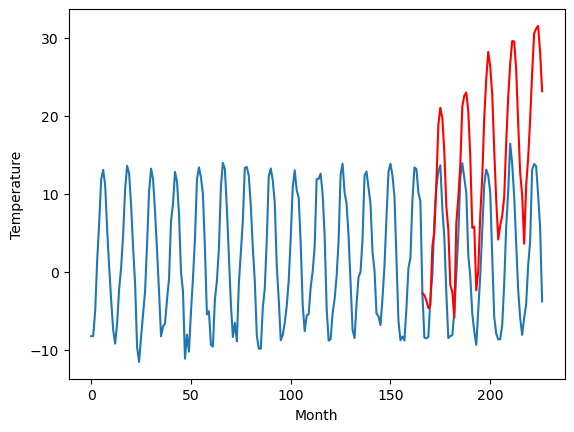

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-13.16		-16.56		-3.40
-17.89		-17.26		0.63
-16.73		-18.21		-1.48
-15.22		-17.75		-2.53
-12.11		-10.33		1.78
-6.20		-8.48		-2.28
1.07		-2.09		-3.16
4.53		5.26		0.73
8.76		7.44		-1.32
8.87		6.13		-2.74
4.06		1.73		-2.33
-2.88		-5.17		-2.29
-11.69		-8.22		3.47
-17.38		-15.28		2.10
-16.83		-16.13		0.70
-13.98		-19.43		-5.45
-12.38		-7.29		5.09
-4.41		-4.09		0.32
0.02		0.21		0.19
7.66		7.58		-0.08
8.74		9.00		0.26
7.51		9.39		1.88
3.54		6.96		3.42
-6.81		1.17		7.98
-9.33		-7.94		1.39
-16.60		-7.79		8.81
-16.67		-15.94		0.73
-14.63		-13.41		1.22
-9.92		-6.36		3.56
-5.29		-1.45		3.84
-0.62		6.21		6.83
5.86		11.11		5.25
8.09		14.59		6.50
6.50		12.72		6.22
4.14		9.15		5.01
-3.75		1.97		5.72
-15.17		-4.38		10.79
-17.50		-9.43		8.07
-18.01		-7.60		10.41
-17.10		-6.43		10.67
-14.27		-3.96		10.31
-6.32		2.96		9.28
-0.52		8.77		9.29
1.98		13.07		11.09
10.34		15.98		5.64
5.71		15.93		10.22
1.01		12.35		11.3

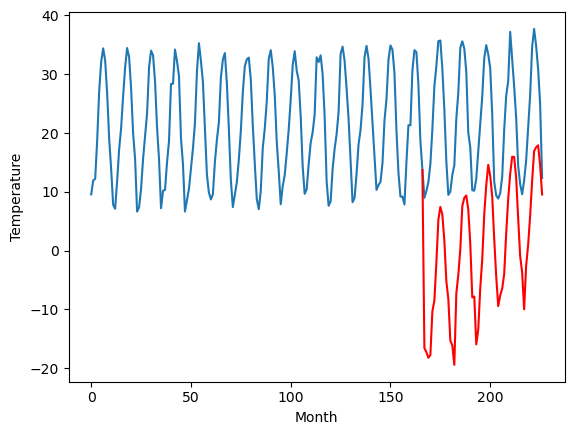

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.28		1.25		-4.03
4.03		0.55		-3.48
3.40		-0.40		-3.80
5.42		0.06		-5.36
4.86		7.48		2.62
8.48		9.33		0.85
10.88		15.72		4.84
13.42		23.07		9.65
12.61		25.25		12.64
14.49		23.94		9.45
13.91		19.54		5.63
11.69		12.64		0.95
4.53		9.59		5.06
2.48		2.53		0.05
3.70		1.68		-2.02
4.63		-1.62		-6.25
4.41		10.52		6.11
6.60		13.72		7.12
10.89		18.02		7.13
12.59		25.39		12.80
11.77		26.81		15.04
12.32		27.20		14.88
11.77		24.77		13.00
9.01		18.98		9.97
6.19		9.87		3.68
2.49		10.02		7.53
3.11		1.87		-1.24
4.07		4.40		0.33
6.30		11.45		5.15
7.74		16.36		8.62
10.73		24.02		13.29
13.88		28.92		15.04
12.23		32.40		20.17
13.65		30.53		16.88
13.88		26.96		13.08
9.15		19.78		10.63
3.42		13.43		10.01
2.22		8.38		6.16
3.89		10.21		6.32
2.09		11.38		9.29
3.55		13.85		10.30
7.63		20.77		13.14
8.66		26.58		17.92
10.56		30.88		20.32
13.57		33.79		20.22
14.60		33.74		19.14
11.99		30.16		18.17
10.53		23.31		12.78
6.49	

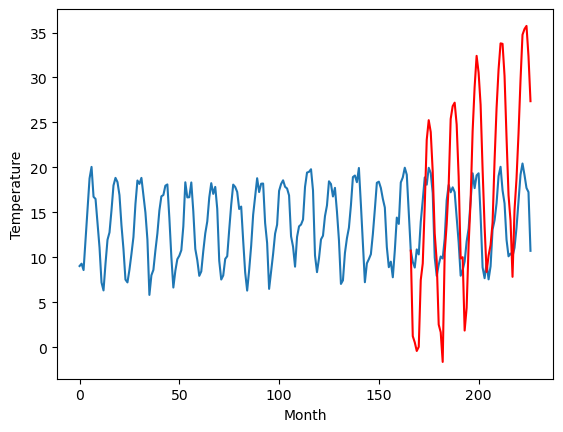

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.63		0.72		0.09
-2.13		0.02		2.15
-2.10		-0.93		1.17
-1.66		-0.47		1.19
1.92		6.95		5.03
3.36		8.80		5.44
8.92		15.19		6.27
15.90		22.54		6.64
19.85		24.72		4.87
18.67		23.41		4.74
14.33		19.01		4.68
9.01		12.11		3.10
4.94		9.06		4.12
-1.40		2.00		3.40
-4.42		1.15		5.57
-4.54		-2.15		2.39
0.46		9.99		9.53
5.08		13.19		8.11
9.91		17.49		7.58
15.78		24.86		9.08
17.92		26.28		8.36
18.54		26.67		8.13
15.22		24.24		9.02
10.78		18.45		7.67
1.86		9.34		7.48
0.26		9.49		9.23
-6.29		1.34		7.63
-3.53		3.87		7.40
0.43		10.92		10.49
4.72		15.83		11.11
10.51		23.49		12.98
14.83		28.39		13.56
19.38		31.87		12.49
19.30		30.00		10.70
14.39		26.43		12.04
8.13		19.25		11.12
4.17		12.90		8.73
-2.19		7.85		10.04
-0.21		9.68		9.89
-1.94		10.85		12.79
0.03		13.32		13.29
6.08		20.24		14.16
9.72		26.05		16.33
13.71		30.35		16.64
19.39		33.26		13.87
17.14		33.21		16.07
14.57		29.63		15.06
9.14		22.78		13.64
1.29		1

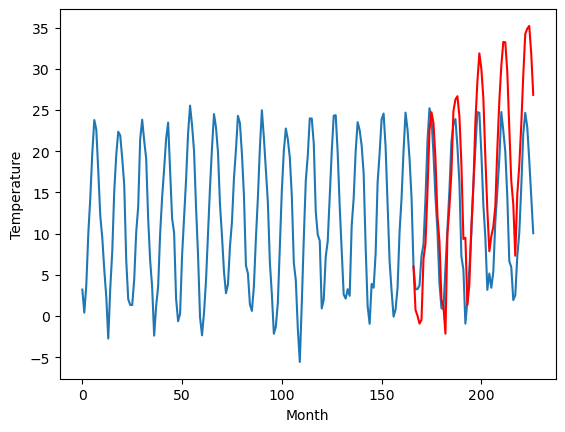

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-6.46		-5.12		1.34
-9.42		-5.82		3.60
-9.01		-6.77		2.24
-8.09		-6.31		1.78
-3.68		1.11		4.79
-1.74		2.96		4.70
4.03		9.35		5.32
10.75		16.70		5.95
14.52		18.88		4.36
12.65		17.57		4.92
7.68		13.17		5.49
2.19		6.27		4.08
-2.09		3.22		5.31
-8.91		-3.84		5.07
-10.47		-4.69		5.78
-11.27		-7.99		3.28
-4.08		4.15		8.23
0.79		7.35		6.56
5.05		11.65		6.60
11.22		19.02		7.80
12.86		20.44		7.58
12.59		20.83		8.24
8.33		18.40		10.07
4.21		12.61		8.40
-6.01		3.50		9.51
-6.42		3.65		10.07
-13.40		-4.50		8.90
-9.59		-1.97		7.62
-4.41		5.08		9.49
-0.59		9.99		10.58
6.19		17.65		11.46
10.18		22.55		12.37
13.96		26.03		12.07
13.09		24.16		11.07
7.86		20.59		12.73
0.25		13.41		13.16
-2.87		7.06		9.93
-9.90		2.01		11.91
-7.25		3.84		11.09
-7.04		5.01		12.05
-5.48		7.48		12.96
2.09		14.40		12.31
4.56		20.21		15.65
8.49		24.51		16.02
13.33		27.42		14.09
11.36		27.37		16.01
8.07		23.79		15.72
2.78		16.94		14.16


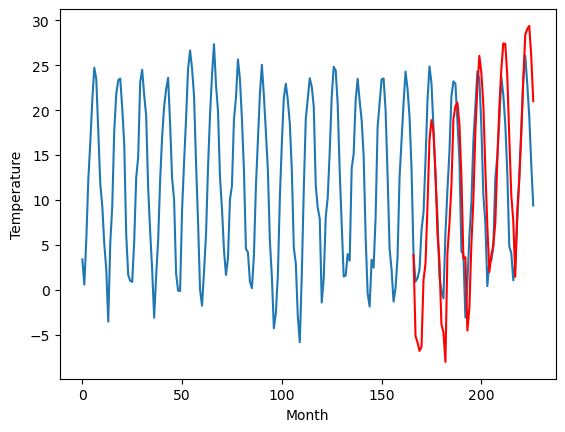

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -6.46  -5.121473
1                 1    2.22   0.578527
2                 2    2.71  -1.301473
3                 3   -2.86  -0.671473
4                 4    3.31  -1.751473
5                 5   -5.82  -4.071473
6                 6   -6.46  -2.991473
7                 7  -13.16 -16.561473
8                 8    5.28   1.248527
9                 9    0.63   0.718527
10               10   -6.46  -5.121473


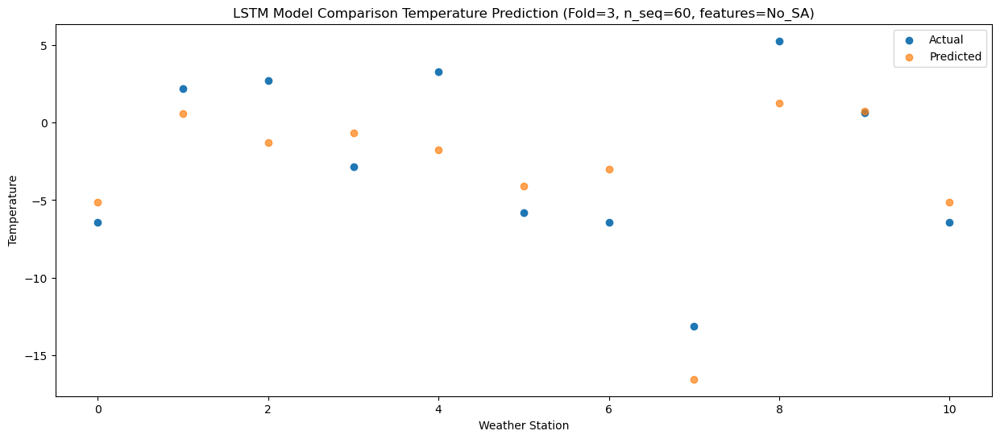

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -7.24  -5.815953
1                 1    0.87  -0.115953
2                 2    0.18  -1.995953
3                 3   -2.85  -1.365953
4                 4    0.05  -2.445953
5                 5   -5.61  -4.765953
6                 6  -12.13  -3.685953
7                 7  -17.89 -17.255953
8                 8    4.03   0.554047
9                 9   -2.13   0.024047
10               10   -9.42  -5.815953


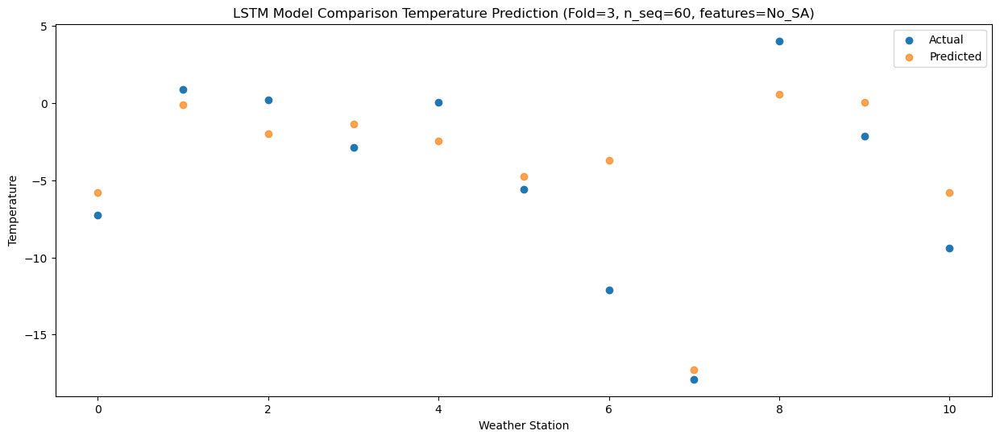

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -7.66    -6.7715
1                 1    0.03    -1.0715
2                 2   -1.04    -2.9515
3                 3   -3.40    -2.3215
4                 4   -2.82    -3.4015
5                 5   -7.03    -5.7215
6                 6  -12.22    -4.6415
7                 7  -16.73   -18.2115
8                 8    3.40    -0.4015
9                 9   -2.10    -0.9315
10               10   -9.01    -6.7715


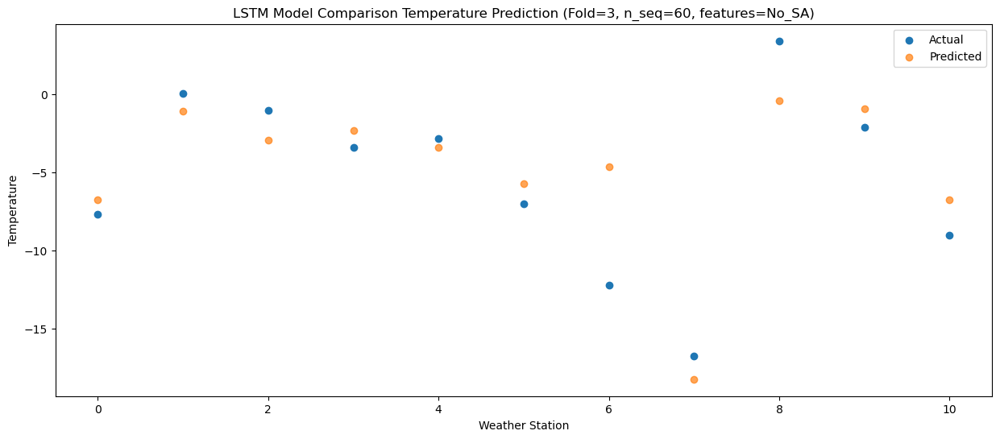

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -6.65  -6.312452
1                 1    0.18  -0.612452
2                 2    1.38  -2.492452
3                 3   -3.75  -1.862452
4                 4   -1.67  -2.942452
5                 5   -7.44  -5.262452
6                 6  -12.03  -4.182452
7                 7  -15.22 -17.752452
8                 8    5.42   0.057548
9                 9   -1.66  -0.472452
10               10   -8.09  -6.312452


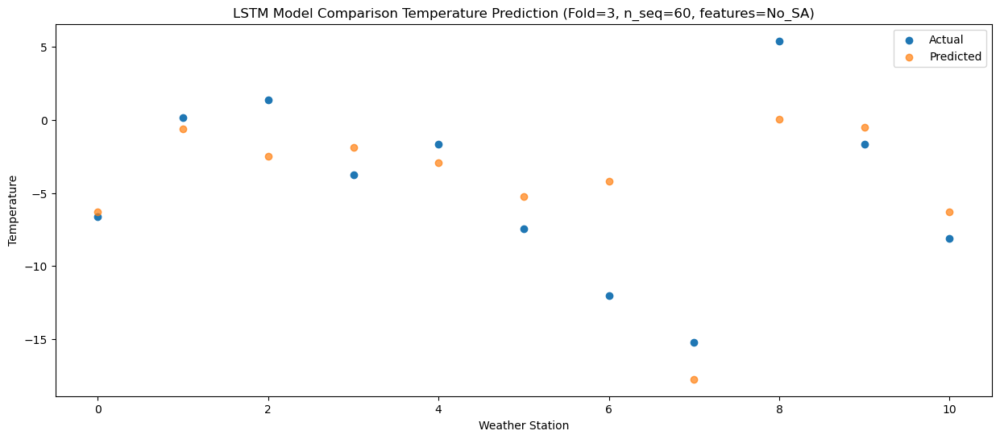

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0   -1.39   1.112837
1                 1    7.67   6.812837
2                 2    3.17   4.932837
3                 3    3.16   5.562837
4                 4    5.74   4.482837
5                 5   -0.58   2.162837
6                 6   -7.10   3.242837
7                 7  -12.11 -10.327163
8                 8    4.86   7.482837
9                 9    1.92   6.952837
10               10   -3.68   1.112837


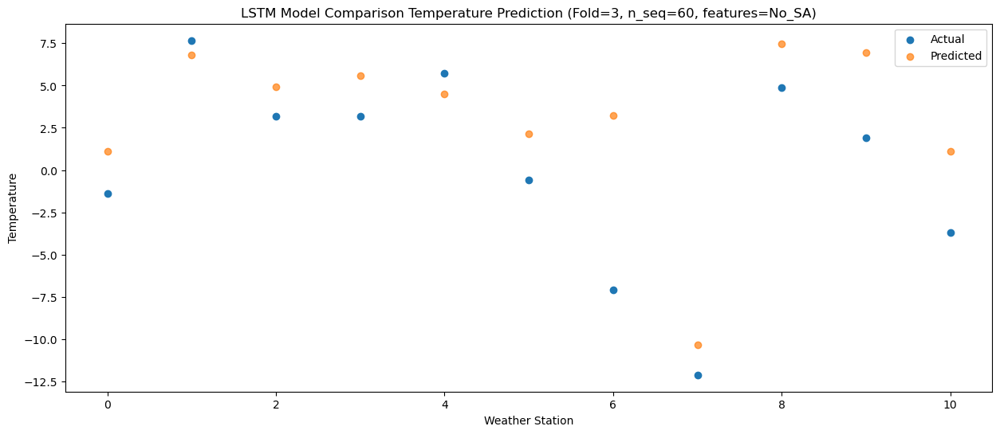

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0   -0.32   2.955977
1                 1    8.59   8.655977
2                 2    7.83   6.775977
3                 3    3.80   7.405977
4                 4    8.77   6.325977
5                 5    1.69   4.005977
6                 6   -4.12   5.085977
7                 7   -6.20  -8.484023
8                 8    8.48   9.325977
9                 9    3.36   8.795977
10               10   -1.74   2.955977


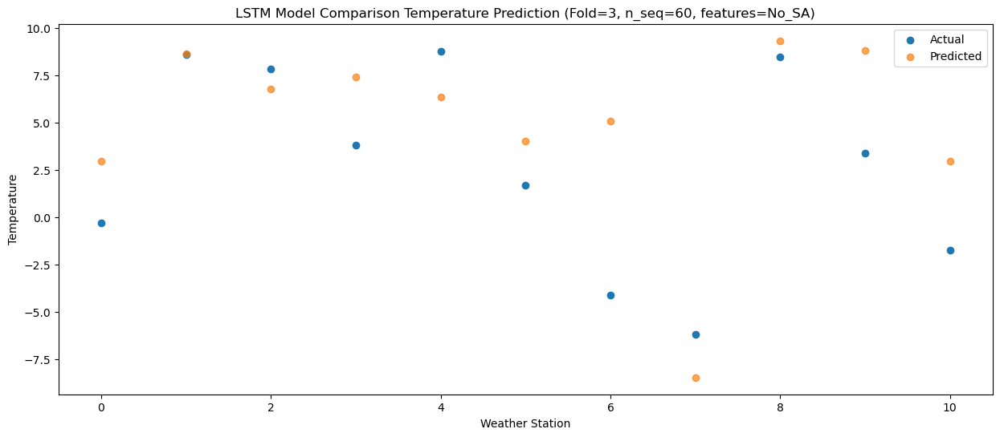

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    2.37   9.352542
1                 1   12.99  15.052542
2                 2   13.02  13.172542
3                 3    8.37  13.802542
4                 4   14.84  12.722542
5                 5    7.10  10.402542
6                 6    2.99  11.482542
7                 7    1.07  -2.087458
8                 8   10.88  15.722542
9                 9    8.92  15.192542
10               10    4.03   9.352542


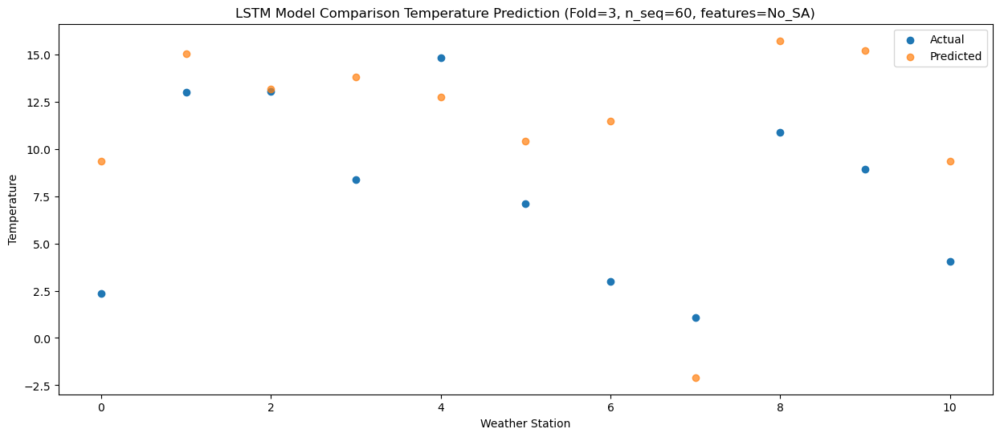

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    7.69  16.702092
1                 1   20.09  22.402092
2                 2   16.37  20.522092
3                 3   14.19  21.152092
4                 4   21.89  20.072092
5                 5   14.09  17.752092
6                 6    7.20  18.832092
7                 7    4.53   5.262092
8                 8   13.42  23.072092
9                 9   15.90  22.542092
10               10   10.75  16.702092


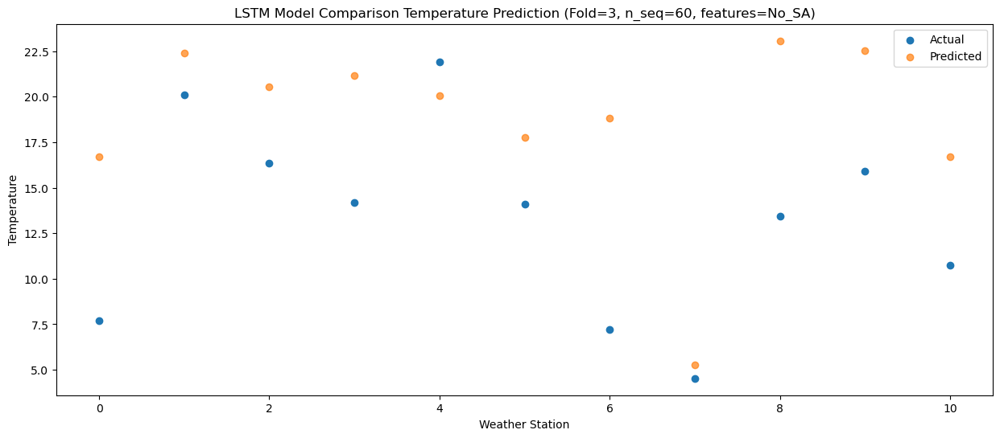

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   10.55  18.883472
1                 1   21.95  24.583472
2                 2   19.15  22.703472
3                 3   17.99  23.333472
4                 4   23.35  22.253472
5                 5   15.98  19.933472
6                 6    9.19  21.013472
7                 7    8.76   7.443472
8                 8   12.61  25.253472
9                 9   19.85  24.723472
10               10   14.52  18.883472


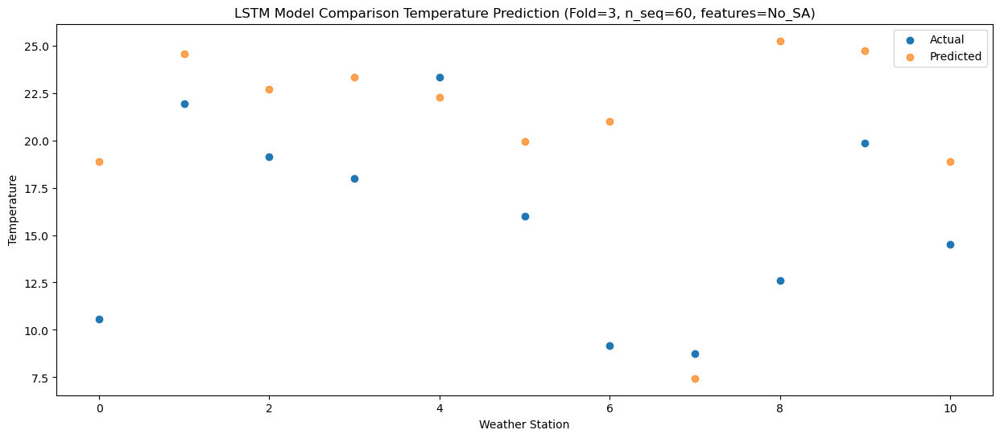

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0    9.32  17.568570
1                 1   20.09  23.268570
2                 2   19.68  21.388569
3                 3   15.57  22.018570
4                 4   20.79  20.938569
5                 5   13.47  18.618569
6                 6    9.94  19.698569
7                 7    8.87   6.128569
8                 8   14.49  23.938569
9                 9   18.67  23.408570
10               10   12.65  17.568570


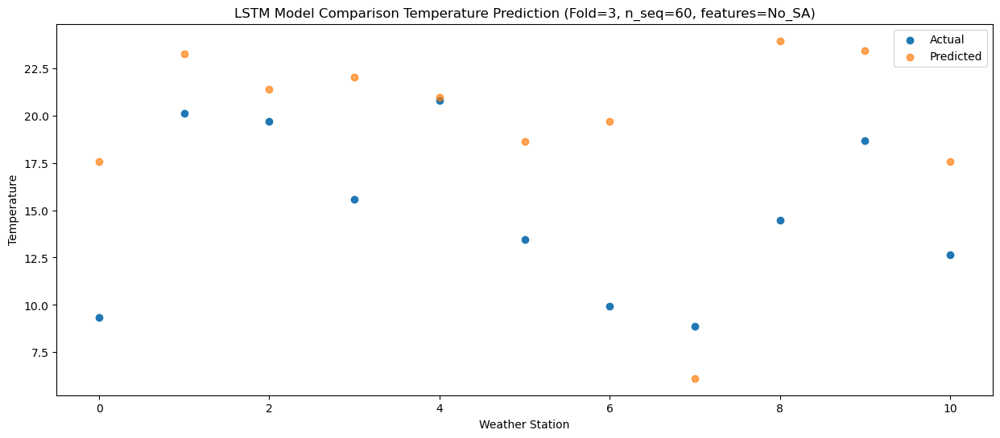

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    5.35  13.165419
1                 1   16.42  18.865419
2                 2   15.35  16.985419
3                 3   11.51  17.615419
4                 4   16.72  16.535419
5                 5    9.84  14.215419
6                 6    4.44  15.295419
7                 7    4.06   1.725419
8                 8   13.91  19.535419
9                 9   14.33  19.005419
10               10    7.68  13.165419


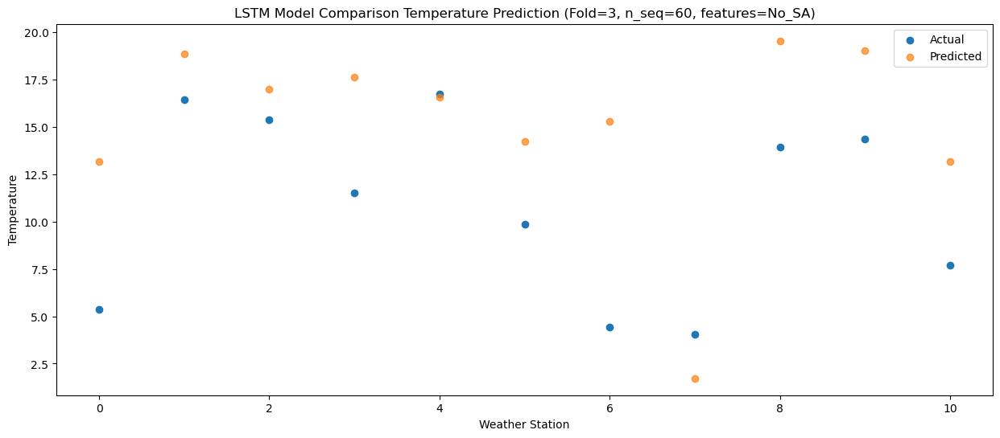

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    1.78   6.270340
1                 1    9.31  11.970340
2                 2    9.86  10.090339
3                 3    6.09  10.720340
4                 4    8.99   9.640339
5                 5    3.84   7.320339
6                 6    0.70   8.400339
7                 7   -2.88  -5.169661
8                 8   11.69  12.640339
9                 9    9.01  12.110340
10               10    2.19   6.270340


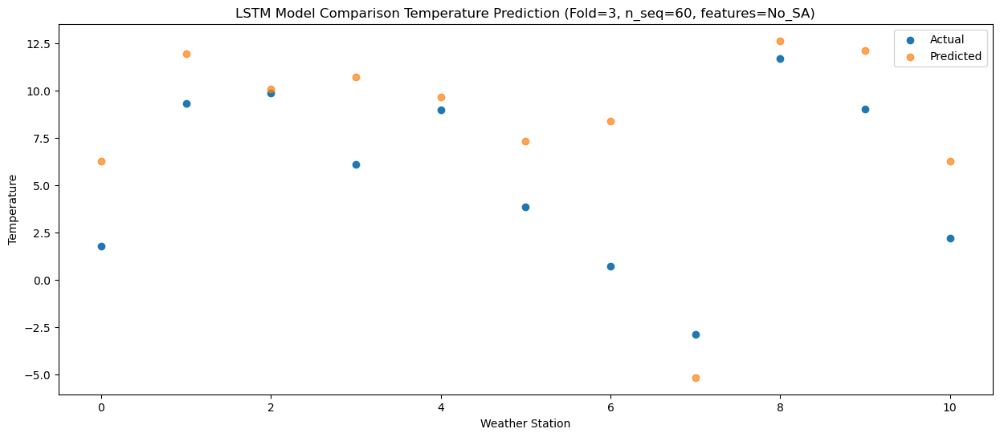

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0   -2.64   3.217691
1                 1    6.49   8.917691
2                 2    1.21   7.037690
3                 3    2.17   7.667691
4                 4    6.17   6.587689
5                 5   -0.10   4.267690
6                 6   -6.49   5.347690
7                 7  -11.69  -8.222310
8                 8    4.53   9.587690
9                 9    4.94   9.057690
10               10   -2.09   3.217690


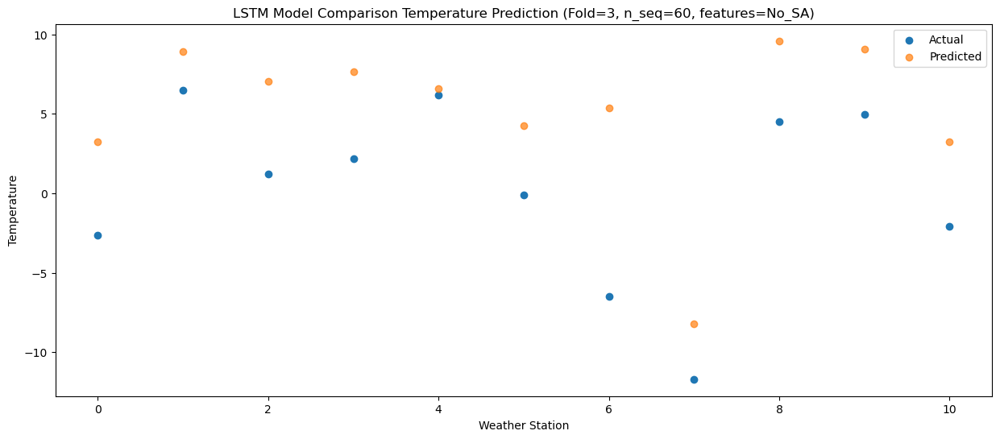

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -9.82  -3.837139
1                 1   -0.06   1.862861
2                 2   -1.99  -0.017140
3                 3   -5.03   0.612861
4                 4   -1.00  -0.467141
5                 5   -7.71  -2.787140
6                 6  -12.19  -1.707140
7                 7  -17.38 -15.277140
8                 8    2.48   2.532860
9                 9   -1.40   2.002860
10               10   -8.91  -3.837140


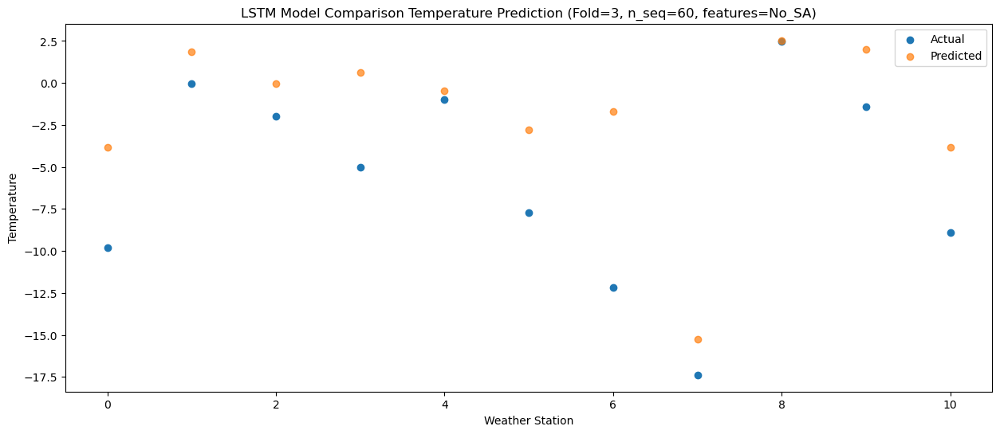

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0  -10.10  -4.689247
1                 1   -1.21   1.010753
2                 2   -0.73  -0.869247
3                 3   -6.49  -0.239247
4                 4   -2.47  -1.319248
5                 5   -9.16  -3.639247
6                 6  -11.92  -2.559247
7                 7  -16.83 -16.129247
8                 8    3.70   1.680753
9                 9   -4.42   1.150752
10               10  -10.47  -4.689248


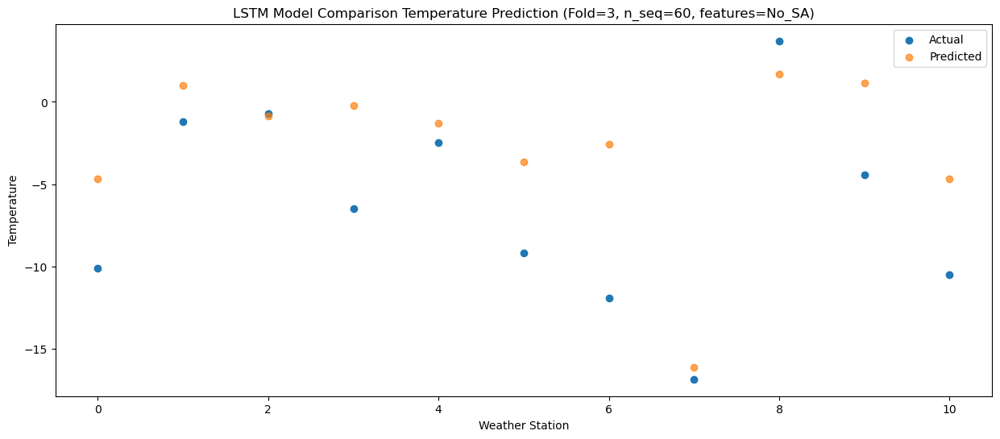

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -9.73  -7.989444
1                 1   -4.93  -2.289444
2                 2    1.57  -4.169445
3                 3   -7.81  -3.539444
4                 4   -6.34  -4.619446
5                 5  -11.88  -6.939445
6                 6  -11.82  -5.859445
7                 7  -13.98 -19.429445
8                 8    4.63  -1.619445
9                 9   -4.54  -2.149445
10               10  -11.27  -7.989445


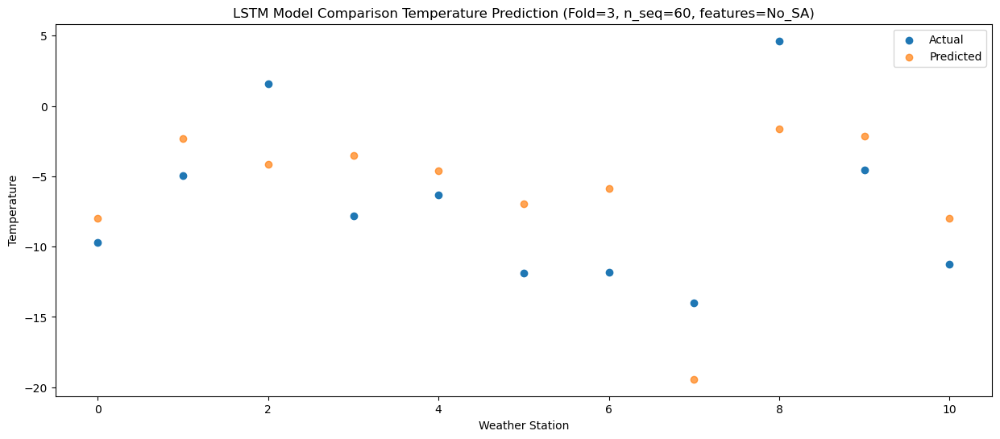

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0   -2.93   4.145971
1                 1    7.04   9.845971
2                 2    2.72   7.965970
3                 3    2.40   8.595971
4                 4    6.74   7.515969
5                 5   -0.55   5.195970
6                 6   -8.85   6.275970
7                 7  -12.38  -7.294030
8                 8    4.41  10.515970
9                 9    0.46   9.985970
10               10   -4.08   4.145970


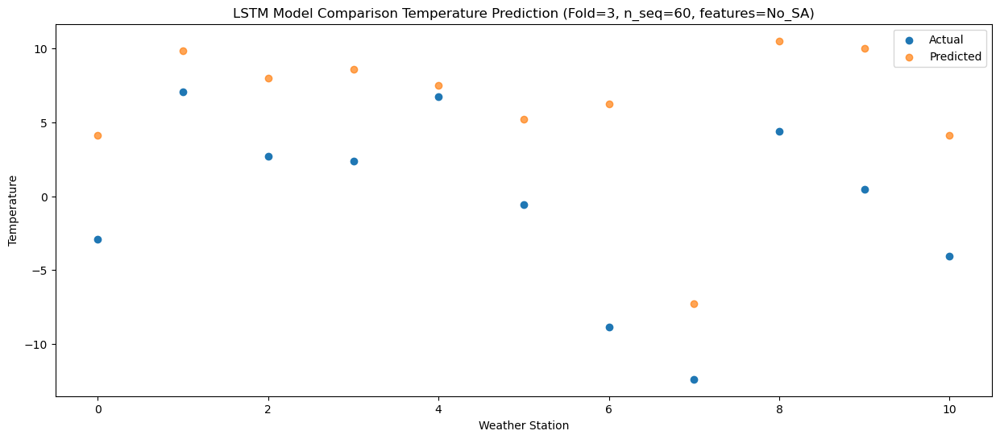

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    0.23   7.345126
1                 1    8.90  13.045126
2                 2    8.45  11.165126
3                 3    4.75  11.795126
4                 4   10.03  10.715125
5                 5    2.90   8.395126
6                 6   -4.07   9.475126
7                 7   -4.41  -4.094874
8                 8    6.60  13.715126
9                 9    5.08  13.185125
10               10    0.79   7.345125


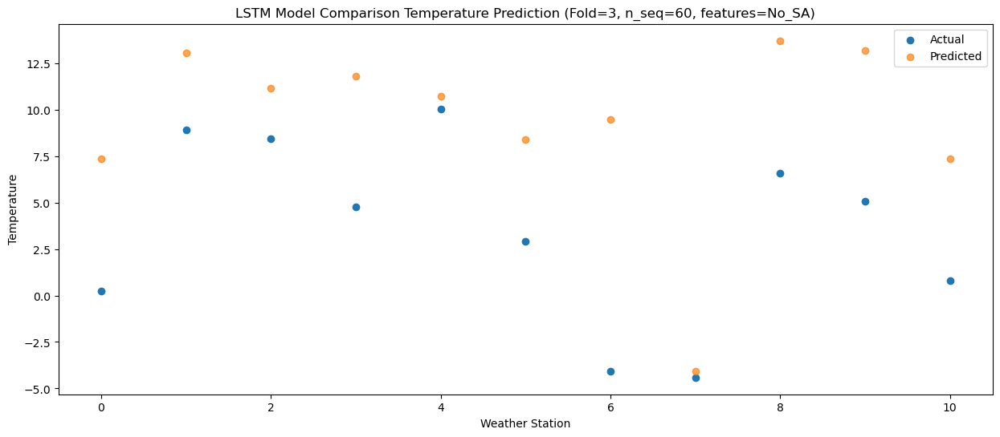

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    3.89  11.653978
1                 1   13.12  17.353978
2                 2   13.25  15.473977
3                 3    8.82  16.103978
4                 4   14.60  15.023976
5                 5    7.18  12.703977
6                 6    0.98  13.783977
7                 7    0.02   0.213977
8                 8   10.89  18.023977
9                 9    9.91  17.493977
10               10    5.05  11.653977


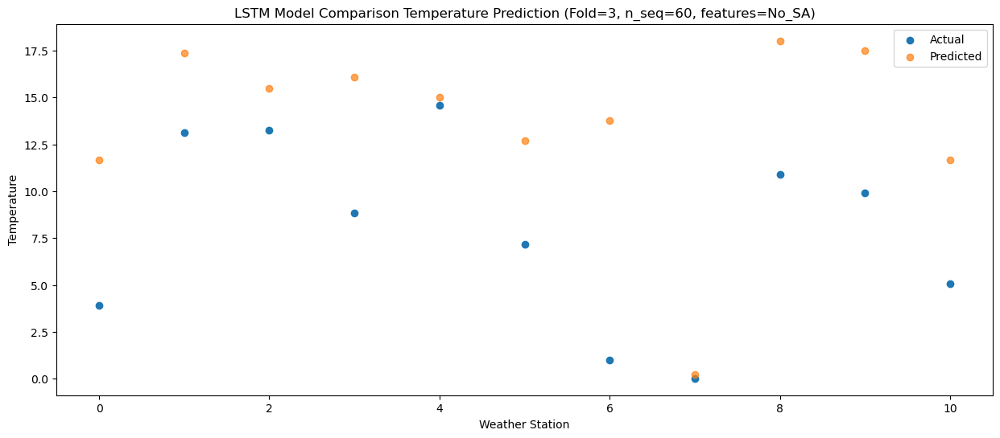

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0    7.95  19.019256
1                 1   19.83  24.719256
2                 2   18.10  22.839256
3                 3   14.74  23.469256
4                 4   22.08  22.389255
5                 5   13.89  20.069256
6                 6    8.37  21.149256
7                 7    7.66   7.579256
8                 8   12.59  25.389254
9                 9   15.78  24.859255
10               10   11.22  19.019255


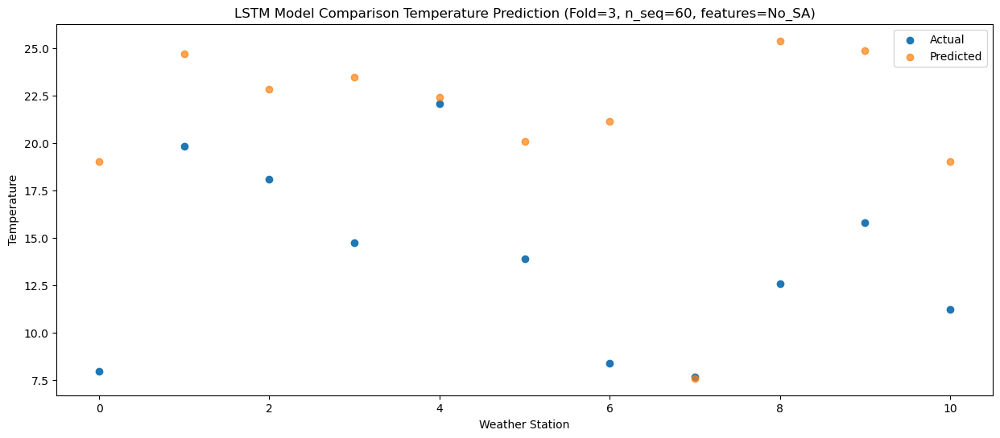

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0    9.66  20.436351
1                 1   21.14  26.136351
2                 2   21.23  24.256350
3                 3   15.73  24.886351
4                 4   22.08  23.806349
5                 5   14.27  21.486350
6                 6   10.21  22.566350
7                 7    8.74   8.996350
8                 8   11.77  26.806348
9                 9   17.92  26.276350
10               10   12.86  20.436350


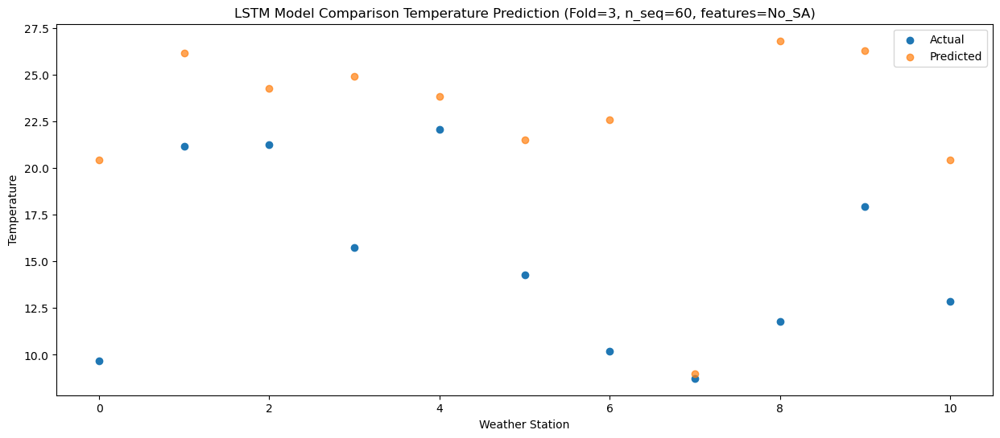

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0    9.88  20.831743
1                 1   21.71  26.531743
2                 2   19.03  24.651742
3                 3   16.25  25.281744
4                 4   22.20  24.201741
5                 5   14.59  21.881742
6                 6    8.29  22.961742
7                 7    7.51   9.391742
8                 8   12.32  27.201741
9                 9   18.54  26.671742
10               10   12.59  20.831742


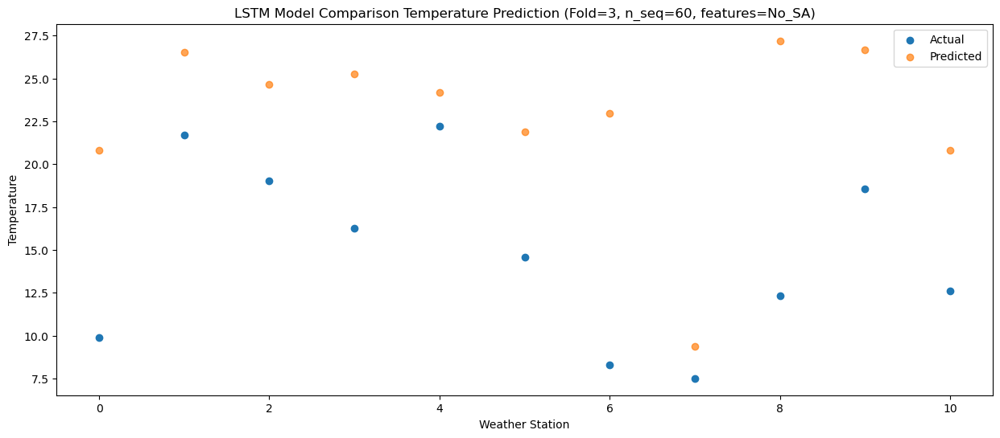

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    5.89  18.401251
1                 1   18.98  24.101251
2                 2   15.72  22.221250
3                 3   12.12  22.851252
4                 4   18.84  21.771249
5                 5   11.33  19.451250
6                 6    6.42  20.531250
7                 7    3.54   6.961250
8                 8   11.77  24.771248
9                 9   15.22  24.241250
10               10    8.33  18.401250


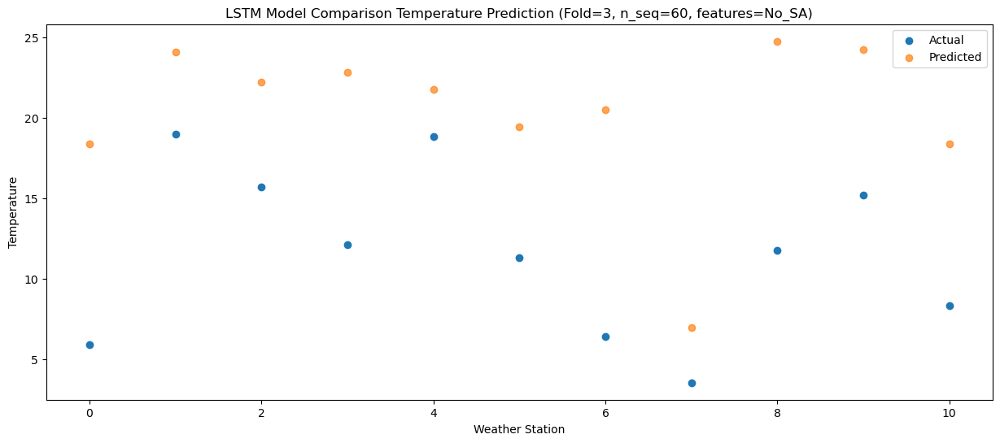

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    2.66  12.608847
1                 1   12.38  18.308847
2                 2    7.06  16.428847
3                 3    8.54  17.058848
4                 4   13.42  15.978845
5                 5    6.75  13.658846
6                 6   -1.55  14.738846
7                 7   -6.81   1.168846
8                 8    9.01  18.978844
9                 9   10.78  18.448846
10               10    4.21  12.608846


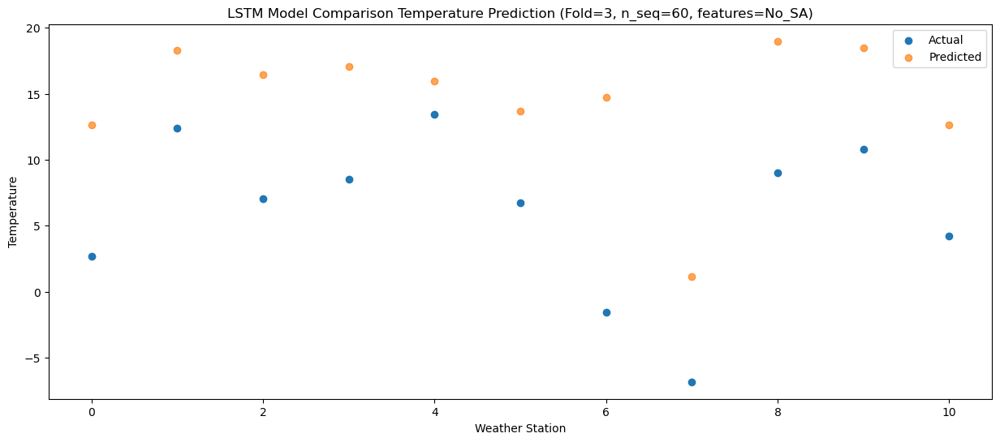

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -6.10   3.503720
1                 1    4.67   9.203720
2                 2    2.72   7.323720
3                 3   -1.12   7.953721
4                 4    3.68   6.873718
5                 5   -4.10   4.553719
6                 6   -4.29   5.633719
7                 7   -9.33  -7.936281
8                 8    6.19   9.873717
9                 9    1.86   9.343719
10               10   -6.01   3.503719


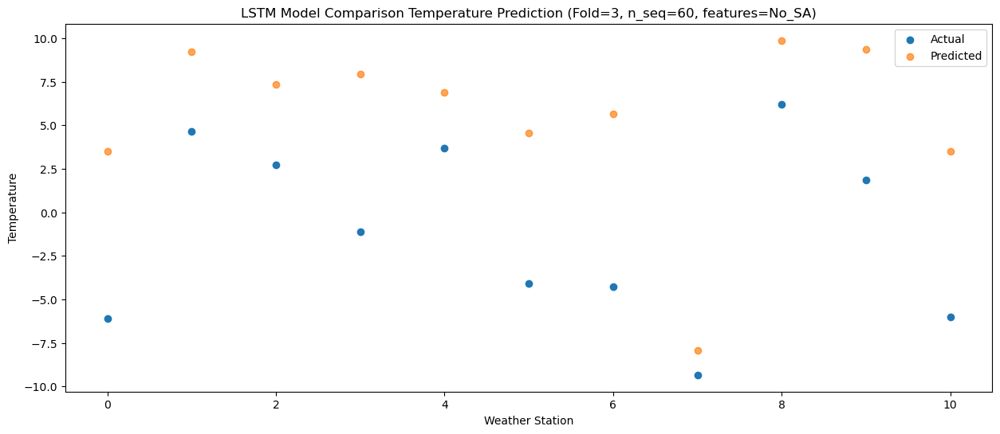

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0   -4.14   3.649223
1                 1    5.98   9.349223
2                 2   -1.20   7.469223
3                 3    0.37   8.099224
4                 4    3.32   7.019221
5                 5   -3.05   4.699222
6                 6   -9.05   5.779222
7                 7  -16.60  -7.790778
8                 8    2.49  10.019220
9                 9    0.26   9.489222
10               10   -6.42   3.649222


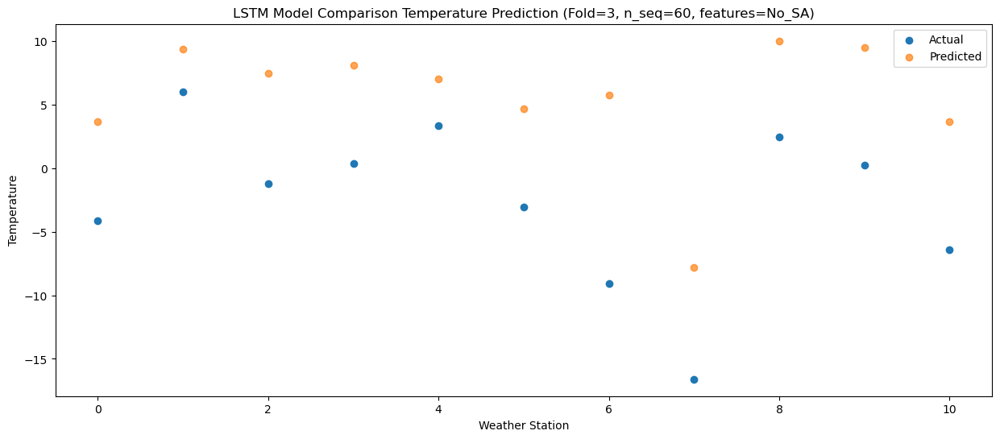

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0  -10.98  -4.501969
1                 1   -2.85   1.198031
2                 2   -1.53  -0.681969
3                 3   -8.58  -0.051969
4                 4   -6.15  -1.131971
5                 5  -11.87  -3.451970
6                 6  -11.34  -2.371970
7                 7  -16.67 -15.941969
8                 8    3.11   1.868028
9                 9   -6.29   1.338030
10               10  -13.40  -4.501970


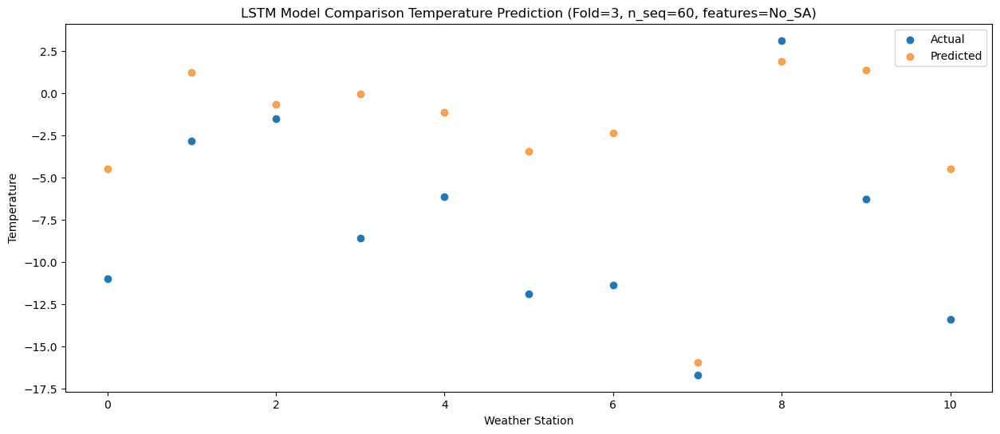

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -6.60  -1.969258
1                 1   -1.63   3.730742
2                 2    0.17   1.850742
3                 3   -4.06   2.480743
4                 4   -3.63   1.400741
5                 5   -8.68  -0.919259
6                 6  -13.06   0.160741
7                 7  -14.63 -13.409258
8                 8    4.07   4.400740
9                 9   -3.53   3.870741
10               10   -9.59  -1.969259


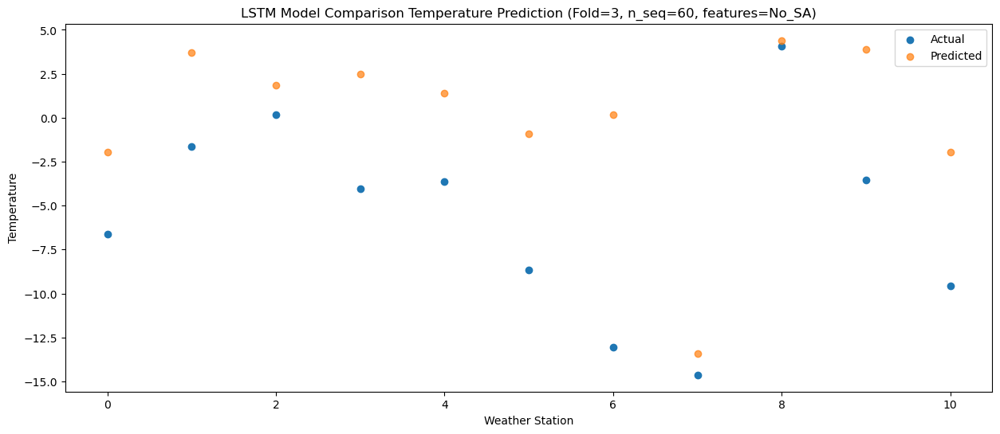

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -2.54   5.078059
1                 1    5.15  10.778059
2                 2    4.88   8.898059
3                 3    1.69   9.528060
4                 4    4.83   8.448057
5                 5   -1.72   6.128058
6                 6   -8.52   7.208058
7                 7   -9.92  -6.361941
8                 8    6.30  11.448056
9                 9    0.43  10.918058
10               10   -4.41   5.078058


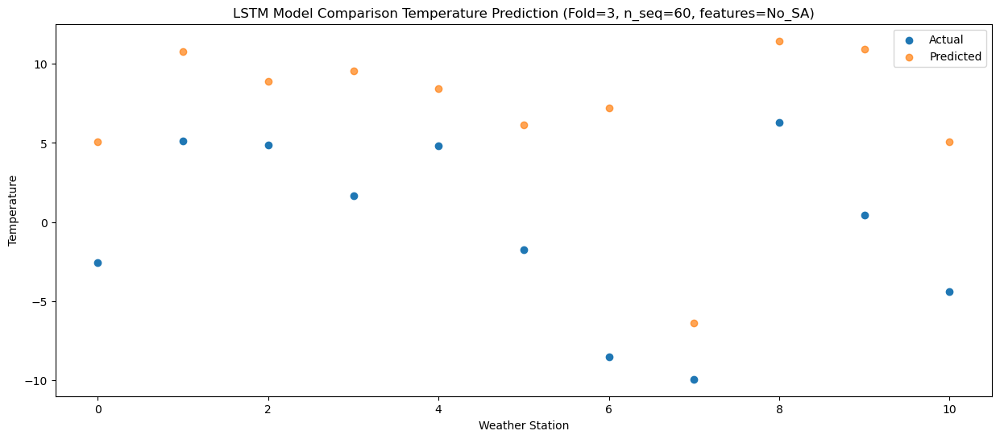

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    0.56   9.990150
1                 1   10.00  15.690150
2                 2    7.95  13.810150
3                 3    4.70  14.440151
4                 4    8.96  13.360148
5                 5    2.13  11.040149
6                 6   -4.20  12.120149
7                 7   -5.29  -1.449850
8                 8    7.74  16.360147
9                 9    4.72  15.830149
10               10   -0.59   9.990149


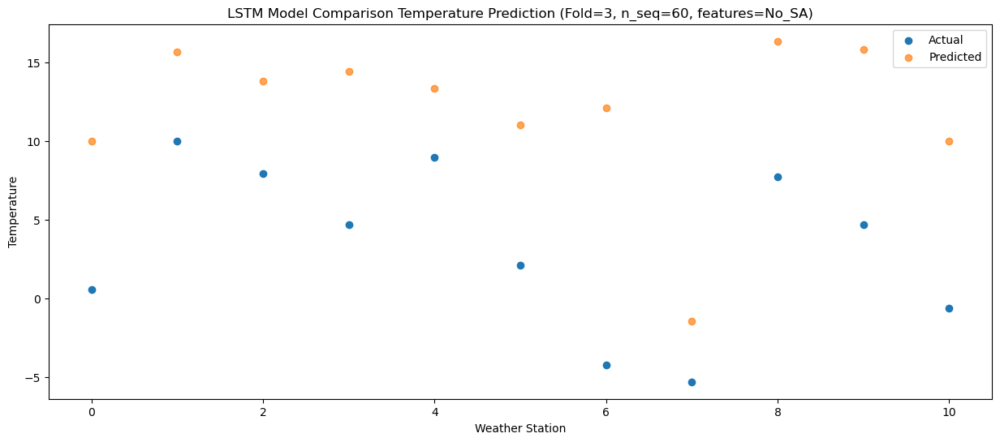

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    5.40  17.654749
1                 1   15.43  23.354749
2                 2   12.19  21.474749
3                 3   11.48  22.104750
4                 4   16.53  21.024747
5                 5    9.93  18.704748
6                 6    1.71  19.784748
7                 7   -0.62   6.214749
8                 8   10.73  24.024746
9                 9   10.51  23.494748
10               10    6.19  17.654748


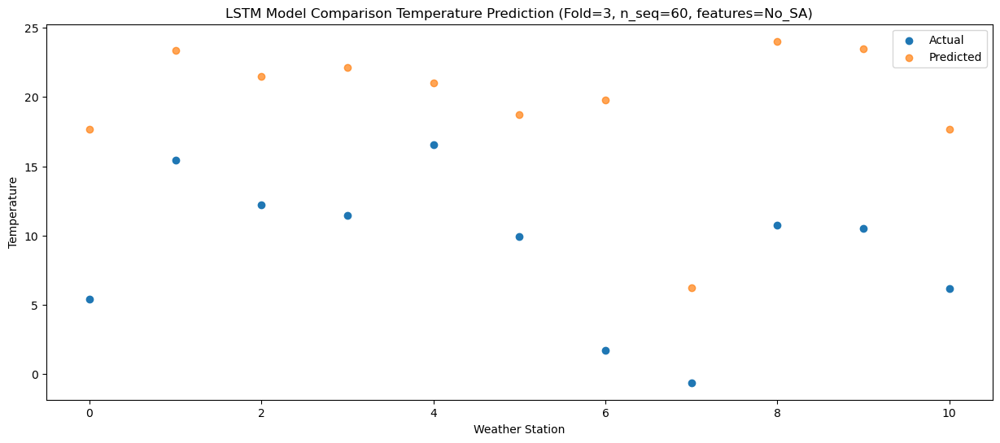

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    9.36  22.551468
1                 1   20.58  28.251468
2                 2   17.58  26.371468
3                 3   14.96  27.001468
4                 4   21.98  25.921466
5                 5   13.87  23.601467
6                 6    7.48  24.681467
7                 7    5.86  11.111468
8                 8   13.88  28.921465
9                 9   14.83  28.391467
10               10   10.18  22.551467


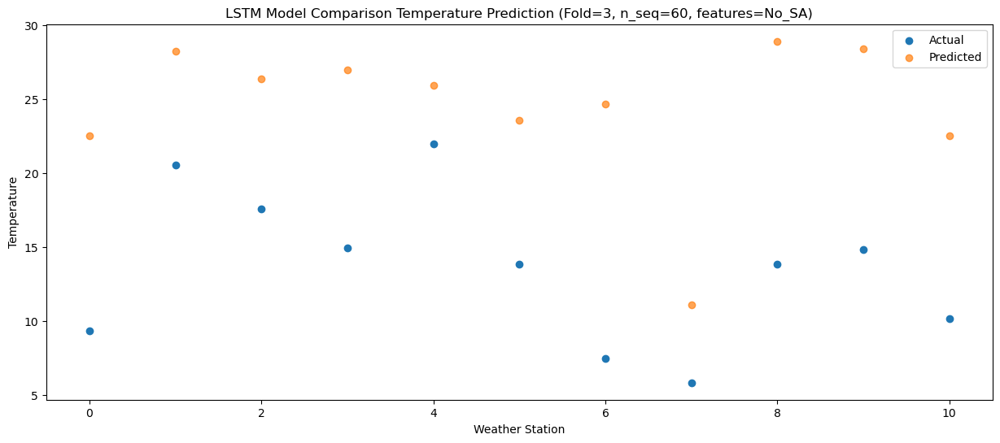

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   10.13  26.033614
1                 1   24.62  31.733614
2                 2   20.15  29.853614
3                 3   16.51  30.483615
4                 4   23.10  29.403612
5                 5   15.86  27.083613
6                 6    9.40  28.163613
7                 7    8.09  14.593614
8                 8   12.23  32.403611
9                 9   19.38  31.873613
10               10   13.96  26.033613


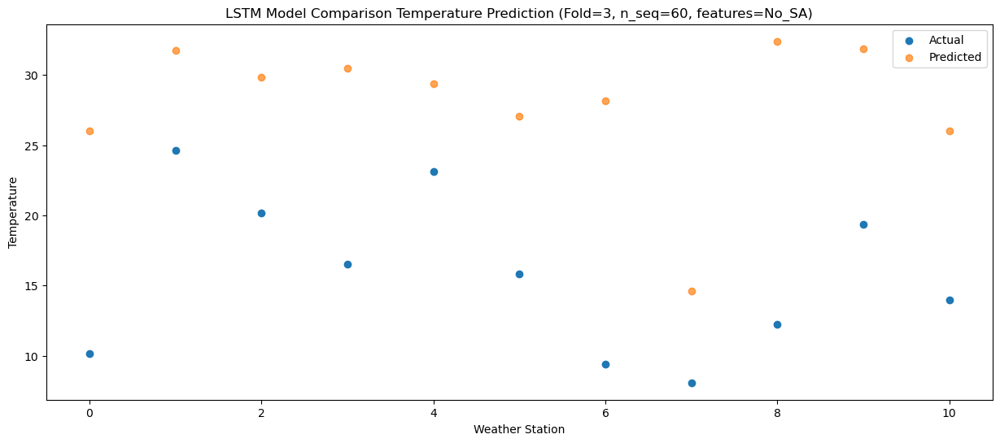

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0    9.22  24.164108
1                 1   21.54  29.864108
2                 2   20.33  27.984109
3                 3   15.44  28.614109
4                 4   21.28  27.534107
5                 5   14.21  25.214108
6                 6    8.64  26.294108
7                 7    6.50  12.724109
8                 8   13.65  30.534106
9                 9   19.30  30.004107
10               10   13.09  24.164107


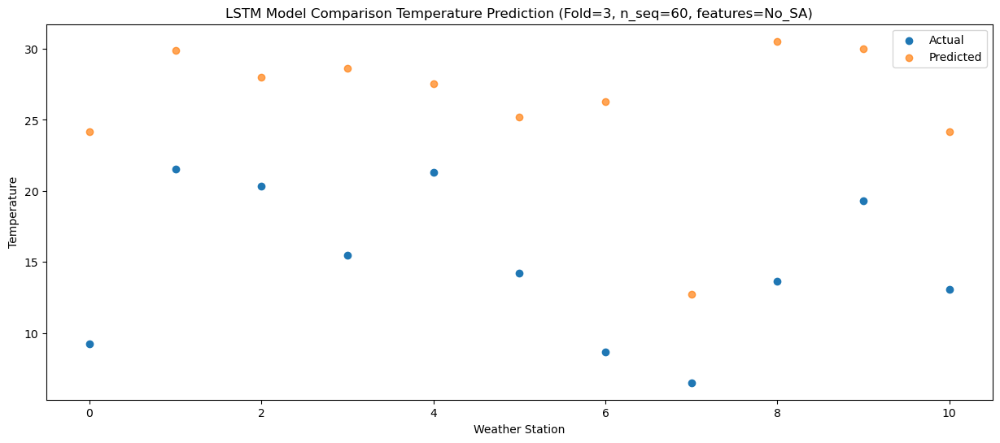

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    6.01  20.591097
1                 1   17.68  26.291097
2                 2   17.51  24.411097
3                 3   11.46  25.041098
4                 4   16.96  23.961095
5                 5   10.26  21.641096
6                 6    6.48  22.721096
7                 7    4.14   9.151097
8                 8   13.88  26.961094
9                 9   14.39  26.431096
10               10    7.86  20.591096


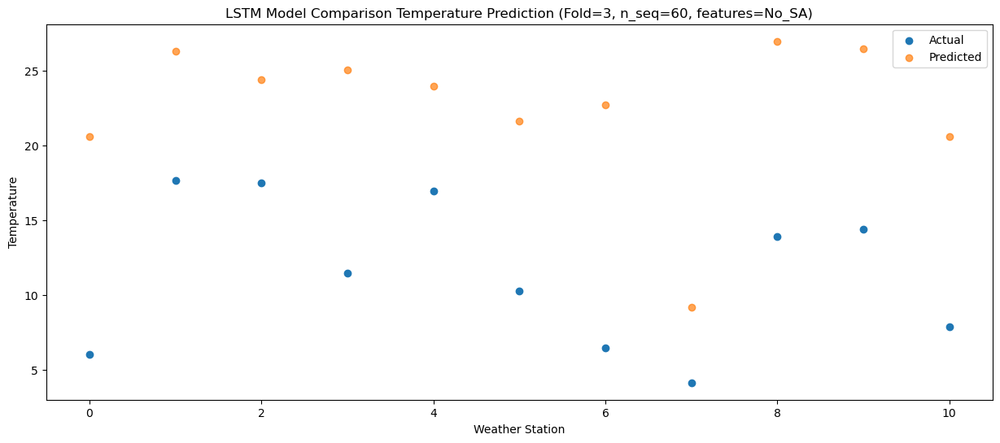

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0   -1.00  13.409449
1                 1   11.13  19.109449
2                 2   10.33  17.229449
3                 3    4.19  17.859450
4                 4    9.69  16.779448
5                 5    4.22  14.459448
6                 6   -1.78  15.539449
7                 7   -3.75   1.969450
8                 8    9.15  19.779446
9                 9    8.13  19.249449
10               10    0.25  13.409449


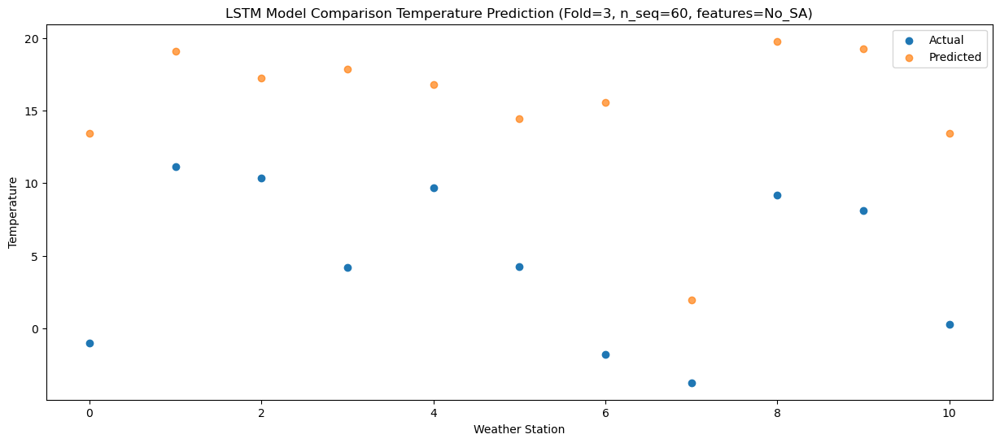

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0   -3.03   7.057122
1                 1    3.90  12.757121
2                 2   -0.40  10.877121
3                 3    1.07  11.507123
4                 4    3.80  10.427120
5                 5   -2.33   8.107120
6                 6   -9.46   9.187121
7                 7  -15.17  -4.382878
8                 8    3.42  13.427118
9                 9    4.17  12.897121
10               10   -2.87   7.057121


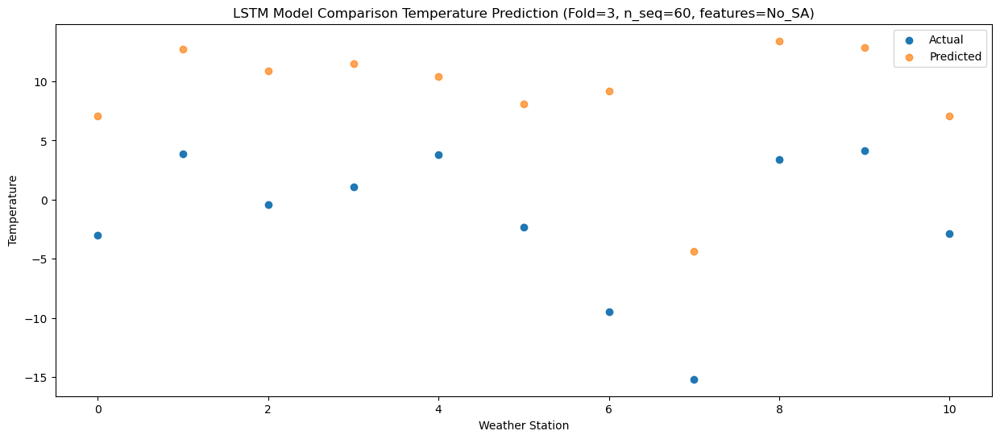

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -9.91   2.013507
1                 1   -0.15   7.713506
2                 2   -1.36   5.833506
3                 3   -4.20   6.463508
4                 4   -2.17   5.383505
5                 5   -7.87   3.063505
6                 6  -11.63   4.143506
7                 7  -17.50  -9.426493
8                 8    2.22   8.383503
9                 9   -2.19   7.853506
10               10   -9.90   2.013506


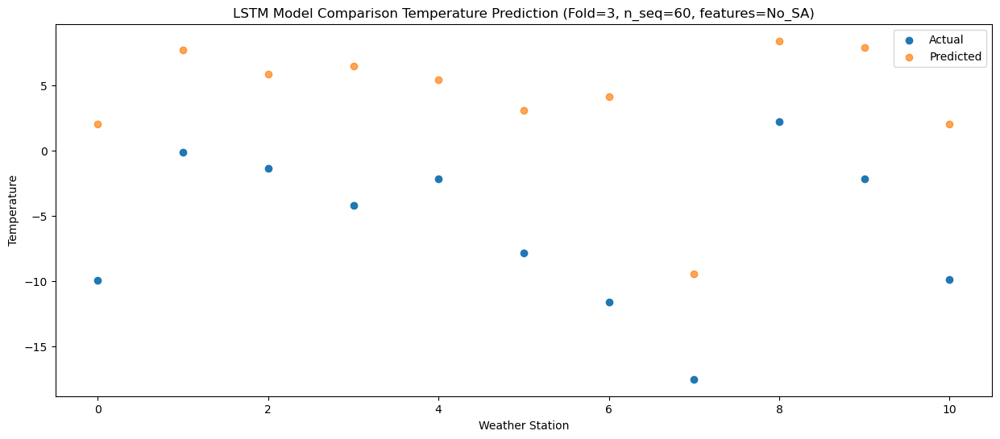

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -6.49   3.843931
1                 1    0.55   9.543930
2                 2    0.03   7.663930
3                 3   -2.45   8.293932
4                 4   -0.45   7.213929
5                 5   -5.73   4.893929
6                 6  -12.36   5.973930
7                 7  -18.01  -7.596069
8                 8    3.89  10.213928
9                 9   -0.21   9.683930
10               10   -7.25   3.843930


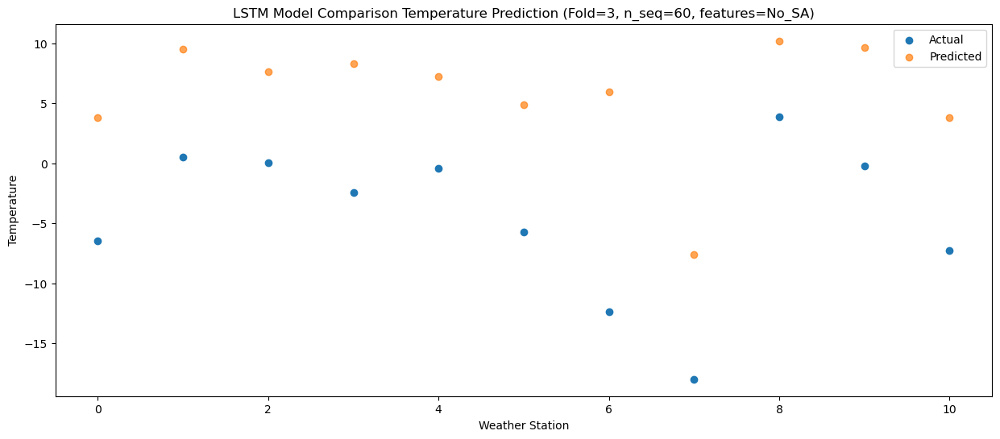

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -3.67   5.010118
1                 1    2.51  10.710117
2                 2   -0.82   8.830117
3                 3   -0.11   9.460118
4                 4    6.07   8.380116
5                 5   -4.01   6.060116
6                 6  -12.33   7.140117
7                 7  -17.10  -6.429882
8                 8    2.09  11.380114
9                 9   -1.94  10.850117
10               10   -7.04   5.010117


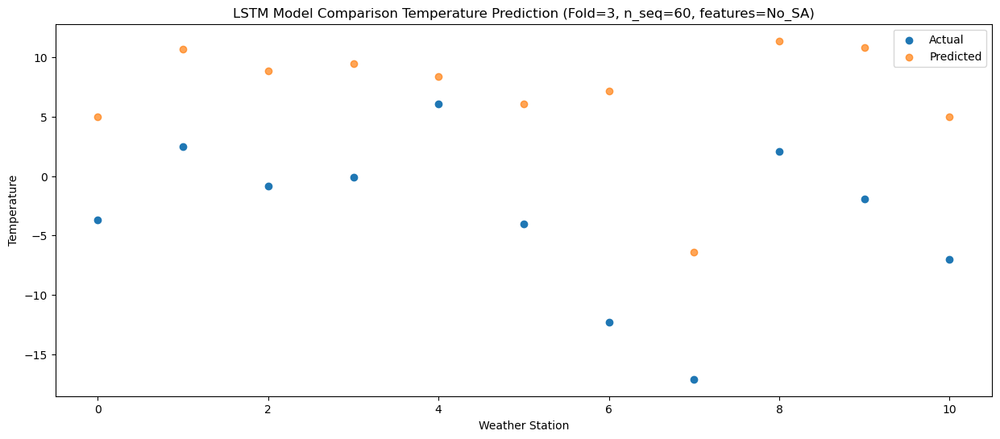

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -3.20   7.478563
1                 1    5.11  13.178562
2                 2    2.05  11.298562
3                 3    0.13  11.928564
4                 4    3.11  10.848561
5                 5   -3.11   8.528561
6                 6  -10.54   9.608562
7                 7  -14.27  -3.961437
8                 8    3.55  13.848559
9                 9    0.03  13.318562
10               10   -5.48   7.478562


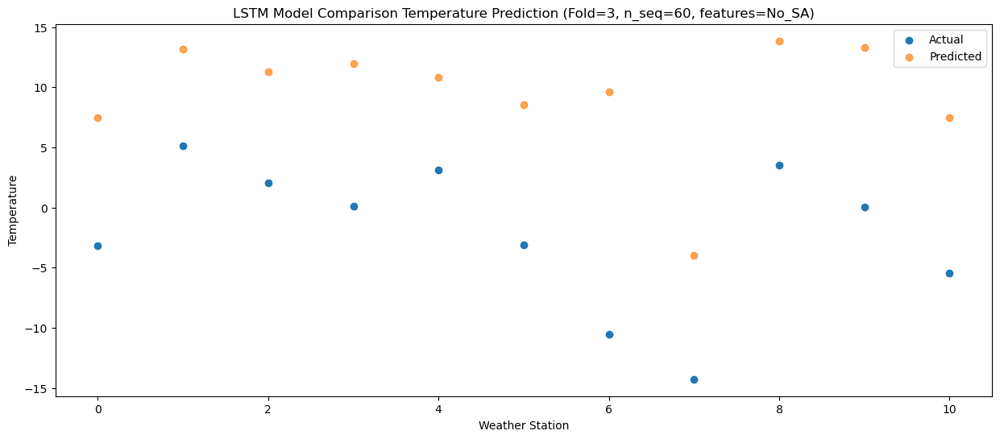

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    0.47  14.401545
1                 1   10.16  20.101544
2                 2    7.68  18.221544
3                 3    6.37  18.851546
4                 4   10.32  17.771543
5                 5    3.12  15.451543
6                 6   -5.20  16.531544
7                 7   -6.32   2.961545
8                 8    7.63  20.771541
9                 9    6.08  20.241544
10               10    2.09  14.401544


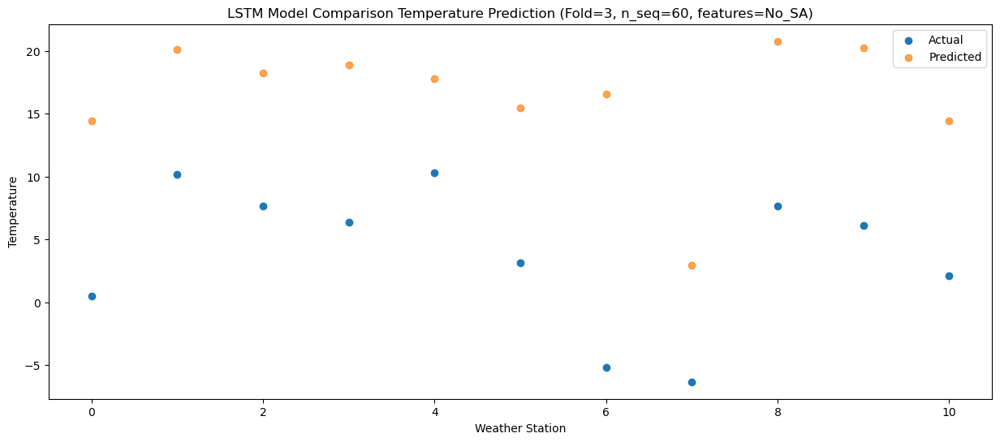

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    2.83  20.214353
1                 1   15.47  25.914352
2                 2   12.12  24.034352
3                 3    9.06  24.664354
4                 4   16.32  23.584351
5                 5    8.53  21.264351
6                 6    2.01  22.344352
7                 7   -0.52   8.774353
8                 8    8.66  26.584349
9                 9    9.72  26.054352
10               10    4.56  20.214352


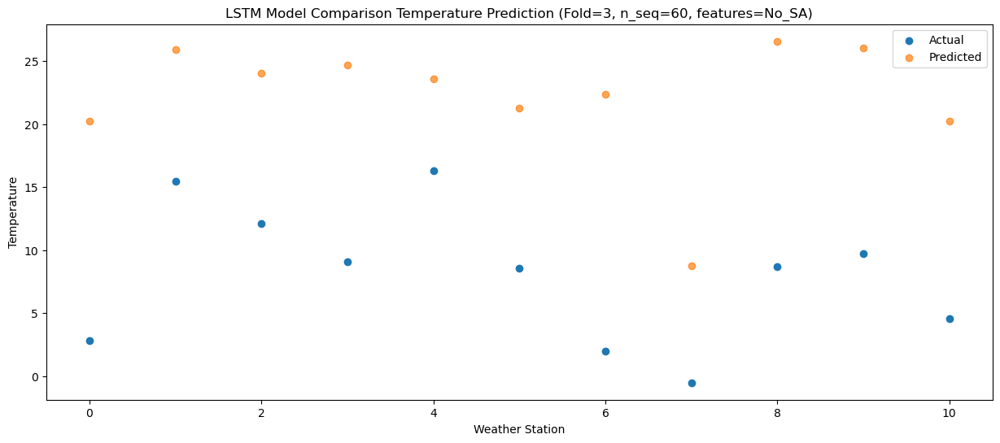

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    6.60  24.506000
1                 1   19.80  30.206001
2                 2   14.92  28.326001
3                 3   12.80  28.956002
4                 4   20.42  27.875998
5                 5   11.99  25.555998
6                 6    6.59  26.635999
7                 7    1.98  13.066000
8                 8   10.56  30.875996
9                 9   13.71  30.346001
10               10    8.49  24.506001


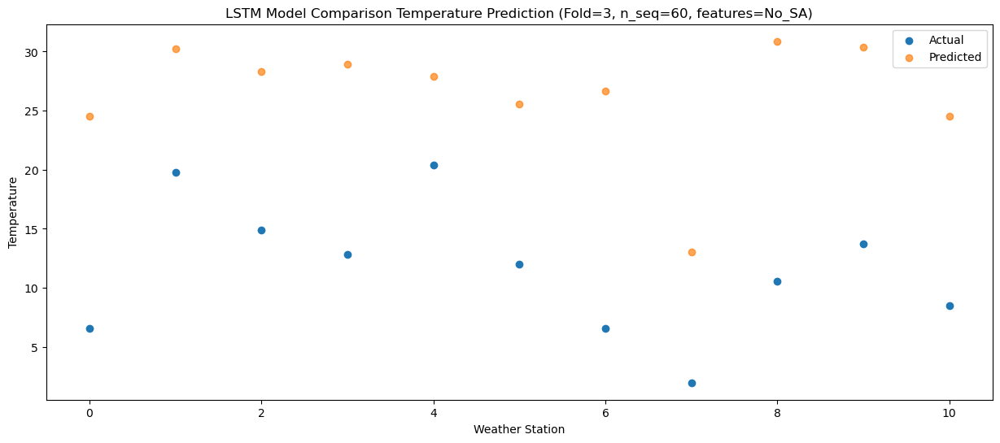

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   10.38  27.424467
1                 1   22.06  33.124468
2                 2   20.58  31.244468
3                 3   16.42  31.874470
4                 4   22.12  30.794465
5                 5   15.25  28.474465
6                 6   12.73  29.554466
7                 7   10.34  15.984467
8                 8   13.57  33.794463
9                 9   19.39  33.264468
10               10   13.33  27.424468


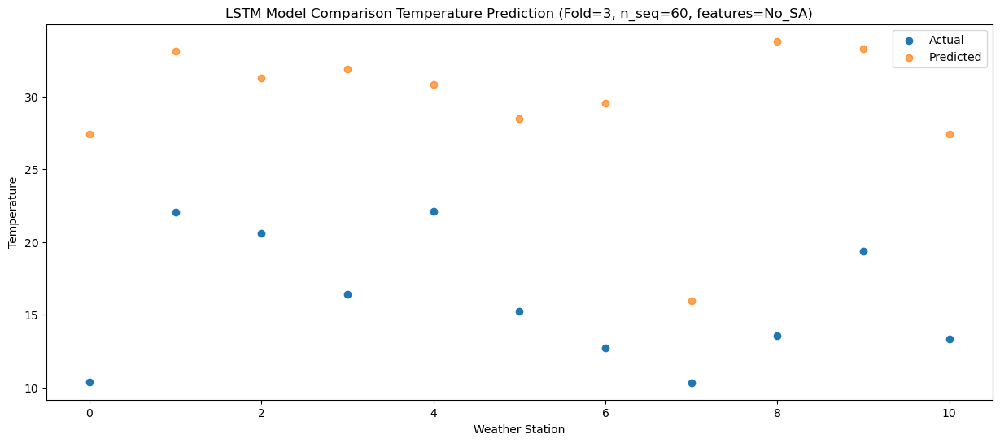

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0    9.87  27.370377
1                 1   22.24  33.070378
2                 2   18.89  31.190377
3                 3   15.31  31.820379
4                 4   20.83  30.740374
5                 5   13.70  28.420375
6                 6   10.14  29.500375
7                 7    5.71  15.930376
8                 8   14.60  33.740372
9                 9   17.14  33.210377
10               10   11.36  27.370377


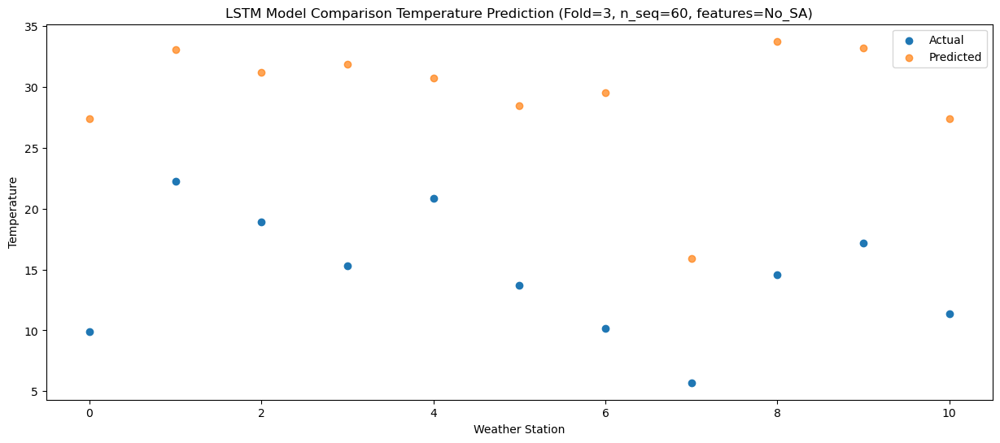

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    5.73  23.794188
1                 1   18.19  29.494190
2                 2   15.12  27.614189
3                 3   12.58  28.244191
4                 4   17.47  27.164185
5                 5   10.24  24.844186
6                 6    5.99  25.924187
7                 7    1.01  12.354188
8                 8   11.99  30.164184
9                 9   14.57  29.634188
10               10    8.07  23.794189


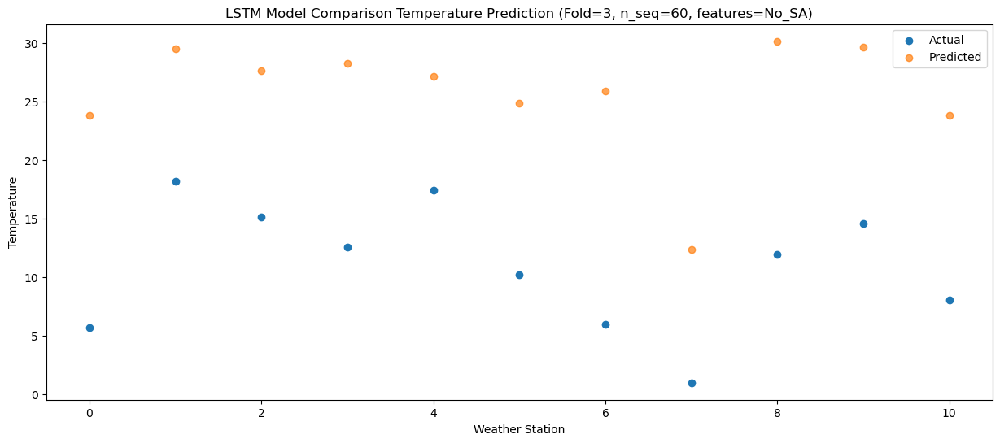

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    0.70  16.944126
1                 1   11.25  22.644127
2                 2    9.81  20.764126
3                 3    7.14  21.394128
4                 4   11.01  20.314122
5                 5    4.59  17.994124
6                 6   -0.14  19.074124
7                 7   -4.28   5.504125
8                 8   10.53  23.314121
9                 9    9.14  22.784125
10               10    2.78  16.944126


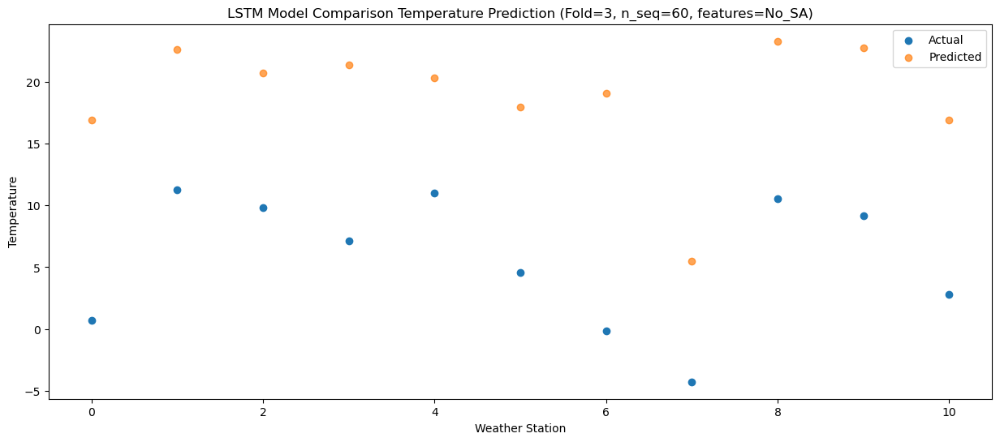

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0   -4.96  10.534459
1                 1    5.47  16.234460
2                 2    2.90  14.354459
3                 3    0.75  14.984462
4                 4    4.06  13.904455
5                 5   -1.89  11.584457
6                 6   -6.00  12.664457
7                 7  -12.42  -0.905542
8                 8    6.49  16.904454
9                 9    1.29  16.374458
10               10   -5.49  10.534459


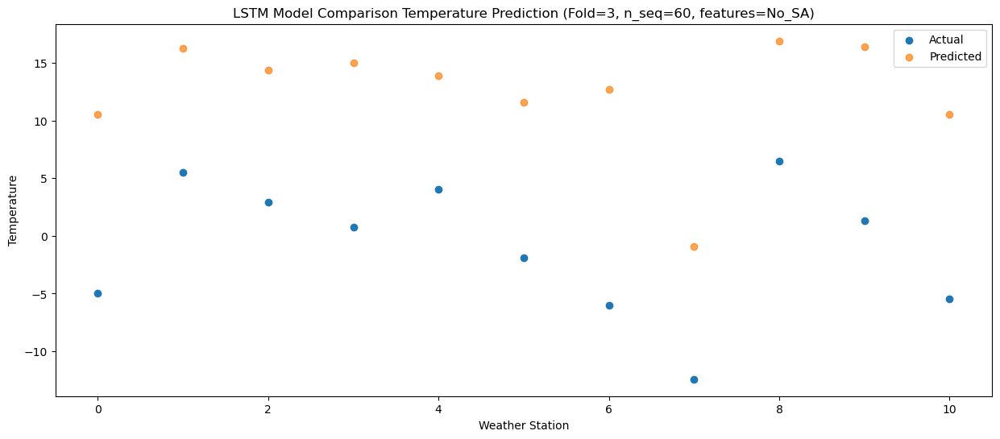

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -7.01   7.709408
1                 1    2.12  13.409409
2                 2    1.06  11.529408
3                 3   -1.08  12.159411
4                 4    1.25  11.079404
5                 5   -4.35   8.759406
6                 6   -9.63   9.839406
7                 7  -15.55  -3.730593
8                 8    4.65  14.079403
9                 9    0.56  13.549407
10               10   -6.24   7.709408


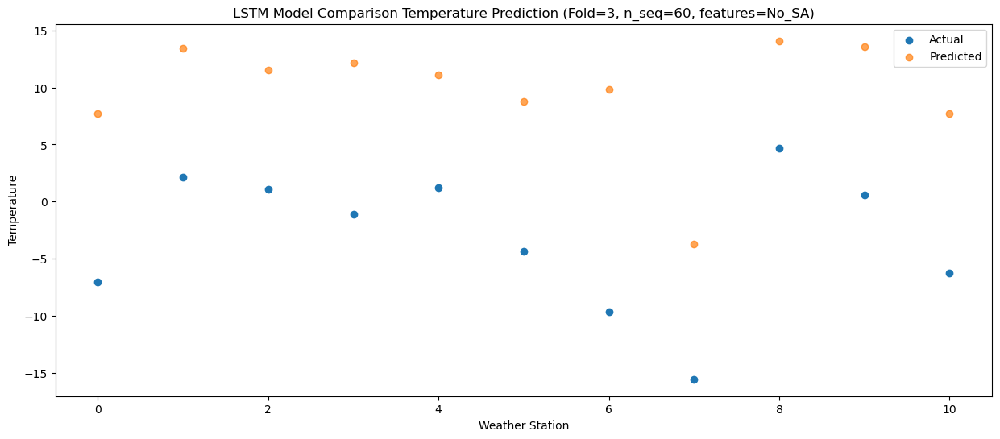

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -9.32   1.469455
1                 1   -4.49   7.169456
2                 2    0.85   5.289456
3                 3   -6.24   5.919458
4                 4   -5.25   4.839452
5                 5  -10.51   2.519454
6                 6  -11.77   3.599454
7                 7  -17.27  -9.970545
8                 8    4.96   7.839451
9                 9   -3.43   7.309455
10               10   -9.26   1.469455


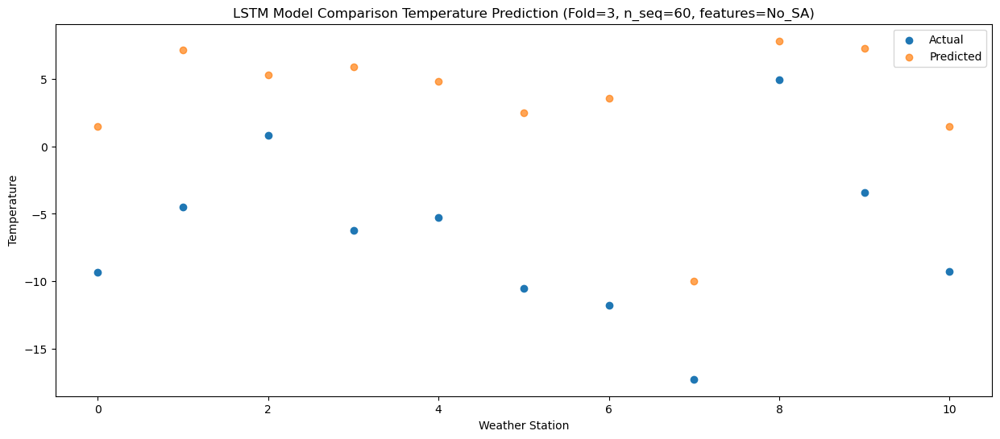

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -6.18   8.890303
1                 1    5.16  14.590304
2                 2    2.34  12.710303
3                 3   -0.56  13.340306
4                 4    2.56  12.260299
5                 5   -3.88   9.940301
6                 6   -9.61  11.020301
7                 7  -14.91  -2.549698
8                 8    4.67  15.260298
9                 9   -2.86  14.730302
10               10   -7.22   8.890303


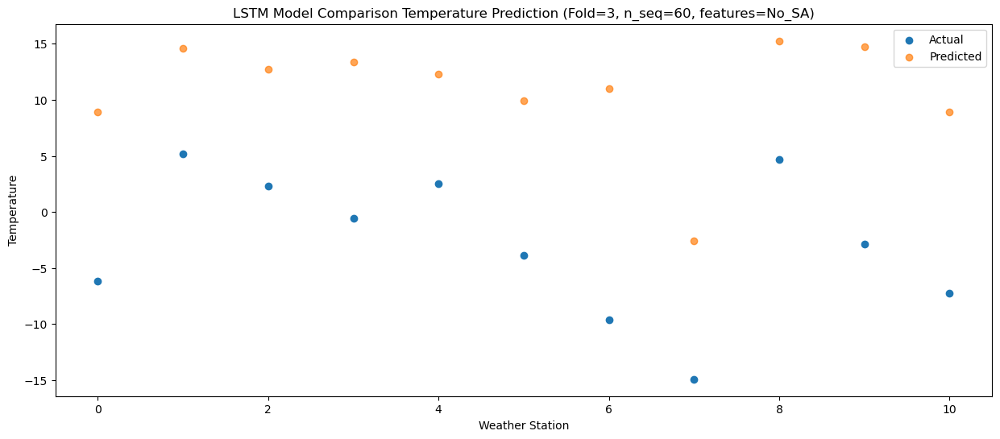

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0   -2.51  12.387237
1                 1    7.64  18.087239
2                 2    4.37  16.207239
3                 3    3.09  16.837241
4                 4    6.67  15.757235
5                 5    0.19  13.437237
6                 6   -7.87  14.517235
7                 7  -11.55   0.947236
8                 8    5.60  18.757234
9                 9    1.84  18.227238
10               10   -2.56  12.387239


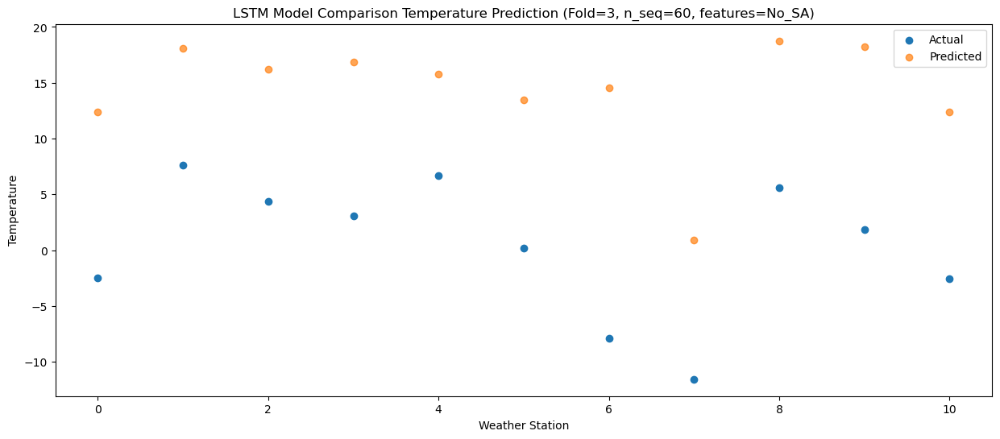

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    1.51  17.371652
1                 1   11.81  23.071655
2                 2    7.56  21.191654
3                 3    8.15  21.821657
4                 4   11.42  20.741650
5                 5    5.16  18.421652
6                 6   -2.89  19.501650
7                 7   -6.05   5.931651
8                 8    7.83  23.741649
9                 9    4.71  23.211653
10               10    2.02  17.371654


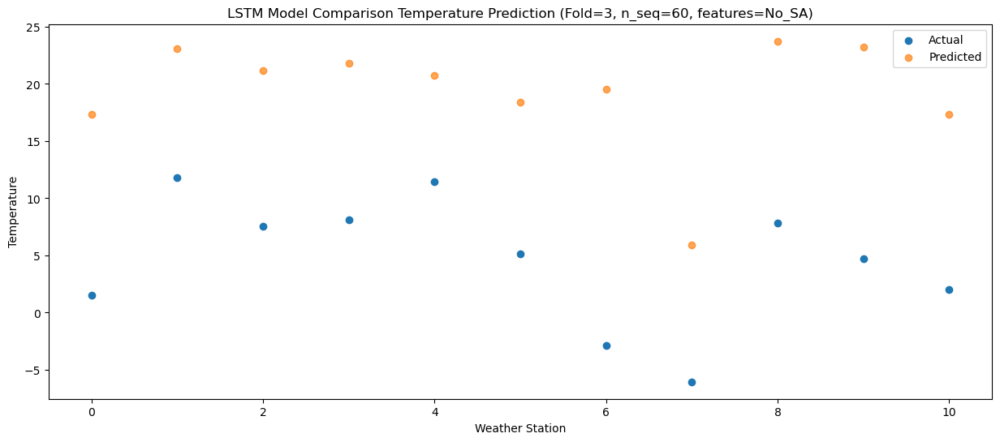

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    5.78  23.302916
1                 1   16.58  29.002920
2                 2   12.95  27.122920
3                 3   12.34  27.752922
4                 4   17.58  26.672914
5                 5   10.68  24.352916
6                 6    0.22  25.432914
7                 7   -0.42  11.862915
8                 8   10.80  29.672913
9                 9   10.26  29.142918
10               10    7.69  23.302919


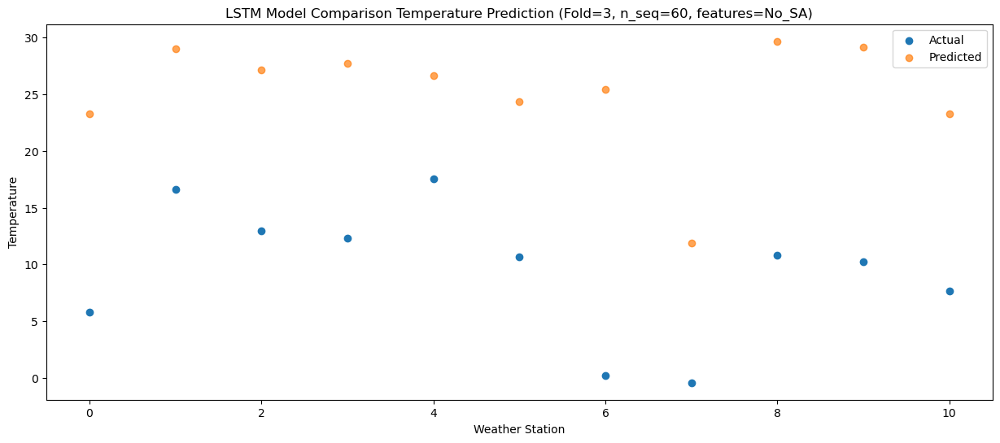

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0    9.44  28.379294
1                 1   21.14  34.079299
2                 2   18.90  32.199300
3                 3   16.24  32.829303
4                 4   22.45  31.749293
5                 5   13.91  29.429295
6                 6    9.37  30.509293
7                 7    7.76  16.939294
8                 8   13.71  34.749292
9                 9   16.73  34.219299
10               10   13.06  28.379300


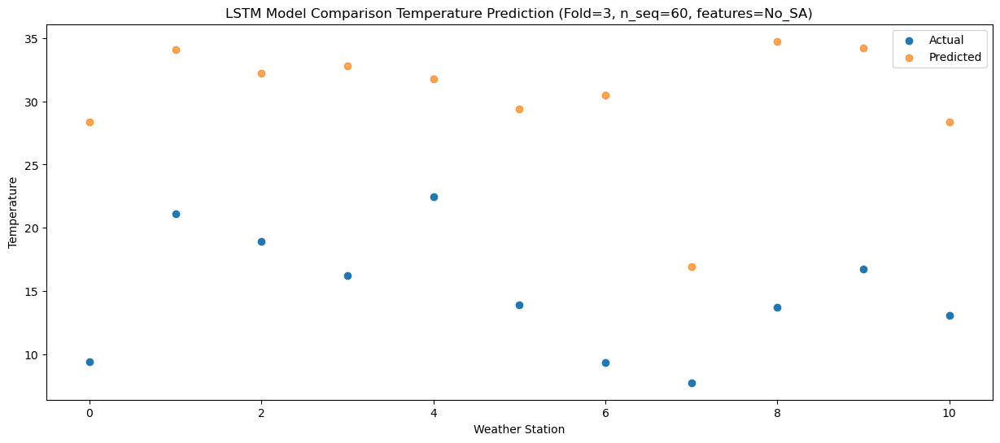

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   10.33  29.016697
1                 1   21.66  34.716702
2                 2   22.47  32.836703
3                 3   17.95  33.466706
4                 4   21.61  32.386696
5                 5   14.46  30.066698
6                 6   10.12  31.146696
7                 7   10.84  17.576697
8                 8   14.97  35.386695
9                 9   19.29  34.856702
10               10   15.72  29.016703


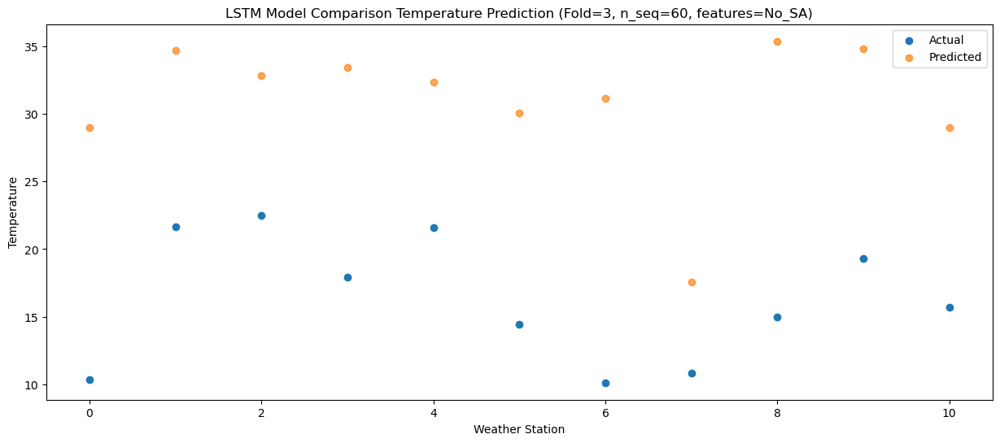

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    8.93  29.361920
1                 1   21.94  35.061924
2                 2   19.50  33.181925
3                 3   16.93  33.811928
4                 4   21.06  32.731918
5                 5   13.91  30.411920
6                 6    9.83  31.491918
7                 7    7.98  17.921919
8                 8   13.69  35.731917
9                 9   17.57  35.201924
10               10   12.58  29.361925


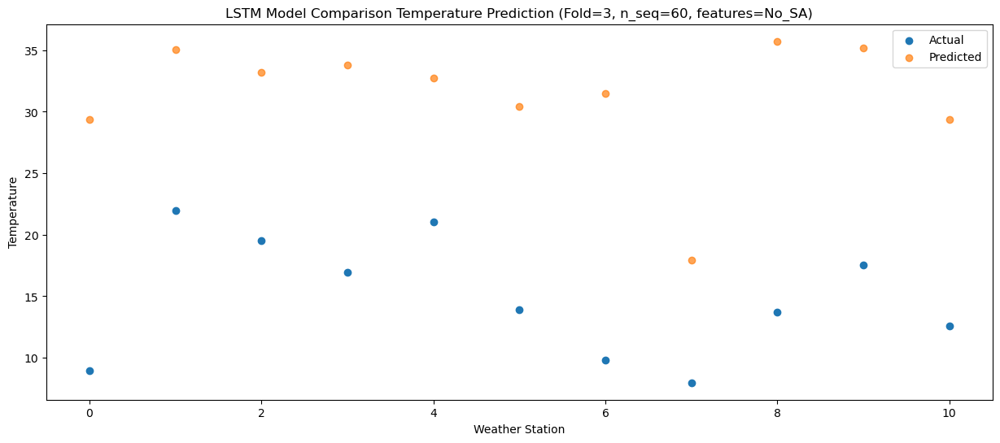

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    6.24  25.994462
1                 1   17.90  31.694467
2                 2   16.47  29.814468
3                 3   13.96  30.444471
4                 4   17.80  29.364461
5                 5   11.22  27.044463
6                 6    6.21  28.124461
7                 7    4.03  14.554462
8                 8   12.25  32.364460
9                 9   13.56  31.834467
10               10    8.99  25.994468


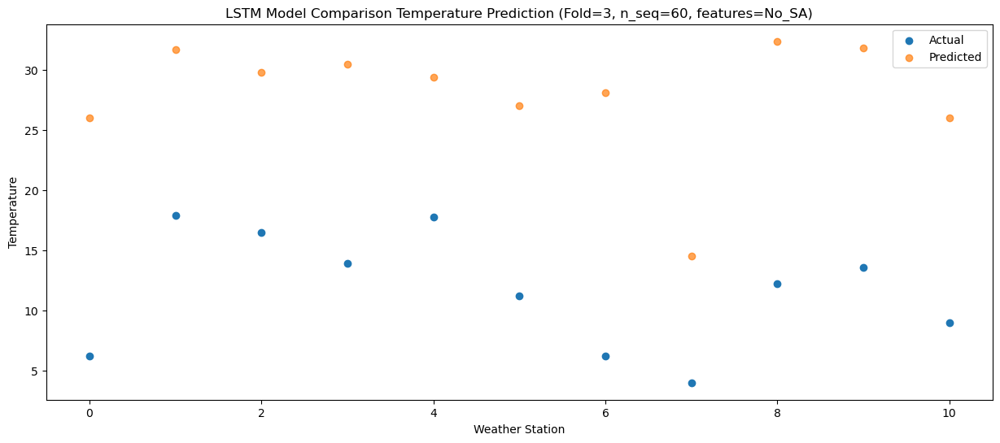

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    0.93  20.995375
1                 1   14.51  26.695379
2                 2   11.44  24.815380
3                 3    7.46  25.445383
4                 4   12.17  24.365373
5                 5    5.34  22.045375
6                 6    1.98  23.125373
7                 7   -1.86   9.555374
8                 8   11.79  27.365372
9                 9    9.03  26.835379
10               10    3.75  20.995380


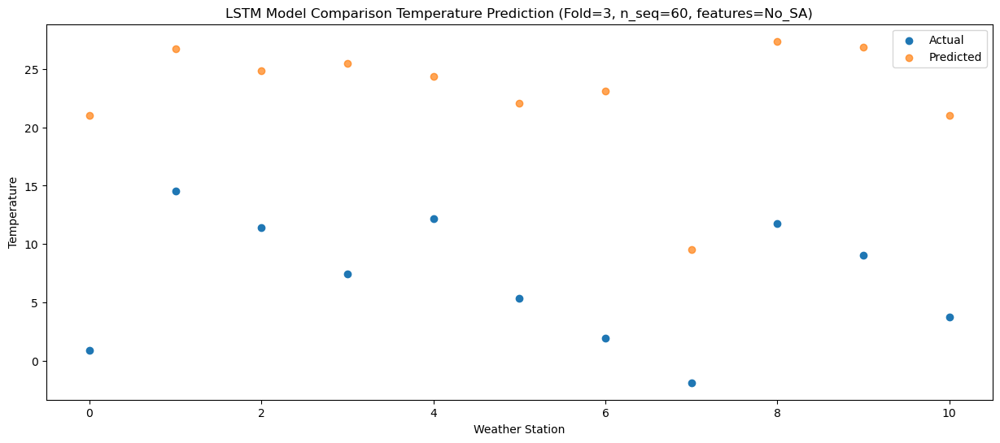

f, t:
[[-6.460e+00  2.220e+00  2.710e+00 -2.860e+00  3.310e+00 -5.820e+00
  -6.460e+00 -1.316e+01  5.280e+00  6.300e-01 -6.460e+00]
 [-7.240e+00  8.700e-01  1.800e-01 -2.850e+00  5.000e-02 -5.610e+00
  -1.213e+01 -1.789e+01  4.030e+00 -2.130e+00 -9.420e+00]
 [-7.660e+00  3.000e-02 -1.040e+00 -3.400e+00 -2.820e+00 -7.030e+00
  -1.222e+01 -1.673e+01  3.400e+00 -2.100e+00 -9.010e+00]
 [-6.650e+00  1.800e-01  1.380e+00 -3.750e+00 -1.670e+00 -7.440e+00
  -1.203e+01 -1.522e+01  5.420e+00 -1.660e+00 -8.090e+00]
 [-1.390e+00  7.670e+00  3.170e+00  3.160e+00  5.740e+00 -5.800e-01
  -7.100e+00 -1.211e+01  4.860e+00  1.920e+00 -3.680e+00]
 [-3.200e-01  8.590e+00  7.830e+00  3.800e+00  8.770e+00  1.690e+00
  -4.120e+00 -6.200e+00  8.480e+00  3.360e+00 -1.740e+00]
 [ 2.370e+00  1.299e+01  1.302e+01  8.370e+00  1.484e+01  7.100e+00
   2.990e+00  1.070e+00  1.088e+01  8.920e+00  4.030e+00]
 [ 7.690e+00  2.009e+01  1.637e+01  1.419e+01  2.189e+01  1.409e+01
   7.200e+00  4.530e+00  1.342e+01  1.590e+0

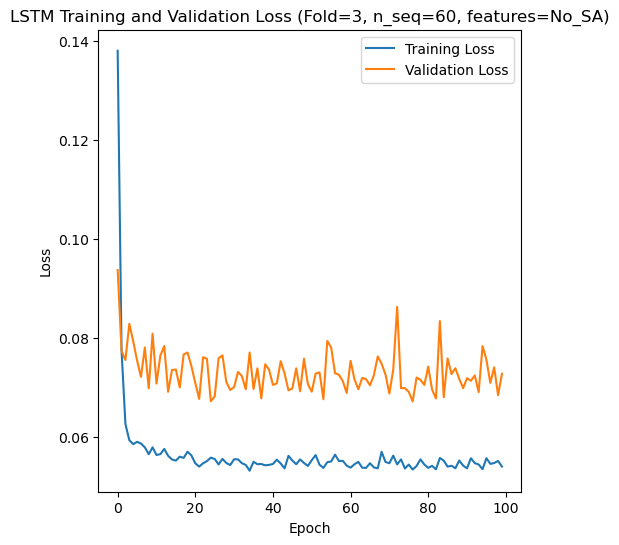

[[ 4.89  1.26  7.78 ... 22.59 18.46  9.82]
 [15.38 13.87 17.63 ... 26.66 22.89 20.2 ]
 [11.49  8.39 14.48 ... 24.97 20.83 17.82]
 ...
 [ 7.64  3.61 10.44 ... 21.3  17.62 11.34]
 [ 4.26  0.29  5.21 ... 21.47 15.54  9.34]
 [ 3.62 -0.32  6.05 ... 19.99 14.92  8.29]]
Epoch 1/100
84/84 [==============================] - 48s 243ms/step - loss: 0.1458 - accuracy: 0.2024 - mae: 0.1188 - rmse: 0.1458 - mape: inf - pearson: 0.5798 - val_loss: 0.0710 - val_accuracy: 0.6000 - val_mae: 0.0571 - val_rmse: 0.0710 - val_mape: 13.4241 - val_pearson: 0.8450
Epoch 2/100
84/84 [==============================] - 12s 142ms/step - loss: 0.0752 - accuracy: 0.3929 - mae: 0.0606 - rmse: 0.0752 - mape: inf - pearson: 0.8057 - val_loss: 0.0711 - val_accuracy: 0.6000 - val_mae: 0.0578 - val_rmse: 0.0711 - val_mape: 13.3762 - val_pearson: 0.8333
Epoch 3/100
84/84 [==============================] - 13s 153ms/step - loss: 0.0619 - accuracy: 0.5119 - mae: 0.0491 - rmse: 0.0619 - mape: inf - pearson: 0.8299 - val_loss:

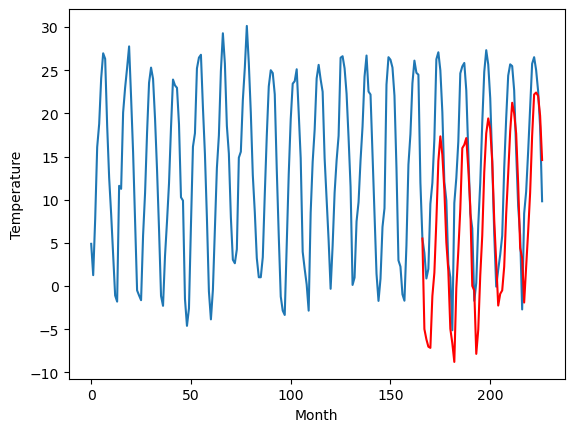

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-2.38		-3.72		-1.34
-2.56		-4.90		-2.34
-4.02		-5.76		-1.74
-2.47		-5.89		-3.42
1.60		0.11		-1.49
3.28		2.81		-0.47
4.68		8.83		4.15
6.44		15.74		9.30
6.76		18.61		11.85
6.61		16.46		9.85
6.03		12.42		6.39
4.53		6.33		1.80
1.14		3.00		1.86
-6.61		-3.68		2.93
-5.91		-5.36		0.55
-2.48		-7.52		-5.04
-0.88		1.02		1.90
0.56		5.34		4.78
4.60		10.19		5.59
6.23		17.25		11.02
6.60		17.64		11.04
6.88		18.41		11.53
5.59		14.87		9.28
3.75		10.48		6.73
-3.41		1.29		4.70
-1.61		0.75		2.36
-6.37		-6.59		-0.22
-2.94		-3.77		-0.83
-0.12		2.50		2.62
2.22		7.12		4.90
5.04		14.46		9.42
6.76		18.96		12.20
7.13		20.68		13.55
7.08		19.47		12.39
5.64		15.69		10.05
1.81		8.93		7.12
0.35		4.01		3.66
-4.50		-0.99		3.51
-4.65		0.36		5.01
-1.35		0.77		2.12
0.37		3.52		3.15
3.09		9.64		6.55
3.87		14.28		10.41
6.08		19.19		13.11
7.69		22.50		14.81
8.20		21.26		13.06
6.10		18.93		12.83
2.45		13.12		10.67
-1.26		5.67		6.93
-

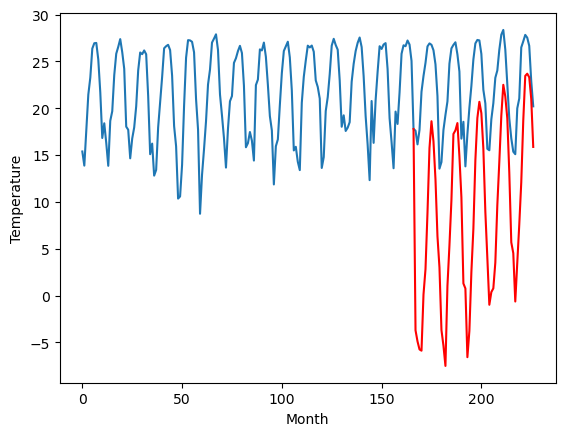

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
6.75		6.77		0.02
6.81		5.59		-1.22
6.62		4.73		-1.89
6.88		4.60		-2.28
14.68		10.60		-4.08
13.73		13.30		-0.43
17.61		19.32		1.71
21.70		26.23		4.53
23.27		29.10		5.83
22.44		26.95		4.51
20.34		22.91		2.57
15.00		16.82		1.82
11.00		13.49		2.49
4.75		6.81		2.06
4.78		5.13		0.35
2.86		2.97		0.11
12.19		11.51		-0.68
13.26		15.83		2.57
17.73		20.68		2.95
21.99		27.74		5.75
22.65		28.13		5.48
23.30		28.90		5.60
20.18		25.36		5.18
16.79		20.97		4.18
8.12		11.78		3.66
11.63		11.24		-0.39
3.35		3.90		0.55
5.71		6.72		1.01
10.45		12.99		2.54
14.66		17.61		2.95
20.46		24.95		4.49
23.75		29.45		5.70
23.95		31.17		7.22
22.41		29.96		7.55
20.34		26.18		5.84
14.21		19.42		5.21
9.62		14.50		4.88
7.19		9.50		2.31
7.60		10.85		3.25
9.54		11.26		1.72
11.69		14.01		2.32
13.44		20.13		6.69
18.30		24.77		6.47
21.89		29.68		7.79
23.67		32.99		9.32
25.75		31.75		6.00
22.00		29.42		7.42
15.89		23.61		7.72
8.93		16.1

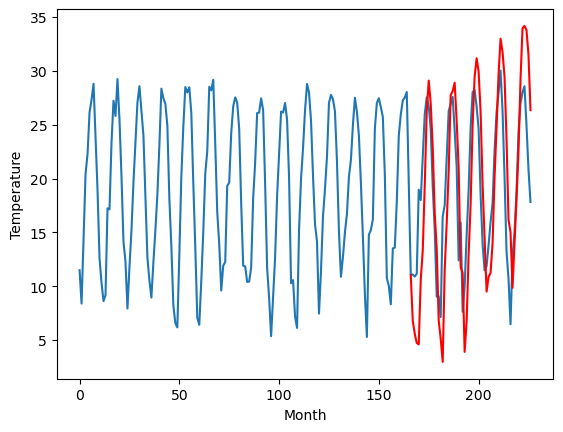

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.23		2.88		-1.35
2.58		1.70		-0.88
2.82		0.84		-1.98
2.49		0.71		-1.78
9.95		6.71		-3.24
10.61		9.41		-1.20
15.74		15.43		-0.31
20.70		22.34		1.64
22.56		25.21		2.65
22.31		23.06		0.75
16.53		19.02		2.49
10.80		12.93		2.13
8.19		9.60		1.41
1.91		2.92		1.01
0.99		1.24		0.25
-2.47		-0.92		1.55
8.49		7.62		-0.87
10.18		11.94		1.76
14.34		16.79		2.45
20.02		23.85		3.83
21.61		24.24		2.63
21.98		25.01		3.03
19.19		21.47		2.28
14.54		17.08		2.54
6.54		7.89		1.35
8.54		7.35		-1.19
0.07		0.01		-0.06
0.33		2.83		2.50
6.51		9.10		2.59
12.56		13.72		1.16
17.27		21.06		3.79
21.82		25.56		3.74
25.12		27.28		2.16
22.39		26.07		3.68
18.96		22.29		3.33
12.09		15.53		3.44
5.04		10.61		5.57
2.35		5.61		3.26
3.34		6.96		3.62
3.40		7.37		3.97
7.93		10.12		2.19
10.53		16.24		5.71
16.21		20.88		4.67
20.40		25.79		5.39
22.95		29.10		6.15
25.50		27.86		2.36
20.80		25.53		4.73
12.67		19.72		7.05
6.60		12.27		5.67
3.

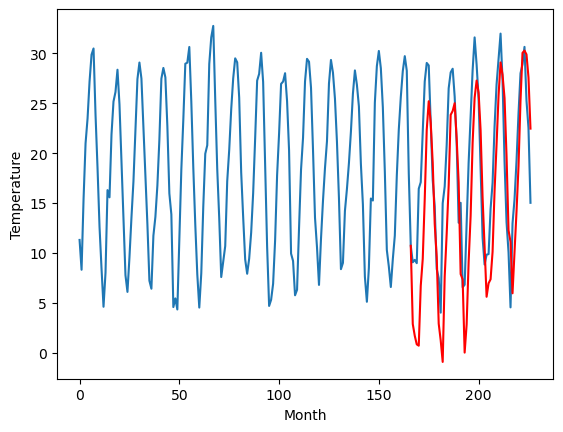

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.65		2.70		-0.95
1.87		1.52		-0.35
2.49		0.66		-1.83
2.11		0.53		-1.58
9.99		6.53		-3.46
10.68		9.23		-1.45
16.33		15.25		-1.08
21.04		22.16		1.12
23.48		25.03		1.55
22.80		22.88		0.08
16.50		18.84		2.34
10.75		12.75		2.00
7.99		9.42		1.43
1.42		2.74		1.32
0.82		1.06		0.24
-3.07		-1.10		1.97
7.85		7.44		-0.41
10.03		11.76		1.73
13.56		16.61		3.05
20.41		23.67		3.26
21.90		24.06		2.16
22.27		24.83		2.56
18.84		21.29		2.45
13.97		16.90		2.93
6.13		7.71		1.58
7.87		7.17		-0.70
-1.03		-0.17		0.86
-0.41		2.65		3.06
6.51		8.92		2.41
13.20		13.54		0.34
18.03		20.88		2.85
22.70		25.38		2.68
26.12		27.10		0.98
23.28		25.89		2.61
19.19		22.11		2.92
12.04		15.35		3.31
4.95		10.43		5.48
1.98		5.43		3.45
2.75		6.78		4.03
2.98		7.19		4.21
7.83		9.94		2.11
10.48		16.06		5.58
16.64		20.70		4.06
21.75		25.61		3.86
24.83		28.92		4.09
26.70		27.68		0.98
21.61		25.35		3.74
12.78		19.54		6.76
6.25		12.09		5.84
3

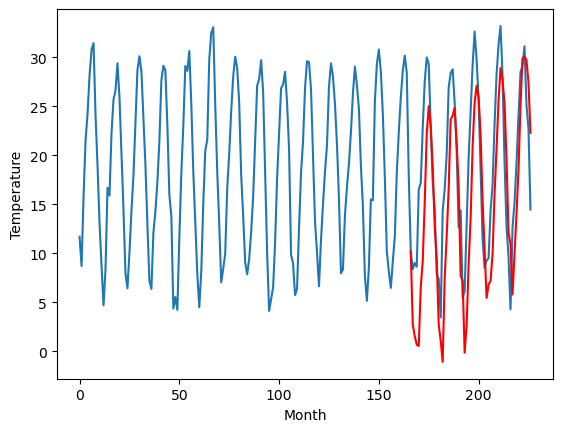

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.12		3.08		-2.04
3.48		1.90		-1.58
2.75		1.04		-1.71
1.99		0.91		-1.08
9.55		6.91		-2.64
12.52		9.61		-2.91
19.09		15.63		-3.46
22.42		22.54		0.12
25.25		25.41		0.16
24.63		23.26		-1.37
16.90		19.22		2.32
12.94		13.13		0.19
9.06		9.80		0.74
2.08		3.12		1.04
0.98		1.44		0.46
-0.59		-0.72		-0.13
8.66		7.82		-0.84
10.89		12.14		1.25
16.38		16.99		0.61
21.34		24.05		2.71
21.08		24.44		3.36
21.40		25.21		3.81
20.71		21.67		0.96
15.01		17.28		2.27
8.07		8.09		0.02
8.48		7.55		-0.93
1.11		0.21		-0.90
0.91		3.03		2.12
8.23		9.30		1.07
15.74		13.92		-1.82
21.43		21.26		-0.17
23.80		25.76		1.96
25.70		27.48		1.78
22.40		26.27		3.87
19.50		22.49		2.99
12.69		15.73		3.04
4.84		10.81		5.97
3.24		5.81		2.57
3.61		7.16		3.55
3.78		7.57		3.79
8.85		10.32		1.47
13.07		16.44		3.37
17.99		21.08		3.09
24.47		25.99		1.52
25.93		29.30		3.37
26.02		28.06		2.04
22.54		25.73		3.19
14.01		19.92		5.91
7.30		12.47		5.1

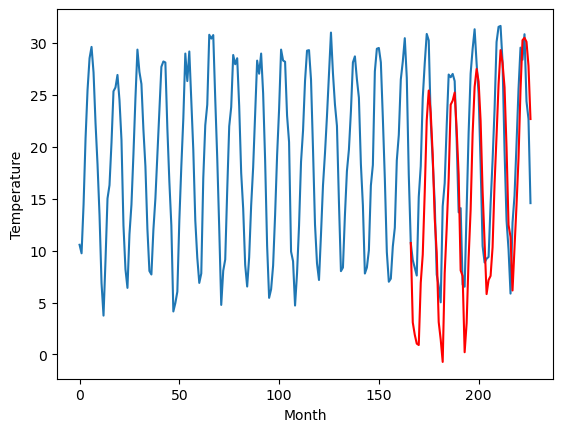

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.86		1.95		1.09
0.51		0.77		0.26
0.34		-0.09		-0.43
0.81		-0.22		-1.03
6.42		5.78		-0.64
7.69		8.48		0.79
10.48		14.50		4.02
15.07		21.41		6.34
18.11		24.28		6.17
16.91		22.13		5.22
13.11		18.09		4.98
9.29		12.00		2.71
4.98		8.67		3.69
-2.27		1.99		4.26
-2.04		0.31		2.35
-1.37		-1.85		-0.48
5.03		6.69		1.66
7.76		11.01		3.25
11.21		15.86		4.65
15.23		22.92		7.69
16.97		23.31		6.34
17.10		24.08		6.98
13.13		20.54		7.41
9.33		16.15		6.82
1.17		6.96		5.79
3.08		6.42		3.34
-2.98		-0.92		2.06
1.30		1.90		0.60
4.86		8.17		3.31
7.52		12.79		5.27
13.50		20.13		6.63
16.71		24.63		7.92
17.98		26.35		8.37
16.46		25.14		8.68
13.37		21.36		7.99
6.50		14.60		8.10
3.80		9.68		5.88
-2.15		4.68		6.83
0.87		6.03		5.16
4.29		6.44		2.15
4.77		9.19		4.42
7.88		15.31		7.43
10.50		19.95		9.45
14.14		24.86		10.72
18.01		28.17		10.16
17.45		26.93		9.48
13.61		24.60		10.99
8.17		18.79		10.62
2.44		11.34		8.90
0.23		1

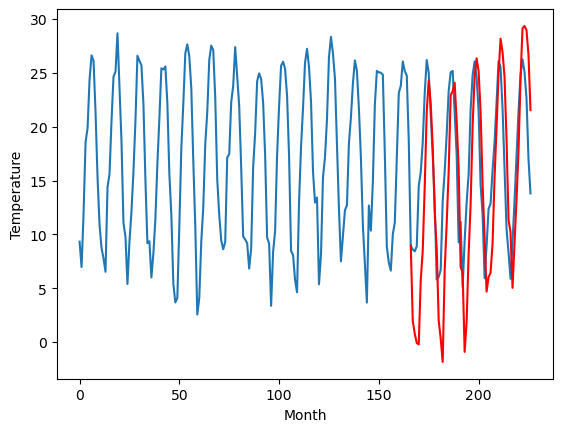

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.01		0.71		-1.30
1.20		-0.47		-1.67
-0.45		-1.33		-0.88
0.12		-1.46		-1.58
7.05		4.54		-2.51
8.63		7.24		-1.39
12.73		13.26		0.53
19.08		20.17		1.09
21.62		23.04		1.42
19.63		20.89		1.26
16.05		16.85		0.80
9.12		10.76		1.64
6.57		7.43		0.86
0.04		0.75		0.71
-1.63		-0.93		0.70
-5.24		-3.09		2.15
7.03		5.45		-1.58
8.93		9.77		0.84
12.97		14.62		1.65
19.27		21.68		2.41
20.56		22.07		1.51
21.08		22.84		1.76
18.04		19.30		1.26
12.27		14.91		2.64
4.33		5.72		1.39
5.79		5.18		-0.61
-3.28		-2.16		1.12
-1.22		0.66		1.88
5.44		6.93		1.49
9.30		11.55		2.25
14.97		18.89		3.92
20.29		23.39		3.10
23.99		25.11		1.12
20.47		23.90		3.43
16.88		20.12		3.24
10.51		13.36		2.85
3.96		8.44		4.48
-0.89		3.44		4.33
0.76		4.79		4.03
2.90		5.20		2.30
4.62		7.95		3.33
10.24		14.07		3.83
15.02		18.71		3.69
19.10		23.62		4.52
21.06		26.93		5.87
20.87		25.69		4.82
16.93		23.36		6.43
11.03		17.55		6.52
5.13		10.10		4.97
2

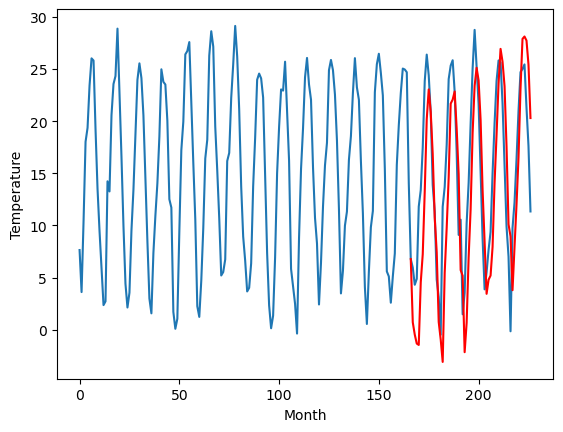

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-2.64		-0.97		1.67
-3.46		-2.15		1.31
-4.39		-3.01		1.38
-5.22		-3.14		2.08
1.60		2.86		1.26
4.59		5.56		0.97
10.17		11.58		1.41
17.46		18.49		1.03
19.50		21.36		1.86
17.30		19.21		1.91
13.54		15.17		1.63
6.70		9.08		2.38
2.86		5.75		2.89
-4.65		-0.93		3.72
-6.23		-2.61		3.62
-9.59		-4.77		4.82
2.38		3.77		1.39
6.03		8.09		2.06
10.44		12.94		2.50
17.68		20.00		2.32
18.25		20.39		2.14
19.11		21.16		2.05
15.62		17.62		2.00
10.27		13.23		2.96
-0.59		4.04		4.63
-0.27		3.50		3.77
-9.11		-3.84		5.27
-6.09		-1.02		5.07
1.38		5.25		3.87
5.16		9.87		4.71
13.66		17.21		3.55
18.14		21.71		3.57
20.08		23.43		3.35
17.85		22.22		4.37
13.94		18.44		4.50
6.45		11.68		5.23
0.66		6.76		6.10
-5.12		1.76		6.88
-3.16		3.11		6.27
-1.57		3.52		5.09
-0.30		6.27		6.57
6.20		12.39		6.19
11.91		17.03		5.12
15.79		21.94		6.15
18.52		25.25		6.73
17.36		24.01		6.65
14.27		21.68		7.41
8.13		15.87		7.74
1.06		8.42		7.36
-0.

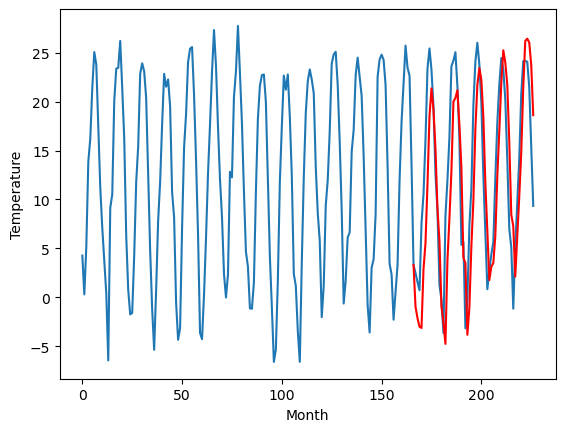

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-4.88		-4.35		0.53
-5.20		-5.53		-0.33
-7.64		-6.39		1.25
-7.89		-6.52		1.37
-0.29		-0.52		-0.23
2.82		2.18		-0.64
8.70		8.20		-0.50
16.43		15.11		-1.32
17.64		17.98		0.34
15.04		15.83		0.79
11.14		11.79		0.65
3.80		5.70		1.90
1.16		2.37		1.21
-6.72		-4.31		2.41
-8.75		-5.99		2.76
-13.19		-8.15		5.04
0.67		0.39		-0.28
4.38		4.71		0.33
9.16		9.56		0.40
16.55		16.62		0.07
16.26		17.01		0.75
16.54		17.78		1.24
13.43		14.24		0.81
7.97		9.85		1.88
-2.34		0.66		3.00
-2.59		0.12		2.71
-12.07		-7.22		4.85
-9.24		-4.40		4.84
-1.03		1.87		2.90
3.09		6.49		3.40
11.62		13.83		2.21
16.23		18.33		2.10
17.05		20.05		3.00
15.75		18.84		3.09
11.61		15.06		3.45
4.14		8.30		4.16
-1.40		3.38		4.78
-8.13		-1.62		6.51
-5.89		-0.27		5.62
-4.70		0.14		4.84
-2.16		2.89		5.05
5.17		9.01		3.84
10.93		13.65		2.72
15.24		18.56		3.32
16.77		21.87		5.10
15.51		20.63		5.12
12.47		18.30		5.83
6.06		12.49		6.43
-1.03		5.04		

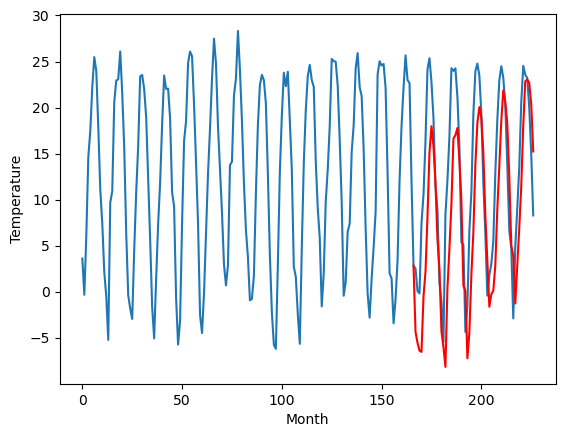

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-6.79		-4.99		1.80
-7.57		-6.17		1.40
-8.77		-7.03		1.74
-9.58		-7.16		2.42
-3.42		-1.16		2.26
-2.04		1.54		3.58
4.70		7.56		2.86
11.19		14.47		3.28
14.63		17.34		2.71
12.22		15.19		2.97
8.23		11.15		2.92
2.07		5.06		2.99
-1.16		1.73		2.89
-8.72		-4.95		3.77
-10.64		-6.63		4.01
-12.88		-8.79		4.09
-2.99		-0.25		2.74
0.81		4.07		3.26
5.34		8.92		3.58
12.23		15.98		3.75
12.39		16.37		3.98
13.59		17.14		3.55
9.30		13.60		4.30
5.77		9.21		3.44
-4.63		0.02		4.65
-5.49		-0.52		4.97
-14.32		-7.86		6.46
-10.76		-5.04		5.72
-4.79		1.23		6.02
-0.79		5.85		6.64
7.79		13.19		5.40
11.06		17.69		6.63
13.66		19.41		5.75
12.59		18.20		5.61
8.54		14.42		5.88
1.68		7.66		5.98
-2.40		2.74		5.14
-9.11		-2.26		6.85
-7.48		-0.91		6.57
-7.34		-0.50		6.84
-6.46		2.25		8.71
2.01		8.37		6.36
5.70		13.01		7.31
10.01		17.92		7.91
13.10		21.23		8.13
11.77		19.99		8.22
9.43		17.66		8.23
4.17		11.85		7.68
-3.22		4.40		7.6

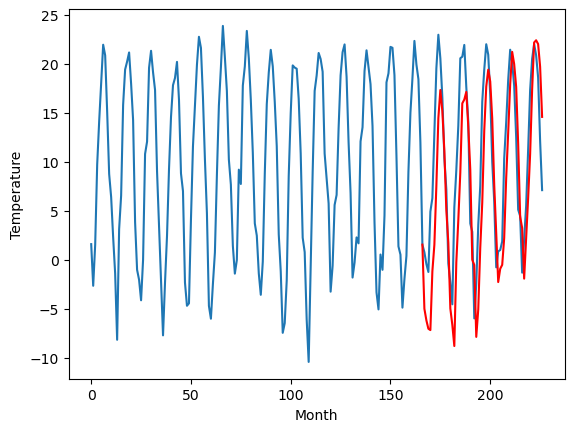

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -2.86  -4.985939
1                 1   -2.38  -3.715939
2                 2    6.75   6.774061
3                 3    4.23   2.884061
4                 4    3.65   2.704061
5                 5    5.12   3.084061
6                 6    0.86   1.954061
7                 7    2.01   0.714061
8                 8   -2.64  -0.965939
9                 9   -4.88  -4.345939
10               10   -6.79  -4.985939


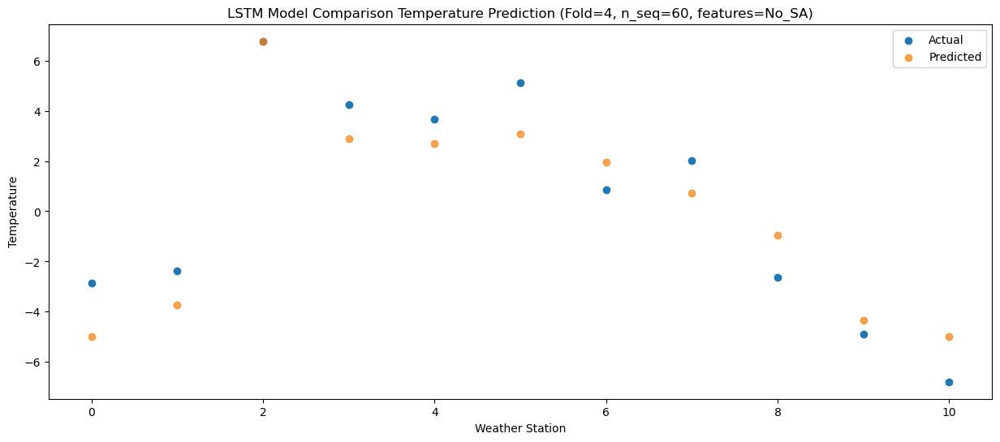

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -4.52  -6.168591
1                 1   -2.56  -4.898591
2                 2    6.81   5.591409
3                 3    2.58   1.701409
4                 4    1.87   1.521410
5                 5    3.48   1.901409
6                 6    0.51   0.771409
7                 7    1.20  -0.468591
8                 8   -3.46  -2.148591
9                 9   -5.20  -5.528591
10               10   -7.57  -6.168591


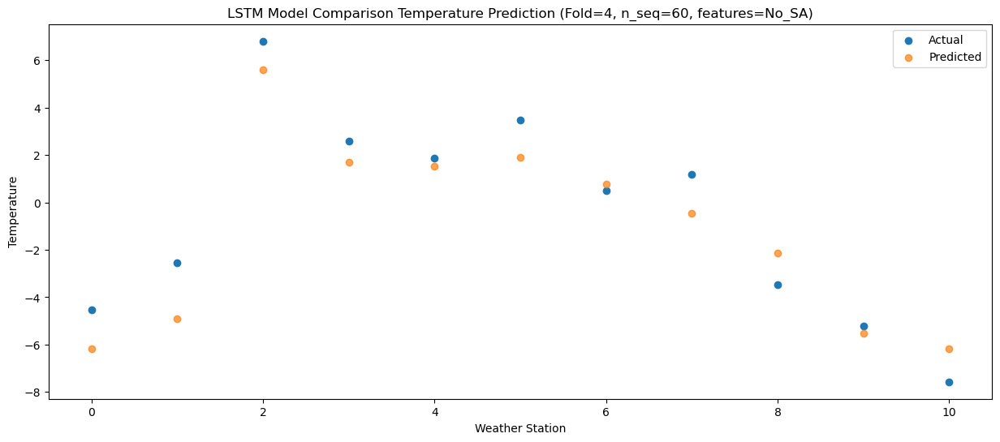

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -7.48  -7.027359
1                 1   -4.02  -5.757359
2                 2    6.62   4.732641
3                 3    2.82   0.842641
4                 4    2.49   0.662642
5                 5    2.75   1.042641
6                 6    0.34  -0.087359
7                 7   -0.45  -1.327359
8                 8   -4.39  -3.007359
9                 9   -7.64  -6.387359
10               10   -8.77  -7.027359


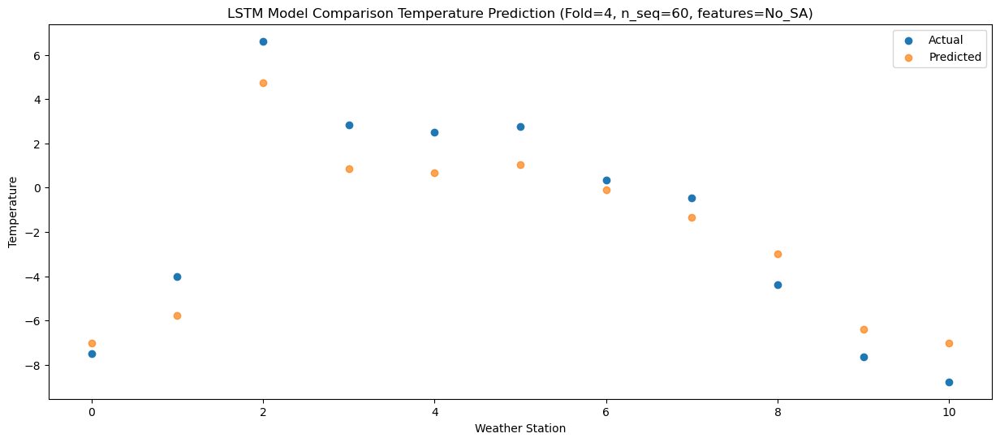

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -6.37  -7.159938
1                 1   -2.47  -5.889938
2                 2    6.88   4.600061
3                 3    2.49   0.710062
4                 4    2.11   0.530063
5                 5    1.99   0.910062
6                 6    0.81  -0.219938
7                 7    0.12  -1.459939
8                 8   -5.22  -3.139938
9                 9   -7.89  -6.519938
10               10   -9.58  -7.159939


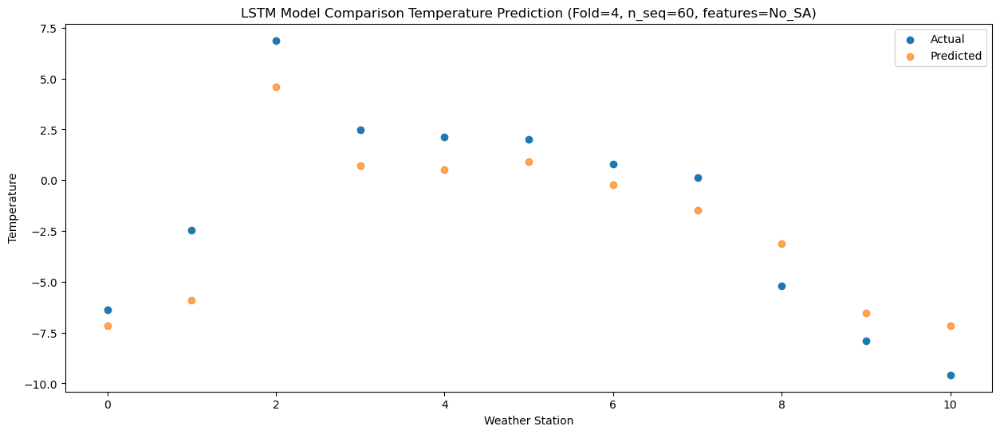

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    1.16  -1.160594
1                 1    1.60   0.109406
2                 2   14.68  10.599405
3                 3    9.95   6.709406
4                 4    9.99   6.529407
5                 5    9.55   6.909406
6                 6    6.42   5.779406
7                 7    7.05   4.539405
8                 8    1.60   2.859406
9                 9   -0.29  -0.520594
10               10   -3.42  -1.160595


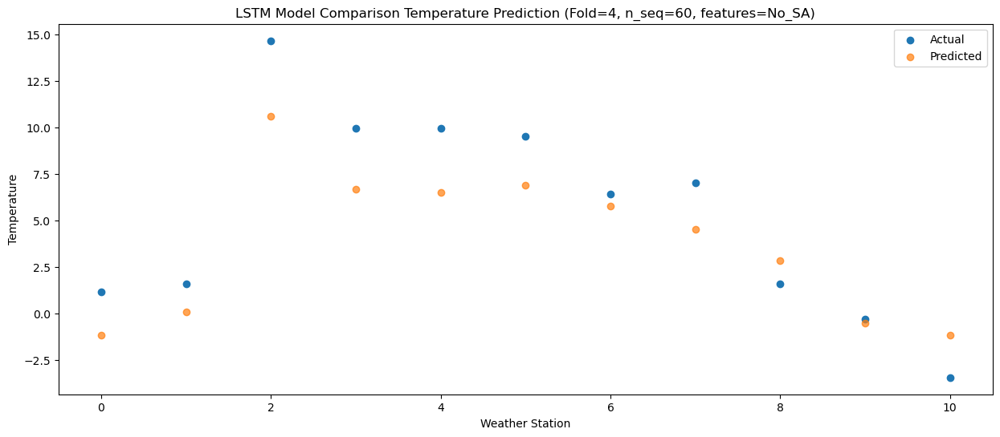

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.59   1.540935
1                 1    3.28   2.810935
2                 2   13.73  13.300934
3                 3   10.61   9.410935
4                 4   10.68   9.230936
5                 5   12.52   9.610935
6                 6    7.69   8.480935
7                 7    8.63   7.240934
8                 8    4.59   5.560935
9                 9    2.82   2.180935
10               10   -2.04   1.540934


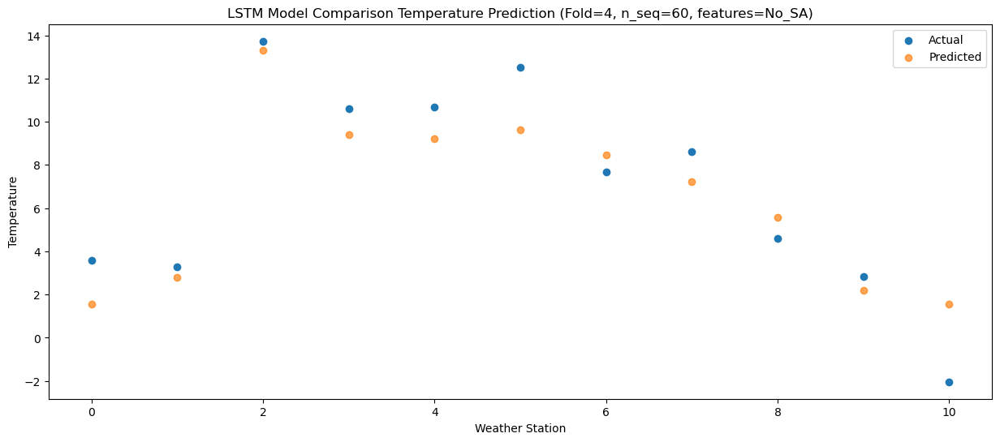

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    8.66   7.564795
1                 1    4.68   8.834795
2                 2   17.61  19.324792
3                 3   15.74  15.434795
4                 4   16.33  15.254796
5                 5   19.09  15.634793
6                 6   10.48  14.504795
7                 7   12.73  13.264794
8                 8   10.17  11.584793
9                 9    8.70   8.204795
10               10    4.70   7.564794


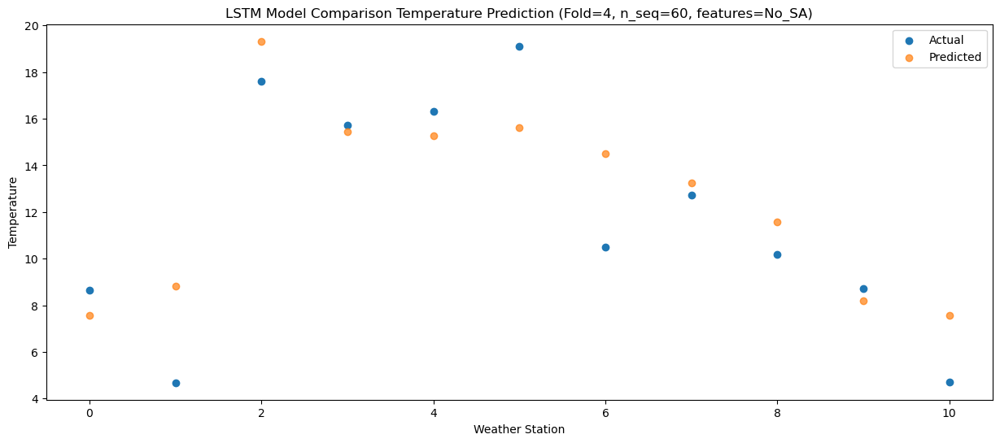

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   17.91  14.470938
1                 1    6.44  15.740936
2                 2   21.70  26.230935
3                 3   20.70  22.340938
4                 4   21.04  22.160939
5                 5   22.42  22.540936
6                 6   15.07  21.410936
7                 7   19.08  20.170937
8                 8   17.46  18.490936
9                 9   16.43  15.110938
10               10   11.19  14.470937


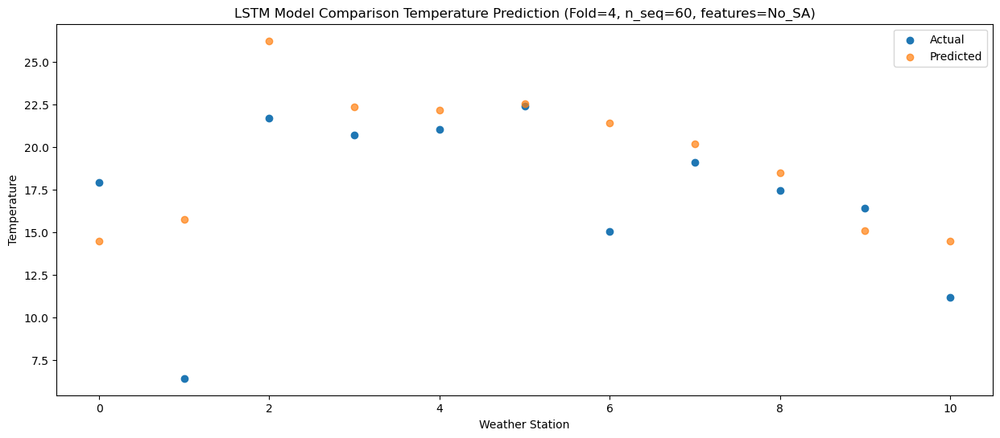

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   18.72  17.340143
1                 1    6.76  18.610141
2                 2   23.27  29.100140
3                 3   22.56  25.210143
4                 4   23.48  25.030144
5                 5   25.25  25.410141
6                 6   18.11  24.280141
7                 7   21.62  23.040142
8                 8   19.50  21.360141
9                 9   17.64  17.980143
10               10   14.63  17.340142


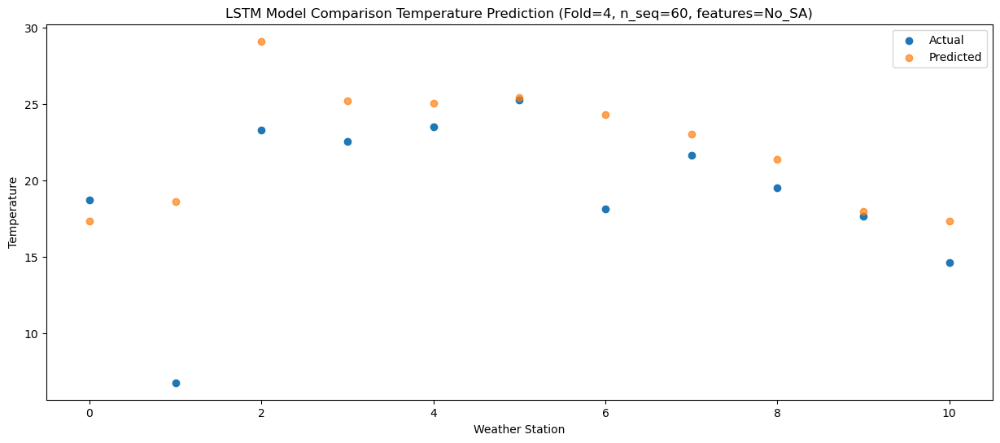

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   16.62  15.193604
1                 1    6.61  16.463603
2                 2   22.44  26.953601
3                 3   22.31  23.063604
4                 4   22.80  22.883605
5                 5   24.63  23.263602
6                 6   16.91  22.133603
7                 7   19.63  20.893603
8                 8   17.30  19.213602
9                 9   15.04  15.833604
10               10   12.22  15.193603


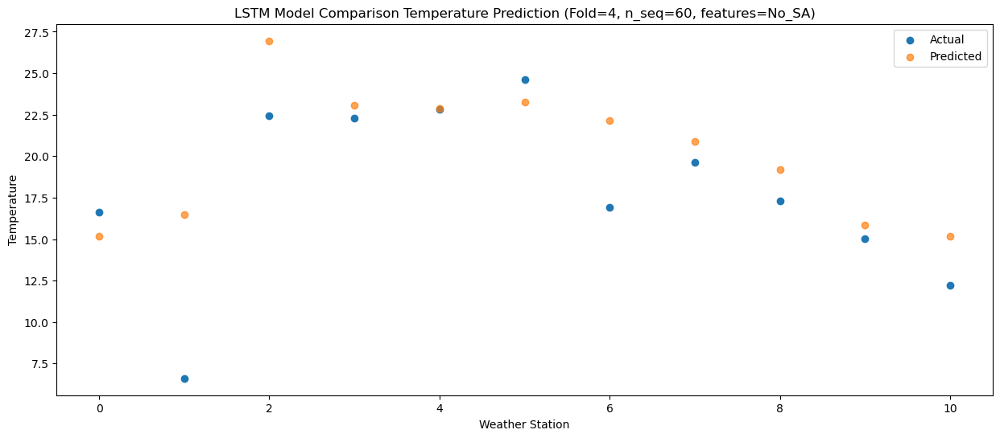

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   11.78  11.152428
1                 1    6.03  12.422427
2                 2   20.34  22.912425
3                 3   16.53  19.022428
4                 4   16.50  18.842429
5                 5   16.90  19.222426
6                 6   13.11  18.092427
7                 7   16.05  16.852427
8                 8   13.54  15.172426
9                 9   11.14  11.792428
10               10    8.23  11.152427


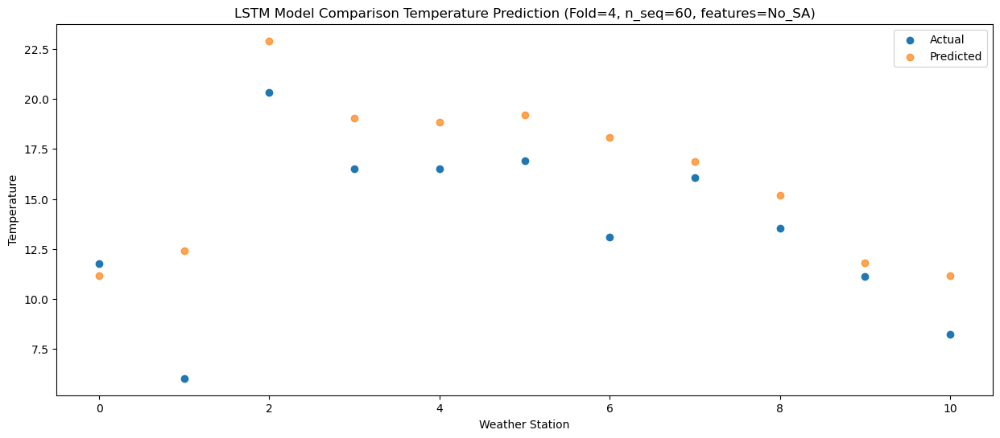

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    3.73   5.057040
1                 1    4.53   6.327039
2                 2   15.00  16.817037
3                 3   10.80  12.927040
4                 4   10.75  12.747041
5                 5   12.94  13.127038
6                 6    9.29  11.997039
7                 7    9.12  10.757039
8                 8    6.70   9.077038
9                 9    3.80   5.697040
10               10    2.07   5.057039


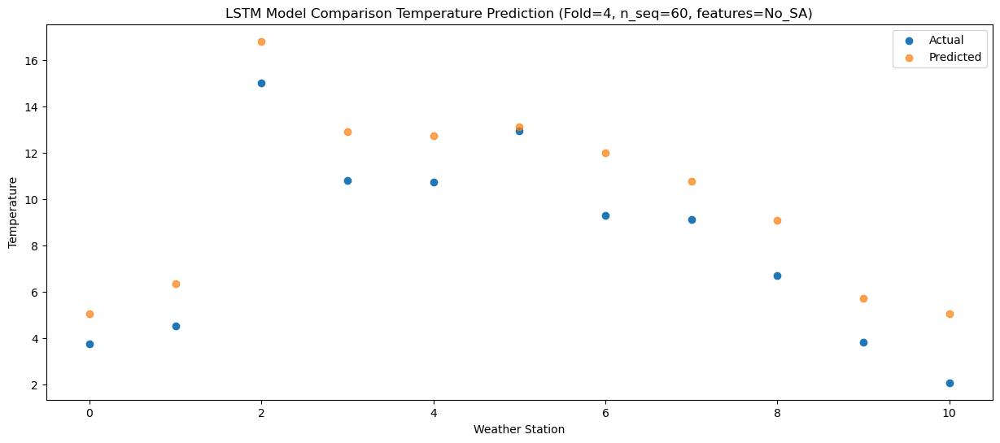

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    1.54   1.733781
1                 1    1.14   3.003780
2                 2   11.00  13.493778
3                 3    8.19   9.603781
4                 4    7.99   9.423781
5                 5    9.06   9.803779
6                 6    4.98   8.673780
7                 7    6.57   7.433780
8                 8    2.86   5.753779
9                 9    1.16   2.373781
10               10   -1.16   1.733780


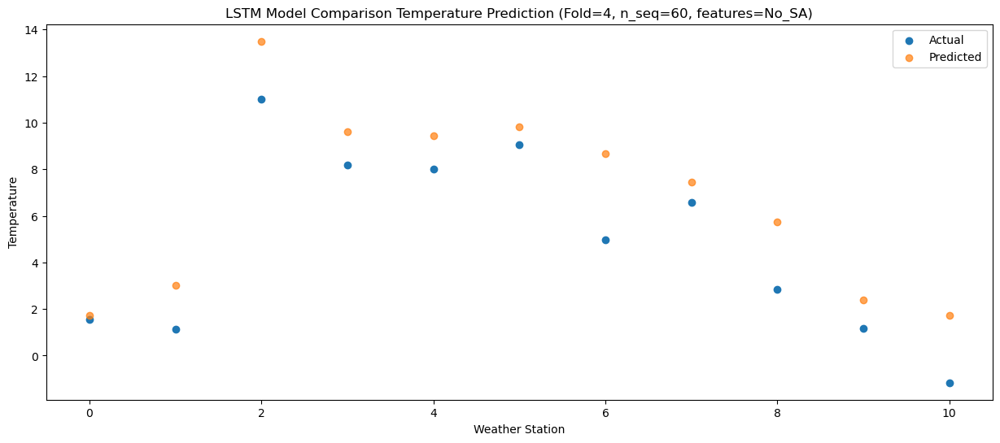

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -5.84  -4.952268
1                 1   -6.61  -3.682269
2                 2    4.75   6.807729
3                 3    1.91   2.917732
4                 4    1.42   2.737732
5                 5    2.08   3.117730
6                 6   -2.27   1.987731
7                 7    0.04   0.747731
8                 8   -4.65  -0.932270
9                 9   -6.72  -4.312268
10               10   -8.72  -4.952269


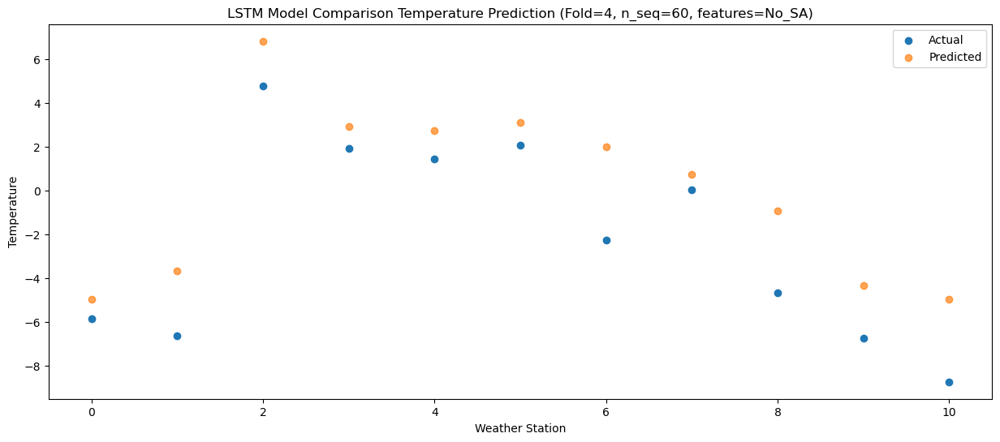

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -7.35  -6.628163
1                 1   -5.91  -5.358164
2                 2    4.78   5.131834
3                 3    0.99   1.241837
4                 4    0.82   1.061837
5                 5    0.98   1.441835
6                 6   -2.04   0.311836
7                 7   -1.63  -0.928164
8                 8   -6.23  -2.608165
9                 9   -8.75  -5.988163
10               10  -10.64  -6.628164


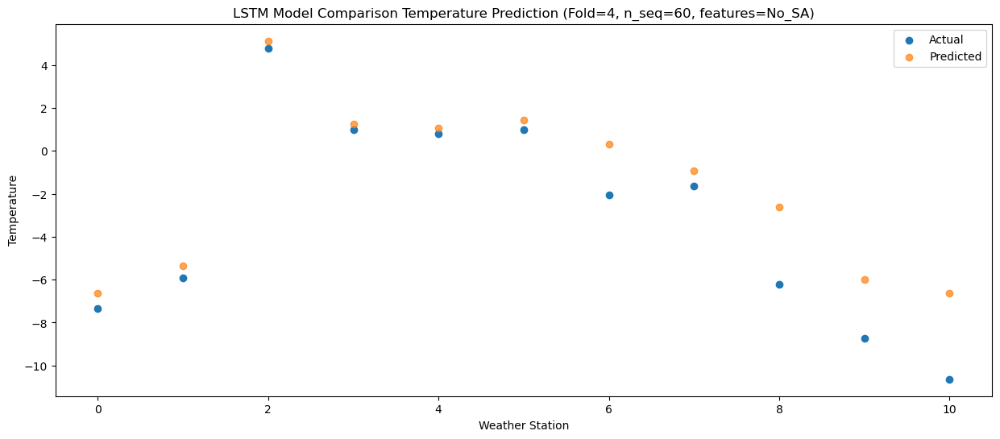

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0  -13.48  -8.788228
1                 1   -2.48  -7.518229
2                 2    2.86   2.971769
3                 3   -2.47  -0.918228
4                 4   -3.07  -1.098228
5                 5   -0.59  -0.718230
6                 6   -1.37  -1.848229
7                 7   -5.24  -3.088229
8                 8   -9.59  -4.768230
9                 9  -13.19  -8.148228
10               10  -12.88  -8.788229


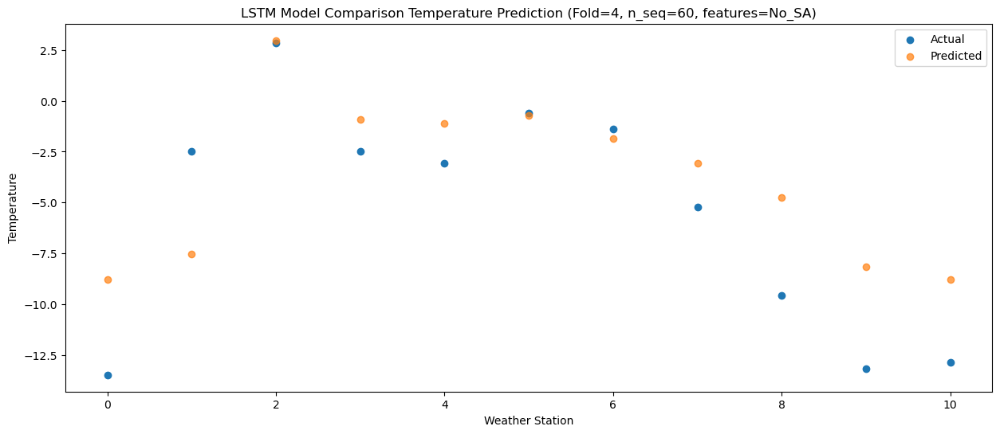

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    1.25  -0.246226
1                 1   -0.88   1.023773
2                 2   12.19  11.513772
3                 3    8.49   7.623774
4                 4    7.85   7.443774
5                 5    8.66   7.823773
6                 6    5.03   6.693773
7                 7    7.03   5.453773
8                 8    2.38   3.773773
9                 9    0.67   0.393774
10               10   -2.99  -0.246227


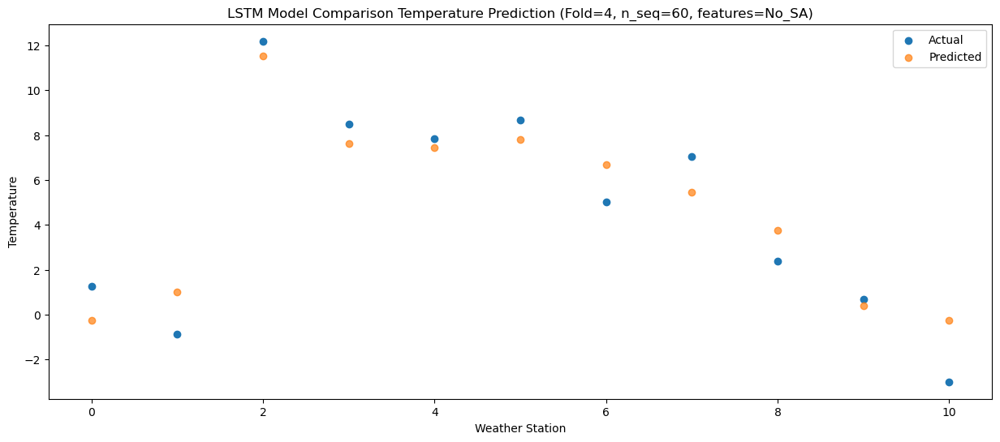

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    4.16   4.065550
1                 1    0.56   5.335549
2                 2   13.26  15.825547
3                 3   10.18  11.935550
4                 4   10.03  11.755550
5                 5   10.89  12.135548
6                 6    7.76  11.005549
7                 7    8.93   9.765549
8                 8    6.03   8.085548
9                 9    4.38   4.705550
10               10    0.81   4.065549


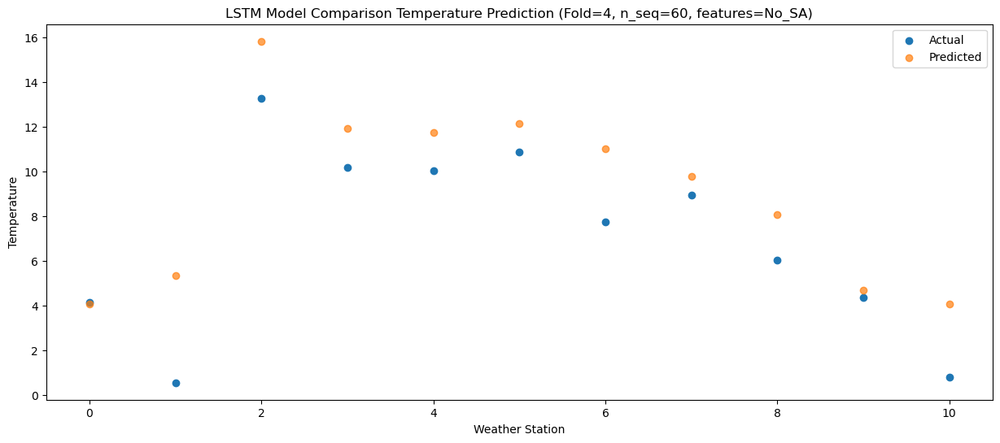

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    8.37   8.918528
1                 1    4.60  10.188527
2                 2   17.73  20.678525
3                 3   14.34  16.788528
4                 4   13.56  16.608528
5                 5   16.38  16.988526
6                 6   11.21  15.858527
7                 7   12.97  14.618527
8                 8   10.44  12.938524
9                 9    9.16   9.558528
10               10    5.34   8.918527


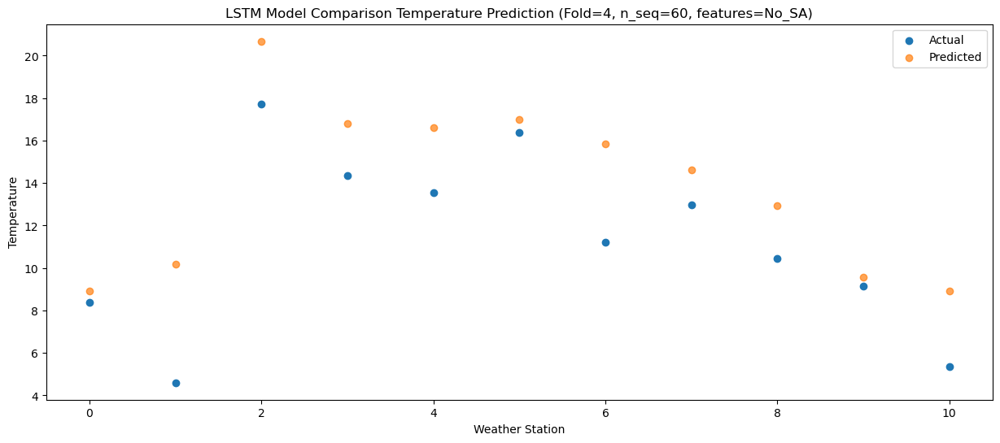

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   16.28  15.979725
1                 1    6.23  17.249724
2                 2   21.99  27.739722
3                 3   20.02  23.849725
4                 4   20.41  23.669725
5                 5   21.34  24.049723
6                 6   15.23  22.919724
7                 7   19.27  21.679724
8                 8   17.68  19.999721
9                 9   16.55  16.619725
10               10   12.23  15.979724


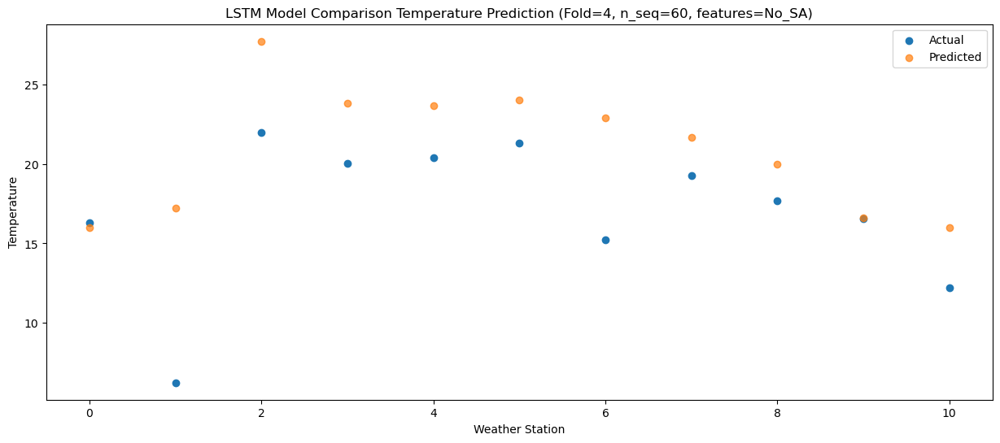

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   17.08  16.365261
1                 1    6.60  17.635260
2                 2   22.65  28.125258
3                 3   21.61  24.235261
4                 4   21.90  24.055261
5                 5   21.08  24.435259
6                 6   16.97  23.305260
7                 7   20.56  22.065260
8                 8   18.25  20.385257
9                 9   16.26  17.005261
10               10   12.39  16.365260


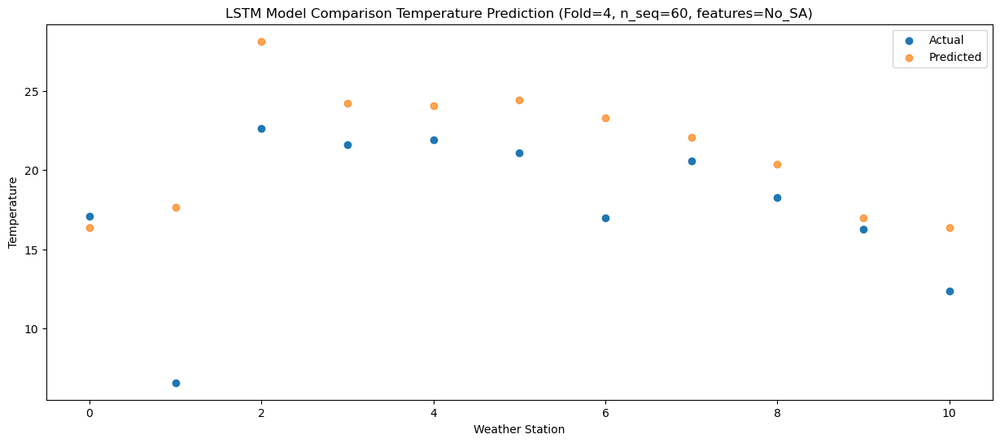

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   17.48  17.142210
1                 1    6.88  18.412209
2                 2   23.30  28.902207
3                 3   21.98  25.012210
4                 4   22.27  24.832210
5                 5   21.40  25.212208
6                 6   17.10  24.082209
7                 7   21.08  22.842209
8                 8   19.11  21.162206
9                 9   16.54  17.782210
10               10   13.59  17.142209


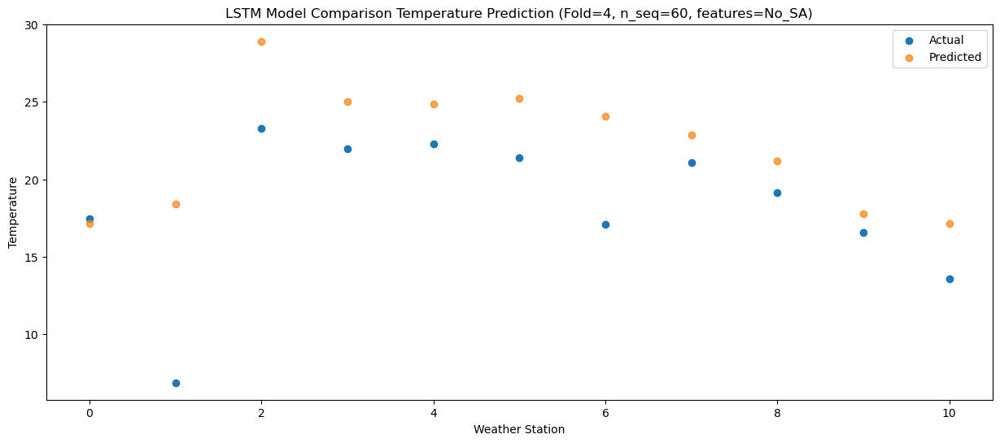

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   14.29  13.596504
1                 1    5.59  14.866503
2                 2   20.18  25.356501
3                 3   19.19  21.466504
4                 4   18.84  21.286504
5                 5   20.71  21.666503
6                 6   13.13  20.536503
7                 7   18.04  19.296503
8                 8   15.62  17.616501
9                 9   13.43  14.236505
10               10    9.30  13.596503


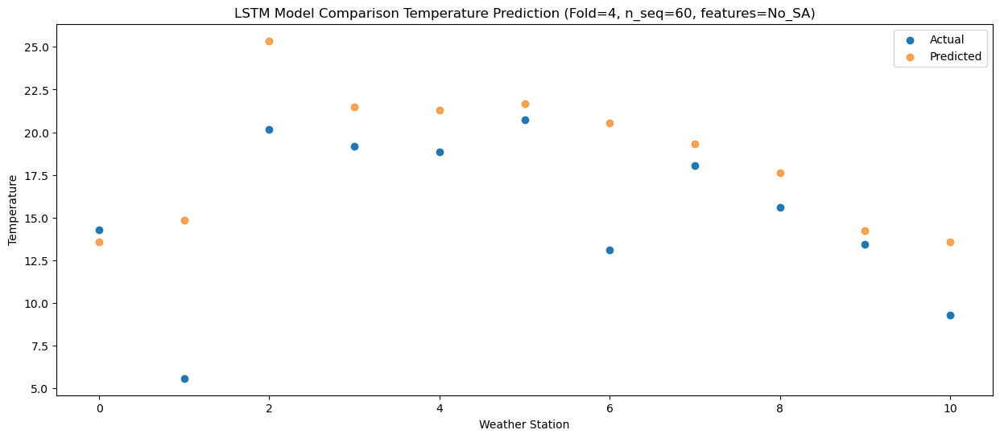

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    7.16   9.213121
1                 1    3.75  10.483120
2                 2   16.79  20.973118
3                 3   14.54  17.083121
4                 4   13.97  16.903121
5                 5   15.01  17.283120
6                 6    9.33  16.153120
7                 7   12.27  14.913120
8                 8   10.27  13.233118
9                 9    7.97   9.853122
10               10    5.77   9.213120


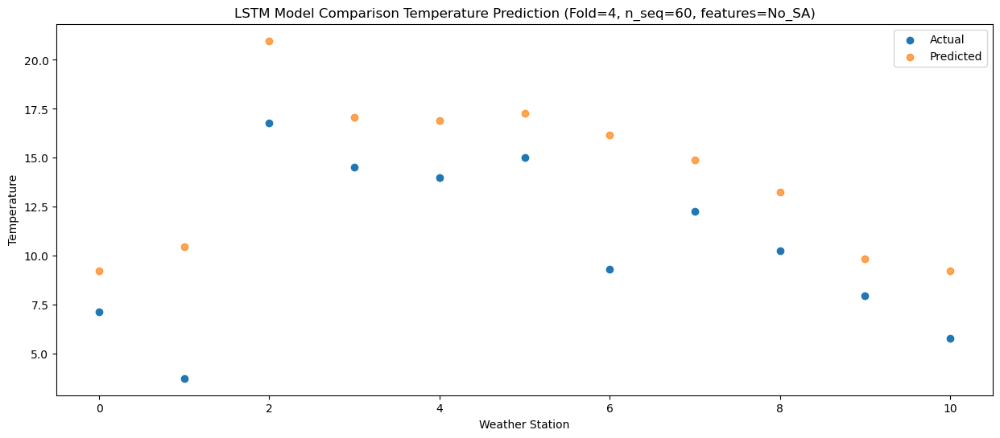

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    0.10   0.016345
1                 1   -3.41   1.286345
2                 2    8.12  11.776343
3                 3    6.54   7.886345
4                 4    6.13   7.706345
5                 5    8.07   8.086345
6                 6    1.17   6.956345
7                 7    4.33   5.716344
8                 8   -0.59   4.036343
9                 9   -2.34   0.656346
10               10   -4.63   0.016344


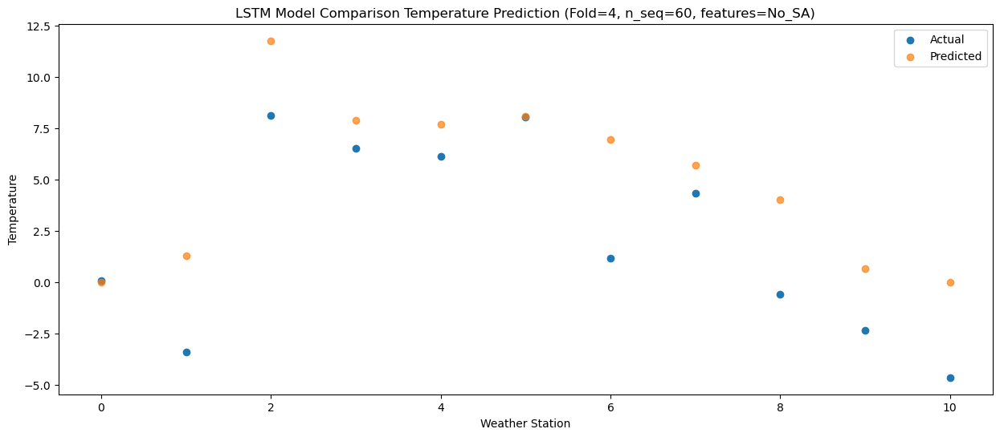

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0   -1.69  -0.518366
1                 1   -1.61   0.751634
2                 2   11.63  11.241632
3                 3    8.54   7.351634
4                 4    7.87   7.171634
5                 5    8.48   7.551634
6                 6    3.08   6.421634
7                 7    5.79   5.181633
8                 8   -0.27   3.501632
9                 9   -2.59   0.121635
10               10   -5.49  -0.518367


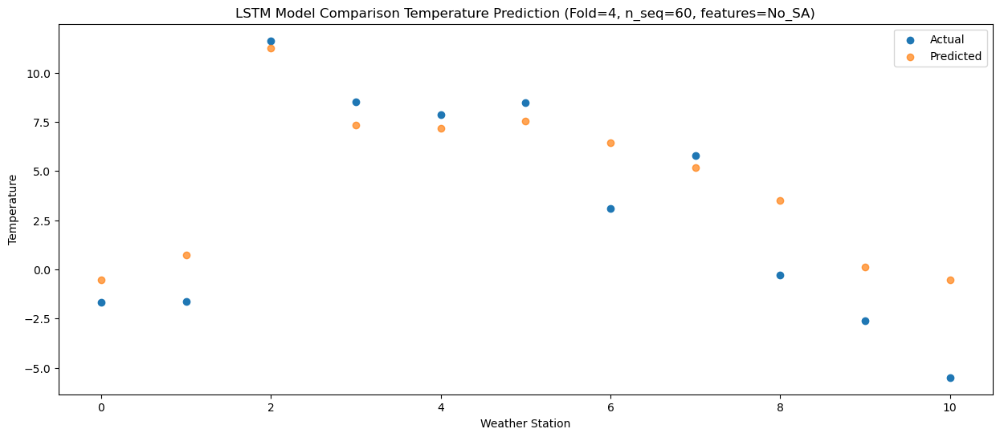

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0  -10.07  -7.855339
1                 1   -6.37  -6.585340
2                 2    3.35   3.904658
3                 3    0.07   0.014661
4                 4   -1.03  -0.165339
5                 5    1.11   0.214660
6                 6   -2.98  -0.915340
7                 7   -3.28  -2.155340
8                 8   -9.11  -3.835342
9                 9  -12.07  -7.215338
10               10  -14.32  -7.855340


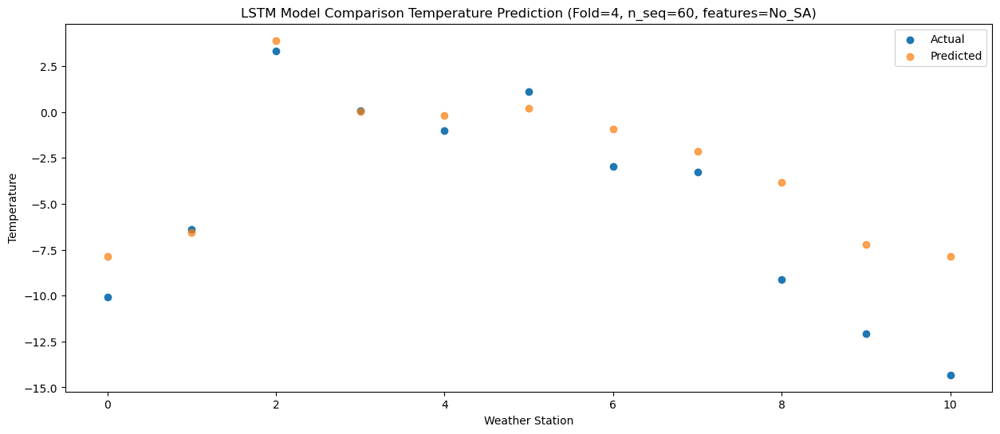

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -8.00  -5.041252
1                 1   -2.94  -3.771253
2                 2    5.71   6.718746
3                 3    0.33   2.828748
4                 4   -0.41   2.648748
5                 5    0.91   3.028747
6                 6    1.30   1.898747
7                 7   -1.22   0.658747
8                 8   -6.09  -1.021254
9                 9   -9.24  -4.401251
10               10  -10.76  -5.041253


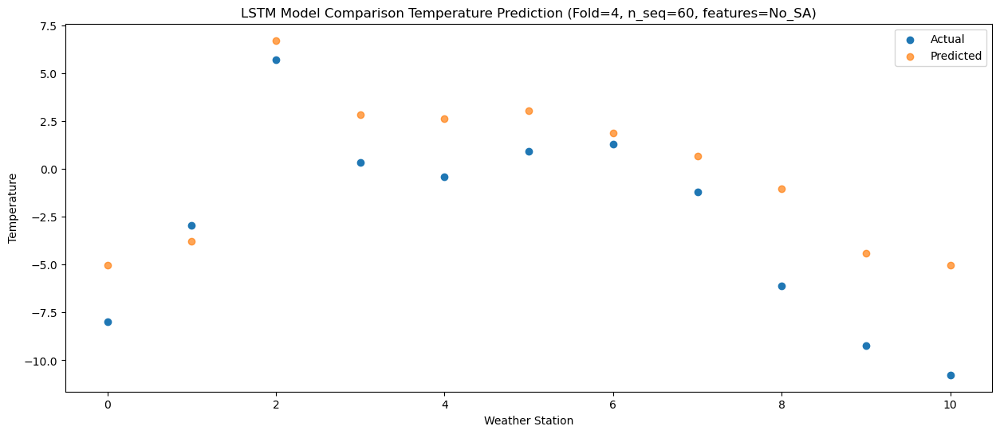

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -1.29   1.233749
1                 1   -0.12   2.503748
2                 2   10.45  12.993746
3                 3    6.51   9.103749
4                 4    6.51   8.923749
5                 5    8.23   9.303748
6                 6    4.86   8.173748
7                 7    5.44   6.933748
8                 8    1.38   5.253746
9                 9   -1.03   1.873750
10               10   -4.79   1.233748


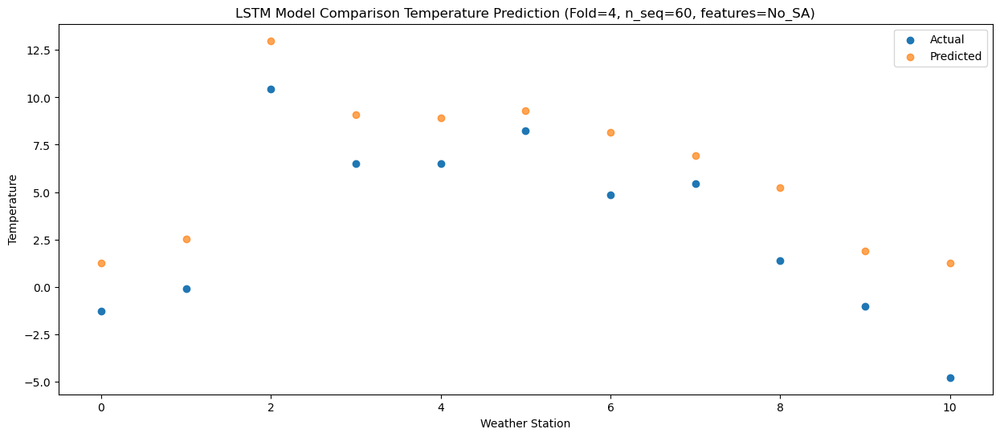

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    3.59   5.851508
1                 1    2.22   7.121507
2                 2   14.66  17.611505
3                 3   12.56  13.721508
4                 4   13.20  13.541508
5                 5   15.74  13.921507
6                 6    7.52  12.791507
7                 7    9.30  11.551507
8                 8    5.16   9.871505
9                 9    3.09   6.491509
10               10   -0.79   5.851507


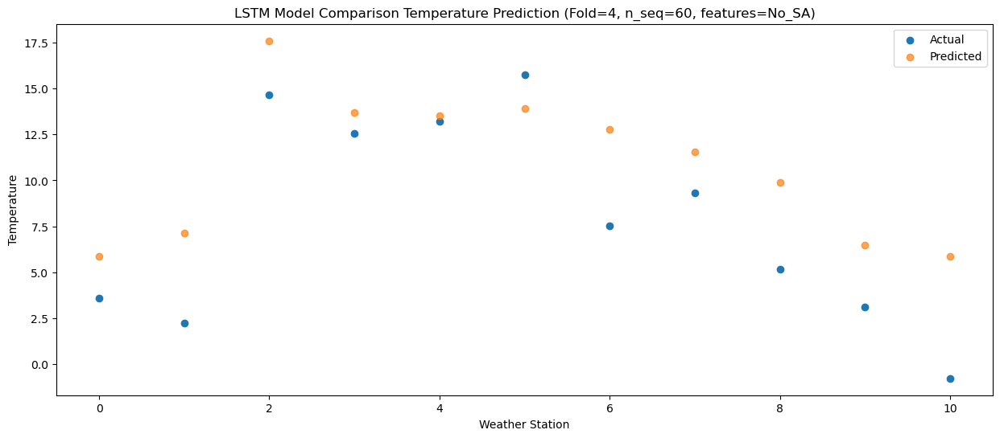

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   10.53  13.185841
1                 1    5.04  14.455840
2                 2   20.46  24.945838
3                 3   17.27  21.055841
4                 4   18.03  20.875841
5                 5   21.43  21.255840
6                 6   13.50  20.125840
7                 7   14.97  18.885840
8                 8   13.66  17.205838
9                 9   11.62  13.825842
10               10    7.79  13.185840


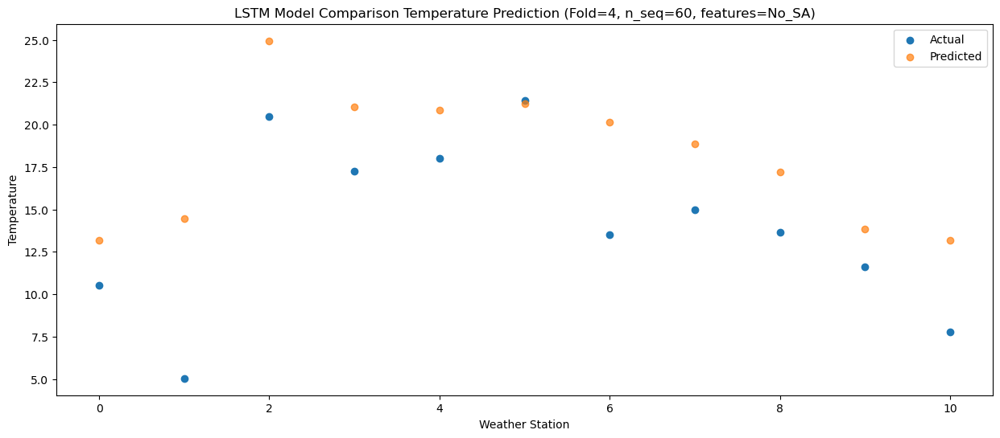

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   16.44  17.685514
1                 1    6.76  18.955513
2                 2   23.75  29.445511
3                 3   21.82  25.555514
4                 4   22.70  25.375514
5                 5   23.80  25.755513
6                 6   16.71  24.625513
7                 7   20.29  23.385513
8                 8   18.14  21.705511
9                 9   16.23  18.325515
10               10   11.06  17.685513


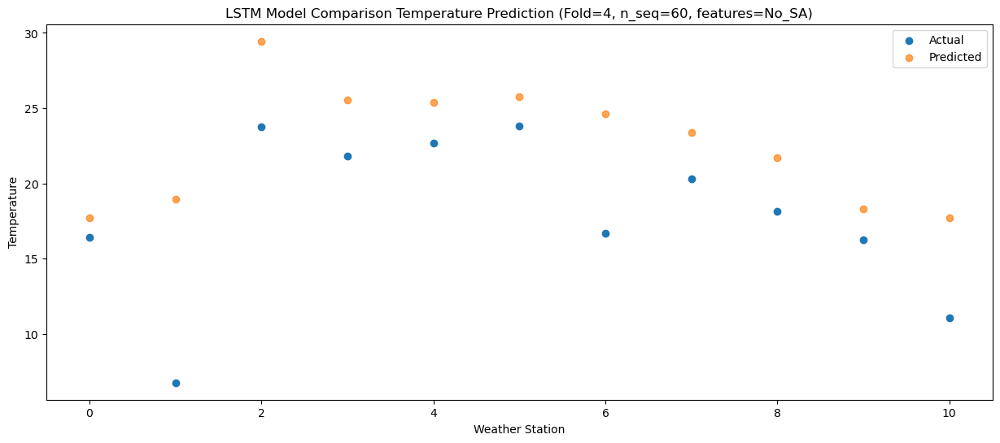

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   18.96  19.413675
1                 1    7.13  20.683674
2                 2   23.95  31.173672
3                 3   25.12  27.283675
4                 4   26.12  27.103675
5                 5   25.70  27.483674
6                 6   17.98  26.353674
7                 7   23.99  25.113674
8                 8   20.08  23.433672
9                 9   17.05  20.053676
10               10   13.66  19.413674


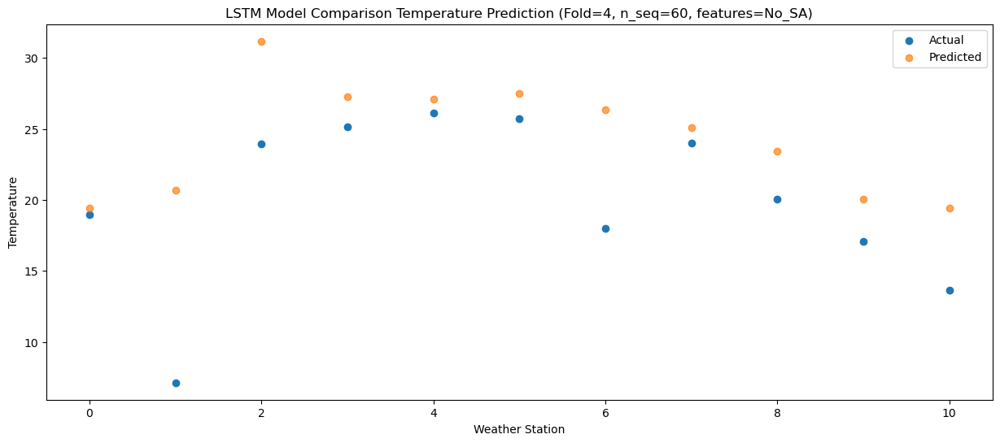

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   17.30  18.203623
1                 1    7.08  19.473622
2                 2   22.41  29.963620
3                 3   22.39  26.073623
4                 4   23.28  25.893623
5                 5   22.40  26.273622
6                 6   16.46  25.143622
7                 7   20.47  23.903622
8                 8   17.85  22.223620
9                 9   15.75  18.843624
10               10   12.59  18.203622


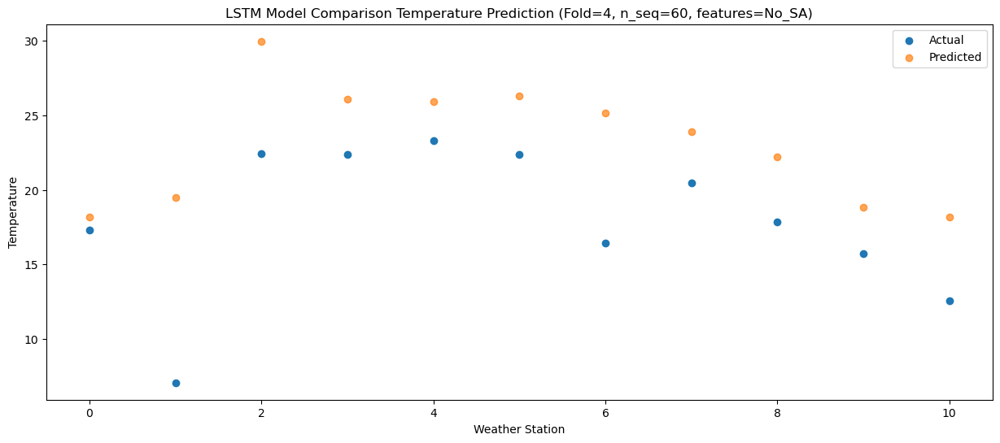

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   13.39  14.418694
1                 1    5.64  15.688693
2                 2   20.34  26.178691
3                 3   18.96  22.288694
4                 4   19.19  22.108694
5                 5   19.50  22.488693
6                 6   13.37  21.358693
7                 7   16.88  20.118693
8                 8   13.94  18.438691
9                 9   11.61  15.058695
10               10    8.54  14.418693


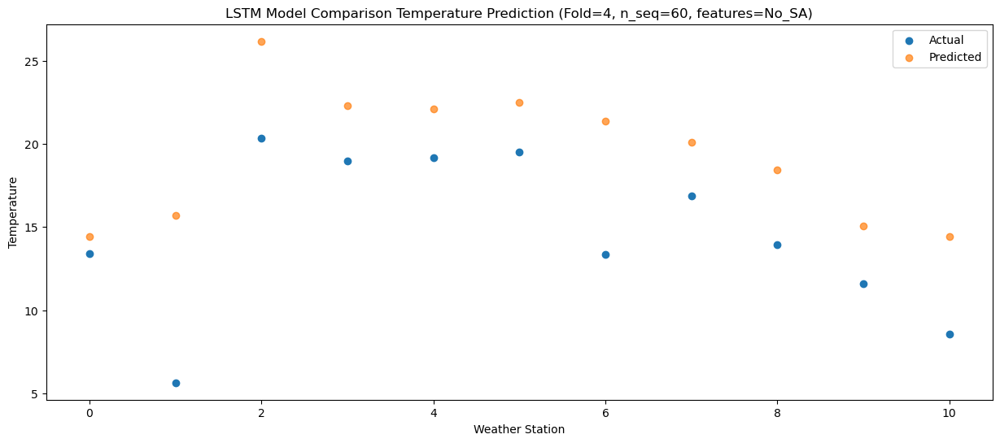

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    6.04   7.660749
1                 1    1.81   8.930748
2                 2   14.21  19.420746
3                 3   12.09  15.530749
4                 4   12.04  15.350749
5                 5   12.69  15.730748
6                 6    6.50  14.600748
7                 7   10.51  13.360748
8                 8    6.45  11.680746
9                 9    4.14   8.300750
10               10    1.68   7.660748


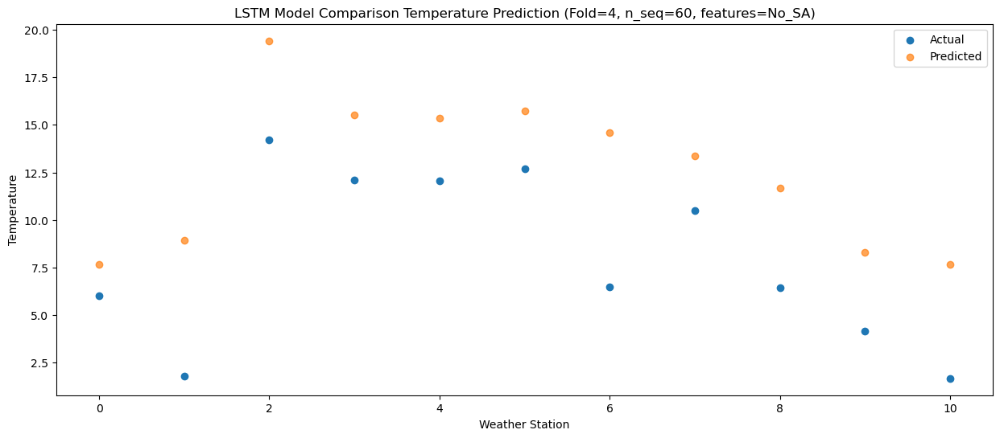

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0   -2.29   2.744786
1                 1    0.35   4.014785
2                 2    9.62  14.504783
3                 3    5.04  10.614786
4                 4    4.95  10.434786
5                 5    4.84  10.814785
6                 6    3.80   9.684785
7                 7    3.96   8.444785
8                 8    0.66   6.764783
9                 9   -1.40   3.384786
10               10   -2.40   2.744785


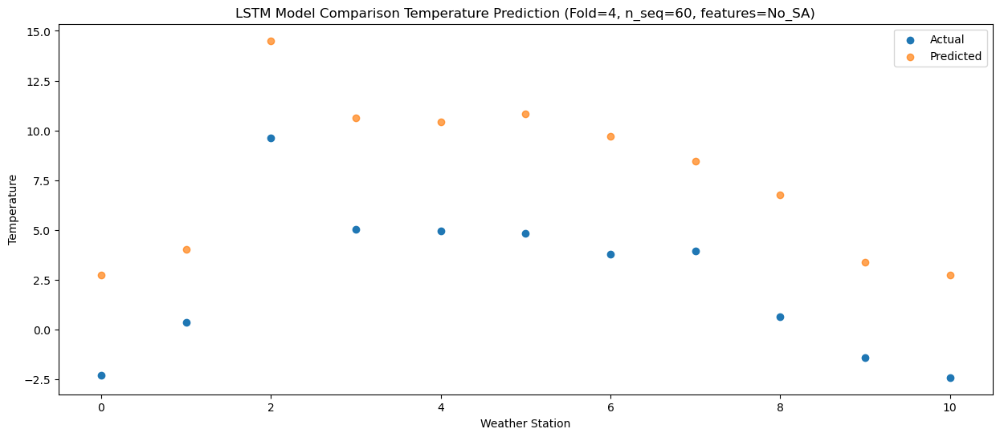

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -8.43  -2.257911
1                 1   -4.50  -0.987912
2                 2    7.19   9.502086
3                 3    2.35   5.612089
4                 4    1.98   5.432089
5                 5    3.24   5.812088
6                 6   -2.15   4.682088
7                 7   -0.89   3.442088
8                 8   -5.12   1.762086
9                 9   -8.13  -1.617910
10               10   -9.11  -2.257912


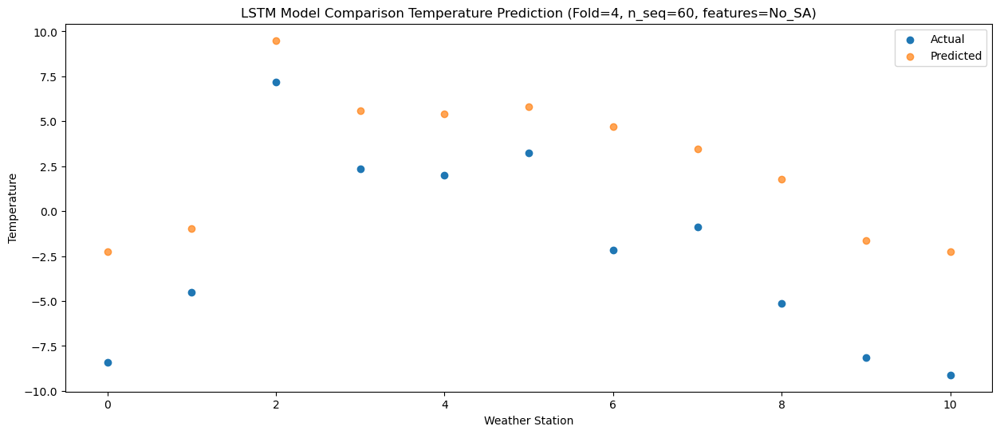

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -6.47  -0.905326
1                 1   -4.65   0.364673
2                 2    7.60  10.854671
3                 3    3.34   6.964674
4                 4    2.75   6.784674
5                 5    3.61   7.164673
6                 6    0.87   6.034673
7                 7    0.76   4.794673
8                 8   -3.16   3.114671
9                 9   -5.89  -0.265325
10               10   -7.48  -0.905327


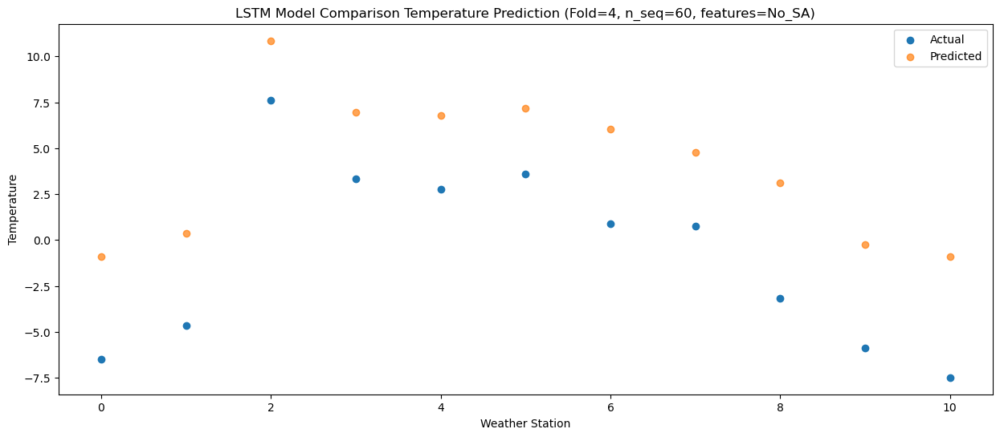

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -4.72  -0.503949
1                 1   -1.35   0.766050
2                 2    9.54  11.256048
3                 3    3.40   7.366051
4                 4    2.98   7.186051
5                 5    3.78   7.566050
6                 6    4.29   6.436050
7                 7    2.90   5.196050
8                 8   -1.57   3.516048
9                 9   -4.70   0.136052
10               10   -7.34  -0.503950


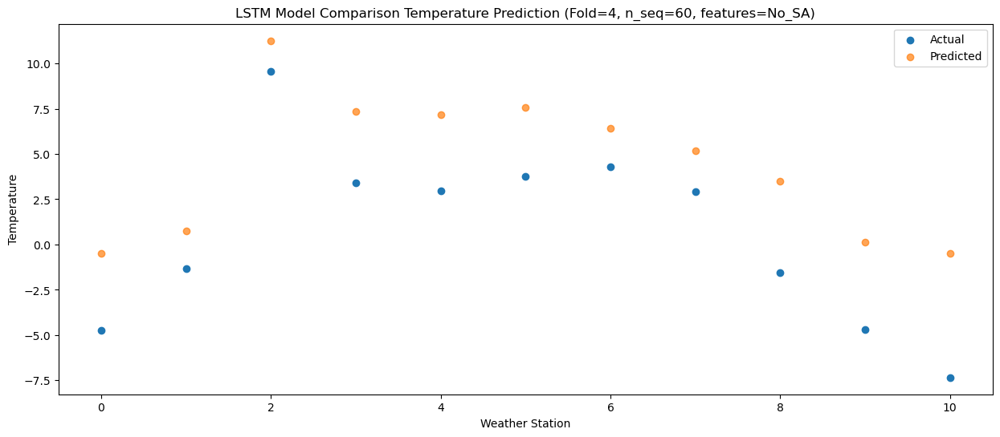

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -2.54   2.245088
1                 1    0.37   3.515087
2                 2   11.69  14.005085
3                 3    7.93  10.115088
4                 4    7.83   9.935088
5                 5    8.85  10.315087
6                 6    4.77   9.185087
7                 7    4.62   7.945087
8                 8   -0.30   6.265085
9                 9   -2.16   2.885089
10               10   -6.46   2.245087


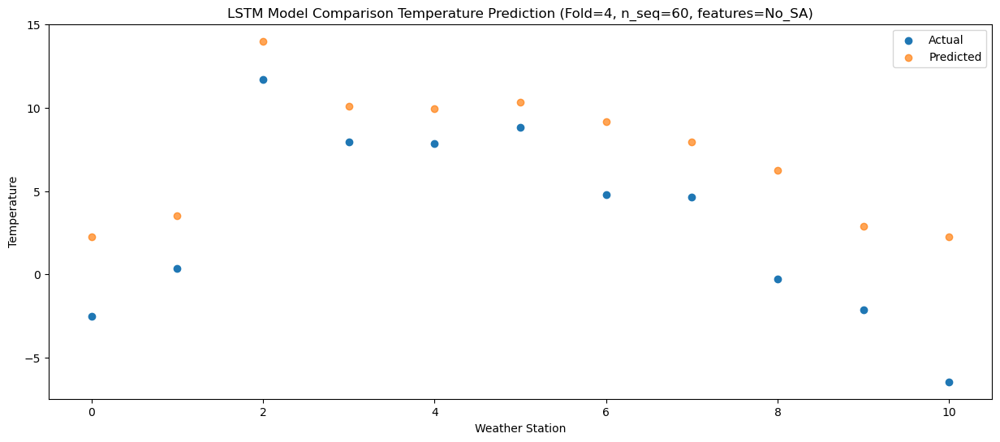

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    5.29   8.367309
1                 1    3.09   9.637306
2                 2   13.44  20.127306
3                 3   10.53  16.237307
4                 4   10.48  16.057307
5                 5   13.07  16.437308
6                 6    7.88  15.307308
7                 7   10.24  14.067306
8                 8    6.20  12.387304
9                 9    5.17   9.007308
10               10    2.01   8.367306


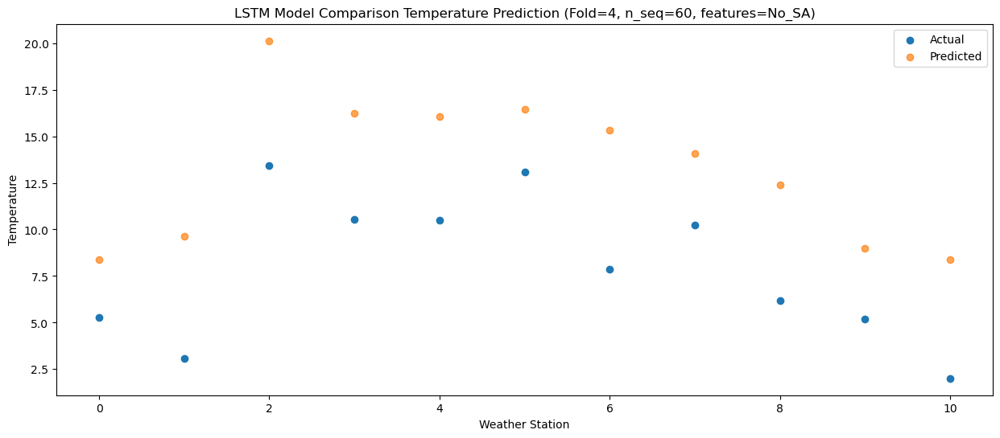

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   11.10  13.008684
1                 1    3.87  14.278681
2                 2   18.30  24.768681
3                 3   16.21  20.878682
4                 4   16.64  20.698682
5                 5   17.99  21.078683
6                 6   10.50  19.948683
7                 7   15.02  18.708681
8                 8   11.91  17.028680
9                 9   10.93  13.648683
10               10    5.70  13.008681


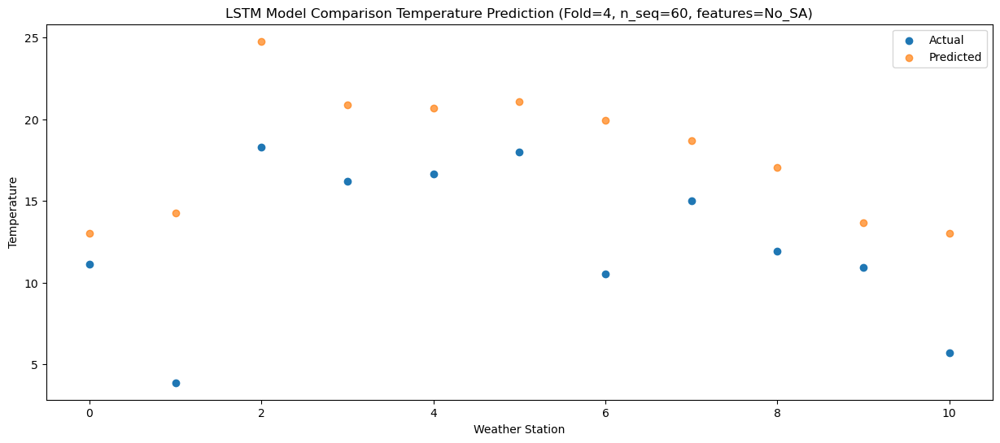

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   16.01  17.920932
1                 1    6.08  19.190929
2                 2   21.89  29.680929
3                 3   20.40  25.790930
4                 4   21.75  25.610930
5                 5   24.47  25.990931
6                 6   14.14  24.860931
7                 7   19.10  23.620929
8                 8   15.79  21.940927
9                 9   15.24  18.560931
10               10   10.01  17.920929


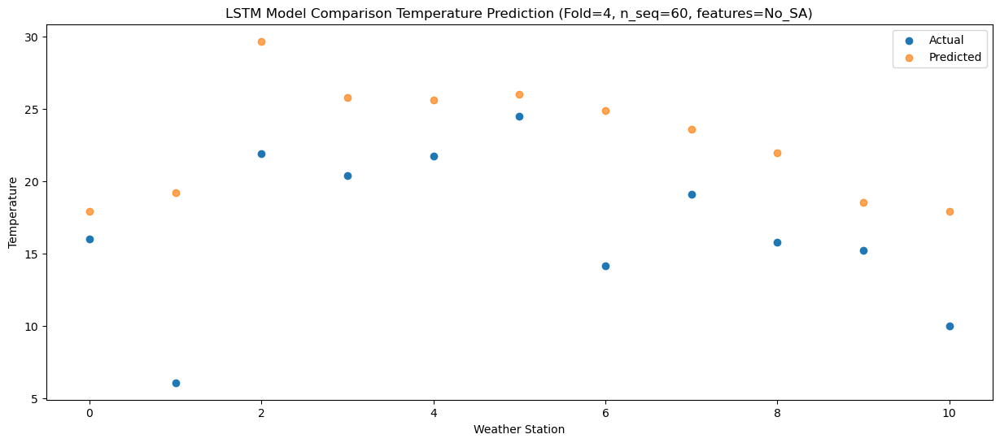

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   17.32  21.229246
1                 1    7.69  22.499243
2                 2   23.67  32.989243
3                 3   22.95  29.099244
4                 4   24.83  28.919244
5                 5   25.93  29.299245
6                 6   18.01  28.169245
7                 7   21.06  26.929243
8                 8   18.52  25.249242
9                 9   16.77  21.869245
10               10   13.10  21.229243


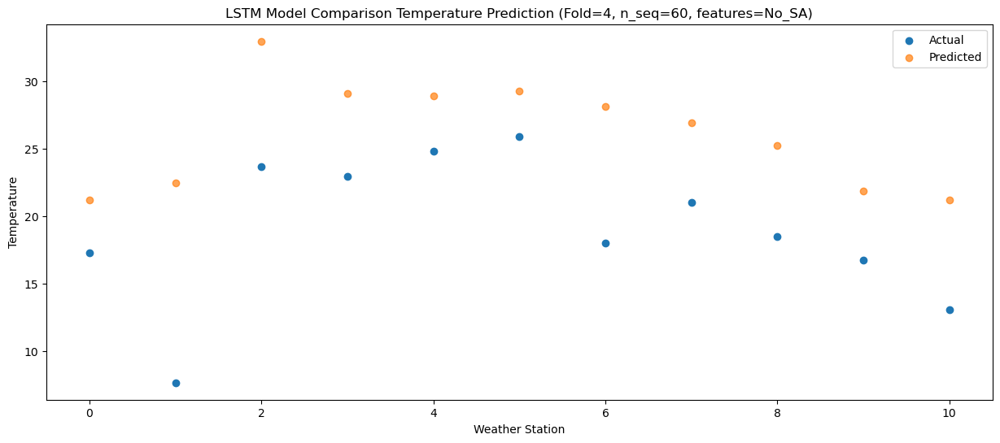

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   17.12  19.986352
1                 1    8.20  21.256350
2                 2   25.75  31.746349
3                 3   25.50  27.856350
4                 4   26.70  27.676350
5                 5   26.02  28.056351
6                 6   17.45  26.926352
7                 7   20.87  25.686349
8                 8   17.36  24.006348
9                 9   15.51  20.626351
10               10   11.77  19.986349


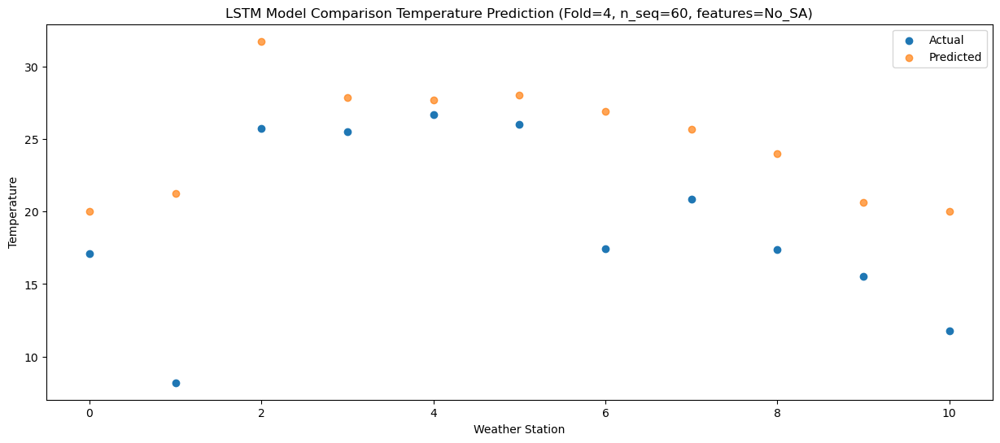

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   14.29  17.655938
1                 1    6.10  18.925936
2                 2   22.00  29.415935
3                 3   20.80  25.525936
4                 4   21.61  25.345936
5                 5   22.54  25.725937
6                 6   13.61  24.595938
7                 7   16.93  23.355935
8                 8   14.27  21.675933
9                 9   12.47  18.295937
10               10    9.43  17.655935


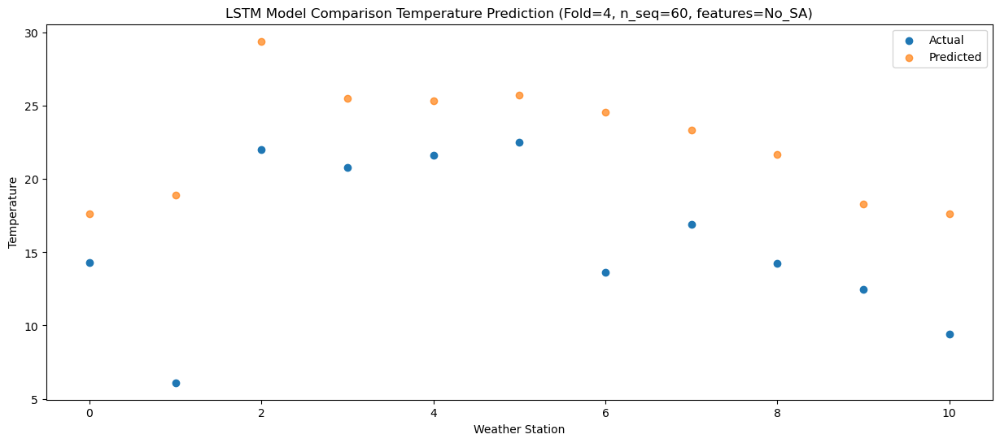

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    7.17  11.848240
1                 1    2.45  13.118238
2                 2   15.89  23.608237
3                 3   12.67  19.718238
4                 4   12.78  19.538238
5                 5   14.01  19.918239
6                 6    8.17  18.788240
7                 7   11.03  17.548237
8                 8    8.13  15.868235
9                 9    6.06  12.488239
10               10    4.17  11.848237


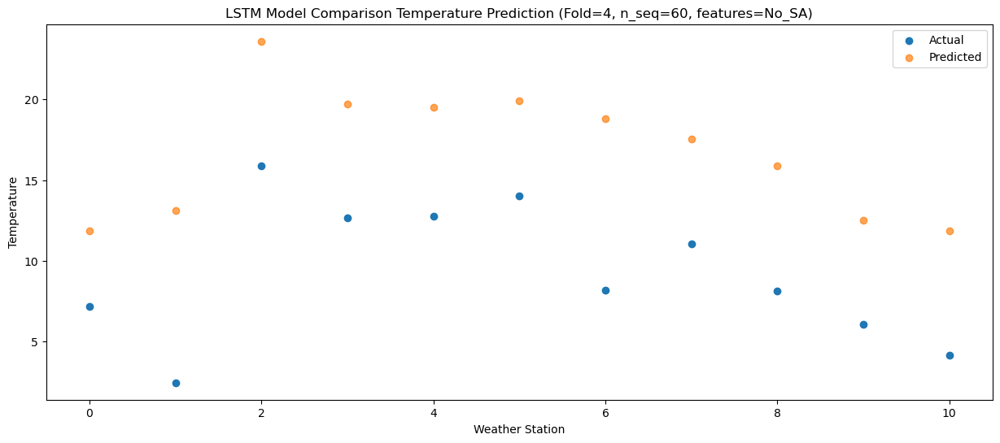

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    0.92   4.404426
1                 1   -1.26   5.674425
2                 2    8.93  16.164424
3                 3    6.60  12.274425
4                 4    6.25  12.094425
5                 5    7.30  12.474426
6                 6    2.44  11.344426
7                 7    5.13  10.104424
8                 8    1.06   8.424422
9                 9   -1.03   5.044426
10               10   -3.22   4.404424


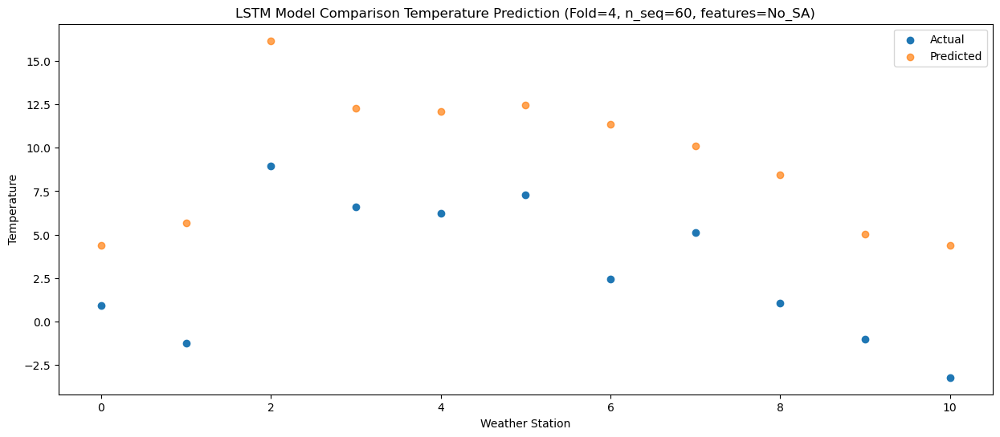

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -2.48   3.251330
1                 1   -3.38   4.521328
2                 2    6.38  15.011327
3                 3    3.58  11.121328
4                 4    3.12  10.941328
5                 5    4.50  11.321329
6                 6    0.23  10.191330
7                 7    2.25   8.951327
8                 8   -0.83   7.271325
9                 9   -3.02   3.891329
10               10   -3.88   3.251327


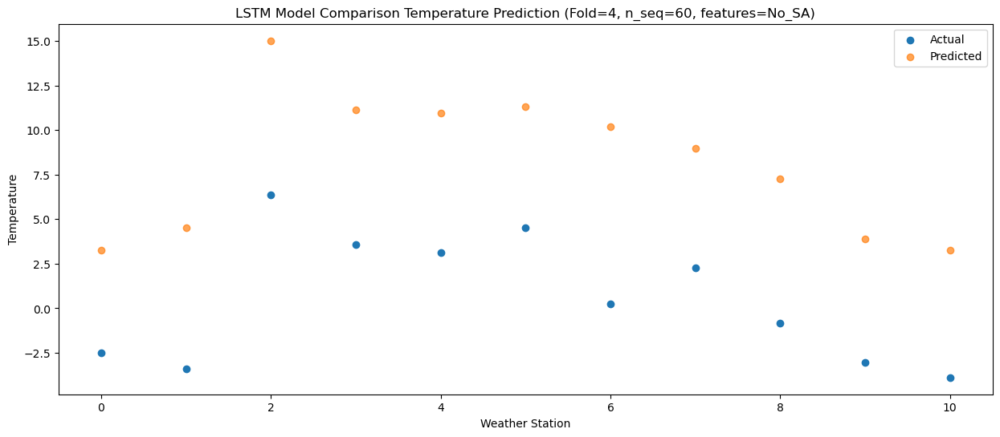

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0  -11.07  -1.910770
1                 1   -4.80  -0.640772
2                 2    2.19   9.849227
3                 3   -1.94   5.959228
4                 4   -2.23   5.779228
5                 5    0.25   6.159229
6                 6   -2.21   5.029230
7                 7   -4.91   3.789227
8                 8   -7.11   2.109225
9                 9  -10.60  -1.270771
10               10   -9.65  -1.910773


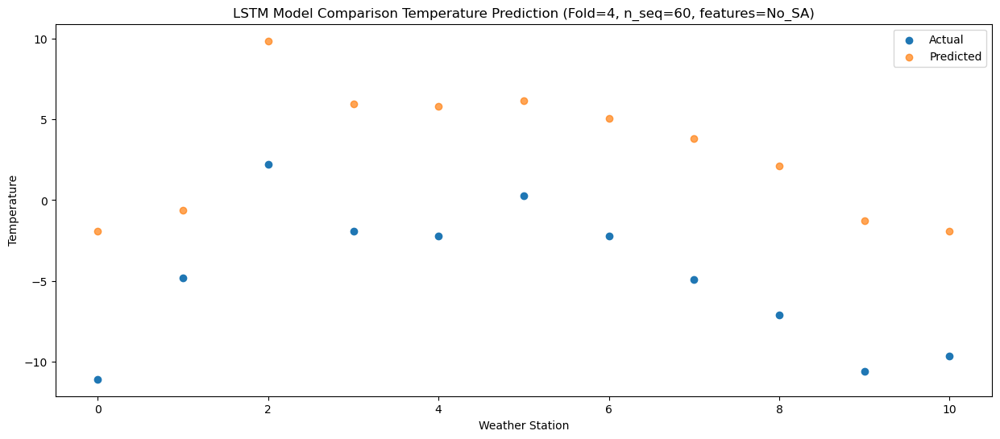

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    0.04   2.230213
1                 1   -5.07   3.500211
2                 2    8.51  13.990210
3                 3    6.47  10.100211
4                 4    6.09   9.920211
5                 5    7.07  10.300212
6                 6    1.20   9.170213
7                 7    5.00   7.930210
8                 8   -0.77   6.250208
9                 9   -2.83   2.870212
10               10   -6.17   2.230210


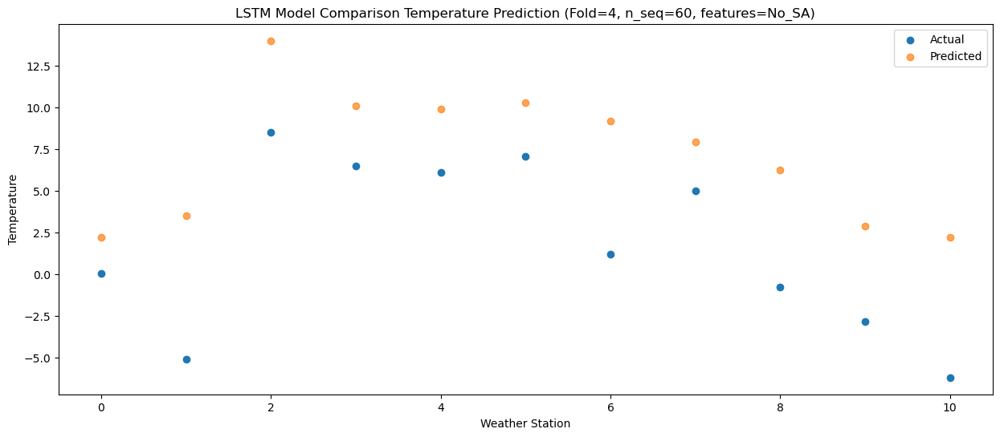

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    2.57   6.294761
1                 1   -0.17   7.564759
2                 2   10.74  18.054758
3                 3    8.88  14.164759
4                 4    8.66  13.984759
5                 5    9.67  14.364760
6                 6    4.99  13.234761
7                 7    7.43  11.994758
8                 8    3.67  10.314757
9                 9    1.32   6.934760
10               10   -2.82   6.294758


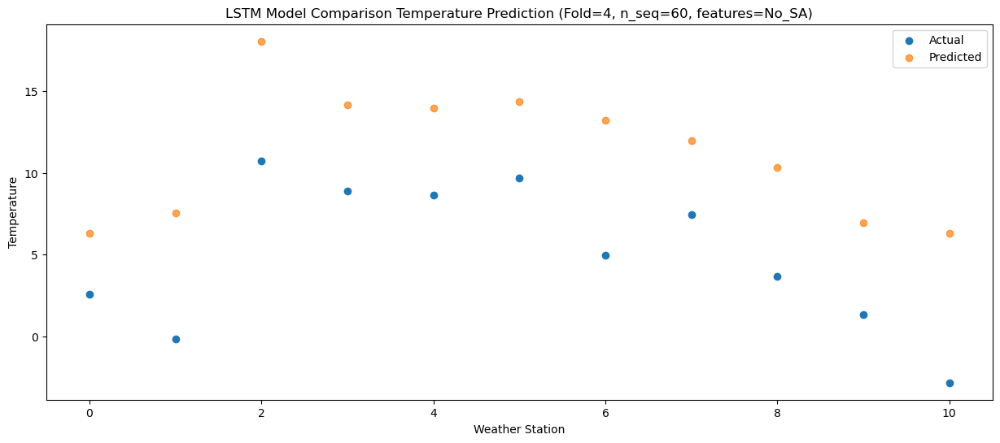

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    7.19  10.813536
1                 1    0.88  12.083534
2                 2   14.56  22.573533
3                 3   12.73  18.683536
4                 4   12.71  18.503536
5                 5   14.63  18.883535
6                 6    9.22  17.753536
7                 7   11.57  16.513535
8                 8    8.25  14.833531
9                 9    5.81  11.453535
10               10    2.90  10.813533


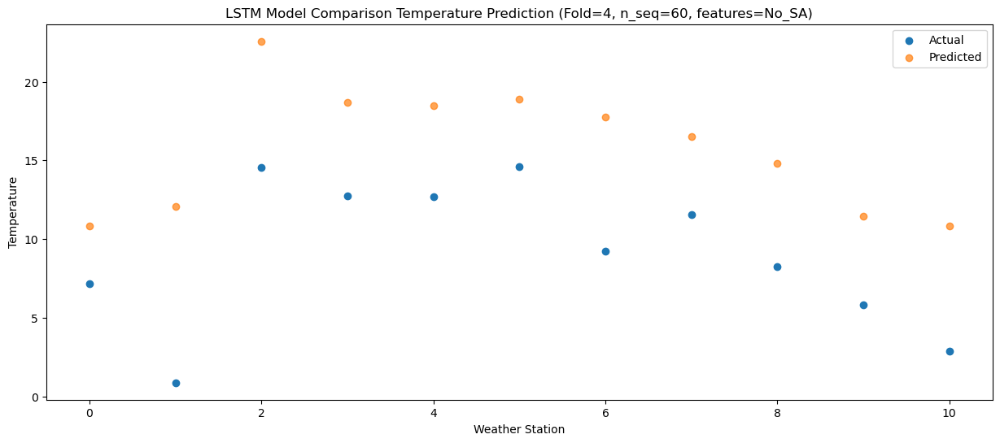

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   12.20  17.394435
1                 1    6.33  18.664433
2                 2   20.08  29.154432
3                 3   17.49  25.264435
4                 4   17.51  25.084435
5                 5   19.92  25.464434
6                 6   13.29  24.334435
7                 7   16.22  23.094434
8                 8   14.85  21.414430
9                 9   12.84  18.034434
10               10    9.00  17.394432


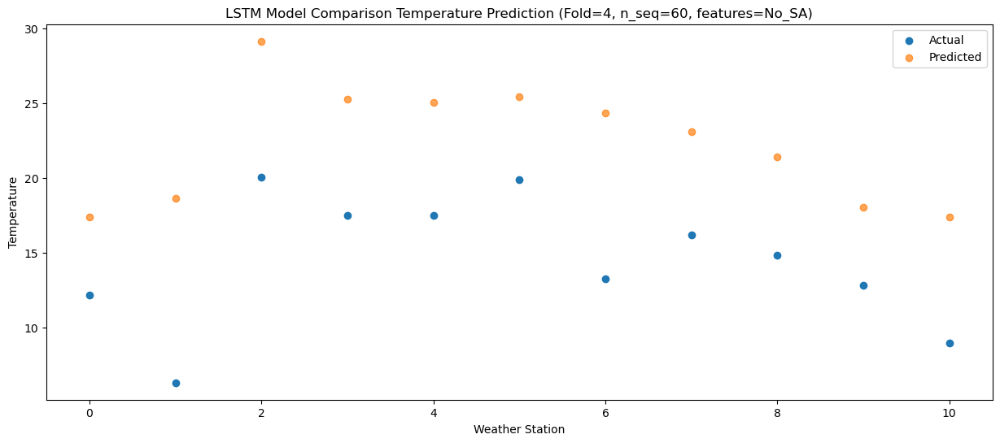

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   17.39  22.188084
1                 1    6.98  23.458082
2                 2   22.71  33.948081
3                 3   21.52  30.058084
4                 4   21.96  29.878084
5                 5   23.93  30.258083
6                 6   16.71  29.128084
7                 7   19.94  27.888083
8                 8   18.21  26.208080
9                 9   16.81  22.828083
10               10   12.16  22.188081


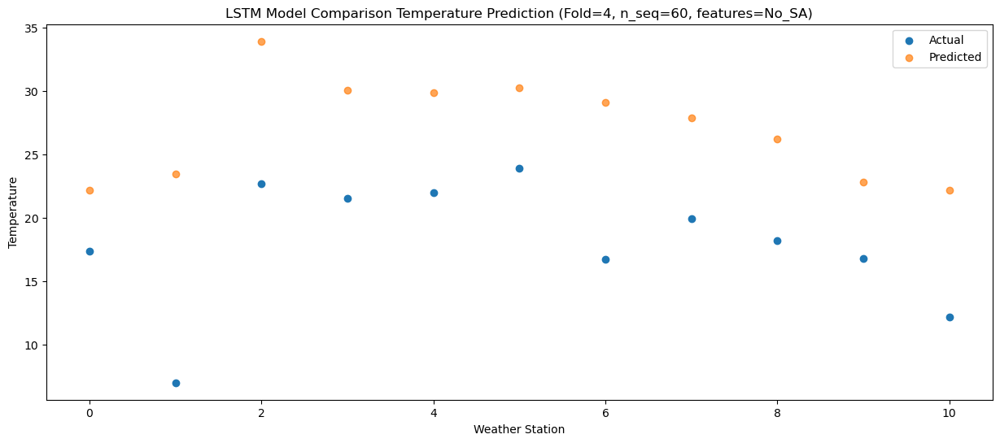

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   18.15  22.415294
1                 1    7.67  23.685292
2                 2   23.73  34.175291
3                 3   22.42  30.285294
4                 4   22.67  30.105294
5                 5   22.76  30.485293
6                 6   18.17  29.355294
7                 7   20.24  28.115293
8                 8   18.22  26.435289
9                 9   15.84  23.055293
10               10   13.68  22.415291


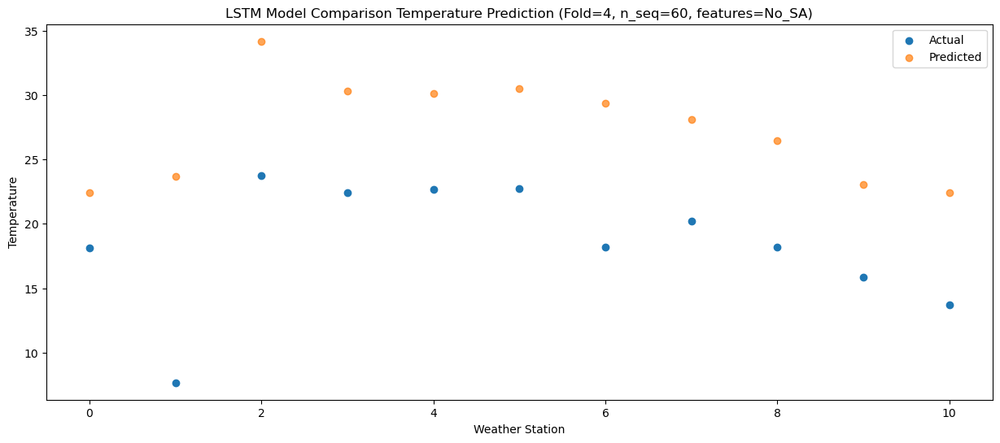

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   16.66  22.030505
1                 1    7.37  23.300503
2                 2   24.30  33.790502
3                 3   24.17  29.900505
4                 4   24.63  29.720505
5                 5   25.22  30.100504
6                 6   17.01  28.970505
7                 7   20.68  27.730504
8                 8   18.14  26.050501
9                 9   15.50  22.670504
10               10   12.54  22.030502


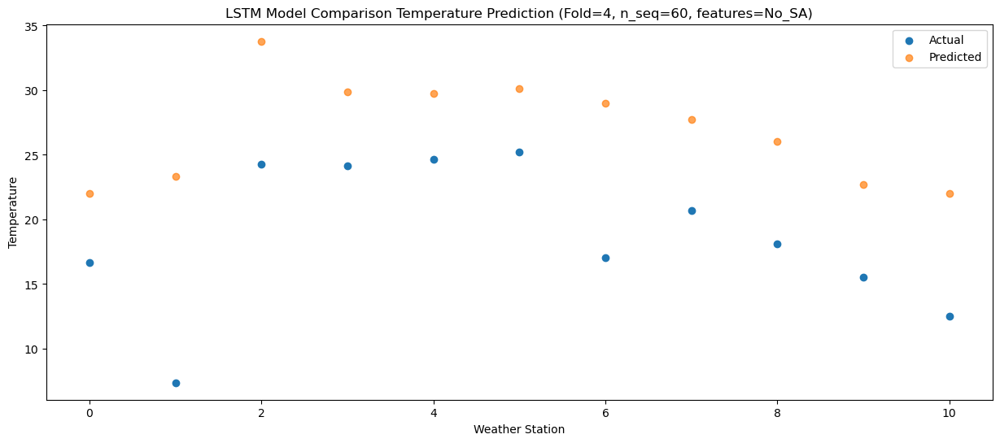

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   14.23  19.722397
1                 1    6.50  20.992395
2                 2   20.69  31.482394
3                 3   18.78  27.592397
4                 4   18.62  27.412397
5                 5   18.77  27.792396
6                 6   14.57  26.662397
7                 7   16.54  25.422396
8                 8   15.53  23.742392
9                 9   12.27  20.362396
10               10   10.27  19.722394


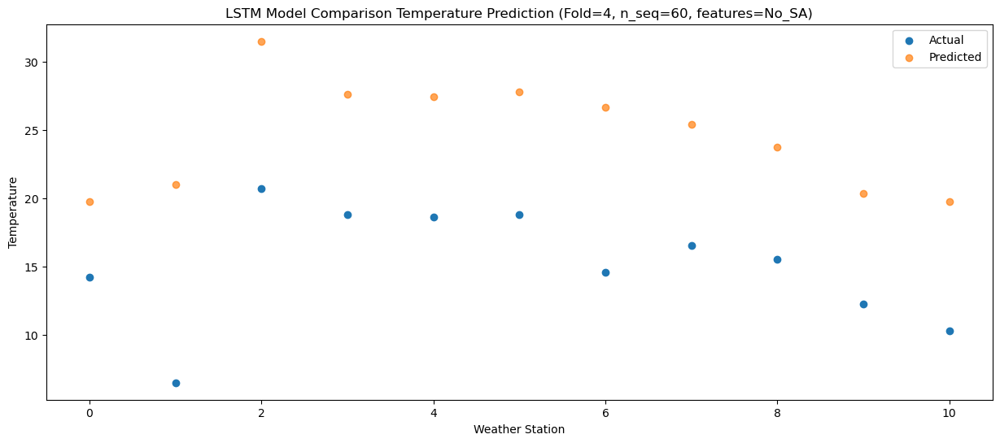

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0   10.10  14.596187
1                 1    2.73  15.866185
2                 2   16.55  26.356184
3                 3   16.03  22.466187
4                 4   16.20  22.286187
5                 5   17.06  22.666186
6                 6    8.95  21.536187
7                 7   12.86  20.296186
8                 8    9.60  18.616182
9                 9    7.20  15.236186
10               10    3.80  14.596184


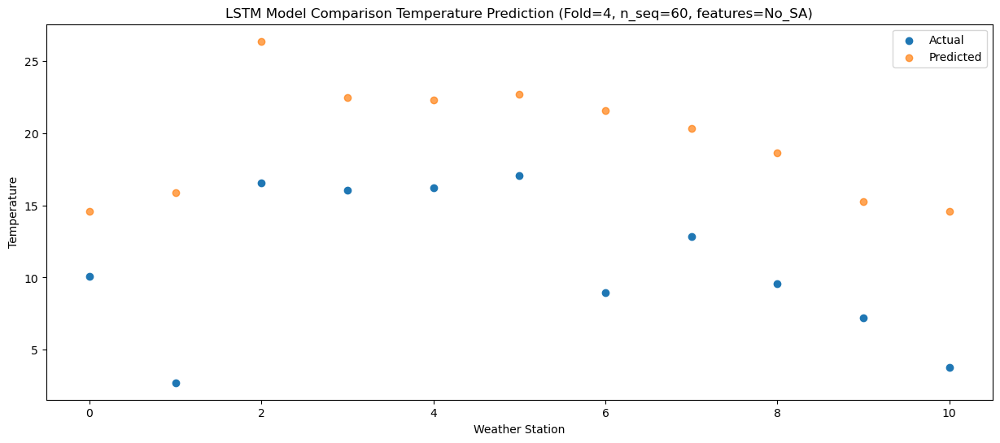

f, t:
[[ -2.86  -2.38   6.75   4.23   3.65   5.12   0.86   2.01  -2.64  -4.88
   -6.79]
 [ -4.52  -2.56   6.81   2.58   1.87   3.48   0.51   1.2   -3.46  -5.2
   -7.57]
 [ -7.48  -4.02   6.62   2.82   2.49   2.75   0.34  -0.45  -4.39  -7.64
   -8.77]
 [ -6.37  -2.47   6.88   2.49   2.11   1.99   0.81   0.12  -5.22  -7.89
   -9.58]
 [  1.16   1.6   14.68   9.95   9.99   9.55   6.42   7.05   1.6   -0.29
   -3.42]
 [  3.59   3.28  13.73  10.61  10.68  12.52   7.69   8.63   4.59   2.82
   -2.04]
 [  8.66   4.68  17.61  15.74  16.33  19.09  10.48  12.73  10.17   8.7
    4.7 ]
 [ 17.91   6.44  21.7   20.7   21.04  22.42  15.07  19.08  17.46  16.43
   11.19]
 [ 18.72   6.76  23.27  22.56  23.48  25.25  18.11  21.62  19.5   17.64
   14.63]
 [ 16.62   6.61  22.44  22.31  22.8   24.63  16.91  19.63  17.3   15.04
   12.22]
 [ 11.78   6.03  20.34  16.53  16.5   16.9   13.11  16.05  13.54  11.14
    8.23]
 [  3.73   4.53  15.    10.8   10.75  12.94   9.29   9.12   6.7    3.8
    2.07]
 [  1.54   1.

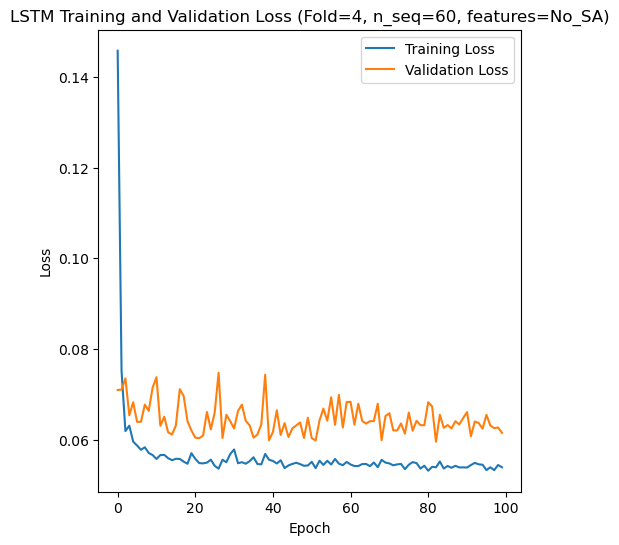

[[2.478938281855772], [4.378130958017293], [5.662208132140907], [10.646623408632232], [5.31908308363926]]
[[array(2.47893828)], [array(4.37813096)], [array(5.66220813)], [array(10.64662341)], [array(5.31908308)]]
[[2.0220083062558465], [3.5540990490877276], [4.576825826966399], [9.16052628657538], [4.295701556933649]]
[[1.3737038617405029], [1.6166992919288787], [1.7486449098665027], [4.597640853941357], [1.254412164890371]]
[[0.9012743663249408], [0.7032330118970754], [0.549288717474494], [-0.29077888458789247], [0.6588599743387921]]
[[array(-0.77392755)], [array(-0.03769663)], [array(0.17624055)], [array(1.77200986)], [array(0.38751423)]]
[[array(0.92676304)], [array(0.83133833)], [array(0.83123763)], [array(0.74657058)], [array(0.87328706)]]
[-2.98 -3.45 -3.72 ... 12.54 10.27  3.8 ]
[-3.38574501 -4.74063941 -4.58878583 ... 22.0305024  19.72239407
 14.59618386]
Accuracy Results:
RMSE for each fold:
[[2.478938281855772], [4.378130958017293], [5.662208132140907], [10.646623408632232], 

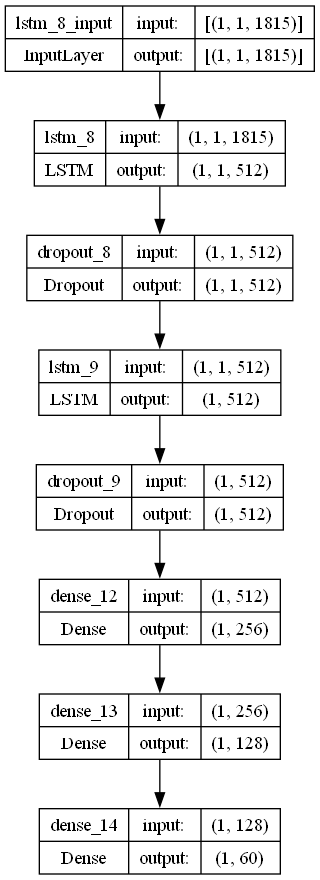

In [2]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error, r2_score
from tensorflow.keras.utils import plot_model

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def kmape (y_true, y_pred):
    return K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def kpearson (y_true, y_pred):
    mean_true = K.mean(y_true)
    mean_pred = K.mean(y_pred)
    return (K.square(K.mean((y_true - mean_true)*(y_pred - mean_pred))))/(K.mean(K.square(y_true - mean_true))*K.mean(K.square(y_pred - mean_pred)))

# fit best LSTM model using parameters found by Optuna
def create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters from best model
    lr =  0.003786634333593054 
    optimizer = Adam(learning_rate = lr)
    activation_function = 'tanh'
    lstm_units = 512
    dropout_rate = 0.19620543896566228

    # design network
    model = Sequential()
    model.add(LSTM(lstm_units, return_sequences=True, batch_input_shape=(n_batch, X.shape[1], X.shape[2]), stateful=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer, metrics=['accuracy', 'mae', rmse, mape, pearson])
        
    return model

# Make one forecast with LSTM
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# Evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# Invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # Invert the first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # Propagate the difference forecast using the inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# Inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create an array from the forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# Evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(actual, forecasts, n_lag, n_seq):

    t = np.array(actual).transpose()
    f = np.array(forecasts).transpose()

    print("f, t:")
    print(t)
    print(f)
    rmse_list = []
    mae_list = []
    skmape_list = []
    mape_list = []
    r2_list = []
    pearson_list = []
    actual_list = []

    for i in range(n_seq):
        act = [row for row in t[i]]
        predicted = [forecast for forecast in f[i]]
        rmse1 = sqrt(mean_squared_error(act, predicted))
        rmse2 = np.array(rmse(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        mae = mean_absolute_error(act, predicted)
        mse = mean_squared_error(act, predicted)
        skmape = mean_absolute_percentage_error(act, predicted)
        kmape1 = np.array(kmape(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        kpearson1 = np.array(kpearson(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        r2 = r2_score(act, predicted) 
        avg_actual = np.mean(act)
        print("Year at t+"+str(i+1)+":")
        print('t+%d SKRMSE: %f' % ((i+1), rmse1))
        print('t+%d KRMSE: %f' % ((i+1), rmse2))        
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d SKMAPE: %f' % ((i+1), skmape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))
        print('t+%d KMAPE: %f' % ((i+1), kmape1))
        print('t+%d PEARSON: %f' % ((i+1), kpearson1))
        print('t+%d AVERAGE ACTUAL: %f' % ((i+1), avg_actual))

    y_true = tf.convert_to_tensor(np.array(actual).flatten())
    y_pred = tf.convert_to_tensor(np.array(forecasts).flatten())

    rmse1 = sqrt(mean_squared_error(np.array(y_true), np.array(y_pred)))
    rmse2 = np.array(rmse(y_true, y_pred))
    mae = mean_absolute_error(np.array(y_true), np.array(y_pred))
    mse = mean_squared_error(np.array(y_true), np.array(y_pred))
    skmape = mean_absolute_percentage_error(np.array(y_true), np.array(y_pred))
    kmape1 = np.array(kmape(y_true, y_pred))
    kpearson1 = np.array(kpearson(y_true, y_pred))
    r2 = r2_score(np.array(y_true), np.array(y_pred)) 
    avg_actual = np.mean(np.array(y_true))
    rmse1_list.append(rmse1)
    rmse2_list.append(rmse2)
    mae_list.append(mae)
    skmape_list.append(skmape)
    pearson_list.append(kpearson1)
    mape_list.append(kmape1)
    r2_list.append(r2)
    actual_list.append(avg_actual)
    print("Metrics for this Fold:")
    print('SKRMSE: %f' % (rmse1))
    print('KRMSE: %f' % (rmse2))        
    print('MAE: %f' % (mae))
    print('SKMAPE: %f' % (skmape))
    print('R2_SCORE: %f' % (r2))
    print('KMAPE: %f' % (kmape1))
    print('PEARSON: %f' % (kpearson1))
    print('AVERAGE ACTUAL: %f' % (avg_actual))

    return rmse1_list, rmse2_list, mae_list, skmape_list, r2_list, mape_list, pearson_list, actual_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, actual, n_test, n_seq, n_lag):
    # Plot the entire dataset in blue
    plt.plot(series[:n_lag+2+len(forecasts)].values)
    # Plot the forecasts in red
    off_s = n_lag + 1
    off_e = off_s + len(forecasts) + 1
    xaxis = [x for x in range(off_s, off_e)]
    yaxis = [series.values[off_s]] + forecasts
    print(xaxis)
    print(yaxis)
    plt.plot(xaxis, yaxis, color='red')
    plt.xlabel("Month")
    plt.ylabel("Temperature")
    # show the plot
    plt.show()

n_batch = 1
n_test = 11
nb_epoch = 100
    
rmse1_avg_list = []
rmse2_avg_list = []
mae_avg_list = []
skmape_avg_list = []
r2_score_avg_list = []
mape_avg_list = []
pearson_avg_list = []
actual_avg_list = []
forecast_results = []
actual_results = []
    
for i in range(5):
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X = train1[:, 0:-n_seq]
    y = train1[:, -n_seq:]
    X_test = test1[:, 0:-n_seq]
    y_test = test1[:, -n_seq:]
    X_val = validation1[:, 0:-n_seq]
    y_val = validation1[:, -n_seq:]
    
    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    print(dataset)

    series = pd.Series(dataset[:, 0]) # Using first column (temperatures)

    X = X.reshape(X.shape[0], 1, X.shape[1])
    X1 = X_test
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))
    
    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test, n_seq)

    # Print out plots of actual and predicted values for weather stations
    ws = df.index[1:12]
    print(ws)
    a = []
    f = []
    for q in range(len(actual)):
        x = actual[q]
        a.append(x[0])
    for q in range(len(forecasts)):
        x = forecasts[q]
        f.append(x[0])
    print(a)
    print(f)
    # Create a DataFrame for plotting
    results_df = pd.DataFrame({
        'ws': ws,
        'Actual': a,
        'Predicted': f
    })

    print(results_df)
    
    print("Actual and Forecasts:")
    print(actual)
    print(forecasts)
    
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual Temp\tPredicted Temp\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")
    
        # plot forecasts
        dataset_df = pd.DataFrame(val_y[i])
        dataset_df = dataset_df.iloc[0:11, :]
        dataset_df = dataset_df.transpose()
        dataset = dataset_df.values

        series_ws = pd.Series(dataset[:, j]) # Using first column (temperatures)
        forecasts_ws = forecasts[j]
        actual_ws = actual[j]
        
        plot_forecasts(series_ws, forecasts_ws, actual_ws, n_test, n_seq, n_lag)

    for k in range(n_seq):
        print("Predictions for (t+"+str(k)+"):")
        # Print out plots of actual and predicted values for each weather station
        results = []

        # Create a DataFrame for plotting
        for j in range(11):
            results.append([j, actual[j][k], forecasts[j][k]])
               
        results_df = pd.DataFrame(results)
        results_df.columns = ['Weather_Station', 'Actual', 'Predicted']

        print(results_df)

        # Plotting the results
        plt.figure(figsize=(15, 6))
        plt.scatter(results_df['Weather_Station'], results_df['Actual'], label='Actual')
        plt.scatter(results_df['Weather_Station'], results_df['Predicted'], label='Predicted', alpha=0.7)
        title1='LSTM Model Comparison Temperature Prediction (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No_SA)'
        plt.title(title1)
        plt.xlabel('Weather Station')
        plt.ylabel('Temperature')
        plt.legend()
        plt.show()

    rmse1_list = [] # list stores sklearn's root mean squared errors for each future time prediction
    rmse2_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores mean absolute errors for each future time prediction
    skmape_list = [] # list stores sklearn's mean squared percentage errors for each future time prediction
    r2_list = [] # list stores sklearn's r2 pearson values for each future time prediction
    mape_list = [] # list stores mean squared percentage errors for each future time prediction
    pearson_list = [] # list stores r2 pearson values for each future time prediction
    actual_list = [] # list stores average actual values for each future time prediction

    # evaluate forecasts
    rmse1_list, rmse2_list, mae_list, skmape_list, r2_list, mape_list, pearson_list, actual_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    rmse1_avg_list.append(rmse1_list)
    rmse2_avg_list.append(rmse2_list)
    mae_avg_list.append(mae_list)
    skmape_avg_list.append(skmape_list)
    r2_score_avg_list.append(r2_list)
    mape_avg_list.append(mape_list)
    pearson_avg_list.append(pearson_list)
    actual_avg_list.append(actual_list)
    forecast_results.append(forecasts)
    actual_results.append(actual)
            
    best_model.summary()

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title2 = 'LSTM Training and Validation Loss (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No_SA)'
    plt.title(title2)
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='upper right')
    plt.show()

print(rmse1_avg_list)
print(rmse2_avg_list)
print(mae_avg_list)
print(skmape_avg_list)
print(r2_score_avg_list)
print(mape_avg_list)
print(pearson_avg_list)
print(np.array(actual_results).flatten())
print(np.array(forecast_results).flatten())
a2 = np.array(actual_results).flatten()
f2 = np.array(forecast_results).flatten()
p1 = np.array(pearson(tf.convert_to_tensor(a2), tf.convert_to_tensor(f2)))
print("Accuracy Results:")
print("RMSE for each fold:")
print(rmse1_avg_list)
print("Average SKRMSE:"+str(np.mean(rmse1_avg_list)))
print("Average KRMSE:"+str(np.mean(rmse2_avg_list)))
print("Average MAE:"+str(np.mean(mae_avg_list)))
print("Average SKMAPE:"+str(np.mean(skmape_avg_list)))
print("Average MAPE:"+str(np.mean(mape_avg_list)))
print("Average PEARSON:"+str(p1))
print("Average R2 Score:"+str(np.mean(r2_score_avg_list)))

# Plot model architecture
filename = "lstm_model_optimized_CV_S60_No_SA.png"
plot_model(best_model, to_file=filename, show_shapes=True, show_layer_names=True)